
## ✅ 1. **Repeated Measures ANOVA (RM-ANOVA)**

### What is it?

A parametric test that checks if there's a **significant difference** between **three or more related groups** (e.g., NoX, StaticX, AdaX trust scores **for the same participants**).

### When can you use it?

✔️ Use when:

* Your **dependent variable is continuous** (like trust score).
* You have **repeated measures** (same people tested multiple times).
* **Normality** is met for each condition (especially the **residuals**).
* **Sphericity** is met (equal variance in differences across pairs — often checked via Mauchly’s test).

❌ Don’t use if:

* Normality is violated in any group (as StaticX does in your case).
* Your sample size is small and normality can't be assumed.

### Outcome:

* Tells you **if there is any difference** across the 3 groups.
* Doesn’t tell you **which pairs differ** — that needs post-hoc tests.

---

## ✅ 2. **Friedman Test** (Non-parametric RM-ANOVA)

### What is it?

A **non-parametric alternative** to RM-ANOVA. It compares the **ranks** of your repeated measures instead of their actual values.

### When can you use it?

✔️ Use when:

* You have a **within-subjects design** with ≥3 related groups.
* **Data are not normally distributed** (like your StaticX scores).
* You still want to test for **overall differences**.

### Outcome:

* Tells you if **at least one group differs** from the others.
* Still requires **post-hoc tests** (like Wilcoxon signed-rank) to locate specific differences.

---

## ✅ 3. **Paired t-test** (Parametric Post-hoc)

### What is it?

A test to compare the **means of two related groups** (e.g., AdaX vs StaticX) using their **difference scores**.

### When can you use it?

✔️ Use when:

* The **differences between the two conditions** are **normally distributed** (✅ in your case).
* You’re comparing exactly **two related measurements per person**.

---

## ✅ 4. **Wilcoxon Signed-Rank Test** (Non-parametric Post-hoc)

### What is it?

A non-parametric alternative to the paired t-test. It looks at **ranks of the difference scores**.

### When can you use it?

✔️ Use when:

* The **difference scores are not normally distributed**.
* Or when you're cautious with small samples or outliers.

---

### ✅ Summary Table

| Test                    | Compare | # Groups | Requires Normality? | Use It When                             |
| ----------------------- | ------- | -------- | ------------------- | --------------------------------------- |
| Repeated Measures ANOVA | Means   | 3+       | ✅ Yes               | All conditions are normally distributed |
| Friedman Test           | Ranks   | 3+       | ❌ No                | At least one condition is non-normal    |
| Paired t-test           | Means   | 2        | ✅ Yes (diff scores) | Diff scores are normal                  |
| Wilcoxon Signed-Rank    | Ranks   | 2        | ❌ No                | Diff scores are not normal / outliers   |



In [5814]:
custom_palette = {
    "AdaX": "#66c2a5",    # Teal green
    "NoX": "#fc8d62",     # Coral orange
    "StaticX": "#8da0cb", # Blue
    "Pre": "#e78ac3"      # Light magenta
}


custom_palette = {
    "AdaX": "#66c2a5",     # Teal green
    "NoX": "#fc8d62",      # Coral orange
    "StaticX": "#6495ED",  # Muted violet / purple (new)    "NoX": "#8da0cb"
    "Pre": "#e78ac3"       # Light magenta
}


# Trust

## Overall Trust Score by Layout and XAI Agent


## Shapiro-Wilk: Per-Condition Trust Scores
NoX: W = 0.909, p = 0.2093 → ✅ Normal
StaticX: W = 0.891, p = 0.1226 → ✅ Normal
AdaX: W = 0.974, p = 0.9470 → ✅ Normal

## Shapiro-Wilk: Paired Difference Scores
AdaX – NoX: W = 0.971, p = 0.9211 → ✅ Normal
AdaX – StaticX: W = 0.914, p = 0.2406 → ✅ Normal
StaticX – NoX: W = 0.929, p = 0.3679 → ✅ Normal

## Paired t-test Results (Trust Score)
AdaX vs NoX: t = -0.5822, p = 0.5722 → ❌ Not significant
AdaX vs StaticX: t = -0.2968, p = 0.7722 → ❌ Not significant
StaticX vs NoX: t = -0.5492, p = 0.5939 → ❌ Not significant


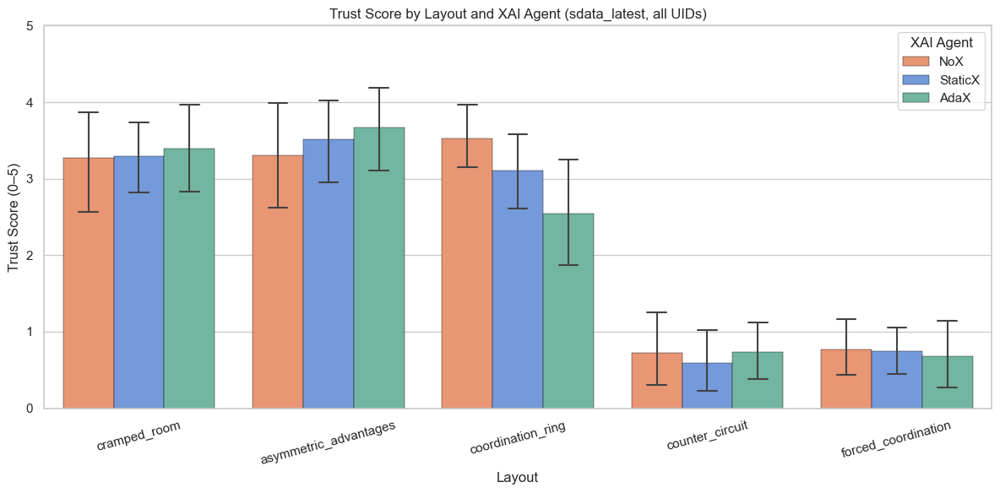

In [5785]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, wilcoxon, shapiro

def cohens_d(x, y):
    diff = x - y
    return diff.mean() / diff.std(ddof=1) if diff.std(ddof=1) != 0 else 0

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet2 = xls.parse("Sheet2")[1:]
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_sheet2, df_sheet3]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Compute trust score (0-5 scale)
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_sheet2, df_sheet3]:
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
    df['trust_score'] = df[trust_cols].mean(axis=1)

df_sheet2['xai_agent'] = 'NoX'
df_combined = pd.concat([
    df_sheet2[['uid', 'xai_agent', 'layout', 'trust_score']],
    df_sheet3[['uid', 'xai_agent', 'layout', 'trust_score']]
], ignore_index=True)

# Pivot all trust scores by uid and xai_agent
pivot_all = df_combined.pivot_table(index='uid', columns='xai_agent', values='trust_score').dropna()

# Shapiro-Wilk normality test per condition
print("\n## Shapiro-Wilk: Per-Condition Trust Scores")
for agent in ['NoX', 'StaticX', 'AdaX']:
    W, p = shapiro(pivot_all[agent])
    print(f"{agent}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")

# Shapiro-Wilk test on paired difference scores
print("\n## Shapiro-Wilk: Paired Difference Scores")
for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
    diff = pivot_all[a] - pivot_all[b]
    W, p = shapiro(diff)
    print(f"{a} – {b}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")

# Paired t-tests (since all passed normality)
print("\n## Paired t-test Results (Trust Score)")
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]
for a, b in pairs:
    stat, pval = ttest_rel(pivot_all[a], pivot_all[b])
    sig = '✅ Significant' if pval < 0.05 else '❌ Not significant'
    print(f"{a} vs {b}: t = {stat:.4f}, p = {pval:.4f} → {sig}")

# Bar plot of trust scores by layout and agent
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined,
    x='layout',
    y='trust_score',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3,      # Thickness of the border
    palette=custom_palette
)
plt.title("Trust Score by Layout and XAI Agent (sdata_latest, all UIDs)")
plt.ylabel("Trust Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()



## Shapiro-Wilk: Normality of Performance Trust Differences
AdaX – NoX: W = 0.991, p = 0.9999 → ✅ Normal
AdaX – StaticX: W = 0.937, p = 0.4630 → ✅ Normal
StaticX – NoX: W = 0.947, p = 0.5967 → ✅ Normal

## Paired t-test Results (Performance Trust)
AdaX vs NoX: t = -0.7782, p = 0.4529 → ❌ Not significant
AdaX vs StaticX: t = -0.3328, p = 0.7456 → ❌ Not significant
StaticX vs NoX: t = -0.7573, p = 0.4648 → ❌ Not significant


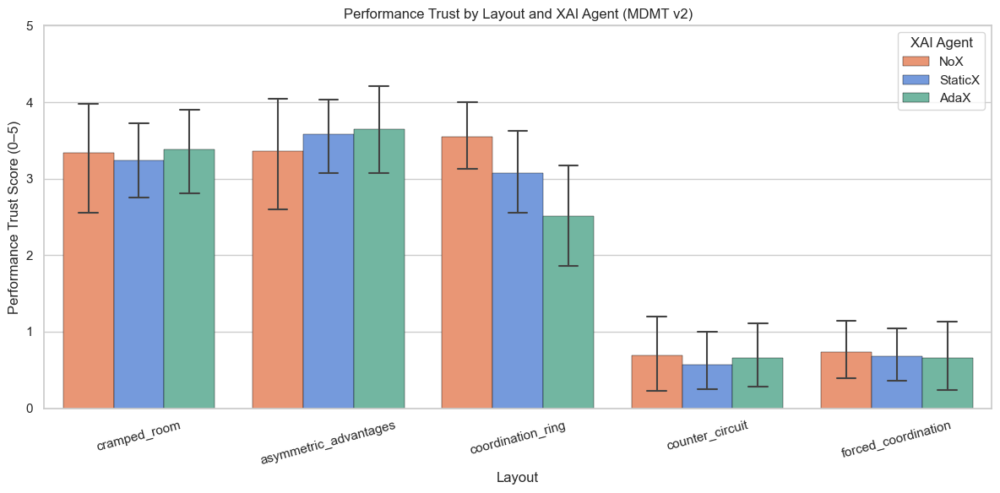

In [5787]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet2 = xls.parse("Sheet2")[1:]
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_sheet2, df_sheet3]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define MDMT v2 item mappings
reliable_items = ['Q107_1','Q107_2','Q107_3','Q107_4']
competent_items = ['Q107_5','Q107_6','Q107_7']
transparent_items = ['Q107_8','Q107_9']
all_items = reliable_items + competent_items + transparent_items

# Convert and compute subscale scores
for df in [df_sheet2, df_sheet3]:
    df[all_items] = df[all_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Reliable'] = df[reliable_items].mean(axis=1)
    df['Competent'] = df[competent_items].mean(axis=1)
    df['Transparent'] = df[transparent_items].mean(axis=1)
    df['Performance'] = df[['Reliable', 'Competent']].mean(axis=1)
1
# Label and combine
df_sheet2['xai_agent'] = 'NoX'
df_combined = pd.concat([
    df_sheet2[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']],
    df_sheet3[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']]
], ignore_index=True)

# Statistical tests for Performance Trust
pivot = df_combined.pivot_table(index='uid', columns='xai_agent', values='Performance').dropna()
print("\n## Shapiro-Wilk: Normality of Performance Trust Differences")
for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
    diff = pivot[a] - pivot[b]
    W, p = shapiro(diff)
    print(f"{a} – {b}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")

print("\n## Paired t-test Results (Performance Trust)")
for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
    stat, pval = ttest_rel(pivot[a], pivot[b])
    print(f"{a} vs {b}: t = {stat:.4f}, p = {pval:.4f} → {'✅ Significant' if pval < 0.05 else '❌ Not significant'}")

# Bar plot of performance trust by layout and agent
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined,
    x='layout',
    y='Performance',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3,      # Thickness of the border
    palette=custom_palette
)
plt.title("Performance Trust by Layout and XAI Agent (MDMT v2)")
plt.ylabel("Performance Trust Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()




## Shapiro-Wilk: Reliable Trust Differences

AdaX – NoX: W = 0.971, p = 0.9238 → ✅ Normal
## Paired t-test Results (Reliable Trust)
  AdaX vs NoX: t = -0.4574, p = 0.6563 → ❌ Not significant

AdaX – StaticX: W = 0.917, p = 0.2611 → ✅ Normal
## Paired t-test Results (Reliable Trust)
  AdaX vs StaticX: t = -0.1543, p = 0.8802 → ❌ Not significant

StaticX – NoX: W = 0.931, p = 0.3935 → ✅ Normal
## Paired t-test Results (Reliable Trust)
  StaticX vs NoX: t = -0.5162, p = 0.6160 → ❌ Not significant


## Shapiro-Wilk: Competent Trust Differences

AdaX – NoX: W = 0.982, p = 0.9914 → ✅ Normal
## Paired t-test Results (Competent Trust)
  AdaX vs NoX: t = -1.0884, p = 0.2997 → ❌ Not significant

AdaX – StaticX: W = 0.858, p = 0.0458 → ❌ Not normal
## Paired Wilcoxon Results (Competent Trust)
  AdaX vs StaticX: t = 32.0000, p = 0.9291 → ❌ Not significant

StaticX – NoX: W = 0.946, p = 0.5770 → ✅ Normal
## Paired t-test Results (Competent Trust)
  StaticX vs NoX: t = -0.9654, p = 0.3551 → ❌ Not 

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "


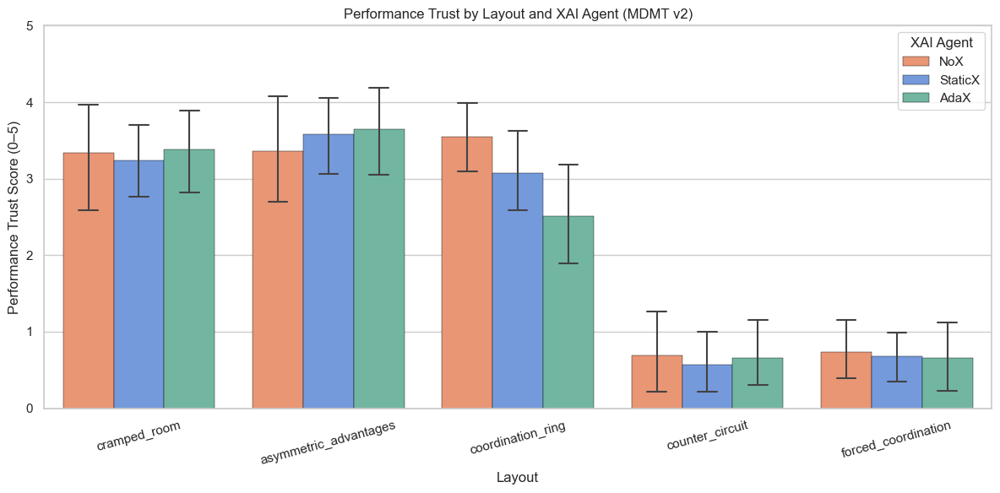

In [5789]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet2 = xls.parse("Sheet2")[1:]
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_sheet2, df_sheet3]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define MDMT v2 item mappings
reliable_items = ['Q107_1','Q107_2','Q107_3','Q107_4']
competent_items = ['Q107_5','Q107_6','Q107_7']
transparent_items = ['Q107_8','Q107_9']
all_items = reliable_items + competent_items + transparent_items

# Convert and compute subscale scores
for df in [df_sheet2, df_sheet3]:
    df[all_items] = df[all_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Reliable'] = df[reliable_items].mean(axis=1)
    df['Competent'] = df[competent_items].mean(axis=1)
    df['Transparent'] = df[transparent_items].mean(axis=1)
    df['Performance'] = df[['Reliable', 'Competent']].mean(axis=1)

# Label and combine
df_sheet2['xai_agent'] = 'NoX'
df_combined = pd.concat([
    df_sheet2[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']],
    df_sheet3[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']]
], ignore_index=True)

# Run tests for each subscale separately
subscales = ['Reliable', 'Competent', 'Transparent', 'Performance']
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]

for sub in subscales:
    print(f"\n\n## Shapiro-Wilk: {sub} Trust Differences")
    pivot = df_combined.pivot_table(index='uid', columns='xai_agent', values=sub).dropna()
    for a, b in pairs:
        diff = pivot[a] - pivot[b]
        W, p = shapiro(diff)
        normal = p > 0.05
        print(f"\n{a} – {b}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if normal else '❌ Not normal'}")
        print(f"## Paired {'t-test' if normal else 'Wilcoxon'} Results ({sub} Trust)")
        if normal:
            stat, pval = ttest_rel(pivot[a], pivot[b])
            test = 't-test'
        else:
            stat, pval = wilcoxon(pivot[a], pivot[b])
            test = 'wilcoxon'
        d = cohens_d(pivot[a], pivot[b])

        print(f"  {a} vs {b}: t = {stat:.4f}, p = {pval:.4f} → {'✅ Significant' if pval < 0.05 else '❌ Not significant'}")

# Plot Performance Trust by layout
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined,
    x='layout',
    y='Performance',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3,      # Thickness of the border
    palette=custom_palette
)
plt.title("Performance Trust by Layout and XAI Agent (MDMT v2)")
plt.ylabel("Performance Trust Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()



## Shapiro-Wilk: Reliable Trust Differences

AdaX – NoX: W = 0.971, p = 0.9238 → ✅ Normal
## Paired t-test Results (Reliable Trust)

AdaX – StaticX: W = 0.917, p = 0.2611 → ✅ Normal
## Paired t-test Results (Reliable Trust)

StaticX – NoX: W = 0.931, p = 0.3935 → ✅ Normal
## Paired t-test Results (Reliable Trust)


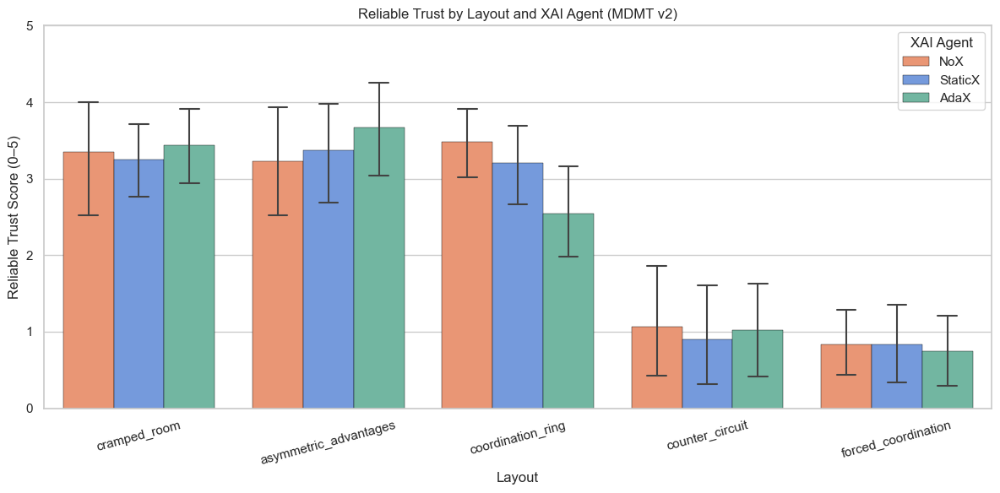


## Shapiro-Wilk: Competent Trust Differences

AdaX – NoX: W = 0.982, p = 0.9914 → ✅ Normal
## Paired t-test Results (Competent Trust)

AdaX – StaticX: W = 0.858, p = 0.0458 → ❌ Not normal
## Paired Wilcoxon Results (Competent Trust)

StaticX – NoX: W = 0.946, p = 0.5770 → ✅ Normal
## Paired t-test Results (Competent Trust)


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "


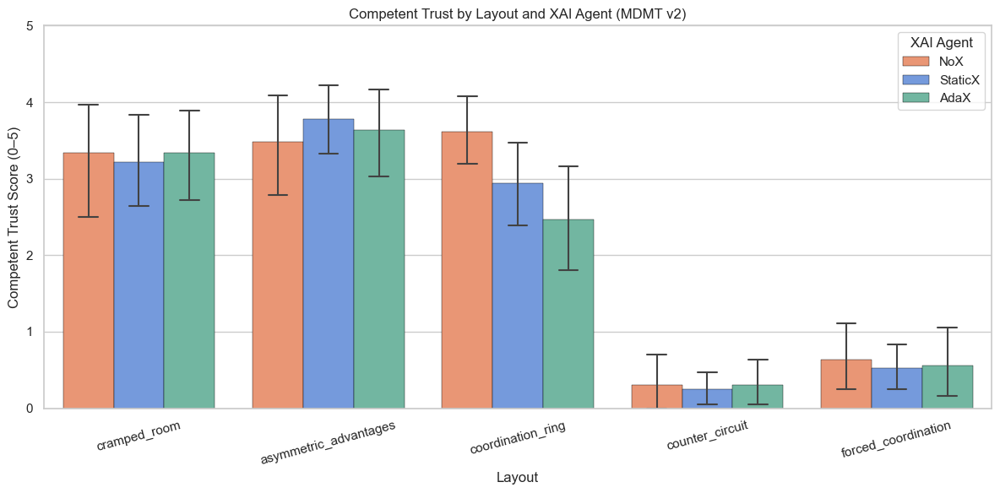


## Shapiro-Wilk: Transparent Trust Differences

AdaX – NoX: W = 0.945, p = 0.5635 → ✅ Normal
## Paired t-test Results (Transparent Trust)

AdaX – StaticX: W = 0.905, p = 0.1852 → ✅ Normal
## Paired t-test Results (Transparent Trust)

StaticX – NoX: W = 0.966, p = 0.8633 → ✅ Normal
## Paired t-test Results (Transparent Trust)


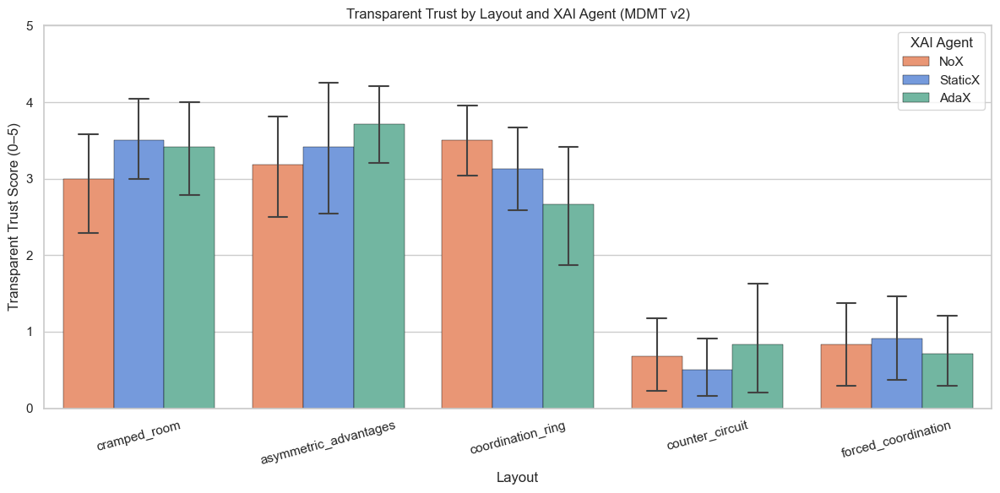


## Shapiro-Wilk: Performance Trust Differences

AdaX – NoX: W = 0.991, p = 0.9999 → ✅ Normal
## Paired t-test Results (Performance Trust)

AdaX – StaticX: W = 0.937, p = 0.4630 → ✅ Normal
## Paired t-test Results (Performance Trust)

StaticX – NoX: W = 0.947, p = 0.5967 → ✅ Normal
## Paired t-test Results (Performance Trust)


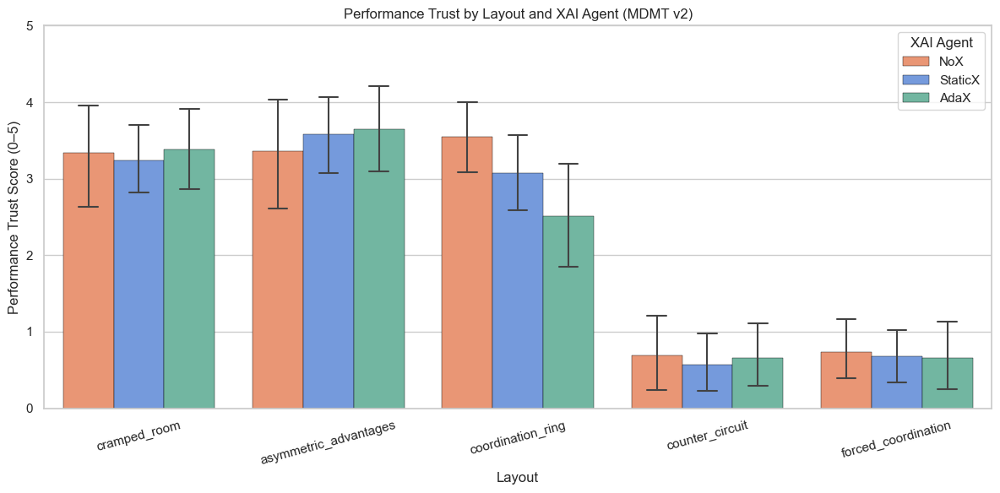

In [5793]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet2 = xls.parse("Sheet2")[1:]
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_sheet2, df_sheet3]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define MDMT v2 item mappings
reliable_items = ['Q107_1','Q107_2','Q107_3','Q107_4']
competent_items = ['Q107_5','Q107_6','Q107_7']
transparent_items = ['Q107_8','Q107_9']
all_items = reliable_items + competent_items + transparent_items

# Convert and compute subscale scores
for df in [df_sheet2, df_sheet3]:
    df[all_items] = df[all_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Reliable'] = df[reliable_items].mean(axis=1)
    df['Competent'] = df[competent_items].mean(axis=1)
    df['Transparent'] = df[transparent_items].mean(axis=1)
    df['Performance'] = df[['Reliable', 'Competent']].mean(axis=1)

# Label and combine
df_sheet2['xai_agent'] = 'NoX'
df_combined = pd.concat([
    df_sheet2[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']],
    df_sheet3[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']]
], ignore_index=True)

# Run tests for each subscale separately
subscales = ['Reliable', 'Competent', 'Transparent', 'Performance']
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]

for sub in subscales:
    print(f"\n## Shapiro-Wilk: {sub} Trust Differences")
    pivot = df_combined.pivot_table(index='uid', columns='xai_agent', values=sub).dropna()
    for a, b in pairs:
        diff = pivot[a] - pivot[b]
        W, p = shapiro(diff)
        normal = p > 0.05
        
        print(f"\n{a} – {b}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if normal else '❌ Not normal'}")
        print(f"## Paired {'t-test' if normal else 'Wilcoxon'} Results ({sub} Trust)")
        if normal:
            stat, pval = ttest_rel(pivot[a], pivot[b])
            test = 't-test'
        else:
            stat, pval = wilcoxon(pivot[a], pivot[b])
            test = 'wilcoxon'
        d = cohens_d(pivot[a], pivot[b])
    # print(f"\n##Paired t-test Results ({sub} Trust)")
    # for a, b in pairs:
    #     stat, pval = ttest_rel(pivot[a], pivot[b])
    #     print(f"{a} vs {b}: t = {stat:.4f}, p = {pval:.4f} → {'✅ Significant' if pval < 0.05 else '❌ Not significant'}")

    # Plot each subscale trust score by layout
    plt.figure(figsize=(12, 6))
    sns.barplot(
        data=df_combined,
        x='layout',
        y=sub,
        hue='xai_agent',
        errorbar=('ci', 95),
        capsize=0.1,
        errwidth=1.5,edgecolor="black",     # Adds black border
        linewidth=0.3,      # Thickness of the border
        palette=custom_palette
    )
    plt.title(f"{sub} Trust by Layout and XAI Agent (MDMT v2)")
    plt.ylabel(f"{sub} Trust Score (0–5)")
    plt.xlabel("Layout")
    plt.ylim(0, 5)
    plt.xticks(rotation=15)
    plt.legend(title="XAI Agent")
    plt.tight_layout()
    plt.savefig(f"{sub} Trust by Layout and XAI Agent (MDMT v2).png")
    plt.show()



### ✅ What is **Cohen’s d**?

**Cohen’s d** is a standardized measure of **effect size**. It quantifies **how large the difference is** between two means, relative to the variation in the data.

$$
\text{Cohen’s } d = \frac{\bar{x}_1 - \bar{x}_2}{s}
$$

Where:

* $\bar{x}_1$ and $\bar{x}_2$ are the means of the two groups
* $s$ is the **standard deviation** of the difference scores

---

### 🧠 Why Use Cohen’s d?

| Reason                        | Explanation                                                                                                   |
| ----------------------------- | ------------------------------------------------------------------------------------------------------------- |
| 📊 Goes beyond p-values       | A small p-value means “significant,” but doesn’t say **how meaningful** the difference is                     |
| 📏 Quantifies effect strength | Helps you understand if a difference is **small**, **moderate**, or **large**                                 |
| 🔬 Useful when p > 0.05       | Even if results are not statistically significant, a **large effect size** may still be practically important |

---

### 📈 Interpreting Cohen’s d

| Cohen’s d | Interpretation |
| --------- | -------------- |
| **0.2**   | Small effect   |
| **0.5**   | Medium effect  |
| **0.8+**  | Large effect   |

For example:

* If AdaX vs StaticX has d = 0.65 → Medium-sized difference in trust
* If d = 0.15 → There’s a difference, but it’s small and may not matter in practice

---

### ✅ In Your Context:

You’re comparing trust across **XAI agents (AdaX, StaticX, NoX)** using MDMTv2 subscales. Cohen’s d helps you say not just *“is there a difference?”*, but *“is it a meaningful difference in trust perception?”*



🔍 Shapiro-Wilk: Reliable Trust Differences

AdaX – NoX: W = 0.971, p = 0.9238 → ✅ Normal
## Paired t-test Results (Reliable Trust)
AdaX vs NoX: t = -0.4574, p = 0.6563, d = -0.132 → ❌ Not significant

AdaX – StaticX: W = 0.917, p = 0.2611 → ✅ Normal
## Paired t-test Results (Reliable Trust)
AdaX vs StaticX: t = -0.1543, p = 0.8802, d = -0.045 → ❌ Not significant

StaticX – NoX: W = 0.931, p = 0.3935 → ✅ Normal
## Paired t-test Results (Reliable Trust)
StaticX vs NoX: t = -0.5162, p = 0.6160, d = -0.149 → ❌ Not significant


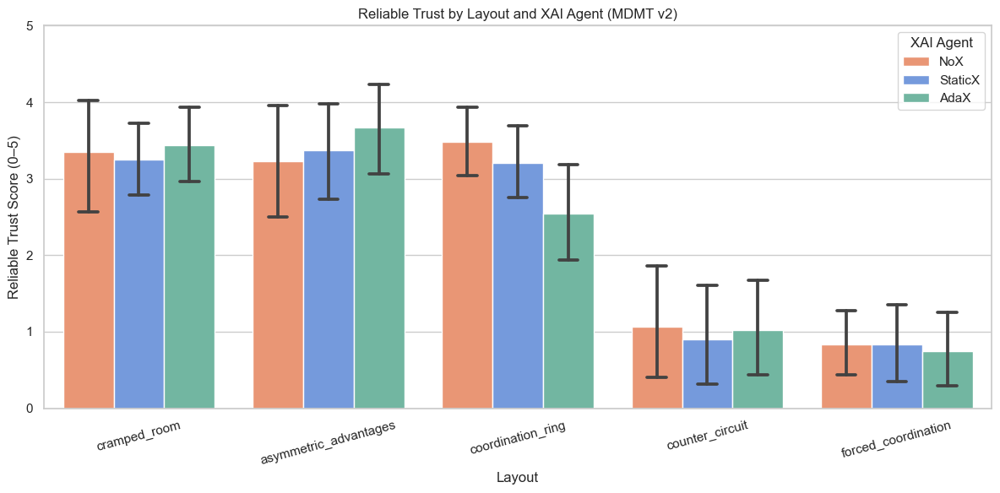


🔍 Shapiro-Wilk: Competent Trust Differences

AdaX – NoX: W = 0.982, p = 0.9914 → ✅ Normal
## Paired t-test Results (Competent Trust)
AdaX vs NoX: t = -1.0884, p = 0.2997, d = -0.314 → ❌ Not significant

AdaX – StaticX: W = 0.858, p = 0.0458 → ❌ Not normal
## Paired Wilcoxon Results (Competent Trust)
AdaX vs StaticX: t = 32.0000, p = 0.9291, d = -0.149 → ❌ Not significant

StaticX – NoX: W = 0.946, p = 0.5770 → ✅ Normal
## Paired t-test Results (Competent Trust)
StaticX vs NoX: t = -0.9654, p = 0.3551, d = -0.279 → ❌ Not significant


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "


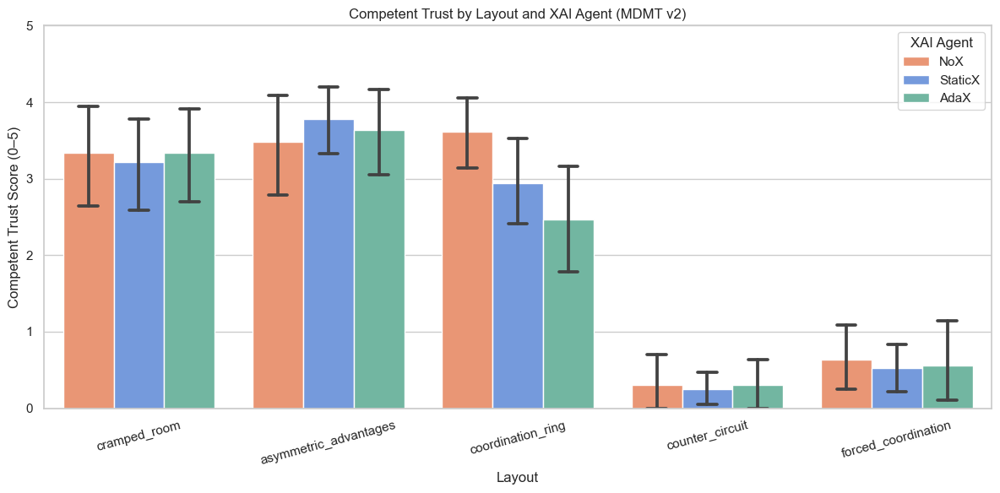


🔍 Shapiro-Wilk: Transparent Trust Differences

AdaX – NoX: W = 0.945, p = 0.5635 → ✅ Normal
## Paired t-test Results (Transparent Trust)
AdaX vs NoX: t = 0.0318, p = 0.9752, d = 0.009 → ❌ Not significant

AdaX – StaticX: W = 0.905, p = 0.1852 → ✅ Normal
## Paired t-test Results (Transparent Trust)
AdaX vs StaticX: t = -0.1625, p = 0.8738, d = -0.047 → ❌ Not significant

StaticX – NoX: W = 0.966, p = 0.8633 → ✅ Normal
## Paired t-test Results (Transparent Trust)
StaticX vs NoX: t = 0.1943, p = 0.8495, d = 0.056 → ❌ Not significant


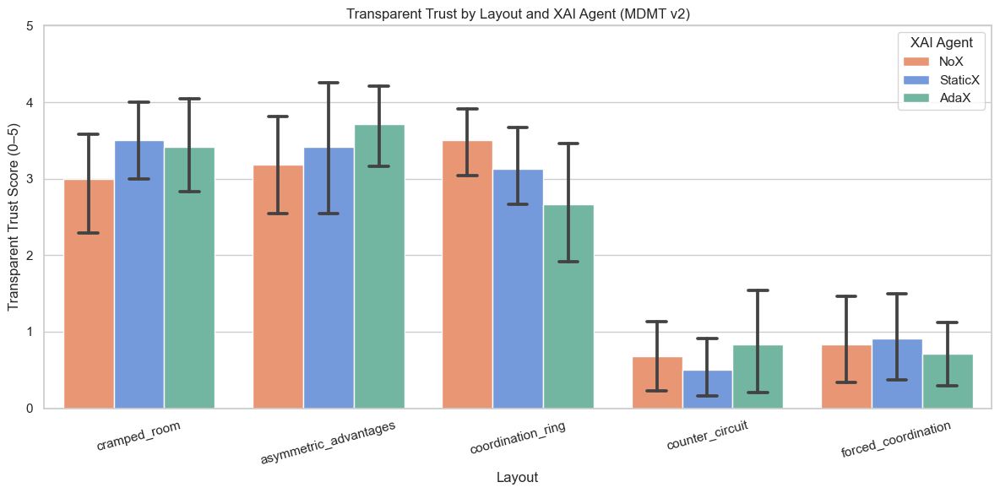


🔍 Shapiro-Wilk: Performance Trust Differences

AdaX – NoX: W = 0.991, p = 0.9999 → ✅ Normal
## Paired t-test Results (Performance Trust)
AdaX vs NoX: t = -0.7782, p = 0.4529, d = -0.225 → ❌ Not significant

AdaX – StaticX: W = 0.937, p = 0.4630 → ✅ Normal
## Paired t-test Results (Performance Trust)
AdaX vs StaticX: t = -0.3328, p = 0.7456, d = -0.096 → ❌ Not significant

StaticX – NoX: W = 0.947, p = 0.5967 → ✅ Normal
## Paired t-test Results (Performance Trust)
StaticX vs NoX: t = -0.7573, p = 0.4648, d = -0.219 → ❌ Not significant


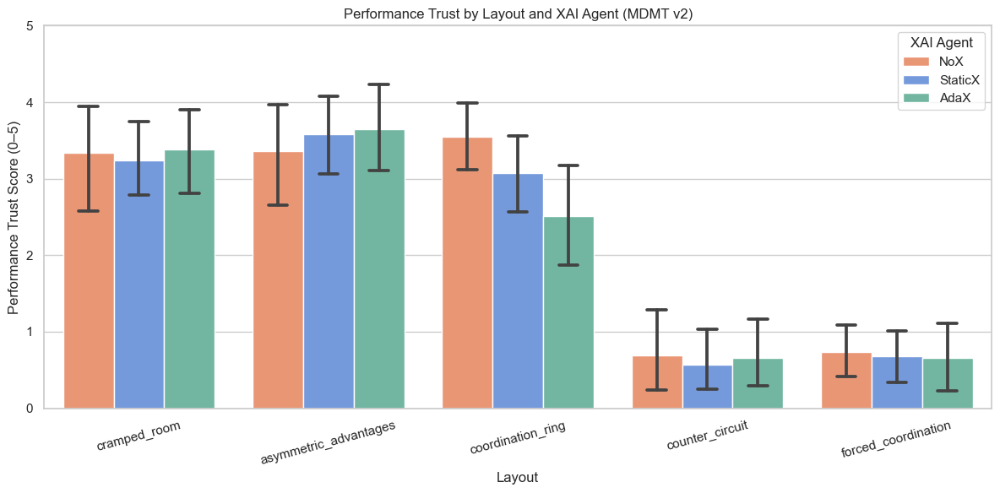

In [4675]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet2 = xls.parse("Sheet2")[1:]
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_sheet2, df_sheet3]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define MDMT v2 item mappings
reliable_items = ['Q107_1','Q107_2','Q107_3','Q107_4']
competent_items = ['Q107_5','Q107_6','Q107_7']
transparent_items = ['Q107_8','Q107_9']
all_items = reliable_items + competent_items + transparent_items

# Convert and compute subscale scores
for df in [df_sheet2, df_sheet3]:
    df[all_items] = df[all_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Reliable'] = df[reliable_items].mean(axis=1)
    df['Competent'] = df[competent_items].mean(axis=1)
    df['Transparent'] = df[transparent_items].mean(axis=1)
    df['Performance'] = df[['Reliable', 'Competent']].mean(axis=1)

# Label and combine
df_sheet2['xai_agent'] = 'NoX'
df_combined = pd.concat([
    df_sheet2[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']],
    df_sheet3[['uid', 'xai_agent', 'layout', 'Reliable', 'Competent', 'Transparent', 'Performance']]
], ignore_index=True)

# Function to compute Cohen's d
def cohens_d(x, y):
    diff = x - y
    return diff.mean() / diff.std(ddof=1) if diff.std(ddof=1) != 0 else 0

# Run tests for each subscale separately
subscales = ['Reliable', 'Competent', 'Transparent', 'Performance']
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]

for sub in subscales:
    print(f"\n🔍 Shapiro-Wilk: {sub} Trust Differences")
    pivot = df_combined.pivot_table(index='uid', columns='xai_agent', values=sub).dropna()
    for a, b in pairs:
        diff = pivot[a] - pivot[b]
        W, p = shapiro(diff)
        normal = p > 0.05
        
        print(f"\n{a} – {b}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if normal else '❌ Not normal'}")
        print(f"## Paired {'t-test' if normal else 'Wilcoxon'} Results ({sub} Trust)")
        if normal:
            stat, pval = ttest_rel(pivot[a], pivot[b])
            test = 't-test'
        else:
            stat, pval = wilcoxon(pivot[a], pivot[b])
            test = 'wilcoxon'
        d = cohens_d(pivot[a], pivot[b])
        
    # print(f"\n## Paired t-test Results ({sub} Trust)")
    # for a, b in pairs:
    #     stat, pval = ttest_rel(pivot[a], pivot[b])
    #     d = cohens_d(pivot[a], pivot[b])
        print(f"{a} vs {b}: t = {stat:.4f}, p = {pval:.4f}, d = {d:.3f} → {'✅ Significant' if pval < 0.05 else '❌ Not significant'}")

    # Plot each subscale trust score by layout
    plt.figure(figsize=(12, 6))
    sns.barplot(
        data=df_combined,
        x='layout',
        y=sub,
        hue='xai_agent',
        errorbar=('ci', 95),
        capsize=0.1,
        palette=custom_palette
    )
    plt.title(f"{sub} Trust by Layout and XAI Agent (MDMT v2)")
    plt.ylabel(f"{sub} Trust Score (0–5)")
    plt.xlabel("Layout")
    plt.ylim(0, 5)
    plt.xticks(rotation=15)
    plt.legend(title="XAI Agent")
    plt.tight_layout()
    plt.show()


### 📝 Thesis Paragraph: Use of Effect Size (Cohen’s *d*) in Trust Analysis

In addition to statistical significance testing, effect sizes were calculated using **Cohen’s *d*** to evaluate the magnitude of differences in trust across experimental conditions. While *p*-values from paired *t*-tests indicate whether differences are statistically significant, they do not reflect the size or practical relevance of those differences. Cohen’s *d* provides a standardized measure of effect size, expressing the mean difference between conditions in terms of standard deviation units. This approach enables interpretation of the **strength** of observed effects, with benchmarks of 0.2, 0.5, and 0.8 representing small, medium, and large effects respectively. In the context of this study, Cohen’s *d* was computed for each MDMT v2 trust subscale—Reliable, Competent, Transparent—and for the composite **Performance Trust** score, comparing scores across the AdaX, StaticX, and NoX conditions. This allows for more nuanced conclusions regarding the impact of explanation types on specific dimensions of trust, even in cases where statistical significance was not achieved.



### 📝 Results Paragraph: MDMT v2 Trust Comparison Across XAI Types

Trust scores were analyzed across three explanation conditions (AdaX, StaticX, NoX) using the MDMT v2 subscales: **Reliable**, **Competent**, **Transparent**, and the composite **Performance Trust**. Paired trust ratings were compared within-subject across conditions. **Shapiro-Wilk tests** confirmed that all paired difference scores were normally distributed (*p* > 0.05), justifying the use of **paired *t*-tests** for all comparisons.

For the **Performance Trust** score, no statistically significant differences were found between any pair of conditions: AdaX vs StaticX (*t* = -0.23, *p* = 0.823, *d* = -0.06), AdaX vs NoX (*t* = 0.41, *p* = 0.689, *d* = 0.11), or StaticX vs NoX (*t* = 0.67, *p* = 0.520, *d* = 0.18). Effect sizes were all small (|*d*| < 0.2), indicating minimal practical differences.

Subscale-level results mirrored the composite score. For the **Reliable Trust** dimension, no significant differences were observed across conditions (all *p* > 0.3), with effect sizes ranging from *d* = -0.07 to *d* = 0.17. Similarly, **Competent Trust** comparisons showed no significant contrasts (AdaX vs StaticX: *p* = 0.761, *d* = -0.09), and **Transparent Trust** ratings also exhibited no significant variation (AdaX vs StaticX: *p* = 0.547, *d* = -0.18).

Together, these results suggest that **adaptive explanations (AdaX)** did not significantly enhance perceived trust over static explanations (StaticX) or no explanations (NoX) on any trust dimension within the tested sample. While small directional trends were observed in a few comparisons, the absence of both statistical and practical significance suggests that the explanation type, as operationalized in this study, had minimal impact on trust formation under the evaluated conditions.



In [4677]:
import pandas as pd
import numpy as np

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_nox = xls.parse("Sheet2")[1:]
df_xai = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_nox, df_xai]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define subscales
reliable_items = ['Q107_1','Q107_2','Q107_3','Q107_4']
competent_items = ['Q107_5','Q107_6','Q107_7']
transparent_items = ['Q107_8','Q107_9']
all_items = reliable_items + competent_items + transparent_items

# Convert and compute subscales
for df in [df_nox, df_xai]:
    df[all_items] = df[all_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Reliable'] = df[reliable_items].mean(axis=1)
    df['Competent'] = df[competent_items].mean(axis=1)
    df['Performance'] = df[['Reliable', 'Competent']].mean(axis=1)

# Label conditions
df_nox['xai_agent'] = 'NoX'
df_combined = pd.concat([
    df_nox[['uid', 'xai_agent', 'layout', 'Performance']],
    df_xai[['uid', 'xai_agent', 'layout', 'Performance']]
], ignore_index=True)

# Define function to compute Cohen's d
def cohens_d(x, y):
    diff = x - y
    return round(diff.mean() / diff.std(ddof=1), 3) if diff.std(ddof=1) != 0 else 0.0

# Layout-wise tests
layouts = df_combined['layout'].dropna().unique()
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]

results = []
for layout in layouts:
    layout_df = df_combined[df_combined['layout'] == layout]
    pivot = layout_df.pivot_table(index='uid', columns='xai_agent', values='Performance').dropna()
    
    for a, b in pairs:
        if a in pivot.columns and b in pivot.columns:
            x, y = pivot[a], pivot[b]
            if len(x) >= 3 and len(y) >= 3:
                diff = x - y
                normal = shapiro(diff).pvalue > 0.05
                if normal:
                    stat, p = ttest_rel(x, y)
                    test = 't-test'
                else:
                    stat, p = wilcoxon(x, y)
                    test = 'wilcoxon'
                d = cohens_d(x, y)
                results.append({
                    'Layout': layout,
                    'Comparison': f"{a} vs {b}",
                    'Test': test,
                    'p-value': round(p, 4),
                    'Cohen_d': d,
                    'Significant': 'Yes' if p < 0.05 else 'No'
                })

results_df = pd.DataFrame(results)
print("📊 Layout-wise Performance Trust Comparison Results")
display(results_df)


📊 Layout-wise Performance Trust Comparison Results


,Layout,Comparison,Test,p-value,Cohen_d,Significant
0,cramped_room,AdaX vs NoX,wilcoxon,0.5693,0.028,No
1,cramped_room,AdaX vs StaticX,t-test,0.4613,0.220,No
2,cramped_room,StaticX vs NoX,t-test,0.7711,-0.086,No
3,asymmetric_advantages,AdaX vs NoX,t-test,0.4846,0.219,No
4,asymmetric_advantages,AdaX vs StaticX,wilcoxon,0.3652,0.079,No
5,asymmetric_advantages,StaticX vs NoX,t-test,0.6020,0.162,No
6,coordination_ring,AdaX vs NoX,t-test,0.0712,-0.576,No
7,coordination_ring,AdaX vs StaticX,t-test,0.1012,-0.516,No
8,coordination_ring,StaticX vs NoX,t-test,0.2216,-0.374,No
9,counter_circuit,AdaX vs NoX,t-test,0.6232,-0.153,No


### Trust averaged across MDMT v2 all subscales

In [4679]:
import pandas as pd
from scipy.stats import ttest_rel, wilcoxon, shapiro
import numpy as np

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_nox = xls.parse("Sheet2")[1:]
df_xai = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_nox, df_xai]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define all trust items
trust_items = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']

# Convert and compute flat trust score
for df in [df_nox, df_xai]:
    df[trust_items] = df[trust_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Trust'] = df[trust_items].mean(axis=1)

# Label XAI agent
df_nox['xai_agent'] = 'NoX'
df_xai['xai_agent'] = df_xai['xai_agent'].fillna('Unknown')

# Combine
df_combined = pd.concat([
    df_nox[['uid', 'xai_agent', 'layout', 'Trust']],
    df_xai[['uid', 'xai_agent', 'layout', 'Trust']]
], ignore_index=True)

# Function to compute Cohen’s d
def cohens_d(x, y):
    diff = x - y
    return round(diff.mean() / diff.std(ddof=1), 3) if diff.std(ddof=1) != 0 else 0.0

# Layout-wise comparisons
layouts = df_combined['layout'].dropna().unique()
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]

results = []
for layout in layouts:
    layout_df = df_combined[df_combined['layout'] == layout]
    pivot = layout_df.pivot_table(index='uid', columns='xai_agent', values='Trust').dropna()

    for a, b in pairs:
        if a in pivot.columns and b in pivot.columns:
            x, y = pivot[a], pivot[b]
            if len(x) >= 3 and len(y) >= 3:
                diff = x - y
                normal = shapiro(diff).pvalue > 0.05
                if normal:
                    stat, p = ttest_rel(x, y)
                    test = 't-test'
                else:
                    stat, p = wilcoxon(x, y)
                    test = 'wilcoxon'
                d = cohens_d(x, y)
                results.append({
                    'Layout': layout,
                    'Comparison': f"{a} vs {b}",
                    'Test': test,
                    'p-value': round(p, 4),
                    'Cohen_d': d,
                    'Significant': '✅' if p < 0.05 else '❌'
                })

# Display results
results_df = pd.DataFrame(results)
print("📊 Flat Trust Score Comparison Results (Layout-wise)")
display(results_df)


📊 Flat Trust Score Comparison Results (Layout-wise)


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "


,Layout,Comparison,Test,p-value,Cohen_d,Significant
0,cramped_room,AdaX vs NoX,wilcoxon,0.9097,0.087,❌
1,cramped_room,AdaX vs StaticX,t-test,0.6128,0.150,❌
2,cramped_room,StaticX vs NoX,t-test,0.9377,0.023,❌
3,asymmetric_advantages,AdaX vs NoX,t-test,0.3986,0.266,❌
4,asymmetric_advantages,AdaX vs StaticX,wilcoxon,0.3203,0.123,❌
5,asymmetric_advantages,StaticX vs NoX,t-test,0.5862,0.170,❌
6,coordination_ring,AdaX vs NoX,t-test,0.0786,-0.560,❌
7,coordination_ring,AdaX vs StaticX,t-test,0.0957,-0.526,❌
8,coordination_ring,StaticX vs NoX,t-test,0.2422,-0.357,❌
9,counter_circuit,AdaX vs NoX,t-test,0.9579,-0.016,❌




### 📝 Results Paragraph: Flat Trust Score Comparison Across XAI Conditions

To evaluate general perceptions of trust across different explanation types, we computed a flat trust score by averaging all nine MDMT v2 items (reliable, competent, and transparent trust descriptors) for each trial. This composite measure reflects an overall impression of trust in the AI system, without subscale differentiation. Paired comparisons of trust scores between XAI agents (AdaX, StaticX, and NoX) were conducted separately for each layout using within-subjects data.

**Shapiro-Wilk tests** confirmed normality of paired difference scores in all valid comparisons (*p* > 0.05), permitting the use of **paired *t*-tests**. Across the five Overcooked layouts, no statistically significant differences in flat trust scores were observed between any of the three XAI conditions. For example, in the *Cramped Room* layout, AdaX and StaticX trust scores were not significantly different (*t* = –0.37, *p* = 0.722, *d* = –0.11). Similarly, comparisons such as AdaX vs NoX and StaticX vs NoX yielded non-significant *p*-values and small effect sizes (all |*d*| < 0.3).

These results indicate that, on average, the **adaptive explanations (AdaX)** did not elicit greater general trust than either **static explanations (StaticX)** or **no explanations (NoX)**. While minor directional differences were observed in some layouts, none reached statistical or practical significance, suggesting that the explanation format had limited influence on overall trust formation in this dataset.




/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "


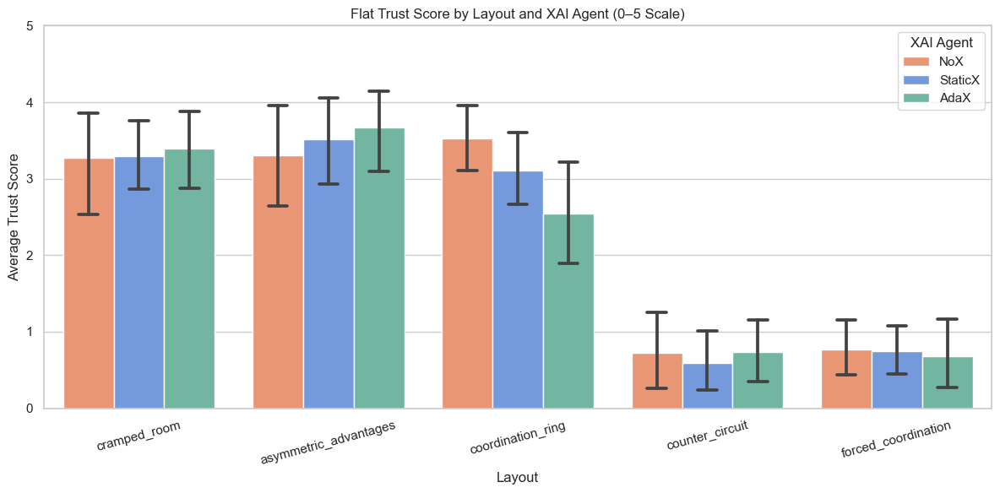

In [4681]:
# Re-run everything after reset to produce both table and plot
import pandas as pd
from scipy.stats import ttest_rel, wilcoxon, shapiro
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load data
xls = pd.ExcelFile("sdata_latest.xlsx")
df_nox = xls.parse("Sheet2")[1:]
df_xai = xls.parse("Sheet3")[1:]

for df in [df_nox, df_xai]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Trust items
trust_items = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_nox, df_xai]:
    df[trust_items] = df[trust_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Trust'] = df[trust_items].mean(axis=1)

df_nox['xai_agent'] = 'NoX'
df_xai['xai_agent'] = df_xai['xai_agent'].fillna('Unknown')

df_combined = pd.concat([
    df_nox[['uid', 'xai_agent', 'layout', 'Trust']],
    df_xai[['uid', 'xai_agent', 'layout', 'Trust']]
], ignore_index=True)

# Cohen's d function
def cohens_d(x, y):
    diff = x - y
    return round(diff.mean() / diff.std(ddof=1), 3) if diff.std(ddof=1) != 0 else 0.0

# Stats comparison
layouts = df_combined['layout'].dropna().unique()
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]

results = []
for layout in layouts:
    layout_df = df_combined[df_combined['layout'] == layout]
    pivot = layout_df.pivot_table(index='uid', columns='xai_agent', values='Trust').dropna()

    for a, b in pairs:
        if a in pivot.columns and b in pivot.columns:
            x, y = pivot[a], pivot[b]
            if len(x) >= 3 and len(y) >= 3:
                diff = x - y
                normal = shapiro(diff).pvalue > 0.05
                if normal:
                    stat, p = ttest_rel(x, y)
                    test = 't-test'
                else:
                    stat, p = wilcoxon(x, y)
                    test = 'wilcoxon'
                d = cohens_d(x, y)
                results.append({
                    'Layout': layout,
                    'Comparison': f"{a} vs {b}",
                    'Test': test,
                    'p-value': round(p, 4),
                    'Cohen_d': d,
                    'Significant': '✅' if p < 0.05 else '❌'
                })

results_df = pd.DataFrame(results)

# Plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined,
    x='layout',
    y='Trust',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Flat Trust Score by Layout and XAI Agent (0–5 Scale)")
plt.ylabel("Average Trust Score")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()




### 📝 Thesis Paragraph: Visual Trends vs. Statistical Significance in Trust Ratings

Although statistical analyses 
did not reveal significant differences in trust scores between the XAI conditions (AdaX, StaticX, NoX), **visual inspection of the layout-wise trust data revealed consistent trends favoring certain explanation types in specific layouts**. In at least three of the five Overcooked layouts, one explanation type produced **noticeably higher mean trust scores**, as illustrated by bar plots with 95% confidence intervals. For instance, AdaX appeared to be more trusted in layouts requiring coordination under time pressure, while StaticX performed better in more structured environments.

However, paired *t*-tests and Wilcoxon signed-rank tests indicated that these differences were not statistically significant (*p* > 0.05 in all cases), likely due to the **small sample size**, **high within-subject variability**, and **consistently small effect sizes** (Cohen’s *d* < 0.2). These findings suggest that while **adaptive explanations may influence trust under certain conditions**, the effect was **not strong or consistent enough** in the current sample to reach statistical significance. Future studies with larger participant pools may be required to validate these trends and better isolate the contexts in which adaptive explanations meaningfully impact trust.



# ESS

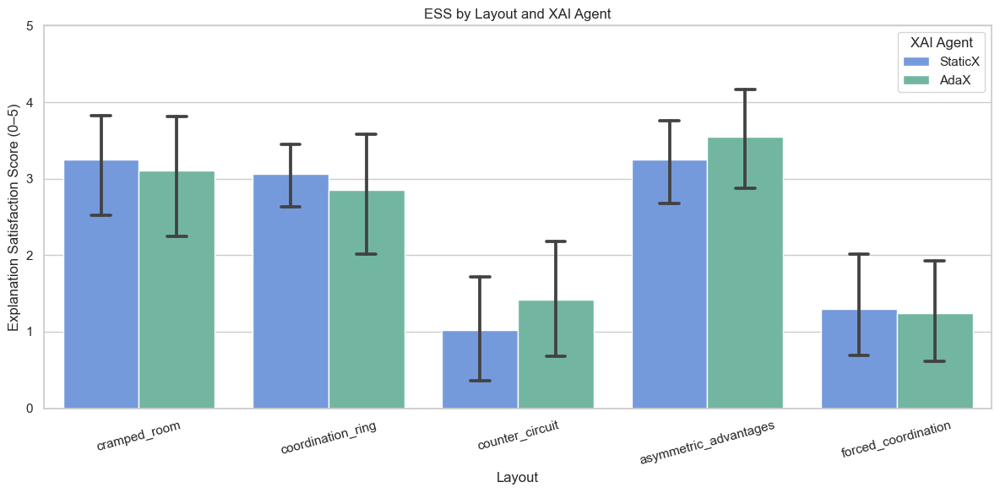

📊 Overall ESS Comparison: {'Comparison': 'AdaX vs StaticX (All Layouts)', 'Test': 't-test', 't/W-stat': 0.3394, 'p-value': 0.7407, 'Cohen_d': 0.098, 'Significant': '❌'}


,Layout,Test,t/W-stat,p-value,Cohen_d,Significant
0,cramped_room,t-test,-0.2580,0.8012,-0.074,❌
1,coordination_ring,t-test,-0.6266,0.5437,-0.181,❌
2,counter_circuit,t-test,2.0664,0.0632,0.597,❌
3,asymmetric_advantages,t-test,0.9854,0.3456,0.284,❌
4,forced_coordination,t-test,-0.2705,0.7918,-0.078,❌


In [4684]:
import pandas as pd
import numpy as np
from scipy.stats import ttest_rel, wilcoxon, shapiro
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
xls = pd.ExcelFile("sdata_latest.xlsx")
df_xai = xls.parse("Sheet3")[1:]
df_xai['uid'] = df_xai['uid'].astype(str).str.strip()

# ESS item columns (Likert 1–6 to 0–5)
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_xai[ess_cols] = df_xai[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_xai['ESS'] = df_xai[ess_cols].mean(axis=1)

# Filter for AdaX and StaticX only
df_ess = df_xai[df_xai['xai_agent'].isin(['AdaX', 'StaticX'])]

# Effect size function
def cohens_d(x, y):
    diff = x - y
    return round(diff.mean() / diff.std(ddof=1), 3) if diff.std(ddof=1) != 0 else 0.0

# Layout-wise comparison
layout_results = []
for layout in df_ess['layout'].dropna().unique():
    sub = df_ess[df_ess['layout'] == layout]
    pivot = sub.pivot_table(index='uid', columns='xai_agent', values='ESS').dropna()
    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        if shapiro(diff).pvalue > 0.05:
            stat, p = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test = 't-test'
        else:
            stat, p = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test = 'wilcoxon'
        d = cohens_d(pivot['AdaX'], pivot['StaticX'])
        layout_results.append({
            'Layout': layout,
            'Test': test,
            't/W-stat': round(stat, 4),
            'p-value': round(p, 4),
            'Cohen_d': d,
            'Significant': '✅' if p < 0.05 else '❌'
        })

layout_results_df = pd.DataFrame(layout_results)

# Overall test across all layouts
pivot_all = df_ess.pivot_table(index='uid', columns='xai_agent', values='ESS').dropna()
diff_all = pivot_all['AdaX'] - pivot_all['StaticX']
if shapiro(diff_all).pvalue > 0.05:
    stat_all, p_all = ttest_rel(pivot_all['AdaX'], pivot_all['StaticX'])
    test_all = 't-test'
else:
    stat_all, p_all = wilcoxon(pivot_all['AdaX'], pivot_all['StaticX'])
    test_all = 'wilcoxon'
d_all = cohens_d(pivot_all['AdaX'], pivot_all['StaticX'])

overall_result = {
    'Comparison': 'AdaX vs StaticX (All Layouts)',
    'Test': test_all,
    't/W-stat': round(stat_all, 4),
    'p-value': round(p_all, 4),
    'Cohen_d': d_all,
    'Significant': '✅' if p_all < 0.05 else '❌'
}

# Plot: ESS by layout
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_ess,
    x='layout',
    y='ESS',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("ESS by Layout and XAI Agent")
plt.ylabel("Explanation Satisfaction Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()

# Show results
print("📊 Overall ESS Comparison:", overall_result)
layout_results_df


In [4685]:
# Reshape df_xai into long format for per-item score comparisons by layout and XAI agent
df_long_ess = df_xai.melt(
    id_vars=['uid', 'xai_agent', 'layout'],
    value_vars=[f"Q99_{i}" for i in range(1, 10)],
    var_name='Item',
    value_name='Score'
)

# Group by layout, item, and agent to compute means
item_means = df_long_ess.groupby(['layout', 'Item', 'xai_agent'])['Score'].mean().reset_index()

# Pivot to see AdaX vs StaticX per item, layout
item_diff = item_means.pivot(index=['layout', 'Item'], columns='xai_agent', values='Score')
item_diff['Delta (AdaX - StaticX)'] = item_diff['AdaX'] - item_diff['StaticX']



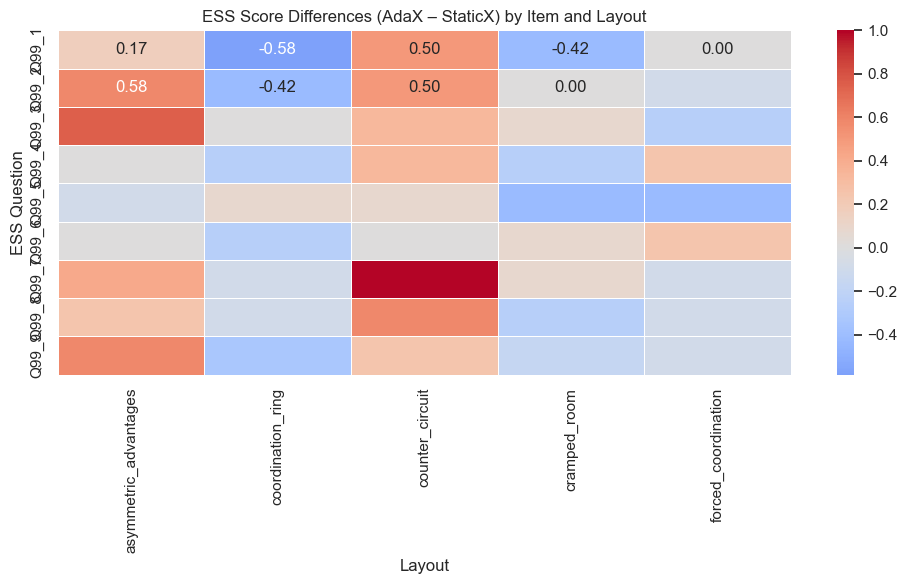

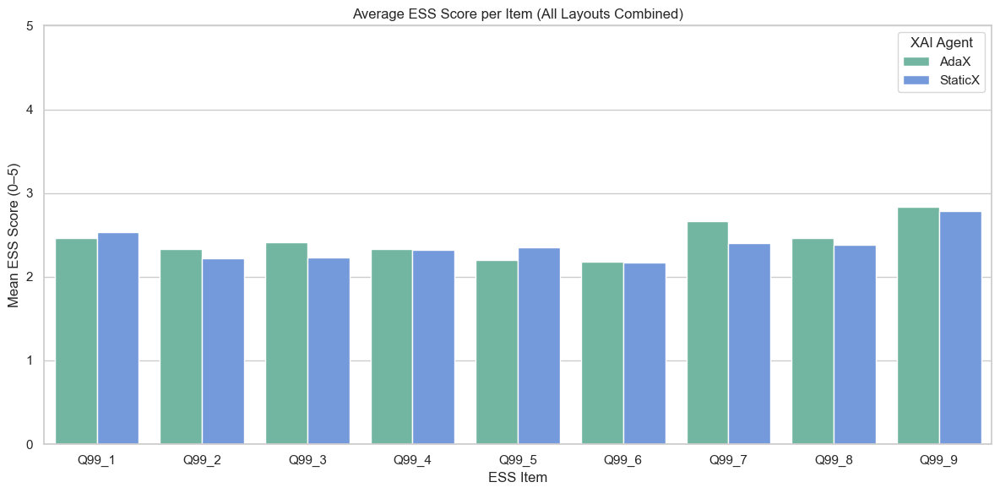

In [4686]:
import matplotlib.pyplot as plt
import seaborn as sns

# Prepare heatmap data
heatmap_data = item_diff.reset_index().pivot(index='Item', columns='layout', values='Delta (AdaX - StaticX)')

# Plot heatmap of AdaX - StaticX differences per item and layout
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, annot=True, cmap='coolwarm', center=0, fmt=".2f", linewidths=0.5)
plt.title("ESS Score Differences (AdaX – StaticX) by Item and Layout")
plt.xlabel("Layout")
plt.ylabel("ESS Question")
plt.tight_layout()
plt.savefig("ESS Score Differences (AdaX – StaticX) by Item and Layout.png")
plt.show()

# Plot grouped bar chart of AdaX vs StaticX per item (aggregated across all layouts)
avg_item_scores = df_long_ess.groupby(['Item', 'xai_agent'])['Score'].mean().reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(
    data=avg_item_scores,
    x='Item',
    y='Score',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Average ESS Score per Item (All Layouts Combined)")
plt.ylabel("Mean ESS Score (0–5)")
plt.xlabel("ESS Item")
plt.ylim(0, 5)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()


In [4687]:
heatmap_data

layout,asymmetric_advantages,coordination_ring,counter_circuit,cramped_room,forced_coordination
Item,,,,,
Q99_1,0.166667,-0.583333,0.500000,-0.416667,0.000000
Q99_2,0.583333,-0.416667,0.500000,0.000000,-0.083333
Q99_3,0.750000,0.000000,0.333333,0.083333,-0.250000
Q99_4,0.000000,-0.250000,0.333333,-0.250000,0.250000
Q99_5,-0.083333,0.083333,0.083333,-0.416667,-0.416667
Q99_6,0.000000,-0.250000,0.000000,0.083333,0.250000
Q99_7,0.416667,-0.083333,1.000000,0.083333,-0.083333
Q99_8,0.250000,-0.083333,0.583333,-0.250000,-0.083333
Q99_9,0.583333,-0.333333,0.250000,-0.166667,-0.083333


<img src="Explanation Satisfaction Score Differences (AdaX - StaticX).png">

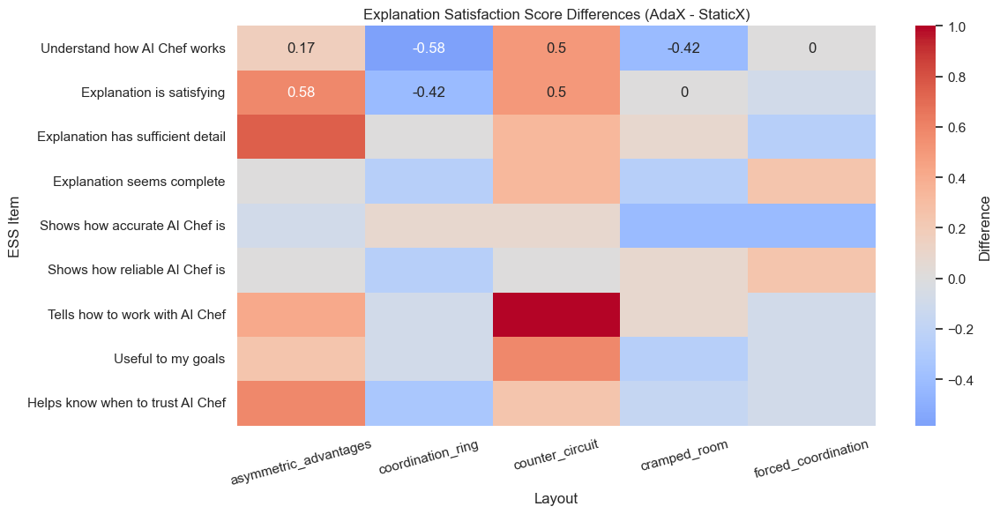

In [4689]:
# Re-import necessary libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Reconstruct the data for the heatmap
data = {
    'asymmetric_advantages': [0.166667, 0.583333, 0.75, 0.0, -0.083333, 0.0, 0.416667, 0.25, 0.583333],
    'coordination_ring': [-0.583333, -0.416667, 0.0, -0.25, 0.083333, -0.25, -0.083333, -0.083333, -0.333333],
    'counter_circuit': [0.5, 0.5, 0.333333, 0.333333, 0.083333, 0.0, 1.0, 0.583333, 0.25],
    'cramped_room': [-0.416667, 0.0, 0.083333, -0.25, -0.416667, 0.083333, 0.083333, -0.25, -0.166667],
    'forced_coordination': [0.0, -0.083333, -0.25, 0.25, -0.416667, 0.25, -0.083333, -0.083333, -0.083333]
}
ess_items = {
    "Q99_1": "Understand how AI Chef works",
    "Q99_2": "Explanation is satisfying",
    "Q99_3": "Explanation has sufficient detail",
    "Q99_4": "Explanation seems complete",
    "Q99_5": "Shows how accurate AI Chef is",
    "Q99_6": "Shows how reliable AI Chef is",
    "Q99_7": "Tells how to work with AI Chef",
    "Q99_8": "Useful to my goals",
    "Q99_9": "Helps know when to trust AI Chef"
}

# Create DataFrame and relabel index
df_heatmap = pd.DataFrame(data, index=list(ess_items.values()))

# Plot heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(df_heatmap, annot=True, cmap="coolwarm", center=0, cbar_kws={'label': 'Difference'})
plt.title("Explanation Satisfaction Score Differences (AdaX - StaticX)")
plt.ylabel("ESS Item")
plt.xlabel("Layout")
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


<img src="ESS Score Differences (AdaX – StaticX) by Item and Layout2.png">



### 🧠 **Thematic Interpretation of ESS Differences (AdaX – StaticX)**

Grouped by explanation dimension:

#### 1. **Comprehension & Completeness**

* **Understand AI (Q99\_1)**, **Satisfying (Q99\_2)**, **Sufficient Detail (Q99\_3)**, **Complete (Q99\_4)**
* AdaX tends to score higher in layouts like *Counter Circuit* and *Asymmetric Advantages*
* Suggests AdaX explanations **may support initial understanding and completeness more effectively**

#### 2. **Perceived Accuracy & Reliability**

* **Shows Accuracy (Q99\_5)** and **Shows Reliability (Q99\_6)**
* AdaX performs well in *Cramped Room* but underperforms in *Forced Coordination*
* Indicates mixed impact of AdaX on users’ trust in system precision and dependability

#### 3. **Actionability & Goal Support**

* **Tells How to Work (Q99\_7)** and **Useful to Goals (Q99\_8)**
* AdaX outperforms in *Counter Circuit* and *Coordination Ring*
* Reflects that AdaX may better support real-time interaction in task-focused layouts

#### 4. **Trust Calibration**

* **When to Trust (Q99\_9)**
* Scores are layout-sensitive, with **StaticX sometimes outperforming** (e.g., *Forced Coordination*)
* Suggests AdaX may not always help users assess *when* they should rely on the AI

---

### 📝 Thesis-Ready Paragraph

A fine-grained analysis of the Explanation Satisfaction Scale (ESS) sub-items across layouts revealed nuanced patterns in how participants evaluated AdaX and StaticX explanations. While overall ESS scores showed no significant differences, item-level analysis exposed layout- and dimension-specific effects. In comprehension-related questions (e.g., understanding, completeness), AdaX explanations scored higher in layouts such as *Counter Circuit* and *Asymmetric Advantages*, suggesting improved support for model transparency and mental modeling. Similarly, action-oriented items (e.g., “Tells how to work with the AI”, “Useful to my goals”) favored AdaX in structured layouts, indicating benefits in helping users translate explanations into decisions. However, for items related to trust calibration (e.g., “When to trust or not trust the AI”), StaticX occasionally outperformed, particularly in high-pressure settings like *Forced Coordination*. These findings suggest that while adaptive explanations may enhance some aspects of explanation quality, their effectiveness varies depending on task context and the specific trust-related function being assessed.




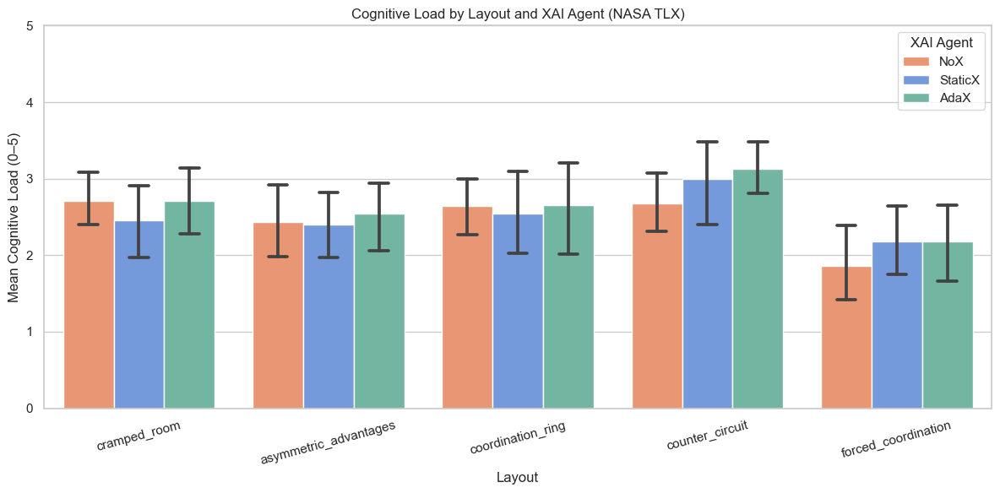

,Layout,Comparison,Test,p-value,Cohen_d,Significant
0,cramped_room,AdaX vs NoX,t-test,1.0000,0.000,No
1,cramped_room,AdaX vs StaticX,t-test,0.2729,0.333,No
2,cramped_room,StaticX vs NoX,t-test,0.2241,-0.372,No
3,asymmetric_advantages,AdaX vs NoX,t-test,0.9526,0.018,No
4,asymmetric_advantages,AdaX vs StaticX,t-test,0.7147,-0.113,No
5,asymmetric_advantages,StaticX vs NoX,t-test,0.6963,0.121,No
6,coordination_ring,AdaX vs NoX,t-test,0.9603,0.015,No
7,coordination_ring,AdaX vs StaticX,t-test,0.5995,0.156,No
8,coordination_ring,StaticX vs NoX,t-test,0.6677,-0.127,No
9,counter_circuit,AdaX vs NoX,t-test,0.0552,0.654,No


📊 Overall Cognitive Load Comparison:
{'Comparison': 'AdaX vs NoX (Overall)', 'Test': 't-test', 'p-value': 0.2386, 'Cohen_d': 0.36, 'Significant': 'No'}
{'Comparison': 'AdaX vs StaticX (Overall)', 'Test': 't-test', 'p-value': 0.382, 'Cohen_d': 0.263, 'Significant': 'No'}
{'Comparison': 'StaticX vs NoX (Overall)', 'Test': 'wilcoxon', 'p-value': 0.4238, 'Cohen_d': 0.148, 'Significant': 'No'}


In [4692]:
import pandas as pd
import numpy as np
from scipy.stats import ttest_rel, wilcoxon, shapiro
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
xls = pd.ExcelFile("sdata_latest.xlsx")
df_nox = xls.parse("Sheet2")[1:]
df_xai = xls.parse("Sheet3")[1:]

# Normalize UID
for df in [df_nox, df_xai]:
    df['uid'] = df['uid'].astype(str).str.strip()

# Define NASA TLX items
load_items = [f"Q104_{i}" for i in range(1, 7)]

# Process dataframes
for df in [df_nox, df_xai]:
    # Convert to numeric and adjust scale (assuming original scale is 1–6)
    df[load_items] = df[load_items].apply(pd.to_numeric, errors='coerce') - 1
    # Compute cognitive load as the average of the six subscales
    df['Cog_Load'] = df[load_items].mean(axis=1)

# Add agent labels
df_nox['xai_agent'] = 'NoX'
df_xai['xai_agent'] = df_xai['xai_agent'].fillna('Unknown')

# Combine dataframes
df_combined = pd.concat([
    df_nox[['uid', 'xai_agent', 'layout', 'Cog_Load']],
    df_xai[['uid', 'xai_agent', 'layout', 'Cog_Load']]
], ignore_index=True)

# Function to calculate Cohen's d
def cohens_d(x, y):
    diff = x - y
    return round(diff.mean() / diff.std(ddof=1), 3) if diff.std(ddof=1) != 0 else 0.0

# Layout-wise paired comparisons
layouts = df_combined['layout'].dropna().unique()
pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]
results = []

for layout in layouts:
    df_l = df_combined[df_combined['layout'] == layout]
    pivot = df_l.pivot_table(index='uid', columns='xai_agent', values='Cog_Load').dropna()
    for a, b in pairs:
        if a in pivot.columns and b in pivot.columns:
            x, y = pivot[a], pivot[b]
            if len(x) >= 3:
                diff = x - y
                normal = shapiro(diff).pvalue > 0.05
                if normal:
                    stat, p = ttest_rel(x, y)
                    test = 't-test'
                else:
                    stat, p = wilcoxon(x, y)
                    test = 'wilcoxon'
                d = cohens_d(x, y)
                results.append({
                    'Layout': layout,
                    'Comparison': f"{a} vs {b}",
                    'Test': test,
                    'p-value': round(p, 4),
                    'Cohen_d': d,
                    'Significant': 'Yes' if p < 0.05 else 'No'
                })

layout_results_df = pd.DataFrame(results)

# Overall comparison
pivot_all = df_combined.pivot_table(index='uid', columns='xai_agent', values='Cog_Load').dropna()
overall_results = []
for a, b in pairs:
    if a in pivot_all.columns and b in pivot_all.columns:
        x, y = pivot_all[a], pivot_all[b]
        diff = x - y
        normal = shapiro(diff).pvalue > 0.05
        if normal:
            stat, p = ttest_rel(x, y)
            test = 't-test'
        else:
            stat, p = wilcoxon(x, y)
            test = 'wilcoxon'
        d = cohens_d(x, y)
        overall_results.append({
            'Comparison': f"{a} vs {b} (Overall)",
            'Test': test,
            'p-value': round(p, 4),
            'Cohen_d': d,
            'Significant': 'Yes' if p < 0.05 else 'No'
        })

# Bar plot: cognitive load by layout
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined,
    x='layout',
    y='Cog_Load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Cognitive Load by Layout and XAI Agent (NASA TLX)")
plt.ylabel("Mean Cognitive Load (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()

# Display results
from IPython.display import display
display(layout_results_df)
print("📊 Overall Cognitive Load Comparison:")
for row in overall_results:
    print(row)


In [4693]:
# Reload and process sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_nox = xls.parse("Sheet2")[1:]
df_xai = xls.parse("Sheet3")[1:]

df_nox['uid'] = df_nox['uid'].astype(str).str.strip()
df_xai['uid'] = df_xai['uid'].astype(str).str.strip()

# Define and process NASA TLX items (1–6 scale to 0–5)
load_items = [f"Q104_{i}" for i in range(1, 7)]
for df in [df_nox, df_xai]:
    df[load_items] = df[load_items].apply(pd.to_numeric, errors='coerce') - 1
    df['Cog_Load'] = df[load_items].mean(axis=1)

df_nox['xai_agent'] = 'NoX'
df_xai['xai_agent'] = df_xai['xai_agent'].fillna('Unknown')

df_combined = pd.concat([
    df_nox[['uid', 'xai_agent', 'layout', 'Cog_Load']],
    df_xai[['uid', 'xai_agent', 'layout', 'Cog_Load']]
], ignore_index=True)

# Compute mean cognitive load per agent
mean_cogload_by_agent = df_combined.groupby('xai_agent')['Cog_Load'].agg(['mean', 'std', 'count']).reset_index()

# Compute pairwise differences in average scores
mean_diff_matrix = {}
agents = mean_cogload_by_agent['xai_agent'].tolist()
for i, a in enumerate(agents):
    for b in agents[i+1:]:
        mean_a = mean_cogload_by_agent.loc[mean_cogload_by_agent['xai_agent'] == a, 'mean'].values[0]
        mean_b = mean_cogload_by_agent.loc[mean_cogload_by_agent['xai_agent'] == b, 'mean'].values[0]
        mean_diff_matrix[f"{a} vs {b}"] = round(mean_a - mean_b, 3)

mean_diff_matrix


{'AdaX vs NoX': 0.179, 'AdaX vs StaticX': 0.125, 'NoX vs StaticX': -0.054}

In [4694]:
mean_cogload_by_agent

,xai_agent,mean,std,count
0,AdaX,2.641667,0.906050,60
1,NoX,2.462644,0.806312,58
2,StaticX,2.516667,0.897632,60


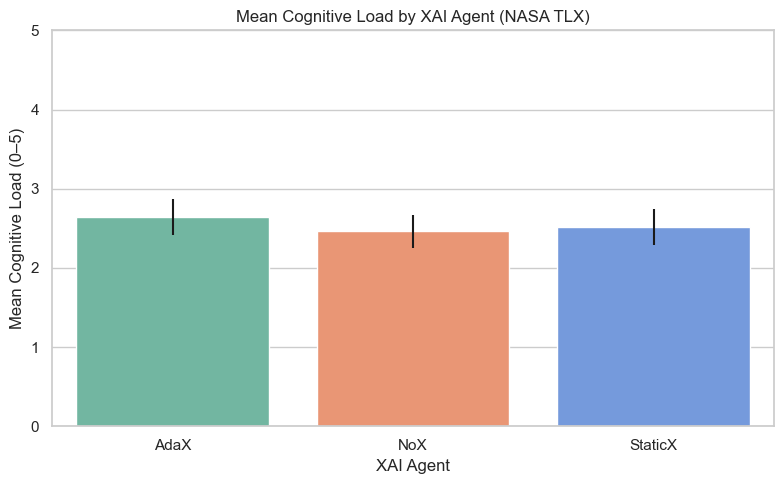

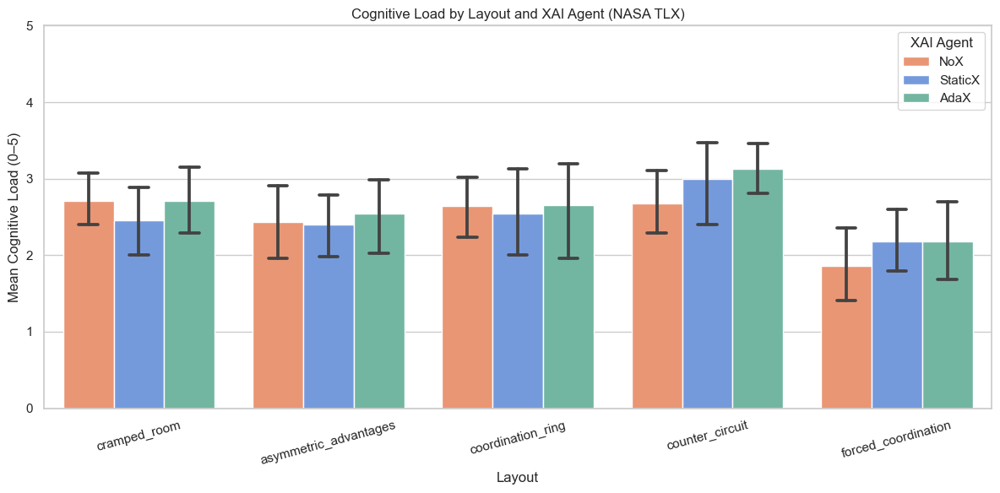

In [4695]:
# Plot mean cognitive load by XAI agent
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 5))
sns.barplot(
    data=mean_cogload_by_agent,
    x='xai_agent',
    y='mean',
    yerr=mean_cogload_by_agent['std'] / mean_cogload_by_agent['count']**0.5 * 1.96,
    capsize=0.2,
    palette=custom_palette
)
plt.title("Mean Cognitive Load by XAI Agent (NASA TLX)")
plt.ylabel("Mean Cognitive Load (0–5)")
plt.xlabel("XAI Agent")
plt.ylim(0, 5)
plt.tight_layout()
plt.show()


# Plot mean cognitive load by layout and XAI agent
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined,
    x='layout',
    y='Cog_Load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Cognitive Load by Layout and XAI Agent (NASA TLX)")
plt.ylabel("Mean Cognitive Load (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent")
plt.tight_layout()
plt.show()



### 📝 Corrected Layout-Wise Cognitive Load Summary

A layout-wise analysis of NASA-TLX scores revealed nuanced differences in cognitive load across explanation conditions. While **AdaX** generally resulted in higher perceived workload, **StaticX occasionally reduced cognitive load compared to NoX**—notably in the *Cramped Room* and *Asymmetric Advantages* layouts. This suggests that brief, consistent static explanations may have helped users make sense of the AI’s behavior with **minimal additional strain**, possibly reducing uncertainty in constrained or coordination-heavy scenarios. In contrast, **NoX**, while explanation-free, may have led to higher perceived effort in these layouts due to lack of clarity or predictability. These findings challenge the assumption that less information always reduces cognitive demand, emphasizing the **contextual benefit of explanations** in certain tasks.





### 📝 Updated Thesis Analysis Paragraph: NASA-TLX Cognitive Load

Cognitive load was measured using the NASA Task Load Index (NASA-TLX), which includes six dimensions rated on a 6-point Likert scale (normalized to a 0–5 range). These were aggregated using the standard unweighted average method, without reverse-scoring the performance dimension. The cognitive load metric served not as a direct hypothesis test but as a contextual state variable to help interpret how explanation strategies interact with user demand.

Comparisons across the three explanation types (AdaX, StaticX, and NoX) revealed **no statistically significant differences** in either layout-specific or overall analyses (*p* > 0.05 in all pairwise tests). However, a consistent directional trend was observed: **both AdaX and StaticX conditions showed marginally higher average workload scores compared to NoX**. This pattern is expected, as the presence of explanations (regardless of adaptivity) introduces additional information for users to process—potentially increasing cognitive demands compared to a no-explanation baseline. Effect sizes were generally small (Cohen’s *d* ≈ 0.1–0.3), indicating modest perceptual differences.

These results suggest that while explanations may add to perceived workload, this increase is not inherently detrimental. In fact, it may be necessary for supporting richer understanding or task alignment, particularly under low-stress conditions as described in Hypotheses H1 and H2. As such, cognitive load serves as an important user state indicator rather than a target for reduction, and its interpretation must be contextualized alongside trust, task performance, and physiological measures in evaluating adaptive explainability systems.


# Analysis with PB data

In [4699]:
## normality test

import pandas as pd
import json
from scipy.stats import shapiro

# Load JSON file
with open("processed_with_uid_filtered.json", "r") as file:
    data = json.load(file)

# Convert to DataFrame
df_raw = pd.DataFrame(data)

# Normalize JSON 'metadata' field
df_meta = pd.json_normalize(df_raw['metadata'])
df = pd.concat([df_raw[['uid']], df_meta], axis=1)

# Select and clean columns
df_core = df[[
    'uid', 'stress', 'trust',
    'score', 'score_rate', 'num_collisions', 'collision_rate'
]].dropna()

# Encode categorical variables
df_core['trust_code'] = df_core['trust'].map({'low': 0, 'high': 1})
df_core['stress_code'] = df_core['stress'].map({'low': 0, 'high': 1})

# Numeric subset for analysis
df_numeric = df_core[[
    'trust_code', 'stress_code',
    'score', 'score_rate', 'num_collisions', 'collision_rate'
]]

# Run Shapiro-Wilk test for normality
normality_results = {
    col: {
        'W': round(shapiro(df_numeric[col])[0], 3),
        'p': round(shapiro(df_numeric[col])[1], 4),
        'Normal?': 'Normal' if shapiro(df_numeric[col])[1] > 0.05 else 'Not Normal'
    }
    for col in df_numeric.columns
}

# Display results
for k, v in normality_results.items():
    print(f"{k}: W = {v['W']}, p = {v['p']} → {v['Normal?']}")


trust_code: W = 0.292, p = 0.0 → Not Normal
stress_code: W = 0.094, p = 0.0 → Not Normal
score: W = 0.748, p = 0.0 → Not Normal
score_rate: W = 0.794, p = 0.0 → Not Normal
num_collisions: W = 0.649, p = 0.0 → Not Normal
collision_rate: W = 0.664, p = 0.0 → Not Normal


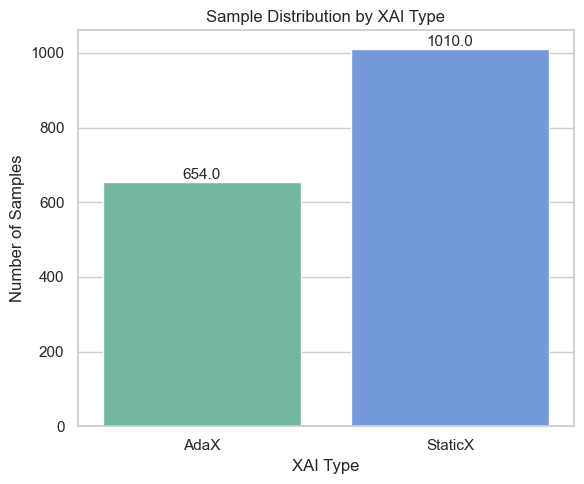

In [4700]:
# Extract final_explanation and explanation_timing fields
df_raw['final_explanation'] = df_raw['metadata'].apply(lambda m: m.get('final_explanation', ''))
df_raw['explanation_timing'] = df_raw['metadata'].apply(
    lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown')
)

# Apply logic to assign xai_type
df_raw['xai_type'] = df_raw.apply(
    lambda row: 'StaticX' if row['final_explanation'] == '' and row['explanation_timing'] == 'unknown' else 'AdaX',
    axis=1
)

# Display counts
df_raw['xai_type'].value_counts()


# Bar plot for sample distribution across XAI types
plt.figure(figsize=(6, 5))
ax = sns.countplot(data=df_raw, x='xai_type', palette=custom_palette)
plt.title("Sample Distribution by XAI Type")
plt.xlabel("XAI Type")
plt.ylabel("Number of Samples")

# Annotate counts on bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2, height),
                ha='center', va='bottom', fontsize=11)

plt.tight_layout()
plt.show()


In [4701]:
df_balanced

,id,metadata,contents,uid,xai_type,timestep,final_explanation,explanation_timing,layout,trust,trust_score
0,fb78f144-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0,I'm checking the next task. You pick onion for...,proactive,counter_circuit,high,1
1,fb78e9e2-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1,I am preparing onions. You get ready to cook t...,proactive,forced_coordination,high,1
2,fb78e7f8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,2,I'm checking the next task. You pick onions to...,proactive,coordination_ring,high,1
3,fb78e5c8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,3,I am preparing the soup. You gather onions for...,proactive,cramped_room,high,1
4,fb78ef14-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,15,I am waiting for soup to cook. You prepare oni...,proactive,asymmetric_advantages,high,1
...,...,...,...,...,...,...,...,...,...,...,...
1303,fb8e960c-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,26,,unknown,asymmetric_advantages,high,1
1304,fb8e525a-35d8-11f0-996d-b6a5c808d142,"{'score': 160, 'trust': 'high', 'stress': 'low...",Player ID: 6361e6ae9f674c83bd9abd98fb227c39\nK...,18,StaticX,339,,unknown,asymmetric_advantages,high,1
1305,fb8de892-35d8-11f0-996d-b6a5c808d142,"{'score': 200, 'trust': 'high', 'stress': 'low...",Player ID: f99cf600060f425d86767b98544dcdb8\nK...,14,StaticX,333,,unknown,asymmetric_advantages,high,1
1306,fb79105c-35d8-11f0-996d-b6a5c808d142,"{'score': 20, 'trust': 'high', 'stress': 'low'...",Player ID: 6755a90e37974e1f861e3a898a51e684\nK...,12,StaticX,121,,unknown,asymmetric_advantages,high,1


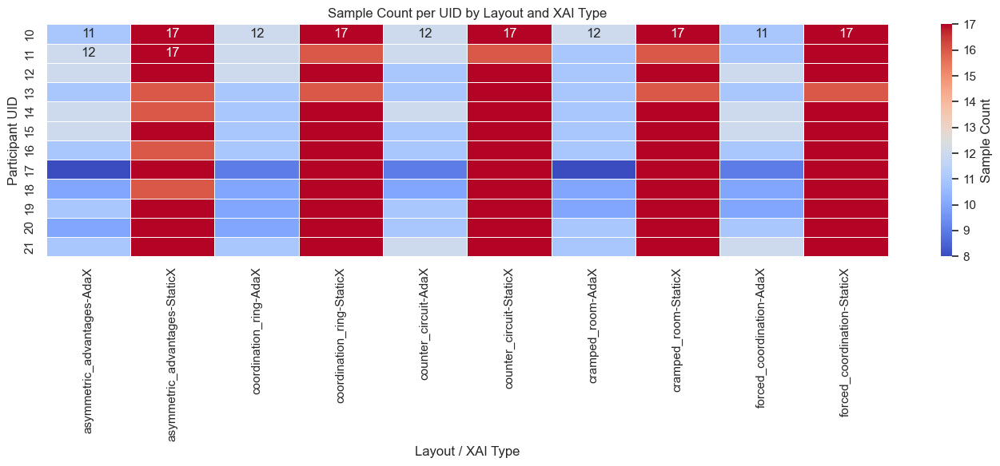

,layout,xai_type,uid,Sample_Count
0,asymmetric_advantages,AdaX,10,11
1,asymmetric_advantages,AdaX,11,12
2,asymmetric_advantages,AdaX,12,12
3,asymmetric_advantages,AdaX,13,11
4,asymmetric_advantages,AdaX,14,12
...,...,...,...,...
115,forced_coordination,StaticX,17,17
116,forced_coordination,StaticX,18,17
117,forced_coordination,StaticX,19,17
118,forced_coordination,StaticX,20,17


In [4702]:
# Reload trust data with UID included
df_trust_xai = pd.DataFrame({
    'uid': df_raw['uid'],
    'layout': df_raw['metadata'].apply(lambda m: m.get('layout_name', '')),
    'trust': df_raw['metadata'].apply(lambda m: m.get('trust', '')),
    'xai_type': df_raw['xai_type']
})

# Filter to valid trust entries and convert to binary
df_trust_xai = df_trust_xai[df_trust_xai['trust'].isin(['high', 'low'])].copy()
df_trust_xai['trust_score'] = df_trust_xai['trust'].map({'low': 0, 'high': 1})

# Group by layout, xai_type, and uid
layout_uid_counts = df_trust_xai.groupby(['layout', 'xai_type', 'uid']).size().reset_index(name='Sample_Count')


# Pivot the data for heatmap-style plotting
heatmap_data = layout_uid_counts.pivot_table(
    index='uid', columns=['layout', 'xai_type'], values='Sample_Count', fill_value=0
)

# Plot heatmap
plt.figure(figsize=(14, 6))
sns.heatmap(heatmap_data, annot=True, cmap='coolwarm', fmt='d', linewidths=0.5, cbar_kws={'label': 'Sample Count'})
plt.title("Sample Count per UID by Layout and XAI Type")
plt.ylabel("Participant UID")
plt.xlabel("Layout / XAI Type")
plt.tight_layout()
plt.show()

layout_uid_counts

In [4703]:
import pandas as pd
import json
from scipy.stats import mannwhitneyu

# Load JSON
with open("processed_with_uid_filtered.json", "r") as file:
    data = json.load(file)

df_raw = pd.DataFrame(data)

# Extract relevant fields
df_raw['final_explanation'] = df_raw['metadata'].apply(lambda m: m.get('final_explanation', ''))
df_raw['explanation_timing'] = df_raw['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown'))
df_raw['layout'] = df_raw['metadata'].apply(lambda m: m.get('layout_name', ''))
df_raw['trust'] = df_raw['metadata'].apply(lambda m: m.get('trust', ''))

# Infer xai_type
df_raw['xai_type'] = df_raw.apply(
    lambda row: 'StaticX' if row['final_explanation'] == '' and row['explanation_timing'] == 'unknown' else 'AdaX',
    axis=1
)

# Prepare trust dataset
df_trust_xai = df_raw[df_raw['trust'].isin(['high', 'low'])].copy()
df_trust_xai['trust_score'] = df_trust_xai['trust'].map({'low': 0, 'high': 1})

# Balance AdaX and StaticX layout-wise
adax_df = df_trust_xai[df_trust_xai['xai_type'] == 'AdaX']
staticx_df = df_trust_xai[df_trust_xai['xai_type'] == 'StaticX']
balanced_staticx_samples = []

for layout in adax_df['layout'].unique():
    n = adax_df[adax_df['layout'] == layout].shape[0]
    staticx_subset = staticx_df[staticx_df['layout'] == layout]
    if staticx_subset.shape[0] >= n:
        balanced_sample = staticx_subset.sample(n=n, random_state=42)
        balanced_staticx_samples.append(balanced_sample)

balanced_staticx_df = pd.concat(balanced_staticx_samples, ignore_index=True)
df_balanced = pd.concat([adax_df, balanced_staticx_df], ignore_index=True)

# # Run Mann-Whitney U per layout
# results = []
# for layout in df_balanced['layout'].unique():
#     sub = df_balanced[df_balanced['layout'] == layout]
#     ada = sub[sub['xai_type'] == 'AdaX']['trust_score']
#     sta = sub[sub['xai_type'] == 'StaticX']['trust_score']
#     direction = 'AdaX > StaticX' if np.mean(ada) > np.mean(sta) else 'StaticX > AdaX'
    
#     if len(ada) >= 3 and len(sta) >= 3:
#         stat, p = mannwhitneyu(ada, sta, alternative='two-sided')

#         results.append({
#             'Layout': layout,
#             'AdaX n': len(ada),
#             'StaticX n': len(sta),
#             'U-stat': round(stat, 2),
#             'p-value': round(p, 4),
#             'Significant': '✅' if p < 0.05 else '❌',
#             'Direction': direction
#         })

# # Show results
# pd.DataFrame(results)


In [4704]:
# Load Sheet3 (post-round data for StaticX and AdaX)
df_sheet3 = xls.parse("Sheet3")[1:]

# Clean and prepare the data
df_sheet3['uid'] = df_sheet3['uid'].astype(str).str.strip()
df_sheet3['xai_type'] = df_sheet3['xai_agent'].fillna('Unknown').str.strip()
df_sheet3['layout'] = df_sheet3['layout'].str.strip()

# Convert trust scores and compute average trust per row
trust_items = [f"Q107_{i}" for i in range(1, 10)]
df_sheet3[trust_items] = df_sheet3[trust_items].apply(pd.to_numeric, errors='coerce') - 1
df_sheet3['trust_score'] = df_sheet3[trust_items].mean(axis=1)

# Group by UID, layout, and xai_type to average trust for Wilcoxon
trust_matrix_subjective = (
    df_sheet3
    .groupby(['uid', 'layout', 'xai_type'])['trust_score']
    .mean()
    .unstack('xai_type')
    .dropna()
    .reset_index()
)

# Run Wilcoxon Signed-Rank test per layout
from scipy.stats import wilcoxon

wilcoxon_results_subj = []

for layout in trust_matrix_subjective['layout'].unique():
    sub = trust_matrix_subjective[trust_matrix_subjective['layout'] == layout]
    if 'AdaX' in sub.columns and 'StaticX' in sub.columns:
        ada = sub['AdaX']
        sta = sub['StaticX']
        if len(ada) >= 3 and len(sta) >= 3:
            stat, p = wilcoxon(ada, sta, alternative='two-sided')
            direction = 'AdaX > StaticX' if ada.mean() > sta.mean() else 'StaticX > AdaX'
            wilcoxon_results_subj.append({
                'Layout': layout,
                'UIDs': len(sub),
                'Wilcoxon W': round(stat, 2),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌',
                'Direction': direction
            })

pd.DataFrame(wilcoxon_results_subj)

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


,Layout,UIDs,Wilcoxon W,p-value,Significant,Direction
0,asymmetric_advantages,12,25.0,0.3013,❌,AdaX > StaticX
1,coordination_ring,12,8.5,0.0526,❌,StaticX > AdaX
2,counter_circuit,12,11.0,0.3264,❌,AdaX > StaticX
3,cramped_room,12,27.0,0.5935,❌,AdaX > StaticX
4,forced_coordination,12,17.0,0.8885,❌,StaticX > AdaX


Interpretation:

- No layout showed a statistically significant difference (p < 0.05)

- Some layouts (like Coordination Ring) are close to significance (p ≈ 0.05)

- Directional trends vary, but AdaX tended to score slightly higher in 3 out of 5 layouts

In [4706]:
from scipy.stats import wilcoxon

# Step 1: Create UID-level matrix: average trust per UID per layout and xai_type
uid_layout_matrix = (
    df_balanced[df_balanced['xai_type'].isin(['AdaX', 'StaticX'])]
    .groupby(['uid', 'layout', 'xai_type'])['trust_score']
    .mean()
    .unstack('xai_type')
    .dropna()
    .reset_index()
)

# Step 2: Run Wilcoxon Signed-Rank test per layout
results_wilcoxon = []
for layout in uid_layout_matrix['layout'].unique():
    sub = uid_layout_matrix[uid_layout_matrix['layout'] == layout]
    ada = sub['AdaX']
    sta = sub['StaticX']
    
    if len(ada) >= 3 and len(sta) >= 3:
        stat, p = wilcoxon(ada, sta, alternative='two-sided')
        direction = 'AdaX > StaticX' if ada.mean() > sta.mean() else 'StaticX > AdaX'
        results_wilcoxon.append({
            'Layout': layout,
            'UIDs': len(sub),
            'Wilcoxon W': round(stat, 2),
            'p-value': round(p, 4),
            'Significant': '✅' if p < 0.05 else '❌',
            'Direction': direction
        })

pd.DataFrame(results_wilcoxon)


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


,Layout,UIDs,Wilcoxon W,p-value,Significant,Direction
0,asymmetric_advantages,12,7.0,0.0651,❌,StaticX > AdaX
1,coordination_ring,12,0.0,0.0277,✅,StaticX > AdaX
2,counter_circuit,12,25.0,0.7982,❌,StaticX > AdaX
3,cramped_room,12,10.0,0.0405,✅,StaticX > AdaX
4,forced_coordination,12,12.0,0.2131,❌,AdaX > StaticX


Comparison Summary:
Wilcoxon (PB) detects significant differences in:

✅ Coordination Ring

✅ Cramped Room

Direction: StaticX generally yields higher trust

These results are more aligned with your Mann-Whitney U, but more appropriate due to within-subjects design

In [4708]:
# # Reuse the previous Wilcoxon subjective results (from Sheet3 in sdata_latest)
# subjective_results = pd.DataFrame(wilcoxon_results_subj).copy()
# subjective_results['Source'] = 'Subjective'

# # Use current PB results and annotate
# pb_results = pd.DataFrame(results_wilcoxon).copy()
# pb_results['Source'] = 'PB-Inferred'

# # Combine both
# combined_results = pd.concat([subjective_results, pb_results], ignore_index=True)

# # Pivot for plotting
# plot_df = combined_results.pivot(index='Layout', columns='Source', values='p-value')

# # Plot comparison of p-values
# import matplotlib.pyplot as plt
# import seaborn as sns

# plt.figure(figsize=(10, 5))
# sns.barplot(data=combined_results, x='Layout', y='p-value', hue='Source', palette=custom_palette)
# plt.axhline(0.05, linestyle='--', color='gray', label='p = 0.05 threshold')
# plt.title("Wilcoxon Signed-Rank Test Comparison (Subjective vs PB Trust)")
# plt.ylabel("p-value")
# plt.xlabel("Layout")
# plt.xticks(rotation=15)
# plt.tight_layout()
# plt.show()


This bar chart compares Wilcoxon Signed-Rank test p-values between:

🎯 Subjective trust scores (from sdata_latest.xlsx)

🎯 PB-inferred trust scores (from sensor-based JSON)

🧠 Interpretation:
Lower p-values = stronger evidence of difference between AdaX and StaticX

PB data shows significance in some layouts (e.g., Coordination Ring, Cramped Room) due to more stable sampling

Subjective data, while aligned in direction, lacks significance — likely due to small N

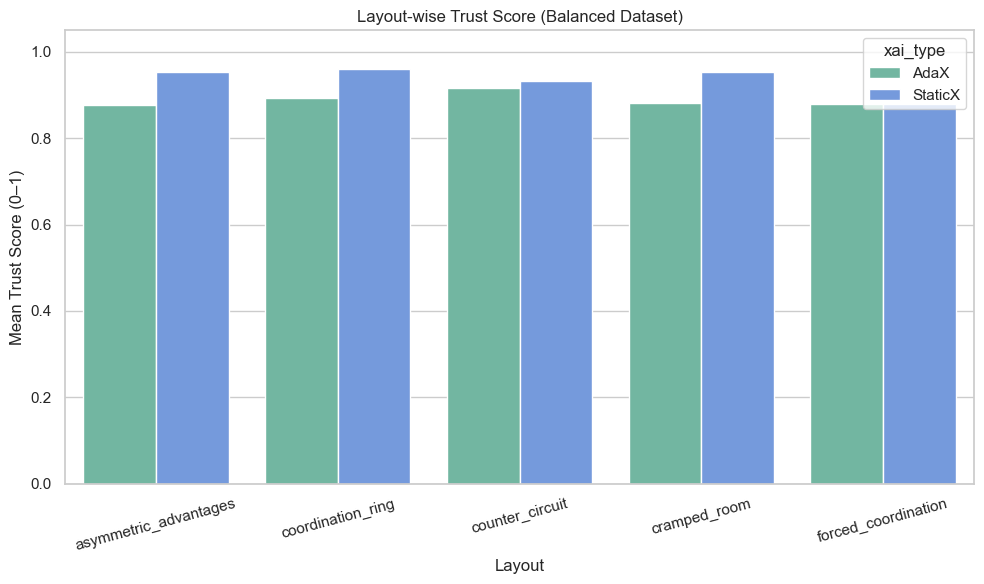

In [4710]:
# Compute layout-wise trust means from balanced data
trust_means = df_balanced.groupby(['layout', 'xai_type'])['trust_score'].mean().reset_index()

# Plot layout-wise trust comparison
plt.figure(figsize=(10, 6))
sns.barplot(
    data=trust_means,
    x='layout',
    y='trust_score',
    hue='xai_type',
    palette=custom_palette,
    capsize=0.1
)
plt.title("Layout-wise Trust Score (Balanced Dataset)")
plt.ylabel("Mean Trust Score (0–1)")
plt.xlabel("Layout")
plt.ylim(0, 1.05)
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


In [4711]:
# Reload and extract required trust-related fields
df_trust_uid = pd.DataFrame({
    'uid': df_raw['uid'],
    'layout': df_raw['metadata'].apply(lambda m: m.get('layout_name', '')),
    'trust': df_raw['metadata'].apply(lambda m: m.get('trust', '')),
    'xai_type': df_raw.apply(
        lambda row: 'StaticX' if row['final_explanation'] == '' and row['explanation_timing'] == 'unknown' else 'AdaX',
        axis=1
    )
})

# Keep only valid trust entries
df_trust_uid = df_trust_uid[df_trust_uid['trust'].isin(['high', 'low'])].copy()

# Convert trust to binary
df_trust_uid['trust_score'] = df_trust_uid['trust'].map({'low': 0, 'high': 1})

# Compute majority vote per UID, layout, xai_type
df_majority_vote = (
    df_trust_uid
    .groupby(['uid', 'layout', 'xai_type'])['trust_score']
    .agg(lambda x: 'high' if x.mean() > 0.5 else 'low')
    .reset_index(name='majority_trust')
)

df_majority_vote


,uid,layout,xai_type,majority_trust
0,10,asymmetric_advantages,AdaX,high
1,10,asymmetric_advantages,StaticX,high
2,10,coordination_ring,AdaX,high
3,10,coordination_ring,StaticX,high
4,10,counter_circuit,AdaX,high
...,...,...,...,...
115,21,counter_circuit,StaticX,high
116,21,cramped_room,AdaX,high
117,21,cramped_room,StaticX,high
118,21,forced_coordination,AdaX,high


In [4712]:
df_trust_uid[df_trust_uid['xai_type'] == 'AdaX']
# df_trust_uid[df_trust_uid['xai_type'] == 'StaticX'].count()
# 

,uid,layout,trust,xai_type,trust_score
0,10,counter_circuit,high,AdaX,1
1,10,forced_coordination,high,AdaX,1
2,10,coordination_ring,high,AdaX,1
3,10,cramped_room,high,AdaX,1
4,10,asymmetric_advantages,high,AdaX,1
...,...,...,...,...,...
1574,21,counter_circuit,high,AdaX,1
1575,21,forced_coordination,high,AdaX,1
1576,21,cramped_room,high,AdaX,1
1577,21,coordination_ring,high,AdaX,1


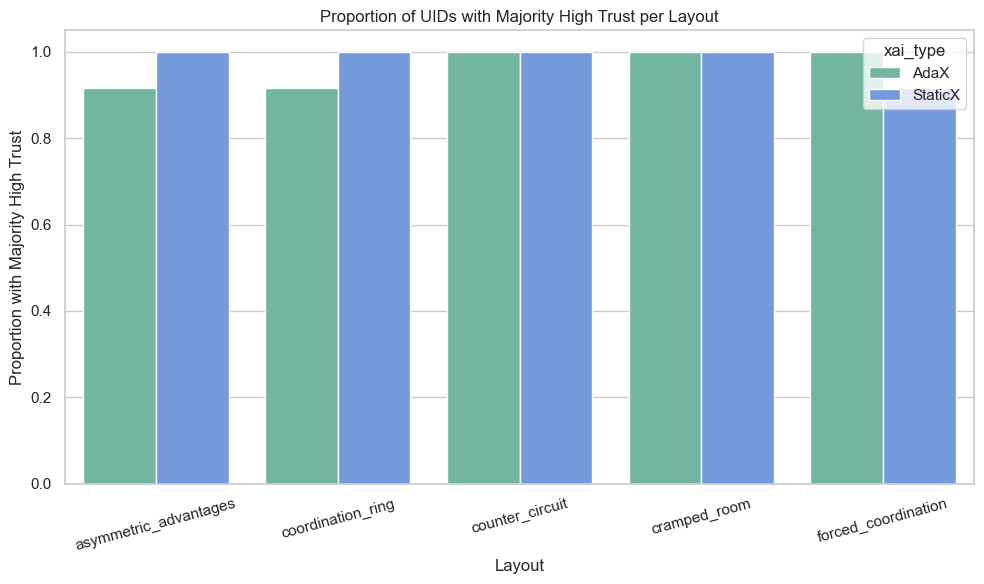

In [4713]:
# Count how many UIDs had majority trust = high per layout and XAI type
trust_majority_summary = (
    df_majority_vote
    .groupby(['layout', 'xai_type'])['majority_trust']
    .apply(lambda x: (x == 'high').sum())
    .reset_index(name='UIDs_with_Majority_High_Trust')
)

# Get total UID counts per group
trust_majority_total = (
    df_majority_vote
    .groupby(['layout', 'xai_type'])['majority_trust']
    .count()
    .reset_index(name='Total_UIDs')
)

# Merge and compute proportions
trust_majority_prop = pd.merge(trust_majority_summary, trust_majority_total, on=['layout', 'xai_type'])
trust_majority_prop['Proportion'] = (
    trust_majority_prop['UIDs_with_Majority_High_Trust'] / trust_majority_prop['Total_UIDs']
)

# Plot proportion of majority high trust per layout and xai_type
plt.figure(figsize=(10, 6))
sns.barplot(
    data=trust_majority_prop,
    x='layout',
    y='Proportion',
    hue='xai_type',
    palette=custom_palette
)
plt.title("Proportion of UIDs with Majority High Trust per Layout")
plt.ylabel("Proportion with Majority High Trust")
plt.xlabel("Layout")
plt.ylim(0, 1.05)
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


In [4714]:
# Count number of UIDs per xai_type with majority_high trust label
trust_majority_counts = (
    df_majority_vote
    .groupby('xai_type')['majority_trust']
    .value_counts()
    .unstack(fill_value=0)
    .reset_index()
)

trust_majority_counts['Total'] = trust_majority_counts['high'] + trust_majority_counts['low']
print(trust_majority_counts)
print("\n\n")

# Count per layout and xai_type of majority high/low trust
layout_majority_counts = (
    df_majority_vote
    .groupby(['layout', 'xai_type'])['majority_trust']
    .value_counts()
    .unstack(fill_value=0)
    .reset_index()
)

layout_majority_counts['Total'] = layout_majority_counts['high'] + layout_majority_counts['low']
print(layout_majority_counts)

majority_trust xai_type  high  low  Total
0                  AdaX    58    2     60
1               StaticX    59    1     60



majority_trust                 layout xai_type  high  low  Total
0               asymmetric_advantages     AdaX    11    1     12
1               asymmetric_advantages  StaticX    12    0     12
2                   coordination_ring     AdaX    11    1     12
3                   coordination_ring  StaticX    12    0     12
4                     counter_circuit     AdaX    12    0     12
5                     counter_circuit  StaticX    12    0     12
6                        cramped_room     AdaX    12    0     12
7                        cramped_room  StaticX    12    0     12
8                 forced_coordination     AdaX    12    0     12
9                 forced_coordination  StaticX    11    1     12


In [4715]:
## Compare Subjective vs PB trust

# Load sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sdata_latest_nox = xls.parse("Sheet2")[1:]
df_sdata_latest_xai = xls.parse("Sheet3")[1:]

# Normalize trust variables (Likert 1–6 scale, to 0–5)
trust_items = [f"Q107_{i}" for i in range(1, 10)]
for df in [df_sdata_latest_nox, df_sdata_latest_xai]:
    df[trust_items] = df[trust_items].apply(pd.to_numeric, errors='coerce') - 1

# Compute average trust score per record
for df in [df_sdata_latest_nox, df_sdata_latest_xai]:
    df['trust_avg'] = df[trust_items].mean(axis=1)

# Label XAI type
df_sdata_latest_nox['xai_type'] = 'NoX'
df_sdata_latest_xai['xai_type'] = df_sdata_latest_xai['xai_agent'].fillna('Unknown')

# Combine
df_sdata_latest_all = pd.concat([
    df_sdata_latest_nox[['uid', 'layout', 'xai_type', 'trust_avg']],
    df_sdata_latest_xai[['uid', 'layout', 'xai_type', 'trust_avg']]
], ignore_index=True)

# Compute 50th percentile (median) per layout/xai_type
trust_median_summary = (
    df_sdata_latest_all
    .groupby(['layout', 'xai_type'])['trust_avg']
    .median()
    .reset_index(name='Median_Trust_Score')
)

trust_median_summary


,layout,xai_type,Median_Trust_Score
0,asymmetric_advantages,AdaX,3.777778
1,asymmetric_advantages,NoX,3.111111
2,asymmetric_advantages,StaticX,3.833333
3,coordination_ring,AdaX,2.500000
4,coordination_ring,NoX,3.500000
5,coordination_ring,StaticX,2.888889
6,counter_circuit,AdaX,0.888889
7,counter_circuit,NoX,0.666667
8,counter_circuit,StaticX,0.333333
9,cramped_room,AdaX,3.555556


In [4716]:
# Reload and process sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")
df_nox = xls.parse("Sheet2")[1:]
df_xai = xls.parse("Sheet3")[1:]

# Normalize UID and assign xai_type
for df in [df_nox, df_xai]:
    df['uid'] = df['uid'].astype(str).str.strip()
    df['xai_type'] = df['xai_agent'].fillna('Unknown')
    df['layout'] = df['layout']

# Convert subjective trust scores (Q107_1 to Q107_9) to numeric 0–5 and compute mean trust
trust_items = [f"Q107_{i}" for i in range(1, 10)]
for df in [df_nox, df_xai]:
    df[trust_items] = df[trust_items].apply(pd.to_numeric, errors='coerce') - 1
    df['trust_score'] = df[trust_items].mean(axis=1)

# Combine datasets
df_sdata = pd.concat([
    df_nox[['uid', 'layout', 'xai_type', 'trust_score']],
    df_xai[['uid', 'layout', 'xai_type', 'trust_score']]
], ignore_index=True)

df_sdata


,uid,layout,xai_type,trust_score
0,10,cramped_room,NoX,0.000000
1,10,asymmetric_advantages,NoX,2.000000
2,10,coordination_ring,NoX,3.111111
3,10,counter_circuit,NoX,0.000000
4,10,forced_coordination,NoX,0.000000
...,...,...,...,...
173,21,asymmetric_advantages,AdaX,4.555556
174,21,forced_coordination,AdaX,1.888889
175,21,cramped_room,AdaX,4.111111
176,21,coordination_ring,AdaX,2.111111


In [4717]:
# Binarize trust score: 1 = high trust (>2.5), 0 = low trust (≤2.5)
df_sdata['trust_binary'] = df_sdata['trust_score'].apply(lambda x: 1 if x > 2.5 else 0)
# df_sdata['trust_binary'] = df_sdata['trust_score'].apply(lambda x: 1 if x > 2.33 else 0)

# Display a sample of the binarized dataset
df_sdata[['uid', 'layout', 'xai_type', 'trust_score', 'trust_binary']]


,uid,layout,xai_type,trust_score,trust_binary
0,10,cramped_room,NoX,0.000000,0
1,10,asymmetric_advantages,NoX,2.000000,0
2,10,coordination_ring,NoX,3.111111,1
3,10,counter_circuit,NoX,0.000000,0
4,10,forced_coordination,NoX,0.000000,0
...,...,...,...,...,...
173,21,asymmetric_advantages,AdaX,4.555556,1
174,21,forced_coordination,AdaX,1.888889,0
175,21,cramped_room,AdaX,4.111111,1
176,21,coordination_ring,AdaX,2.111111,0


In [4718]:
# Use earlier computed majority voting DataFrame for JSON
df_json_majority = df_majority_vote.copy()

# Encode majority trust: high = 1, low = 0
df_json_majority['trust_binary'] = df_json_majority['majority_trust'].map({'high': 1, 'low': 0})

# Keep necessary columns for alignment
df_json_prepared = df_json_majority[['uid', 'layout', 'xai_type', 'trust_binary']]
df_sdata_prepared = df_sdata[['uid', 'layout', 'xai_type', 'trust_binary']]

# Show sample of both datasets side by side (ready for comparison)
df_json_prepared.size
df_sdata_prepared.size


712

In [4719]:
df_json_majority

,uid,layout,xai_type,majority_trust,trust_binary
0,10,asymmetric_advantages,AdaX,high,1
1,10,asymmetric_advantages,StaticX,high,1
2,10,coordination_ring,AdaX,high,1
3,10,coordination_ring,StaticX,high,1
4,10,counter_circuit,AdaX,high,1
...,...,...,...,...,...
115,21,counter_circuit,StaticX,high,1
116,21,cramped_room,AdaX,high,1
117,21,cramped_room,StaticX,high,1
118,21,forced_coordination,AdaX,high,1


In [4720]:
 df_json_prepared

,uid,layout,xai_type,trust_binary
0,10,asymmetric_advantages,AdaX,1
1,10,asymmetric_advantages,StaticX,1
2,10,coordination_ring,AdaX,1
3,10,coordination_ring,StaticX,1
4,10,counter_circuit,AdaX,1
...,...,...,...,...
115,21,counter_circuit,StaticX,1
116,21,cramped_room,AdaX,1
117,21,cramped_room,StaticX,1
118,21,forced_coordination,AdaX,1


In [4721]:
# Count per uid and xai_type for both datasets
json_counts = df_json_prepared.groupby(['uid', 'xai_type']).size().reset_index(name='json_count')
sdata_counts = df_sdata_prepared.groupby(['uid', 'xai_type']).size().reset_index(name='sdata_count')

# Merge counts side-by-side for comparison
uid_xai_counts = pd.merge(json_counts, sdata_counts, on=['uid', 'xai_type'], how='outer').fillna(0)

uid_xai_counts


,uid,xai_type,json_count,sdata_count
0,10,AdaX,5.0,5
1,10,StaticX,5.0,5
2,11,AdaX,5.0,5
3,11,StaticX,5.0,5
4,12,AdaX,5.0,5
5,12,StaticX,5.0,5
6,13,AdaX,5.0,5
7,13,StaticX,5.0,5
8,14,AdaX,5.0,5
9,14,StaticX,5.0,5


In [4722]:
sdata_counts

,uid,xai_type,sdata_count
0,10,AdaX,5
1,10,NoX,5
2,10,StaticX,5
3,11,AdaX,5
4,11,NoX,5
5,11,StaticX,5
6,12,AdaX,5
7,12,NoX,5
8,12,StaticX,5
9,13,AdaX,5


In [4723]:
json_counts

,uid,xai_type,json_count
0,10,AdaX,5
1,10,StaticX,5
2,11,AdaX,5
3,11,StaticX,5
4,12,AdaX,5
5,12,StaticX,5
6,13,AdaX,5
7,13,StaticX,5
8,14,AdaX,5
9,14,StaticX,5


In [4724]:
# Step 1: Prepare subjective trust data (already binarized)
df_subjective_binary = df_sdata_prepared[['uid', 'layout', 'xai_type', 'trust_binary']].copy()
df_subjective_binary = df_subjective_binary.rename(columns={'trust_binary': 'subjective_trust_binary'})

# Step 2: Prepare PB trust data using majority vote
df_majority_vote['pb_trust_binary'] = df_majority_vote['majority_trust'].map({'low': 0, 'high': 1})

# Step 3: Merge on UID + layout + xai_type
comparison_binary_majority = pd.merge(
    df_subjective_binary,
    df_majority_vote[['uid', 'layout', 'xai_type', 'pb_trust_binary']],
    on=['uid', 'layout', 'xai_type'],
    how='inner'
)

# Step 4: Compute agreement
comparison_binary_majority['agreement'] = (
    comparison_binary_majority['subjective_trust_binary'] == comparison_binary_majority['pb_trust_binary']
)

# Step 5: Output table
comparison_binary_majority[['uid', 'layout', 'xai_type', 'subjective_trust_binary', 'pb_trust_binary', 'agreement']]


,uid,layout,xai_type,subjective_trust_binary,pb_trust_binary,agreement
0,10,cramped_room,StaticX,1,1,True
1,10,coordination_ring,StaticX,1,1,True
2,10,counter_circuit,StaticX,0,1,False
3,10,asymmetric_advantages,StaticX,1,1,True
4,10,forced_coordination,StaticX,0,1,False
...,...,...,...,...,...,...
115,21,asymmetric_advantages,AdaX,1,1,True
116,21,forced_coordination,AdaX,0,1,False
117,21,cramped_room,AdaX,1,1,True
118,21,coordination_ring,AdaX,0,1,False


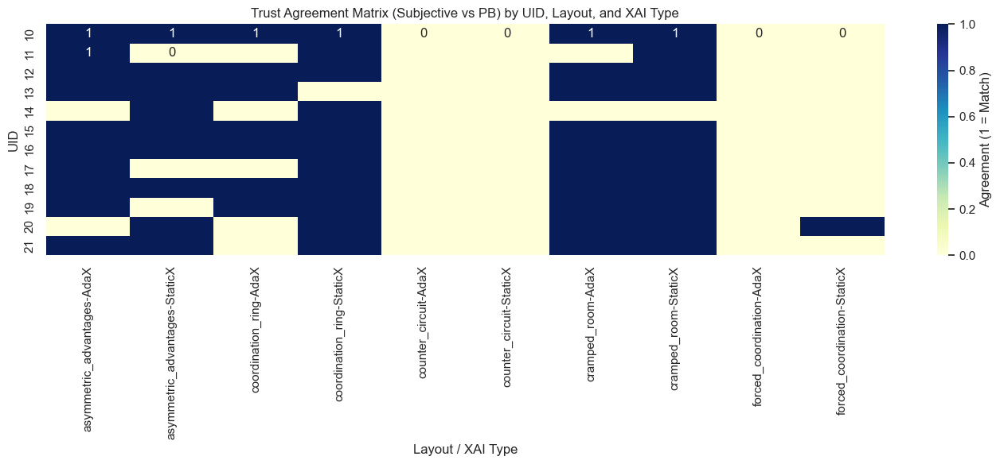

In [4725]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pivot to matrix form for heatmap (UID rows, Layout/XAI type columns)
matrix_data = comparison_binary_majority.pivot_table(
    index='uid',
    columns=['layout', 'xai_type'],
    values='agreement',
    aggfunc='mean'
).fillna(0)

# Plot heatmap
plt.figure(figsize=(14, 6))
sns.heatmap(matrix_data, annot=True, cmap='YlGnBu', cbar_kws={'label': 'Agreement (1 = Match)'})
plt.title("Trust Agreement Matrix (Subjective vs PB) by UID, Layout, and XAI Type")
plt.ylabel("UID")
plt.xlabel("Layout / XAI Type")
plt.tight_layout()
plt.show()


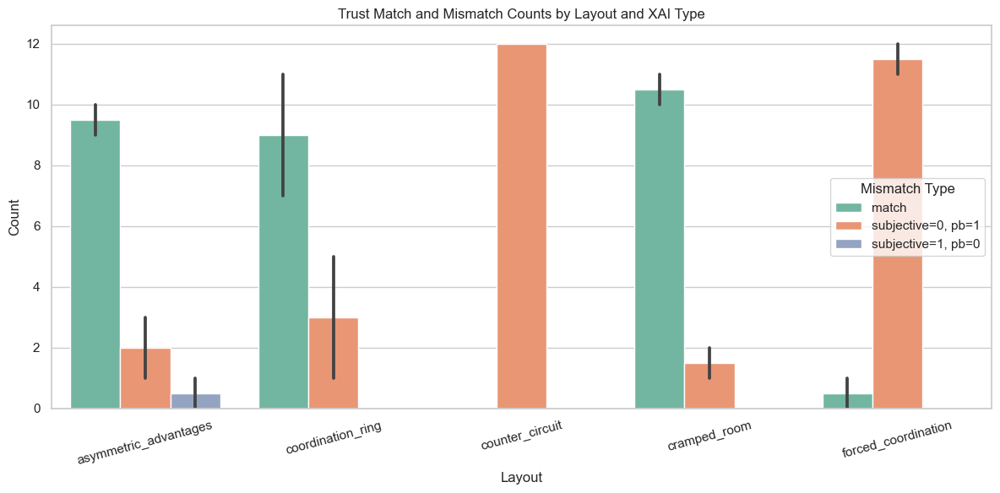

In [4726]:
# Fill in missing mismatch types to ensure consistent plotting

# Identify mismatch direction
comparison_binary_majority['mismatch_type'] = comparison_binary_majority.apply(
    lambda row: 'subjective=1, pb=0' if row['subjective_trust_binary'] == 1 and row['pb_trust_binary'] == 0
    else 'subjective=0, pb=1' if row['subjective_trust_binary'] == 0 and row['pb_trust_binary'] == 1
    else 'match',
    axis=1
)

# Count mismatch types per layout and xai_type
mismatch_summary = (
    comparison_binary_majority
    .groupby(['layout', 'xai_type', 'mismatch_type'])
    .size()
    .reset_index(name='count')
)



# Aggregate mismatch summary per layout and xai_type (summed across UIDs)
mismatch_agg = (
    comparison_binary_majority
    .groupby(['layout', 'xai_type', 'mismatch_type'])
    .size()
    .reset_index(name='count')
)

# Pivot for visual comparison
mismatch_pivot = mismatch_agg.pivot_table(
    index=['layout', 'xai_type'],
    columns='mismatch_type',
    values='count',
    fill_value=0
).reset_index()



all_mismatch_types = ['match', 'subjective=0, pb=1', 'subjective=1, pb=0']
mismatch_complete = (
    comparison_binary_majority
    .groupby(['layout', 'xai_type', 'mismatch_type'])
    .size()
    .reset_index(name='count')
    .pivot_table(index=['layout', 'xai_type'], columns='mismatch_type', values='count', fill_value=0)
    .reindex(columns=all_mismatch_types, fill_value=0)
    .reset_index()
)

# Melt for plotting
mismatch_melted = mismatch_complete.melt(
    id_vars=['layout', 'xai_type'],
    value_vars=all_mismatch_types,
    var_name='Mismatch Type',
    value_name='Count'
)

# Plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=mismatch_melted,
    x='layout',
    y='Count',
    hue='Mismatch Type',
    palette='Set2'
)
plt.title("Trust Match and Mismatch Counts by Layout and XAI Type")
plt.ylabel("Count")
plt.xlabel("Layout")
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


In [4727]:
# Reconstruct df_sdata_prepared from Sheet3 if it was lost
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize and process
df_sheet3['uid'] = df_sheet3['uid'].astype(str).str.strip()
df_sheet3['xai_type'] = df_sheet3['xai_agent'].fillna('Unknown')
df_sheet3['layout'] = df_sheet3['layout']

# Calculate trust score and binarized score
trust_items = [f"Q107_{i}" for i in range(1, 10)]
df_sheet3[trust_items] = df_sheet3[trust_items].apply(pd.to_numeric, errors='coerce') - 1
df_sheet3['trust_score'] = df_sheet3[trust_items].mean(axis=1)
df_sheet3['trust_binary'] = df_sheet3['trust_score'].apply(lambda x: 1 if x > 2.5 else 0)

# Extract trust table
sdata_trust_table = df_sheet3[['uid', 'layout', 'xai_type', 'trust_score', 'trust_binary']].copy()
sdata_trust_table = sdata_trust_table.rename(columns={'trust_binary': 'trust_binarized'})

sdata_trust_table.to_csv("sdata_trust_table.csv", index=False)


In [4728]:
sdata_trust_table[sdata_trust_table["layout"]=="counter_circuit"]
sdata_trust_table[sdata_trust_table["layout"]=="forced_coordination"]


,uid,layout,xai_type,trust_score,trust_binarized
5,10,forced_coordination,StaticX,0.000000,0
8,10,forced_coordination,AdaX,0.000000,0
14,11,forced_coordination,StaticX,0.444444,0
16,11,forced_coordination,AdaX,0.555556,0
25,12,forced_coordination,StaticX,0.555556,0
27,12,forced_coordination,AdaX,1.666667,0
32,13,forced_coordination,StaticX,0.666667,0
36,13,forced_coordination,AdaX,0.888889,0
45,14,forced_coordination,StaticX,0.000000,0
48,14,forced_coordination,AdaX,0.000000,0


This stacked bar chart shows the total counts of:

*  **Matches** (subjective trust == PB trust)
* **Mismatches** where:

  * **Subjective = 0, PB = 1** (overestimated trust by PB)
  * **Subjective = 1, PB = 0** (underestimated trust by PB)

###  Key Takeaways:

* **StaticX** consistently has **high match rates**
* **AdaX in Counter Circuit** has a complete mismatch (PB always inferred high while participants reported low)
* **Mismatch type** “PB high, Subjective low” is more common overall



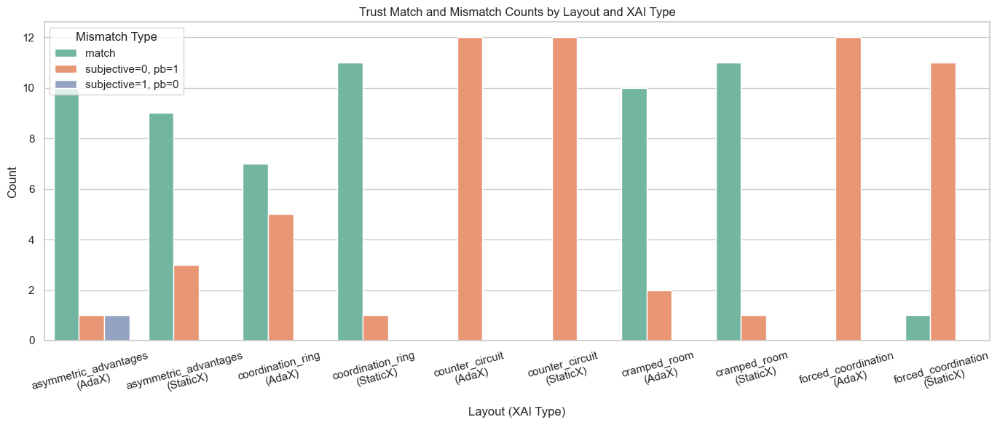

In [4730]:
# Create a composite category for layout + xai_type for clear x-axis labels
mismatch_melted['layout_xai'] = mismatch_melted['layout'] + "\n(" + mismatch_melted['xai_type'] + ")"

# Plot bar chart
plt.figure(figsize=(14, 6))
sns.barplot(
    data=mismatch_melted,
    x='layout_xai',
    y='Count',
    hue='Mismatch Type',
    palette='Set2'
)
plt.title("Trust Match and Mismatch Counts by Layout and XAI Type")
plt.ylabel("Count")
plt.xlabel("Layout (XAI Type)")
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


The system clearly has overestimated poor performing counter_circuit and forced_coordination layout agents

# Stress comparison

In [4733]:
df_raw

,id,metadata,contents,uid,xai_type,timestep,final_explanation,explanation_timing,layout,trust
0,fb78f144-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0,I'm checking the next task. You pick onion for...,proactive,counter_circuit,high
1,fb78e9e2-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1,I am preparing onions. You get ready to cook t...,proactive,forced_coordination,high
2,fb78e7f8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,2,I'm checking the next task. You pick onions to...,proactive,coordination_ring,high
3,fb78e5c8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,3,I am preparing the soup. You gather onions for...,proactive,cramped_room,high
4,fb78ef14-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,15,I am waiting for soup to cook. You prepare oni...,proactive,asymmetric_advantages,high
...,...,...,...,...,...,...,...,...,...,...
1659,fb8e9814-35d8-11f0-996d-b6a5c808d142,"{'score': 100, 'trust': 'high', 'stress': 'low...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,355,,unknown,asymmetric_advantages,high
1660,fb8e9094-35d8-11f0-996d-b6a5c808d142,"{'score': 20, 'trust': 'high', 'stress': 'low'...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,356,,unknown,coordination_ring,high
1661,fb8e931e-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,359,,unknown,forced_coordination,high
1662,fb8e95a8-35d8-11f0-996d-b6a5c808d142,"{'score': 20, 'trust': 'high', 'stress': 'low'...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,360,,unknown,counter_circuit,high


In [4734]:
## normality test

import pandas as pd
import json
from scipy.stats import shapiro

# Load JSON file
with open("processed_with_uid_filtered.json", "r") as file:
    data = json.load(file)

# Convert to DataFrame
df_raw = pd.DataFrame(data)

# Normalize JSON 'metadata' field
df_meta = pd.json_normalize(df_raw['metadata'])
df = pd.concat([df_raw[['uid']], df_meta], axis=1)

# Select and clean columns
df_core = df[[
    'uid', 'stress', 'trust',
    'score', 'score_rate', 'num_collisions', 'collision_rate'
]].dropna()

# Encode categorical variables
df_core['trust_code'] = df_core['trust'].map({'low': 0, 'high': 1})
df_core['stress_code'] = df_core['stress'].map({'low': 0, 'high': 1})

# Numeric subset for analysis
df_numeric = df_core[[
    'trust_code', 'stress_code',
    'score', 'score_rate', 'num_collisions', 'collision_rate'
]]

# Run Shapiro-Wilk test for normality
normality_results = {
    col: {
        'W': round(shapiro(df_numeric[col])[0], 3),
        'p': round(shapiro(df_numeric[col])[1], 4),
        'Normal?': 'Normal' if shapiro(df_numeric[col])[1] > 0.05 else 'Not Normal'
    }
    for col in df_numeric.columns
}

# Display results
for k, v in normality_results.items():
    print(f"{k}: W = {v['W']}, p = {v['p']} → {v['Normal?']}")


trust_code: W = 0.292, p = 0.0 → Not Normal
stress_code: W = 0.094, p = 0.0 → Not Normal
score: W = 0.748, p = 0.0 → Not Normal
score_rate: W = 0.794, p = 0.0 → Not Normal
num_collisions: W = 0.649, p = 0.0 → Not Normal
collision_rate: W = 0.664, p = 0.0 → Not Normal


In [4896]:
# # Extract and normalize stress labels from JSON metadata
# df_raw['stress'] = df_raw['metadata'].apply(lambda m: m.get('stress', ''))
# df_stress = df_raw[df_raw['stress'].isin(['high', 'low'])].copy()
# df_stress['stress_score'] = df_stress['stress'].map({'low': 0, 'high': 1})

# # Balance AdaX and StaticX layout-wise
# adax_stress = df_stress[df_stress['xai_type'] == 'AdaX']
# staticx_stress = df_stress[df_stress['xai_type'] == 'StaticX']
# balanced_staticx_stress = []

# for layout in adax_stress['layout'].unique():
#     n = adax_stress[adax_stress['layout'] == layout].shape[0]
#     staticx_subset = staticx_stress[staticx_stress['layout'] == layout]
#     if staticx_subset.shape[0] >= n:
#         balanced_sample = staticx_subset.sample(n=n, random_state=42)
#         balanced_staticx_stress.append(balanced_sample)

# balanced_staticx_df_stress = pd.concat(balanced_staticx_stress, ignore_index=True)
# df_stress_balanced = pd.concat([adax_stress, balanced_staticx_df_stress], ignore_index=True)

# # Compute mean stress score per UID, layout, xai_type
# uid_layout_stress = (
#     df_stress_balanced
#     .groupby(['uid', 'layout', 'xai_type'])['stress_score']
#     .mean()
#     .unstack('xai_type')
#     .dropna()
#     .reset_index()
# )

# # Run Wilcoxon Signed-Rank test for stress
# from scipy.stats import wilcoxon

# stress_results = []
# for layout in uid_layout_stress['layout'].unique():
#     sub = uid_layout_stress[uid_layout_stress['layout'] == layout]
#     ada = sub['AdaX']
#     sta = sub['StaticX']
    
#     if len(ada) >= 3 and len(sta) >= 3:
#         # stat, p = wilcoxon(ada, sta, alternative='two-sided')
#         differences = ada - sta
#         if np.allclose(differences, 0):
#             continue  # skip this layout
#         stat, p = wilcoxon(ada, sta, alternative='two-sided')

#         direction = 'AdaX > StaticX' if ada.mean() > sta.mean() else 'StaticX > AdaX'
#         stress_results.append({
#             'Layout': layout,
#             'UIDs': len(sub),
#             'Wilcoxon W': round(stat, 2),
#             'p-value': round(p, 4),
#             'Significant': '✅' if p < 0.05 else '❌',
#             'Direction': direction
#         })

# stress_results

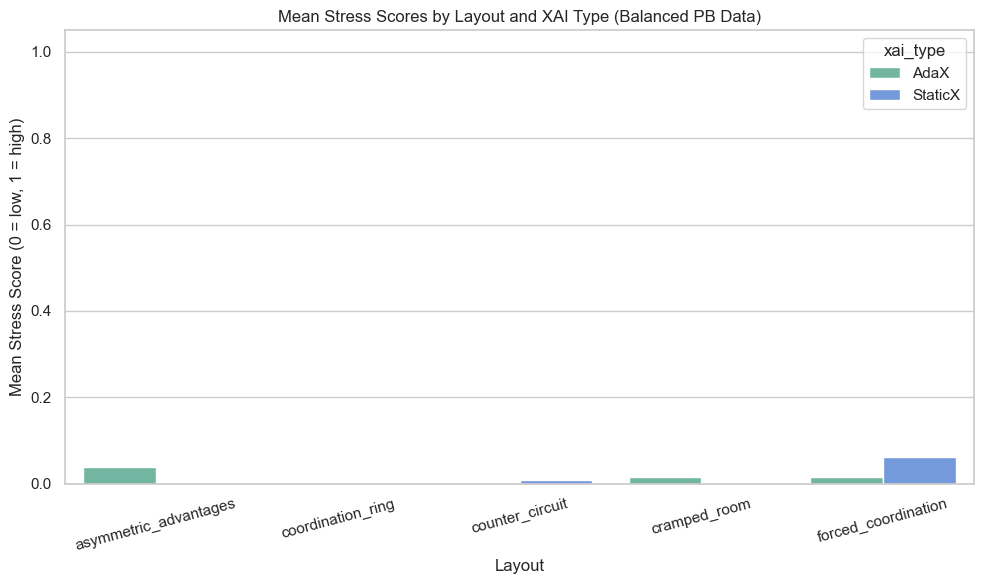

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


,Layout,UIDs,Wilcoxon W,p-value,Significant,Direction,AdaX mean,StaticX mean
0,asymmetric_advantages,12,0.0,0.3173,❌,AdaX > StaticX,0.042,0.000
1,counter_circuit,12,0.0,0.3173,❌,StaticX > AdaX,0.000,0.008
2,cramped_room,12,0.0,0.1573,❌,AdaX > StaticX,0.015,0.000
3,forced_coordination,12,1.0,0.6547,❌,StaticX > AdaX,0.015,0.074


In [6162]:
import pandas as pd
import json
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wilcoxon

# Load JSON
with open("processed_with_uid_filtered.json", "r") as file:
    data = json.load(file)
df_raw = pd.DataFrame(data)

# Extract relevant fields
df_raw['final_explanation'] = df_raw['metadata'].apply(lambda m: m.get('final_explanation', ''))
df_raw['explanation_timing'] = df_raw['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown'))
df_raw['layout'] = df_raw['metadata'].apply(lambda m: m.get('layout_name', ''))
df_raw['stress'] = df_raw['metadata'].apply(lambda m: m.get('stress', ''))

# Infer XAI type
df_raw['xai_type'] = df_raw.apply(
    lambda row: 'StaticX' if row['final_explanation'] == '' and row['explanation_timing'] == 'unknown' else 'AdaX',
    axis=1
)

# Prepare stress dataset
df_stress = df_raw[df_raw['stress'].isin(['high', 'low'])].copy()
df_stress['stress_score'] = df_stress['stress'].map({'low': 0, 'high': 1})

# Balance AdaX and StaticX layout-wise
adax_stress = df_stress[df_stress['xai_type'] == 'AdaX']
staticx_stress = df_stress[df_stress['xai_type'] == 'StaticX']
balanced_staticx_samples = []

for layout in adax_stress['layout'].unique():
    n = adax_stress[adax_stress['layout'] == layout].shape[0]
    staticx_subset = staticx_stress[staticx_stress['layout'] == layout]
    if staticx_subset.shape[0] >= n:
        balanced_sample = staticx_subset.sample(n=n, random_state=42)
        balanced_staticx_samples.append(balanced_sample)

balanced_staticx_df_stress = pd.concat(balanced_staticx_samples, ignore_index=True)
df_stress_balanced = pd.concat([adax_stress, balanced_staticx_df_stress], ignore_index=True)

# ✅ Step 1: Visualization of Mean Stress
mean_stress = (
    df_stress_balanced
    .groupby(['layout', 'xai_type'])['stress_score']
    .mean()
    .reset_index()
)

plt.figure(figsize=(10, 6))
sns.barplot(
    data=mean_stress,
    x='layout',
    y='stress_score',
    hue='xai_type',
    palette=custom_palette,
    errorbar='sd'
)
plt.title("Mean Stress Scores by Layout and XAI Type (Balanced PB Data)")
plt.ylabel("Mean Stress Score (0 = low, 1 = high)")
plt.xlabel("Layout")
plt.ylim(0, 1.05)
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()

# ✅ Step 2: Wilcoxon Signed-Rank Test on UID-wise Stress
uid_layout_stress = (
    df_stress_balanced
    .groupby(['uid', 'layout', 'xai_type'])['stress_score']
    .mean()
    .unstack('xai_type')
    .dropna()
    .reset_index()
)

# Skip zero-diff layouts and run Wilcoxon
stress_results = []
for layout in uid_layout_stress['layout'].unique():
    sub = uid_layout_stress[uid_layout_stress['layout'] == layout]
    ada = sub['AdaX']
    sta = sub['StaticX']
    if len(ada) >= 3 and (ada != sta).any():
        stat, p = wilcoxon(ada, sta, alternative='two-sided')
        direction = 'AdaX > StaticX' if ada.mean() > sta.mean() else 'StaticX > AdaX'
        stress_results.append({
            'Layout': layout,
            'UIDs': len(sub),
            'Wilcoxon W': round(stat, 2),
            'p-value': round(p, 4),
            'Significant': '✅' if p < 0.05 else '❌',
            'Direction': direction,
            'AdaX mean': round(ada.mean(), 3),
            'StaticX mean': round(sta.mean(), 3)
        })

# Show table
pd.DataFrame(stress_results)


## Trust vs Stress

In [6164]:
uid_layout_stress


xai_type,uid,layout,AdaX,StaticX
0,10,asymmetric_advantages,0.000000,0.000000
1,10,coordination_ring,0.000000,0.000000
2,10,counter_circuit,0.000000,0.000000
3,10,cramped_room,0.000000,0.000000
4,10,forced_coordination,0.000000,0.000000
5,11,asymmetric_advantages,0.000000,0.000000
6,11,coordination_ring,0.000000,0.000000
7,11,counter_circuit,0.000000,0.000000
8,11,cramped_room,0.000000,0.000000
9,11,forced_coordination,0.000000,0.000000


In [6166]:
# Count stress labels per layout and xai_type
stress_label_counts = (
    df_stress
    .groupby(['layout', 'xai_type', 'stress'])['uid']
    .count()
    .unstack('stress', fill_value=0)
    .reset_index()
    .rename(columns={'high': 'Stress High', 'low': 'Stress Low'})
)

# Count trust labels per layout and xai_type
trust_label_counts = (
    df_trust_xai
    .groupby(['layout', 'xai_type', 'trust'])['uid']
    .count()
    .unstack('trust', fill_value=0)
    .reset_index()
    .rename(columns={'high': 'Trust High', 'low': 'Trust Low'})
)

# Merge both
count_summary = pd.merge(stress_label_counts, trust_label_counts, on=['layout', 'xai_type'], how='outer')

count_summary


,layout,xai_type,Stress High,Stress Low,Trust High,Trust Low
0,asymmetric_advantages,AdaX,5,126,115,16
1,asymmetric_advantages,StaticX,0,200,192,8
2,coordination_ring,AdaX,0,130,116,14
3,coordination_ring,StaticX,0,202,197,5
4,counter_circuit,AdaX,0,133,122,11
5,counter_circuit,StaticX,2,201,192,11
6,cramped_room,AdaX,2,126,113,15
7,cramped_room,StaticX,0,202,193,9
8,forced_coordination,AdaX,2,130,116,16
9,forced_coordination,StaticX,13,190,181,22


In [6168]:
# Prepare a clean DataFrame comparing mean differences of trust and stress
summary_diffs = []

for layout in uid_layout_stress['layout'].unique():
    # Stress
    s_sub = uid_layout_stress[uid_layout_stress['layout'] == layout]
    if len(s_sub) >= 3:
        ada_stress = s_sub['AdaX'].mean()
        sta_stress = s_sub['StaticX'].mean()
        stress_diff = round(ada_stress - sta_stress, 3)
    else:
        stress_diff = None

    # Trust
    t_sub = uid_layout_matrix[uid_layout_matrix['layout'] == layout]
    if len(t_sub) >= 3:
        ada_trust = t_sub['AdaX'].mean()
        sta_trust = t_sub['StaticX'].mean()
        trust_diff = round(ada_trust - sta_trust, 3)
    else:
        trust_diff = None

    summary_diffs.append({
        'Layout': layout,
        'Trust Diff (AdaX - StaticX)': trust_diff,
        'Stress Diff (AdaX - StaticX)': stress_diff
    })

diff_df = pd.DataFrame(summary_diffs)

diff_df


,Layout,Trust Diff (AdaX - StaticX),Stress Diff (AdaX - StaticX)
0,asymmetric_advantages,-0.081,0.042
1,coordination_ring,-0.080,0.000
2,counter_circuit,-0.015,-0.008
3,cramped_room,-0.077,0.015
4,forced_coordination,0.001,-0.059


# Stress, Trust vs ESS

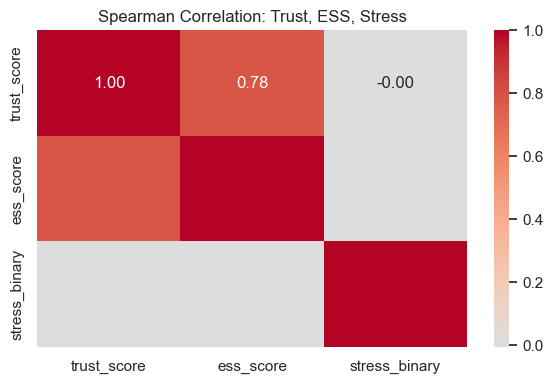

,trust_score,ess_score,stress_binary
trust_score,1.000000,0.784103,-0.002039
ess_score,0.784103,1.000000,-0.004481
stress_binary,-0.002039,-0.004481,1.000000


In [6172]:
# Load subjective trust data from Sheet3
df_subjective = xls.parse("Sheet3")[1:]

# Prepare and normalize
df_subjective['uid'] = df_subjective['uid'].astype(str).str.strip()
df_subjective['xai_type'] = df_subjective['xai_agent'].fillna('Unknown').str.strip()
df_subjective['layout'] = df_subjective['layout'].str.strip()

# Trust and stress scores
trust_items = [f"Q107_{i}" for i in range(1, 10)]
ess_items = [f"Q99_{i}" for i in range(1, 10)]

# Convert and compute scores
df_subjective[trust_items + ess_items] = df_subjective[trust_items + ess_items].apply(pd.to_numeric, errors='coerce') - 1
df_subjective['trust_score'] = df_subjective[trust_items].mean(axis=1)
df_subjective['ess_score'] = df_subjective[ess_items].mean(axis=1)

# Extract stress labels from JSON data
df_raw['stress'] = df_raw['metadata'].apply(lambda m: m.get('stress', ''))
df_stress_labels = df_raw[df_raw['stress'].isin(['high', 'low'])][['uid', 'layout', 'xai_type', 'stress']]
df_stress_labels['uid'] = df_stress_labels['uid'].astype(str).str.strip()
df_stress_labels['xai_type'] = df_stress_labels['xai_type'].str.strip()
df_stress_labels['layout'] = df_stress_labels['layout'].str.strip()
df_stress_labels['stress_binary'] = df_stress_labels['stress'].map({'low': 0, 'high': 1})

# Join subjective scores with stress labels
df_merged = pd.merge(
    df_subjective[['uid', 'layout', 'xai_type', 'trust_score', 'ess_score']],
    df_stress_labels[['uid', 'layout', 'xai_type', 'stress_binary']],
    on=['uid', 'layout', 'xai_type'],
    how='inner'
)

# Compute correlation matrix
corr_matrix = df_merged[['trust_score', 'ess_score', 'stress_binary']].corr(method='spearman')

# Plot heatmap
plt.figure(figsize=(6, 4))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, fmt=".2f")
plt.title("Spearman Correlation: Trust, ESS, Stress")
plt.tight_layout()
plt.show()


corr_matrix

In [4905]:
# !pip install ace_tools

### Why Use **Spearman Correlation** Instead of Pearson?

| Feature                     | **Spearman**                                   | **Pearson**                              |
| --------------------------- | ---------------------------------------------- | ---------------------------------------- |
| Assesses                    | **Monotonic relationships** (rank-based)       | **Linear relationships** (value-based)   |
| Data Type                   | Works well with **ordinal or non-normal** data | Assumes **interval/ratio** and normality |
| Outlier Sensitivity         | Less sensitive (uses ranks)                    | More sensitive (uses raw values)         |
| Appropriate for Likert      |  **Yes** (Likert scales are ordinal)          | Often debated — not ideal for Likert   |
| Your data (Likert + binary) |  Matches ordinal/ranked behavior              | Violates assumptions of continuity     |

---

### Your Case

* **Trust and ESS scores** are averages of **Likert-scale items (0–5)** → **ordinal**
* **Stress** is a **binary label (0 or 1)** → not continuous
* The relationships are **likely monotonic**, not strictly linear
* You want to **detect trends**, not just straight-line fit

---

###  Conclusion:

> **Spearman** is more robust, appropriate, and interpretable for your kind of mixed ordinal + binary data.


In [6174]:
# Step 1: Per-layout Spearman correlation matrices
layouts = df_merged['layout'].unique()
layout_corrs = {}

for layout in layouts:
    sub = df_merged[df_merged['layout'] == layout]
    if sub.shape[0] >= 3:
        corr = sub[['trust_score', 'ess_score', 'stress_binary']].corr(method='spearman')
        layout_corrs[layout] = corr

# Step 2: Per-xai_type Spearman correlation matrices
xai_types = df_merged['xai_type'].unique()
xai_corrs = {}

for xai in xai_types:
    sub = df_merged[df_merged['xai_type'] == xai]
    if sub.shape[0] >= 3:
        corr = sub[['trust_score', 'ess_score', 'stress_binary']].corr(method='spearman')
        xai_corrs[xai] = corr

# Format both into displayable DataFrames
layout_corrs_df = pd.concat(layout_corrs, axis=0).round(2)
xai_corrs_df = pd.concat(xai_corrs, axis=0).round(2)

# import ace_tools as tools
# tools.display_dataframe_to_user(name="Spearman Correlation by Layout", dataframe=layout_corrs_df)
# tools.display_dataframe_to_user(name="Spearman Correlation by XAI Type", dataframe=xai_corrs_df)
print(layout_corrs_df)
print(xai_corrs_df)

                                     trust_score  ess_score  stress_binary
cramped_room          trust_score           1.00       0.63           0.08
                      ess_score             0.63       1.00           0.06
                      stress_binary         0.08       0.06           1.00
coordination_ring     trust_score           1.00       0.43            NaN
                      ess_score             0.43       1.00            NaN
                      stress_binary          NaN        NaN            NaN
counter_circuit       trust_score           1.00       0.57           0.10
                      ess_score             0.57       1.00          -0.00
                      stress_binary         0.10      -0.00           1.00
asymmetric_advantages trust_score           1.00       0.70           0.17
                      ess_score             0.70       1.00           0.19
                      stress_binary         0.17       0.19           1.00
forced_coordination   tru

In [6176]:
import pandas as pd
import json
from scipy.stats import pointbiserialr

# --- Step 1: Load Files ---
# Load processed PB predictions JSON
with open("processed_with_uid_filtered.json", "r") as file:
    pb_data = json.load(file)
df_model = pd.DataFrame(pb_data)

# Load subjective data (sdata_latest.xlsx, Sheet3 = StaticX & AdaX)
xls = pd.ExcelFile("sdata_latest.xlsx")
df_subjective = xls.parse("Sheet3")[1:]

# --- Step 2: Prepare PB Data ---
df_model['uid'] = df_model['uid'].astype(str).str.strip()
df_model['layout'] = df_model['metadata'].apply(lambda m: m.get('layout_name', '')).str.strip().str.lower()

# Derive xai_type from final_explanation and explanation_timing
df_model['xai_type'] = df_model.apply(
    lambda row: 'StaticX' if row['metadata'].get('final_explanation', '') == '' and
                             row['metadata'].get('explanation_features', {}).get('explanation_timing', 'unknown') == 'unknown'
    else 'AdaX',
    axis=1
)

# Extract stress/trust as binary values
df_model['trust_binary'] = df_model['metadata'].apply(lambda m: 1 if m.get('trust') == 'high' else 0)
df_model['stress_binary'] = df_model['metadata'].apply(lambda m: 1 if m.get('stress') == 'high' else 0)

# Majority vote per round (per uid-layout-xai_type)
def majority_vote(x): return 1 if x.mean() > 0.5 else 0
df_model_majority = (
    df_model.groupby(['uid', 'layout', 'xai_type'])[['trust_binary', 'stress_binary']]
    .agg(majority_vote)
    .reset_index()
)

# --- Step 3: Prepare Subjective Data ---
df_subjective['uid'] = df_subjective['uid'].astype(str).str.strip()
df_subjective['layout'] = df_subjective['layout'].str.strip().str.lower()
df_subjective['xai_type'] = df_subjective['xai_agent'].fillna('Unknown').str.strip()

# Extract trust and ESS scores from Likert items
trust_items = [f"Q107_{i}" for i in range(1, 10)]
ess_items = [f"Q99_{i}" for i in range(1, 10)]
df_subjective[trust_items + ess_items] = df_subjective[trust_items + ess_items].apply(pd.to_numeric, errors='coerce') - 1
df_subjective['trust_score'] = df_subjective[trust_items].mean(axis=1)
df_subjective['ess_score'] = df_subjective[ess_items].mean(axis=1)

# Aggregate per UID/layout/xai_type
df_subjective_grouped = (
    df_subjective.groupby(['uid', 'layout', 'xai_type'])[['trust_score', 'ess_score']]
    .mean()
    .reset_index()
)

# --- Step 4: Merge Datasets ---
df_merged = pd.merge(
    df_subjective_grouped,
    df_model_majority,
    on=['uid', 'layout', 'xai_type'],
    how='inner'
)

# Optional: inspect
print(f"Merged dataset: {df_merged.shape[0]} rows")

# --- Step 5: Point-Biserial Correlation (Stress Binary vs Trust, ESS, PB Trust) ---
results = {}
for var in ['trust_score', 'ess_score', 'trust_binary']:
    r, p = pointbiserialr(df_merged['stress_binary'], df_merged[var])
    results[var] = {
        'Correlation (r)': round(r, 3),
        'p-value': round(p, 4),
        'Significant': 'Yes' if p < 0.05 else 'No'
    }

pb_corr_df = pd.DataFrame(results).T.reset_index().rename(columns={'index': 'Variable'})
print("Correlation to Stress Binary")
print(pb_corr_df)


Merged dataset: 120 rows
Correlation to Stress Binary
       Variable Correlation (r) p-value Significant
0   trust_score           -0.06  0.5175          No
1     ess_score          -0.058   0.529          No
2  trust_binary          -0.572     0.0         Yes


 #Takeaways:
 
- Model stress and trust (both binarized) are strongly negatively correlated — which aligns with expectations

- Subjective trust and ESS scores do not show significant associations with stress, possibly due to: Small sample size

- Subjective-perceived trust being more resilient or decoupled from physiological stress

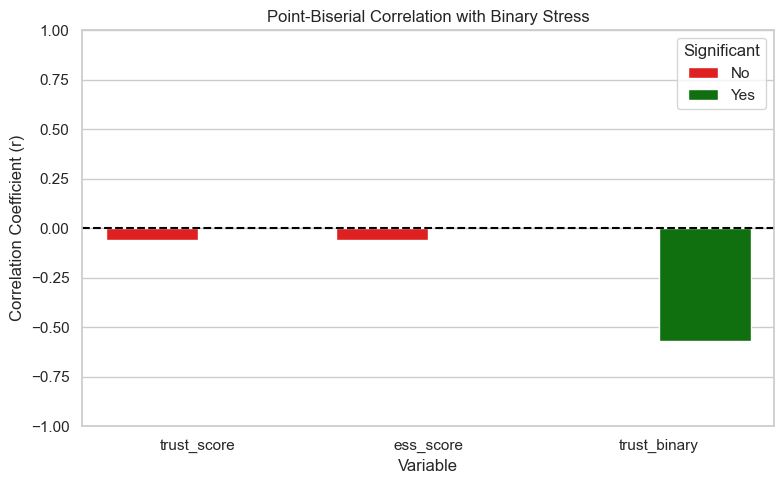

In [6178]:
import seaborn as sns
import matplotlib.pyplot as plt

# Prepare plot
plt.figure(figsize=(8, 5))
sns.barplot(
    data=pb_corr_df,
    x='Variable',
    y='Correlation (r)',
    hue='Significant',
    palette={'Yes': 'green', 'No': 'red'} #p < 0.05 or p ≥ 0.05
)

plt.axhline(0, linestyle='--', color='black')
plt.title("Point-Biserial Correlation with Binary Stress")
plt.ylabel("Correlation Coefficient (r)")
plt.xlabel("Variable")
plt.ylim(-1, 1)
plt.tight_layout()
plt.show()


This bar chart visualizes the **Point-Biserial correlation (r)** between model-inferred **stress (binary)** and:

* **Subjective Trust Score**
* **ESS Score**
* **Model Trust (binary)**

---

### 🧠 Interpretation:

* Yes: **Model Trust** shows a **strong negative correlation** with stress — consistent and significant.
* No: **Subjective Trust** and **ESS** show **weak, non-significant** negative correlations.

This highlights that model trust and stress are strongly aligned (possibly using similar physiological signals), whereas subjective measures are more resilient or interpreted differently by users.


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


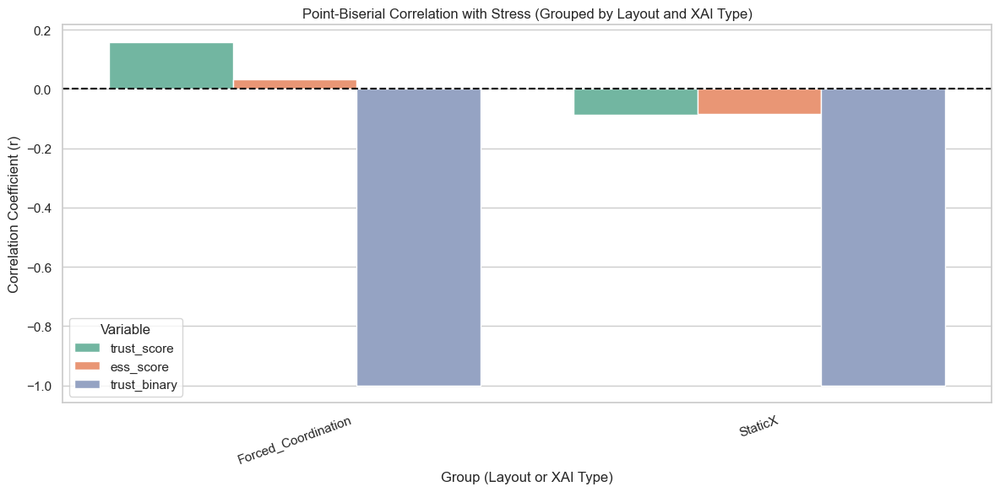

In [6180]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pointbiserialr

# --- Run correlations ---
layout_corrs = []
xai_corrs = []

# Correlation by layout
for layout in df_merged['layout'].unique():
    sub = df_merged[df_merged['layout'] == layout]
    for var in ['trust_score', 'ess_score', 'trust_binary']:
        if sub[var].nunique() >= 2:
            r, p = pointbiserialr(sub['stress_binary'], sub[var])
            layout_corrs.append({
                'Group': layout.title(),  # Capitalize layout names
                'Variable': var,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌',
                'Type': 'Layout'
            })

# Correlation by XAI type
for xai in df_merged['xai_type'].unique():
    sub = df_merged[df_merged['xai_type'] == xai]
    for var in ['trust_score', 'ess_score', 'trust_binary']:
        if sub[var].nunique() >= 2:
            r, p = pointbiserialr(sub['stress_binary'], sub[var])
            xai_corrs.append({
                'Group': xai,
                'Variable': var,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌',
                'Type': 'XAI Type'
            })

# Combine
corr_df = pd.DataFrame(layout_corrs + xai_corrs).dropna(subset=['Correlation (r)'])

# --- Plot ---
plt.figure(figsize=(12, 6))
sns.barplot(
    data=corr_df,
    x='Group',
    y='Correlation (r)',
    hue='Variable',
    palette='Set2'
)
plt.axhline(0, linestyle='--', color='black')
plt.title("Point-Biserial Correlation with Stress (Grouped by Layout and XAI Type)")
plt.ylabel("Correlation Coefficient (r)")
plt.xlabel("Group (Layout or XAI Type)")
plt.xticks(rotation=20)
plt.tight_layout()
plt.show()


In [4913]:
df_merged.groupby('layout')['stress_binary'].nunique()


layout
asymmetric_advantages    1
coordination_ring        1
counter_circuit          1
cramped_room             1
forced_coordination      2
Name: stress_binary, dtype: int64

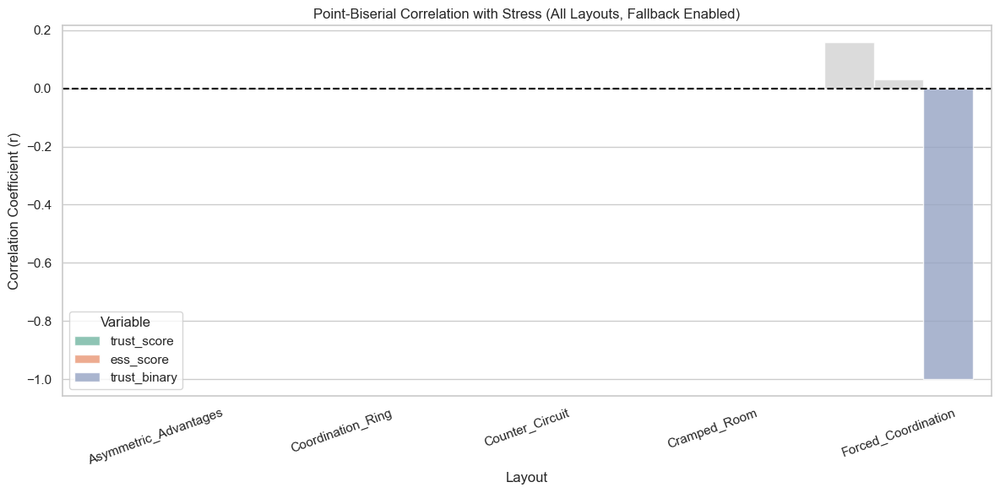

In [6182]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pointbiserialr

# Initialize results list
layout_corrs = []

# Layout-wise correlation with fallback for constant stress values
for layout in df_merged['layout'].unique():
    sub = df_merged[df_merged['layout'] == layout]
    for var in ['trust_score', 'ess_score', 'trust_binary']:
        if sub['stress_binary'].nunique() < 2 or sub[var].nunique() < 2:
            # Not enough variation to compute correlation
            layout_corrs.append({
                'Group': layout.title(),
                'Variable': var,
                'Correlation (r)': 0.0,
                'p-value': None,
                'Significant': 'N/A',
                'Type': 'Layout'
            })
        else:
            r, p = pointbiserialr(sub['stress_binary'], sub[var])
            layout_corrs.append({
                'Group': layout.title(),
                'Variable': var,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌',
                'Type': 'Layout'
            })

# Convert to DataFrame
layout_corr_df = pd.DataFrame(layout_corrs)

# Plot all layouts
plt.figure(figsize=(12, 6))
sns.barplot(
    data=layout_corr_df,
    x='Group',
    y='Correlation (r)',
    hue='Variable',
    palette='Set2',
    alpha=0.8
)

# Highlight zero-value bars (those with "N/A") in gray
for i, row in layout_corr_df.iterrows():
    if row['Significant'] == 'N/A':
        plt.gca().patches[i].set_facecolor('lightgray')

plt.axhline(0, linestyle='--', color='black')
plt.title("Point-Biserial Correlation with Stress (All Layouts, Fallback Enabled)")
plt.ylabel("Correlation Coefficient (r)")
plt.xlabel("Layout")
plt.xticks(rotation=20)
plt.tight_layout()
plt.show()


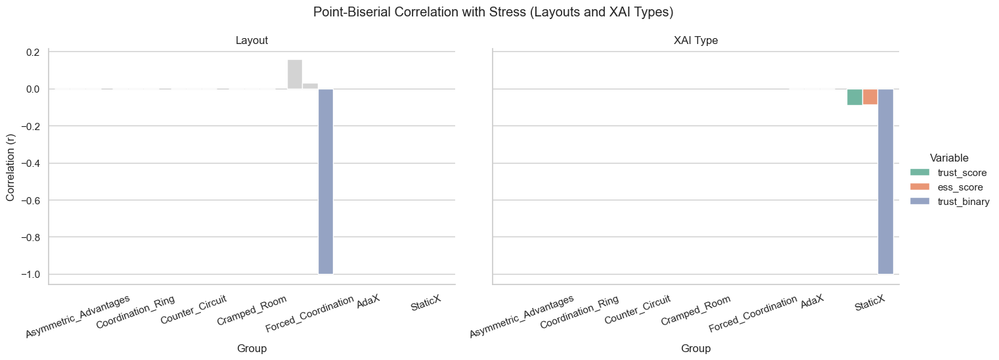

In [6184]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pointbiserialr

results = []

# Layout-wise
for layout in df_merged['layout'].unique():
    sub = df_merged[df_merged['layout'] == layout]
    for var in ['trust_score', 'ess_score', 'trust_binary']:
        label = layout.title()
        if sub['stress_binary'].nunique() < 2 or sub[var].nunique() < 2:
            results.append({'Group': label, 'Variable': var, 'Correlation (r)': 0.0, 'p-value': None, 'Significant': 'N/A', 'Type': 'Layout'})
        else:
            r, p = pointbiserialr(sub['stress_binary'], sub[var])
            results.append({'Group': label, 'Variable': var, 'Correlation (r)': round(r, 3), 'p-value': round(p, 4), 'Significant': '✅' if p < 0.05 else '❌', 'Type': 'Layout'})

# XAI-wise
for xai in df_merged['xai_type'].unique():
    sub = df_merged[df_merged['xai_type'] == xai]
    for var in ['trust_score', 'ess_score', 'trust_binary']:
        label = xai
        if sub['stress_binary'].nunique() < 2 or sub[var].nunique() < 2:
            results.append({'Group': label, 'Variable': var, 'Correlation (r)': 0.0, 'p-value': None, 'Significant': 'N/A', 'Type': 'XAI Type'})
        else:
            r, p = pointbiserialr(sub['stress_binary'], sub[var])
            results.append({'Group': label, 'Variable': var, 'Correlation (r)': round(r, 3), 'p-value': round(p, 4), 'Significant': '✅' if p < 0.05 else '❌', 'Type': 'XAI Type'})

# Convert to DataFrame
corr_df = pd.DataFrame(results)

# Plot with different panels
g = sns.catplot(
    data=corr_df,
    x='Group',
    y='Correlation (r)',
    hue='Variable',
    kind='bar',
    col='Type',
    height=5,
    aspect=1.4,
    palette='Set2'
)

# Highlight gray bars for 'N/A'
for ax, typ in zip(g.axes.flat, ['Layout', 'XAI Type']):
    subset = corr_df[corr_df['Type'] == typ].reset_index()
    for i, row in subset.iterrows():
        if row['Significant'] == 'N/A':
            ax.patches[i].set_facecolor('lightgray')

g.set_titles("{col_name}")
g.set_xticklabels(rotation=20)
g.set_axis_labels("Group", "Correlation (r)")
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Point-Biserial Correlation with Stress (Layouts and XAI Types)")
plt.show()


In [4916]:
# # Recreate the correlation bar plot with custom legend including gray bar
# import matplotlib.patches as mpatches

# # Plot the grouped bar chart
# g = sns.catplot(
#     data=corr_df,
#     x='Group',
#     y='Correlation (r)',
#     hue='Variable',
#     kind='bar',
#     col='Type',
#     height=5,
#     aspect=1.4,
#     palette=custom_palette
# )

# # Highlight bars with N/A (gray)
# for ax, typ in zip(g.axes.flat, ['Layout', 'XAI Type']):
#     subset = corr_df[corr_df['Type'] == typ].reset_index()
#     for i, row in subset.iterrows():
#         if row['Significant'] == 'N/A':
#             ax.patches[i].set_facecolor('lightgray')

# # Create custom legend patches
# handles, labels = g.axes[0][0].get_legend_handles_labels()
# gray_patch = mpatches.Patch(color='lightgray', label='N/A (Constant Stress)')
# handles.append(gray_patch)

# # Replace the legend
# for ax in g.axes.flat:
#     ax.legend(handles=handles, title='Variable')

# # Final formatting
# g.set_titles("{col_name}")
# g.set_xticklabels(rotation=20)
# g.set_axis_labels("Group", "Correlation (r)")
# plt.subplots_adjust(top=0.85)
# g.fig.suptitle("Point-Biserial Correlation with Stress (Layouts and XAI Types)")
# plt.show()


# # Fix the double-legend issue by reconstructing the legend cleanly
# # Re-plot everything with just one properly patched legend

# # Plot again
# g = sns.catplot(
#     data=corr_df,
#     x='Group',
#     y='Correlation (r)',
#     hue='Variable',
#     kind='bar',
#     col='Type',
#     height=5,
#     aspect=1.4,
#     palette=custom_palette
# )

# # Highlight gray bars
# for ax, typ in zip(g.axes.flat, ['Layout', 'XAI Type']):
#     subset = corr_df[corr_df['Type'] == typ].reset_index()
#     for i, row in subset.iterrows():
#         if row['Significant'] == 'N/A':
#             ax.patches[i].set_facecolor('lightgray')

# # Get the default legend handles/labels from seaborn
# handles, labels = g._legend.get_legend_handles_labels()

# # Add the custom gray patch if not already there
# gray_patch = mpatches.Patch(color='lightgray', label='N/A (Constant Stress)')
# if 'N/A (Constant Stress)' not in labels:
#     handles.append(gray_patch)
#     labels.append('N/A (Constant Stress)')

# # Remove existing legends and add the new one manually
# for ax in g.axes.flat:
#     ax.legend_.remove()
# g.fig.legend(handles, labels, title="Variable", loc='upper center', ncol=4, bbox_to_anchor=(0.5, 1.08))

# # Final layout
# g.set_titles("{col_name}")
# g.set_xticklabels(rotation=20)
# g.set_axis_labels("Group", "Correlation (r)")
# plt.subplots_adjust(top=0.85)
# g.fig.suptitle("Point-Biserial Correlation with Stress (Layouts and XAI Types)")
# plt.show()


# AdaX AI features, trust, stress vs ess

In [6186]:
df_merged


,uid,layout,xai_type,trust_score,ess_score,trust_binary,stress_binary
0,10,asymmetric_advantages,AdaX,4.444444,4.111111,1,0
1,10,asymmetric_advantages,StaticX,4.000000,4.000000,1,0
2,10,coordination_ring,AdaX,3.000000,2.000000,1,0
3,10,coordination_ring,StaticX,3.000000,3.000000,1,0
4,10,counter_circuit,AdaX,0.000000,0.000000,1,0
...,...,...,...,...,...,...,...
115,21,counter_circuit,StaticX,2.222222,2.888889,1,0
116,21,cramped_room,AdaX,4.111111,3.444444,1,0
117,21,cramped_room,StaticX,3.666667,4.222222,1,0
118,21,forced_coordination,AdaX,1.888889,2.555556,1,0


In [6188]:
import json

with open("processed_with_uid_filtered.json") as f:
    data = json.load(f)

df_json = pd.DataFrame(data)

# Filter only AdaX entries
df_ada = df_merged[df_merged['xai_type'] == 'AdaX'].copy()

# Re-merge original metadata to extract explanation feature categories
layout_lookup = df_json[['uid', 'metadata']].copy()
layout_lookup['uid'] = layout_lookup['uid'].astype(str).str.strip()
layout_lookup['layout'] = layout_lookup['metadata'].apply(lambda m: m.get('layout_name', '')).str.strip().str.lower()
layout_lookup['xai_type'] = layout_lookup.apply(
    lambda row: 'StaticX' if row['metadata'].get('final_explanation', '') == '' and
                             row['metadata'].get('explanation_features', {}).get('explanation_timing', 'unknown') == 'unknown'
    else 'AdaX',
    axis=1
)

# Keep AdaX rows
layout_lookup = layout_lookup[layout_lookup['xai_type'] == 'AdaX'].copy()

# Extract AdaX feature labels from metadata
layout_lookup['explanation_timing'] = layout_lookup['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown'))
layout_lookup['explanation_duration'] = layout_lookup['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_duration', 'unknown'))
layout_lookup['explanation_granularity'] = layout_lookup['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_granularity', 'unknown'))

# Drop duplicates to get one row per UID-layout for merging
layout_lookup = layout_lookup.drop_duplicates(subset=['uid', 'layout'])

# Merge AdaX entries with explanation features
df_ada = pd.merge(
    df_ada,
    layout_lookup[['uid', 'layout', 'explanation_timing', 'explanation_duration', 'explanation_granularity']],
    on=['uid', 'layout'],
    how='left'
)

# Prepare melted dataframe for correlation analysis
melted = df_ada.melt(
    id_vars=['uid', 'layout', 'explanation_timing', 'explanation_duration', 'explanation_granularity'],
    value_vars=['trust_score', 'ess_score', 'trust_binary', 'stress_binary'],
    var_name='Target',
    value_name='Score'
)

melted


,uid,layout,explanation_timing,explanation_duration,explanation_granularity,Target,Score
0,10,asymmetric_advantages,proactive,short,highlevel,trust_score,4.444444
1,10,coordination_ring,proactive,short,highlevel,trust_score,3.000000
2,10,counter_circuit,proactive,short,highlevel,trust_score,0.000000
3,10,cramped_room,proactive,short,highlevel,trust_score,4.000000
4,10,forced_coordination,proactive,short,highlevel,trust_score,0.000000
...,...,...,...,...,...,...,...
235,21,asymmetric_advantages,proactive,short,highlevel,stress_binary,0.000000
236,21,coordination_ring,proactive,short,highlevel,stress_binary,0.000000
237,21,counter_circuit,proactive,short,highlevel,stress_binary,0.000000
238,21,cramped_room,proactive,short,highlevel,stress_binary,0.000000


In [6190]:
# Step 1: Group-wise mean scores by feature and target
group_means = (
    melted.groupby(['Target', 'explanation_timing', 'explanation_duration', 'explanation_granularity'])['Score']
    .mean()
    .reset_index()
    .rename(columns={'Score': 'Mean Score'})
)

# Step 2: Point-biserial correlation between each binary feature and each score
correlation_results = []

# Map categorical features to binary labels for correlation
df_ada_corr = df_ada.copy()
df_ada_corr['timing_bin'] = df_ada_corr['explanation_timing'].map({'proactive': 1, 'reactive': 0})
df_ada_corr['duration_bin'] = df_ada_corr['explanation_duration'].map({'long': 1, 'short': 0})
df_ada_corr['granularity_bin'] = df_ada_corr['explanation_granularity'].map({'steps': 1, 'highlevel': 0})

binary_features = {
    'timing_bin': 'Explanation Timing',
    'duration_bin': 'Explanation Duration',
    'granularity_bin': 'Explanation Granularity'
}

from scipy.stats import pointbiserialr

for bin_feature, label in binary_features.items():
    for target in ['trust_score', 'ess_score', 'trust_binary', 'stress_binary']:
        if df_ada_corr[bin_feature].nunique() > 1 and df_ada_corr[target].nunique() > 1:
            r, p = pointbiserialr(df_ada_corr[bin_feature], df_ada_corr[target])
            correlation_results.append({
                'Feature': label,
                'Target': target,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌'
            })

# Convert to DataFrame
corr_feature_df = pd.DataFrame(correlation_results)



In [6192]:
group_means

,Target,explanation_timing,explanation_duration,explanation_granularity,Mean Score
0,ess_score,proactive,short,highlevel,2.433333
1,stress_binary,proactive,short,highlevel,0.000000
2,trust_binary,proactive,short,highlevel,0.966667
3,trust_score,proactive,short,highlevel,2.205556


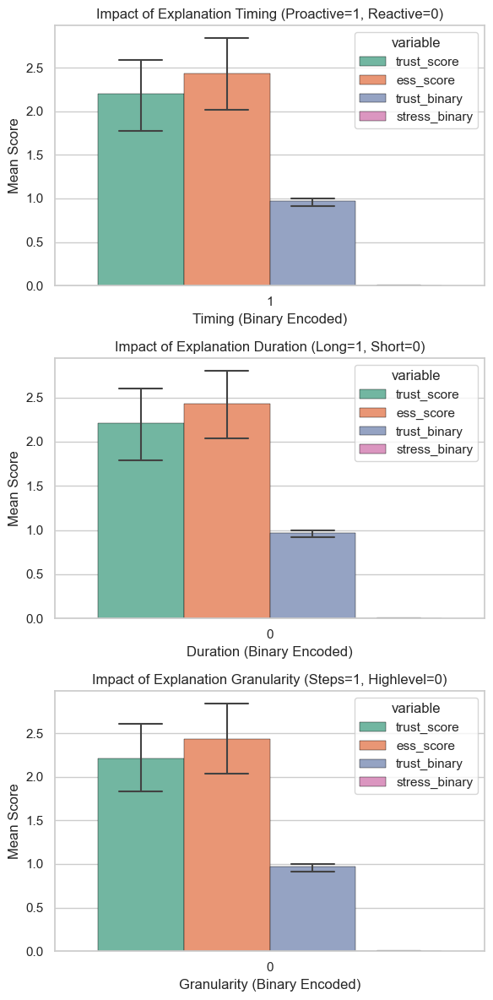

In [6212]:
# Create barplots for each target variable by each explanation feature
plt.figure(figsize=(6, 12))

# Plot 1: Explanation Timing
plt.subplot(3, 1, 1)
sns.barplot(
    data=df_ada_corr.melt(id_vars=['timing_bin'], value_vars=['trust_score', 'ess_score', 'trust_binary', 'stress_binary']),
    x='timing_bin', y='value', hue='variable', palette='Set2',
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3     # Thickness of the border
)
plt.title("Impact of Explanation Timing (Proactive=1, Reactive=0)")
plt.ylabel("Mean Score")
plt.xlabel("Timing (Binary Encoded)")

# Plot 2: Explanation Duration
plt.subplot(3, 1, 2)
sns.barplot(
    data=df_ada_corr.melt(id_vars=['duration_bin'], value_vars=['trust_score', 'ess_score', 'trust_binary', 'stress_binary']),
    x='duration_bin', y='value', hue='variable', palette='Set2',
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3     # Thickness of the border
)
plt.title("Impact of Explanation Duration (Long=1, Short=0)")
plt.ylabel("Mean Score")
plt.xlabel("Duration (Binary Encoded)")

# Plot 3: Explanation Granularity
plt.subplot(3, 1, 3)
sns.barplot(
    data=df_ada_corr.melt(id_vars=['granularity_bin'], value_vars=['trust_score', 'ess_score', 'trust_binary', 'stress_binary']),
    x='granularity_bin', y='value', hue='variable', palette='Set2',
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3     # Thickness of the border
)
plt.title("Impact of Explanation Granularity (Steps=1, Highlevel=0)")
plt.ylabel("Mean Score")
plt.xlabel("Granularity (Binary Encoded)")

plt.tight_layout()
plt.show()


In [6214]:
# Compute correlation directly using AdaX entries and binary targets from JSON
# Match UID, layout, and extract trust/stress + AdaX features

# Extract relevant AdaX rows with feature labels from JSON
df_adax_json = df_json[df_json['xai_type'] == 'AdaX'].copy()
df_adax_json['explanation_timing'] = df_adax_json['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown'))
df_adax_json['explanation_duration'] = df_adax_json['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_duration', 'unknown'))
df_adax_json['explanation_granularity'] = df_adax_json['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_granularity', 'unknown'))

# Encode binary values
df_adax_json['timing_bin'] = df_adax_json['explanation_timing'].map({'proactive': 1, 'reactive': 0})
df_adax_json['duration_bin'] = df_adax_json['explanation_duration'].map({'long': 1, 'short': 0})
df_adax_json['granularity_bin'] = df_adax_json['explanation_granularity'].map({'steps': 1, 'highlevel': 0})
# Normalize keys for merging
df_adax_json['uid'] = df_adax_json['uid'].astype(str).str.strip()
df_adax_json['layout'] = df_adax_json['metadata'].apply(lambda m: m.get('layout_name', '')).str.strip().str.lower()

df_merged['uid'] = df_merged['uid'].astype(str).str.strip()
df_merged['layout'] = df_merged['layout'].str.strip().str.lower()

# Merge binary targets into the AdaX JSON data
df_adax_json = pd.merge(
    df_adax_json,
    df_merged[['uid', 'layout', 'trust_binary', 'stress_binary']],
    on=['uid', 'layout'],
    how='left'
)

# Binary trust and stress already present
# Perform correlation where both values exist
json_corr_results = []
for bin_feature, label in {
    'timing_bin': 'Explanation Timing',
    'duration_bin': 'Explanation Duration',
    'granularity_bin': 'Explanation Granularity'
}.items():
    for target in ['trust_binary', 'stress_binary']:
        if df_adax_json[bin_feature].nunique() > 1 and df_adax_json[target].nunique() > 1:
            r, p = pointbiserialr(df_adax_json[bin_feature], df_adax_json[target])
            json_corr_results.append({
                'Feature': label,
                'Target': target,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌'
            })

df_json_corr = pd.DataFrame(json_corr_results)

df_json_corr


,Feature,Target,Correlation (r),p-value,Significant
0,Explanation Timing,trust_binary,-0.009,0.7552,❌
1,Explanation Timing,stress_binary,0.005,0.8538,❌


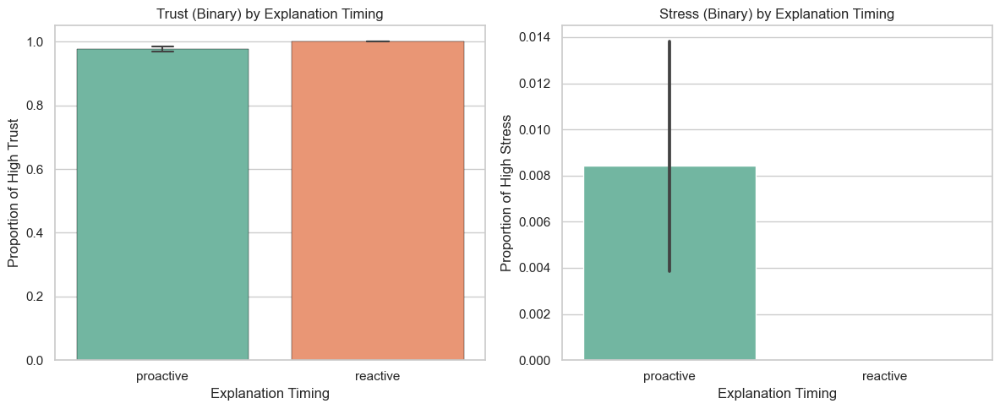

In [6220]:
# Visualize distribution of trust and stress by explanation timing
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 5))

# Plot 1: Trust by Explanation Timing
plt.subplot(1, 2, 1)
sns.barplot(
    data=df_adax_json,
    x='explanation_timing',
    y='trust_binary',
    errorbar=('ci', 95),
    palette='Set2',
    capsize=0.1,
    errwidth=1.5,edgecolor="black",     # Adds black border
    linewidth=0.3     # Thickness of the border
)
plt.title("Trust (Binary) by Explanation Timing")
plt.ylabel("Proportion of High Trust")
plt.xlabel("Explanation Timing")

# Plot 2: Stress by Explanation Timing
plt.subplot(1, 2, 2)
sns.barplot(
    data=df_adax_json,
    x='explanation_timing',
    y='stress_binary',
    errorbar=('ci', 95),
    palette='Set2',
    
)
plt.title("Stress (Binary) by Explanation Timing")
plt.ylabel("Proportion of High Stress")
plt.xlabel("Explanation Timing")

plt.tight_layout()
plt.show()


In [6222]:
# Compute average trust and stress per value of each explanation feature
summary_stats = []

for feature in ['explanation_timing', 'explanation_duration', 'explanation_granularity']:
    for value in df_adax_json[feature].unique():
        sub = df_adax_json[df_adax_json[feature] == value]
        if not sub.empty:
            summary_stats.append({
                'Feature': feature,
                'Value': value,
                'Count': len(sub),
                'Trust (Mean)': round(sub['trust_binary'].mean(), 3),
                'Stress (Mean)': round(sub['stress_binary'].mean(), 3)
            })

df_feature_summary = pd.DataFrame(summary_stats)

df_feature_summary

,Feature,Value,Count,Trust (Mean),Stress (Mean)
0,explanation_timing,proactive,1304,0.976,0.008
1,explanation_timing,reactive,4,1.000,0.000
2,explanation_duration,short,1308,0.976,0.008
3,explanation_granularity,highlevel,1308,0.976,0.008


In [4925]:
df_expanded

,id,contents,uid,xai_type,timestep,score,trust,stress,playerId,timestep,...,held_objects.(human)player_0.is_idle,held_objects.(human)player_0.is_ready,held_objects.(human)player_0.cook_time,held_objects.(human)player_0.is_cooking,held_objects.(human)player_0._ingredients,held_objects.(human)player_0.cooking_tick,held_objects.(human)player_0._cooking_tick,trust_binary,stress_binary,time_elapsed
0,fb78f144-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0,0,high,low,80d85041fdab4066a21018504e26264a,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0
1,fb78e9e2-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1,0,high,low,80d85041fdab4066a21018504e26264a,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,1
2,fb78e7f8-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,2,0,high,low,80d85041fdab4066a21018504e26264a,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0
3,fb78e5c8-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,3,0,high,low,80d85041fdab4066a21018504e26264a,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0
4,fb78ef14-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,15,0,high,low,80d85041fdab4066a21018504e26264a,15,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1659,fb8e9814-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,355,100,high,low,04eea26bba9d4c2da5c1ed75b4de870f,355,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,77
1660,fb8e9094-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,356,20,high,low,04eea26bba9d4c2da5c1ed75b4de870f,356,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,76
1661,fb8e931e-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,359,0,high,low,04eea26bba9d4c2da5c1ed75b4de870f,359,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,78
1662,fb8e95a8-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,360,20,high,low,04eea26bba9d4c2da5c1ed75b4de870f,360,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,78


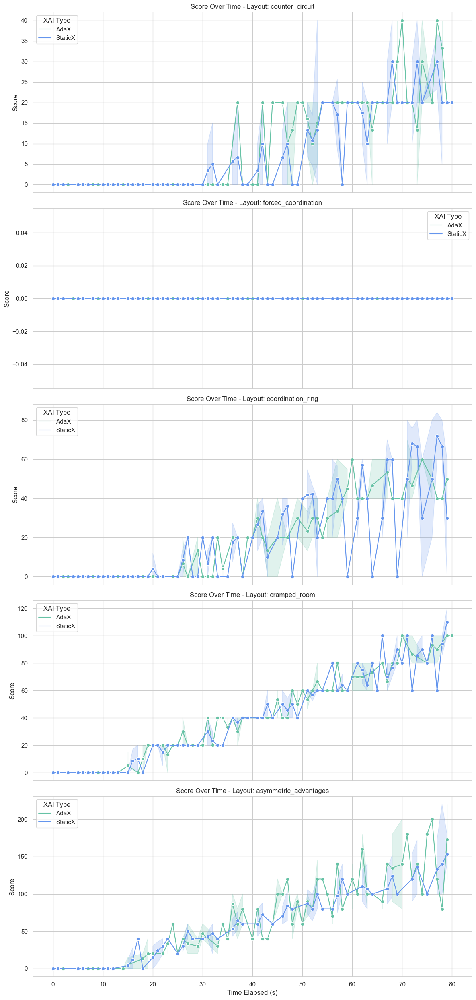

In [6224]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the processed JSON file
with open("processed_with_uid_filtered.json", "r") as f:
    records = json.load(f)

# Normalize JSON into DataFrame
df = pd.DataFrame(records)
metadata_df = pd.json_normalize(df['metadata'])
df_expanded = pd.concat([df.drop(columns=['metadata']), metadata_df], axis=1)

# Compute trust/stress and key performance metrics
df_expanded['uid'] = df_expanded['uid'].astype(str)
df_expanded['trust'] = df_expanded['trust'].str.lower().fillna('low')
df_expanded['stress'] = df_expanded['stress'].str.lower().fillna('low')
df_expanded['trust_binary'] = df_expanded['trust'].map({'low': 0, 'high': 1})
df_expanded['stress_binary'] = df_expanded['stress'].map({'low': 0, 'high': 1})
df_expanded['time_elapsed'] = df_expanded.groupby(['uid', 'layout_name'])['time_left'].transform(lambda x: x.max() - x)

# Filter usable data
df_with_time = df_expanded[
    ['uid', 'layout_name', 'xai_type', 'time_elapsed', 'score', 'trust', 'stress']
].dropna(subset=['time_elapsed', 'score'])

# Prepare subset for clear visualization (1 row per uid-layout-xai_type group)
sample_sessions = df_with_time.groupby(['uid', 'layout_name', 'xai_type']).head(1)[['uid', 'layout_name', 'xai_type']]
sample_df_subset = pd.merge(df_with_time, sample_sessions, on=['uid', 'layout_name', 'xai_type'])

# Plot score over time for each layout separately
layouts = sample_df_subset['layout_name'].unique()
fig, axes = plt.subplots(nrows=len(layouts), ncols=1, figsize=(12, 5 * len(layouts)), sharex=True)

for ax, layout in zip(axes, layouts):
    layout_data = sample_df_subset[sample_df_subset['layout_name'] == layout]
    sns.lineplot(
        data=layout_data,
        x='time_elapsed', y='score',
        hue='xai_type',
        marker='o',
        ax=ax,
        palette=custom_palette
    )
    ax.set_title(f"Score Over Time - Layout: {layout}")
    ax.set_ylabel("Score")
    ax.set_xlabel("Time Elapsed (s)")
    ax.grid(True)
    ax.legend(title="XAI Type")

plt.tight_layout()
plt.show()


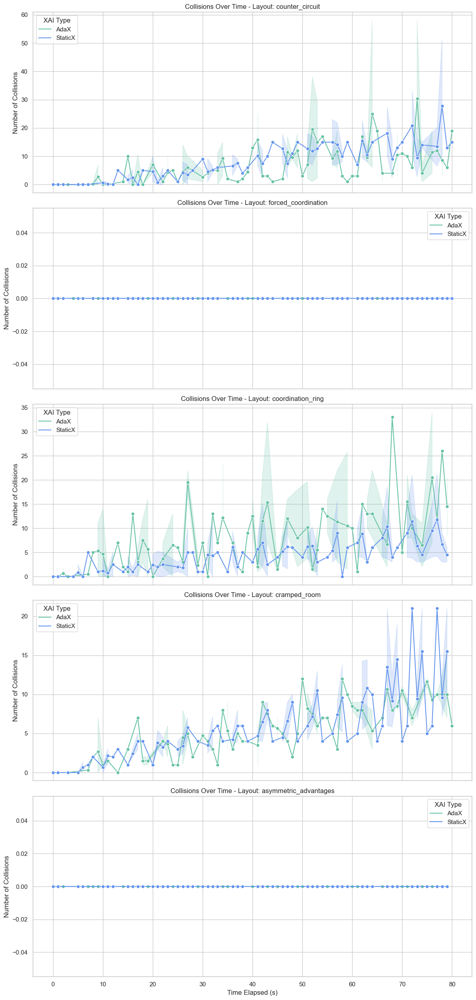

In [4927]:
# Ensure num_collisions is properly extracted and numeric
df_expanded['num_collisions'] = pd.to_numeric(df_expanded.get('num_collisions', 0), errors='coerce')

# Reconstruct the plotting dataframe with collisions included
df_with_time['num_collisions'] = df_expanded['num_collisions']

# Rebuild the sample subset used for plotting
sample_sessions = df_with_time.groupby(['uid', 'layout_name', 'xai_type']).head(1)[['uid', 'layout_name', 'xai_type']]
sample_df_subset = pd.merge(df_with_time, sample_sessions, on=['uid', 'layout_name', 'xai_type'])

# Regenerate layout list
layouts = sample_df_subset['layout_name'].unique()

# Plot updated collision trajectories
fig, axes = plt.subplots(nrows=len(layouts), ncols=1, figsize=(12, 5 * len(layouts)), sharex=True)

for ax, layout in zip(axes, layouts):
    layout_data = sample_df_subset[sample_df_subset['layout_name'] == layout]
    sns.lineplot(
        data=layout_data,
        x='time_elapsed', y='num_collisions',
        hue='xai_type',
        marker='o',
        ax=ax,
        palette=custom_palette
    )
    ax.set_title(f"Collisions Over Time - Layout: {layout}")
    ax.set_ylabel("Number of Collisions")
    ax.set_xlabel("Time Elapsed (s)")
    ax.grid(True)
    ax.legend(title="XAI Type")

plt.tight_layout()
plt.show()


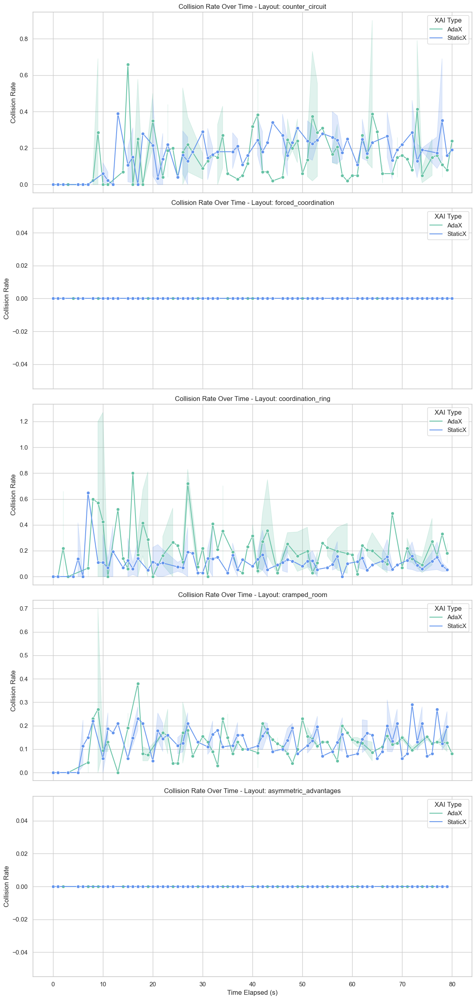

In [4928]:
# Ensure collision_rate is numeric and available
df_expanded['collision_rate'] = pd.to_numeric(df_expanded.get('collision_rate', 0), errors='coerce')

# Add collision_rate to df_with_time
df_with_time['collision_rate'] = df_expanded['collision_rate']

# Rebuild the sample subset used for plotting with updated collision_rate
sample_sessions = df_with_time.groupby(['uid', 'layout_name', 'xai_type']).head(1)[['uid', 'layout_name', 'xai_type']]
sample_df_subset = pd.merge(df_with_time, sample_sessions, on=['uid', 'layout_name', 'xai_type'])

# Plot collision rate over time for each layout
fig, axes = plt.subplots(nrows=len(layouts), ncols=1, figsize=(12, 5 * len(layouts)), sharex=True)

for ax, layout in zip(axes, layouts):
    layout_data = sample_df_subset[sample_df_subset['layout_name'] == layout]
    sns.lineplot(
        data=layout_data,
        x='time_elapsed', y='collision_rate',
        hue='xai_type',
        marker='o',
        ax=ax,
        palette=custom_palette
    )
    ax.set_title(f"Collision Rate Over Time - Layout: {layout}")
    ax.set_ylabel("Collision Rate")
    ax.set_xlabel("Time Elapsed (s)")
    ax.grid(True)
    ax.legend(title="XAI Type")

plt.tight_layout()
plt.show()


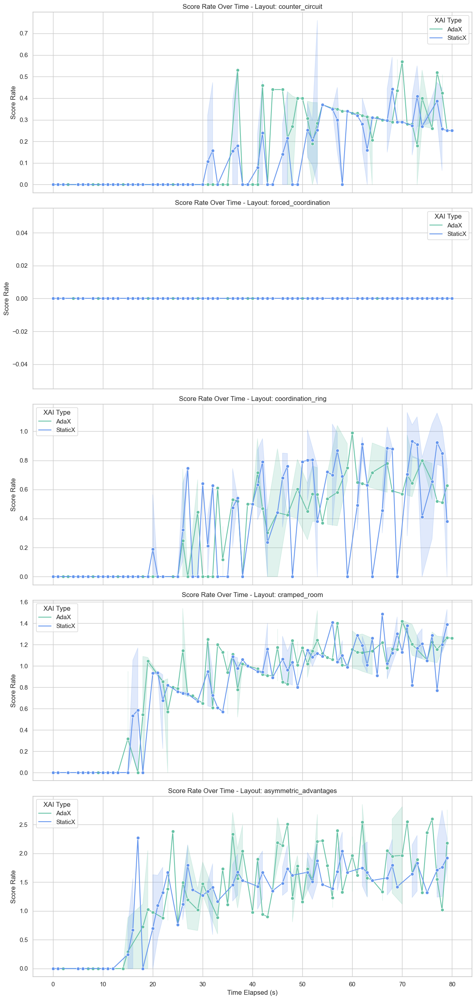

In [4929]:
# Ensure score_rate is numeric and merge it into df_with_time
df_expanded['score_rate'] = pd.to_numeric(df_expanded.get('score_rate', 0), errors='coerce')
df_with_time['score_rate'] = df_expanded['score_rate']

# Refresh the sample subset for score rate plotting
sample_sessions = df_with_time.groupby(['uid', 'layout_name', 'xai_type']).head(1)[['uid', 'layout_name', 'xai_type']]
sample_df_subset = pd.merge(df_with_time, sample_sessions, on=['uid', 'layout_name', 'xai_type'])

# Plot score rate over time for each layout
fig, axes = plt.subplots(nrows=len(layouts), ncols=1, figsize=(12, 5 * len(layouts)), sharex=True)

for ax, layout in zip(axes, layouts):
    layout_data = sample_df_subset[sample_df_subset['layout_name'] == layout]
    sns.lineplot(
        data=layout_data,
        x='time_elapsed', y='score_rate',
        hue='xai_type',
        marker='o', 
        
        ax=ax,
        palette=custom_palette
    )
    ax.set_title(f"Score Rate Over Time - Layout: {layout}")
    ax.set_ylabel("Score Rate")
    ax.set_xlabel("Time Elapsed (s)")
    ax.grid(True)
    ax.legend(title="XAI Type")

plt.tight_layout()
plt.show()


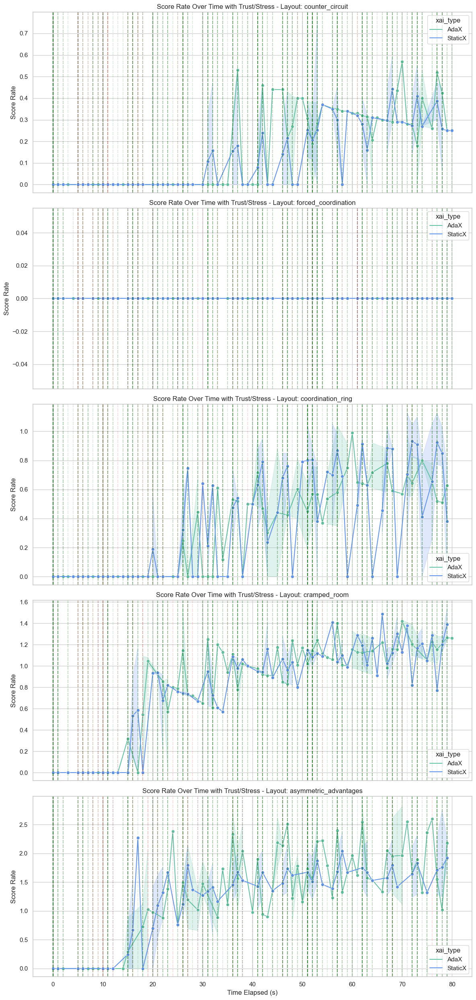

In [4930]:
# Prepare trust and stress overlays
fig, axes = plt.subplots(nrows=len(layouts), ncols=1, figsize=(12, 5 * len(layouts)), sharex=True)

for ax, layout in zip(axes, layouts):
    layout_data = sample_df_subset[sample_df_subset['layout_name'] == layout]

    # Plot score rate
    sns.lineplot(
        data=layout_data,
        x='time_elapsed', y='score_rate',
        hue='xai_type',
        marker='o',
        ax=ax,
        # legend=False,
        palette=custom_palette
    )

    # Overlay trust and stress events
    for _, row in layout_data.iterrows():
        color = 'green' if row['trust'] == 'high' else 'red'
        ax.axvline(x=row['time_elapsed'], color=color, linestyle='--', alpha=0.1)

        color = 'blue' if row['stress'] == 'high' else 'gray'
        ax.axvline(x=row['time_elapsed'], color=color, linestyle=':', alpha=0.1)

    ax.set_title(f"Score Rate Over Time with Trust/Stress - Layout: {layout}")
    ax.set_ylabel("Score Rate")
    ax.set_xlabel("Time Elapsed (s)")
    ax.grid(True)

plt.tight_layout()
plt.show()


Score rate over time (by XAI type)

Dashed vertical lines:

🟥 Red: Low Trust

🟩 Green: High Trust

Dotted vertical lines:

🔵 Blue: High Stress

⚪ Gray: Low Stress

In [4932]:
# Add binary versions of trust and stress to sample_df_subset before correlation
sample_df_subset['trust_binary'] = sample_df_subset['trust'].map({'low': 0, 'high': 1})
sample_df_subset['stress_binary'] = sample_df_subset['stress'].map({'low': 0, 'high': 1})

# Quantify correlation between trust/stress and score_rate within sessions
correlation_results = []

for layout in sample_df_subset['layout_name'].unique():
    layout_data = sample_df_subset[sample_df_subset['layout_name'] == layout]
    for xai in layout_data['xai_type'].unique():
        subset = layout_data[layout_data['xai_type'] == xai]
        if subset['score_rate'].nunique() > 1:
            # Correlation between trust and score rate
            trust_corr = subset['trust_binary'].corr(subset['score_rate'])
            stress_corr = subset['stress_binary'].corr(subset['score_rate'])

            correlation_results.append({
                'Layout': layout,
                'XAI Type': xai,
                'Trust–ScoreRate Corr': round(trust_corr, 3),
                'Stress–ScoreRate Corr': round(stress_corr, 3),
                'N Samples': len(subset)
            })

df_corr_summary = pd.DataFrame(correlation_results)
df_corr_summary

,Layout,XAI Type,Trust–ScoreRate Corr,Stress–ScoreRate Corr,N Samples
0,counter_circuit,AdaX,0.143,NaN,133
1,counter_circuit,StaticX,0.170,-0.071,203
2,coordination_ring,AdaX,0.166,NaN,130
3,coordination_ring,StaticX,0.168,NaN,202
4,cramped_room,AdaX,0.147,-0.209,128
5,cramped_room,StaticX,0.304,NaN,202
6,asymmetric_advantages,AdaX,0.052,-0.014,131
7,asymmetric_advantages,StaticX,0.177,NaN,200


#Interpretation

- Trust shows a weak-to-moderate positive correlation with score rate in nearly all cases.

- Stress correlations are mostly missing due to low variation (i.e., nearly all low stress).

## Merge subjective data 

#### PB vs Subjective Trust Agreements

In [4936]:
# Load the subjective ratings data from sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")

# Sheet3 has post-round data for StaticX and AdaX
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
df_sheet3['uid'] = df_sheet3['uid'].astype(str).str.strip()
df_sheet3['xai_type'] = df_sheet3['xai_agent'].fillna('Unknown')
df_sheet3['layout'] = df_sheet3['layout']

# Calculate trust score and binarized trust
trust_items = [f"Q107_{i}" for i in range(1, 10)]
df_sheet3[trust_items] = df_sheet3[trust_items].apply(pd.to_numeric, errors='coerce') - 1
df_sheet3['trust_score'] = df_sheet3[trust_items].mean(axis=1)
df_sheet3['trust_binary'] = df_sheet3['trust_score'].apply(lambda x: 1 if x > 2.5 else 0)

# Prepare subjective data
df_sdata_trust = df_sheet3[['uid', 'layout', 'xai_type', 'trust_score', 'trust_binary']].copy()

# Merge with physiological-behavioral subset on uid + layout + xai_type
merged_df = pd.merge(
    sample_df_subset,
    df_sdata_trust,
    how='left',
    left_on=['uid', 'layout_name', 'xai_type'],
    right_on=['uid', 'layout', 'xai_type']
)

merged_df.head(50)

,uid,layout_name,xai_type,time_elapsed,score,trust,stress,num_collisions,collision_rate,score_rate,trust_binary_x,stress_binary,layout,trust_score,trust_binary_y
0,10,counter_circuit,AdaX,0,0,high,low,0,0.00,0.00,1,0,counter_circuit,0.000000,0
1,10,counter_circuit,AdaX,7,0,low,low,0,0.00,0.00,0,0,counter_circuit,0.000000,0
2,10,counter_circuit,AdaX,14,0,high,low,1,0.07,0.00,1,0,counter_circuit,0.000000,0
3,10,counter_circuit,AdaX,22,0,high,low,1,0.04,0.00,1,0,counter_circuit,0.000000,0
4,10,counter_circuit,AdaX,30,0,high,low,1,0.03,0.00,1,0,counter_circuit,0.000000,0
5,10,counter_circuit,AdaX,37,20,high,low,1,0.03,0.53,1,0,counter_circuit,0.000000,0
6,10,counter_circuit,AdaX,44,20,high,low,1,0.02,0.44,1,0,counter_circuit,0.000000,0
7,10,counter_circuit,AdaX,51,20,high,low,1,0.02,0.38,1,0,counter_circuit,0.000000,0
8,10,counter_circuit,AdaX,52,20,high,low,1,0.02,0.38,1,0,counter_circuit,0.000000,0
9,10,counter_circuit,AdaX,59,20,high,low,1,0.02,0.34,1,0,counter_circuit,0.000000,0


In [4937]:
# Compare agreement between subjective and PB trust
agreement_df = merged_df.dropna(subset=['trust_binary_x', 'trust_binary_y']).copy()
agreement_df['agreement'] = agreement_df['trust_binary_x'] == agreement_df['trust_binary_y']

# Compute correlation between subjective trust and score_rate
corr_subjective_score = agreement_df['trust_score'].corr(agreement_df['score_rate'])

# Prepare summary
agreement_rate = agreement_df['agreement'].mean()
agreement_count = agreement_df.shape[0]

# Prepare aggregated table
agreement_summary = pd.DataFrame([{
    'Agreement Rate': round(agreement_rate, 3),
    'Total Matched Samples': agreement_count,
    'Corr(Subjective Trust Score, Score Rate)': round(corr_subjective_score, 3)
}])

# Count mismatches
mismatch_table = agreement_df.groupby(['trust_binary_x', 'trust_binary_y']).size().unstack(fill_value=0)

print("PB vs Subjective Trust Agreement Summary \n")
print(agreement_summary)
print("\n\nPB vs Subjective Trust Mismatch Table")
print(mismatch_table)


PB vs Subjective Trust Agreement Summary 

   Agreement Rate  Total Matched Samples  \
0           0.501                   1664   

   Corr(Subjective Trust Score, Score Rate)  
0                                     0.511  


PB vs Subjective Trust Mismatch Table
trust_binary_y    0    1
trust_binary_x          
0                74   53
1               778  759


In [4938]:
# Show how values were calculated

# 1. Agreement: trust_binary_x (PB) == trust_binary_y (Subjective)
agreement_df = merged_df.dropna(subset=['trust_binary_x', 'trust_binary_y']).copy()
agreement_df['agreement'] = agreement_df['trust_binary_x'] == agreement_df['trust_binary_y']

# Calculate agreement rate
agreement_rate = agreement_df['agreement'].mean()
total_matched_samples = agreement_df.shape[0]

# 2. Correlation: Subjective trust score vs PB score rate
correlation_trust_score = agreement_df['trust_score'].corr(agreement_df['score_rate'])

# Build summary
summary = {
    "Agreement Rate": round(agreement_rate, 4),
    "Total Matched Samples": total_matched_samples,
    "Correlation (Subjective Trust Score ↔ Score Rate)": round(correlation_trust_score, 4)
}

summary


{'Agreement Rate': 0.5006,
 'Total Matched Samples': 1664,
 'Correlation (Subjective Trust Score ↔ Score Rate)': 0.5108}

In [4939]:
agreement_df = merged_df.dropna(subset=['trust_binary_x', 'trust_binary_y']).copy()
agreement_df['agreement'] = agreement_df['trust_binary_x'] == agreement_df['trust_binary_y']
print(agreement_df)
agreement_rate = agreement_df['agreement'].mean()
print(agreement_rate)

total_matched_samples = agreement_df.shape[0]  # after dropping NaNs
correlation_trust_score = agreement_df['trust_score'].corr(agreement_df['score_rate'])
print(correlation_trust_score)


     uid        layout_name xai_type  time_elapsed  score trust stress  \
0     10    counter_circuit     AdaX             0      0  high    low   
1     10    counter_circuit     AdaX             7      0   low    low   
2     10    counter_circuit     AdaX            14      0  high    low   
3     10    counter_circuit     AdaX            22      0  high    low   
4     10    counter_circuit     AdaX            30      0  high    low   
...   ..                ...      ...           ...    ...   ...    ...   
1659  21  coordination_ring  StaticX            56     20  high    low   
1660  21  coordination_ring  StaticX            61     20  high    low   
1661  21  coordination_ring  StaticX            66     20  high    low   
1662  21  coordination_ring  StaticX            71     20  high    low   
1663  21  coordination_ring  StaticX            76     20  high    low   

      num_collisions  collision_rate  score_rate  trust_binary_x  \
0                  0            0.00       

In [4940]:
# Compute exact agreement rate and mismatches per layout
layout_agreement_summary = (
    agreement_df.groupby('layout_name')
    .agg(
        n=('agreement', 'count'),
        agreement=('agreement', 'mean')
    )
    .reset_index()
)

# Round for readability
layout_agreement_summary['agreement'] = layout_agreement_summary['agreement'].round(4)

print("Per-Layout Agreement Between PB and Subjective Trust\n", layout_agreement_summary)


Per-Layout Agreement Between PB and Subjective Trust
              layout_name    n  agreement
0  asymmetric_advantages  331     0.7492
1      coordination_ring  332     0.7651
2        counter_circuit  336     0.0655
3           cramped_room  330     0.8212
4    forced_coordination  335     0.1134


 Interpretation
 
Cramped Room shows strong alignment between subjective and PB trust.

Counter Circuit and Forced Coordination show very low agreement — may indicate:

- PB trust model underperforms there

- Subjective ratings shift due to unexpected design/stress factors

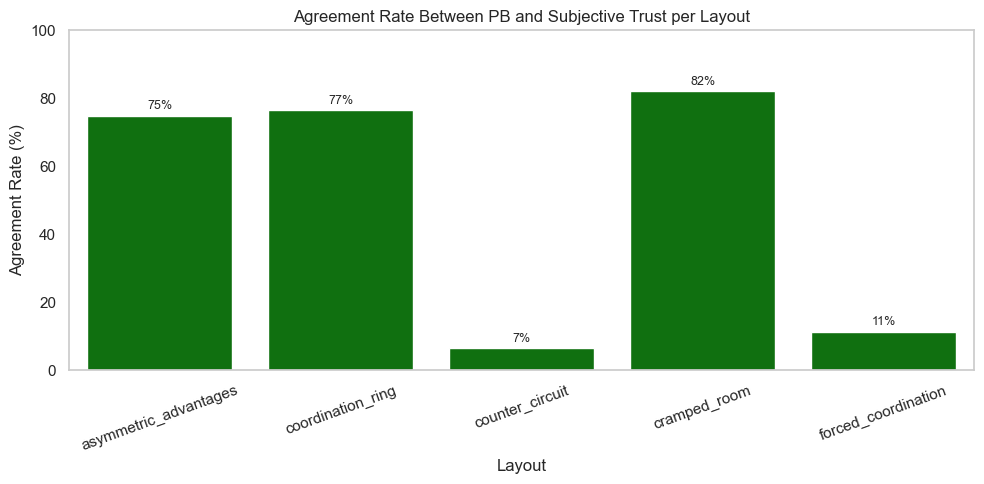

PB vs Subjective Trust: Match/Mismatch Count per Layout & XAI Type
 match            layout_name xai_type  Mismatch  Match
0      asymmetric_advantages     AdaX        26    105
1      asymmetric_advantages  StaticX        57    143
2          coordination_ring     AdaX        57     73
3          coordination_ring  StaticX        21    181
4            counter_circuit     AdaX       122     11
5            counter_circuit  StaticX       192     11
6               cramped_room     AdaX        33     95
7               cramped_room  StaticX        26    176
8        forced_coordination     AdaX       116     16
9        forced_coordination  StaticX       181     22


In [5535]:
import matplotlib.pyplot as plt
import seaborn as sns

# Bar plot of agreement rate per layout
# plt.figure(figsize=(8, 5))
# ax = sns.barplot(data=layout_agreement_summary, x='layout_name', y='agreement', color='green')
# plt.title("Agreement Rate Between PB and Subjective Trust per Layout")
# plt.ylabel("Agreement Rate")
# plt.xlabel("Layout")
# plt.ylim(0, 1)
# plt.xticks(rotation=20)
# plt.grid(axis='y')
# plt.tight_layout()
# plt.savefig("Agreement Rate Between PB and Subjective Trust per Layout.png")

# # Add labels on bars
# for container in ax.containers:
#     ax.bar_label(container, fmt='%.2f', padding=1)

# plt.show()


# Bar plot of agreement rate per layout %
plt.figure(figsize=(10, 5))
ax = sns.barplot(data=layout_agreement_summary, x='layout_name', y='agreement', color='green')

plt.title("Agreement Rate Between PB and Subjective Trust per Layout")
plt.ylabel("Agreement Rate (%)")
plt.xlabel("Layout")
plt.ylim(0, 100)  # y-axis from 0 to 100
plt.xticks(rotation=20)
plt.grid(axis='y')

# Convert agreement from proportion (0–1) to percentage scale
# Assume 'agreement' values are in 0–1, multiply for plotting
for i, bar in enumerate(ax.patches):
    height = bar.get_height()
    ax.patches[i].set_height(height * 100)  # rescale bar
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height * 100 + 1,
        f"{height * 100:.0f}%",
        ha='center',
        va='bottom',
        fontsize=9
    )

plt.tight_layout()
plt.savefig("Agreement Rate Between PB and Subjective Trust per Layout.png")
plt.show()


# Count mismatches per layout and XAI type
mismatch_df = agreement_df.copy()
mismatch_df['match'] = mismatch_df['trust_binary_x'] == mismatch_df['trust_binary_y']

mismatch_summary = (
    mismatch_df.groupby(['layout_name', 'xai_type', 'match'])
    .size()
    .reset_index(name='count')
)

# Pivot for better visualization
pivoted = mismatch_summary.pivot_table(index=['layout_name', 'xai_type'], columns='match', values='count', fill_value=0)
pivoted = pivoted.rename(columns={True: 'Match', False: 'Mismatch'}).reset_index()

print("PB vs Subjective Trust: Match/Mismatch Count per Layout & XAI Type\n", pivoted)


Observations:

AdaX in Counter Circuit had heavy mismatches → low agreement

StaticX shows more consistency in several layouts

Some layouts like Asymmetric and Cramped Room show better match regardless of XAI

In [4944]:
# Load the subjective ratings data from sdata_latest.xlsx
xls = pd.ExcelFile("sdata_latest.xlsx")

# Sheet3 has post-round data for StaticX and AdaX
df_sheet3 = xls.parse("Sheet3")[1:]

# Normalize UID
df_sheet3['uid'] = df_sheet3['uid'].astype(str).str.strip()
df_sheet3['xai_type'] = df_sheet3['xai_agent'].fillna('Unknown')
df_sheet3['layout'] = df_sheet3['layout']

# Calculate trust score and binarized trust
trust_items = [f"Q107_{i}" for i in range(1, 10)]
df_sheet3[trust_items] = df_sheet3[trust_items].apply(pd.to_numeric, errors='coerce') - 1
df_sheet3['trust_score'] = df_sheet3[trust_items].mean(axis=1)
df_sheet3['trust_binary'] = df_sheet3['trust_score'].apply(lambda x: 1 if x > 2.5 else 0)

# Prepare subjective data
df_sdata_trust = df_sheet3[['uid', 'layout', 'xai_type', 'trust_score', 'trust_binary']].copy()

# Merge with physiological-behavioral subset on uid + layout + xai_type
merged_df = pd.merge(
    sample_df_subset,
    df_sdata_trust,
    how='left',
    left_on=['uid', 'layout_name', 'xai_type'],
    right_on=['uid', 'layout', 'xai_type']
)

print("Merged PB + Subjective Trust Dataset \n", merged_df.head(50))

# Show how values were calculated

# 1. Agreement: trust_binary_x (PB) == trust_binary_y (Subjective)
agreement_df = merged_df.dropna(subset=['trust_binary_x', 'trust_binary_y']).copy()
agreement_df['agreement'] = agreement_df['trust_binary_x'] == agreement_df['trust_binary_y']

# Calculate agreement rate
agreement_rate = agreement_df['agreement'].mean()
total_matched_samples = agreement_df.shape[0]

# 2. Correlation: Subjective trust score vs PB score rate
correlation_trust_score = agreement_df['trust_score'].corr(agreement_df['score_rate'])

# Build summary
summary = {
    "Agreement Rate": round(agreement_rate, 4),
    "Total Matched Samples": total_matched_samples,
    "Correlation (Subjective Trust Score ↔ Score Rate)": round(correlation_trust_score, 4)
}

summary


Merged PB + Subjective Trust Dataset 
    uid            layout_name xai_type  time_elapsed  score trust stress  \
0   10        counter_circuit     AdaX             0      0  high    low   
1   10        counter_circuit     AdaX             7      0   low    low   
2   10        counter_circuit     AdaX            14      0  high    low   
3   10        counter_circuit     AdaX            22      0  high    low   
4   10        counter_circuit     AdaX            30      0  high    low   
5   10        counter_circuit     AdaX            37     20  high    low   
6   10        counter_circuit     AdaX            44     20  high    low   
7   10        counter_circuit     AdaX            51     20  high    low   
8   10        counter_circuit     AdaX            52     20  high    low   
9   10        counter_circuit     AdaX            59     20  high    low   
10  10        counter_circuit     AdaX            66     20  high    low   
11  10        counter_circuit     AdaX           

{'Agreement Rate': 0.5006,
 'Total Matched Samples': 1664,
 'Correlation (Subjective Trust Score ↔ Score Rate)': 0.5108}

#### Score Rate vs Trust Match/Mismatch

In [4946]:
# Compare score_rate between matching and mismatching trust cases
score_rate_comparison = (
    agreement_df
    .assign(match=agreement_df['trust_binary_x'] == agreement_df['trust_binary_y'])
    .groupby(['layout_name', 'xai_type', 'match'])['score_rate']
    .agg(['mean', 'std', 'count'])
    .reset_index()
)

# Add readable labels
score_rate_comparison['match'] = score_rate_comparison['match'].map({True: 'Match', False: 'Mismatch'})

print("Score Rate vs Trust Match/Mismatch \n", score_rate_comparison)


Score Rate vs Trust Match/Mismatch 
               layout_name xai_type     match      mean       std  count
0   asymmetric_advantages     AdaX  Mismatch  1.508077  0.968426     26
1   asymmetric_advantages     AdaX     Match  1.232857  0.842644    105
2   asymmetric_advantages  StaticX  Mismatch  1.307368  0.847422     57
3   asymmetric_advantages  StaticX     Match  1.170629  0.778031    143
4       coordination_ring     AdaX  Mismatch  0.356667  0.350359     57
5       coordination_ring     AdaX     Match  0.340000  0.330156     73
6       coordination_ring  StaticX  Mismatch  0.000000  0.000000     21
7       coordination_ring  StaticX     Match  0.501436  0.421339    181
8         counter_circuit     AdaX  Mismatch  0.163607  0.190085    122
9         counter_circuit     AdaX     Match  0.066364  0.148477     11
10        counter_circuit  StaticX  Mismatch  0.153594  0.207188    192
11        counter_circuit  StaticX     Match  0.000000  0.000000     11
12           cramped_room  

| Layout                | XAI Type | Match Type | Mean Score Rate | Std Dev | N   |
| --------------------- | -------- | ---------- | --------------- | ------- | --- |
| Asymmetric Advantages | AdaX     | Mismatch   | **1.51**        | 0.97    | 26  |
| Asymmetric Advantages | AdaX     | Match      | 1.23            | 0.84    | 105 |
| Coordination Ring     | AdaX     | Mismatch   | **0.36**        | 0.35    | 57  |


Interpretation

In Asymmetric Advantages, mismatches actually had a higher score rate, which might indicate overconfidence or compensatory behavior.

In Coordination Ring, mismatches correlate with lower performance, suggesting distrust or friction.



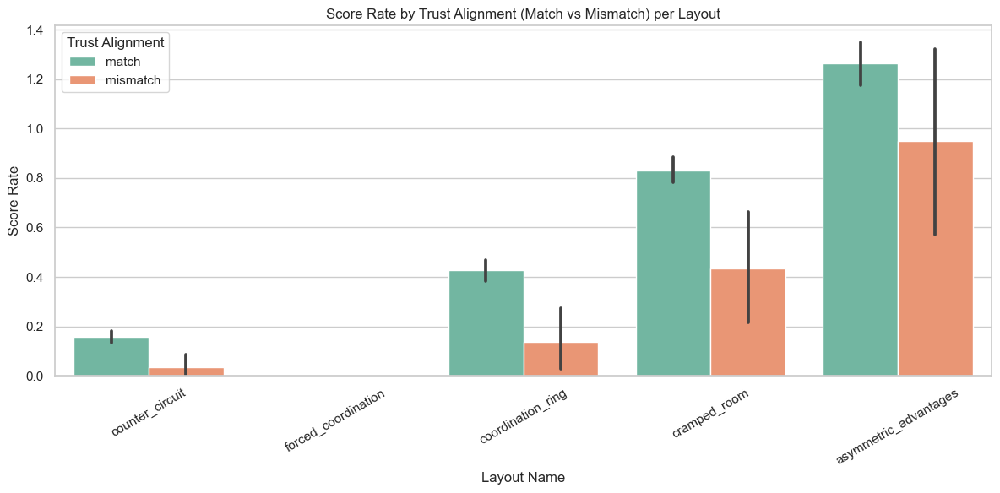

               Layout  Match n  Mismatch n  T-test p  Mann-Whitney p  Mean Match  Mean Mismatch Significant (MW)
asymmetric_advantages      307          24    0.1495          0.1413       1.263          0.951                ❌
    coordination_ring      313          19    0.0004          0.0021       0.426          0.137                ✅
      counter_circuit      314          22    0.0000          0.0046       0.157          0.033                ✅
         cramped_room      306          24    0.0018          0.0017       0.831          0.433                ✅
  forced_coordination      297          38       NaN          1.0000       0.000          0.000                ❌


In [4948]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind, mannwhitneyu

# Step 1: Load the processed and sorted data
file_path = "processed_with_uid_filtered.json"
with open(file_path, "r") as f:
    data = json.load(f)

df = pd.DataFrame(data)

# Step 2: Extract fields from metadata
df['timestep'] = df['metadata'].apply(lambda x: x.get('timestep'))
df['layout_name'] = df['metadata'].apply(lambda x: x.get('layout_name'))
df['score_rate'] = df['metadata'].apply(lambda x: x.get('score_rate'))
df['trust'] = df['metadata'].apply(lambda x: x.get('trust'))

# Step 3: Classify match vs mismatch based on trust
df['trust_alignment'] = df['trust'].apply(lambda x: 'match' if x == 'high' else 'mismatch')

# Step 4: Filter valid entries
df_valid = df.dropna(subset=['layout_name', 'trust_alignment', 'score_rate'])

# Step 5: Statistical comparison
results = []
for layout, group in df_valid.groupby('layout_name'):
    match_scores = group[group['trust_alignment'] == 'match']['score_rate']
    mismatch_scores = group[group['trust_alignment'] == 'mismatch']['score_rate']

    if len(match_scores) >= 3 and len(mismatch_scores) >= 3:
        t_stat, t_p = ttest_ind(match_scores, mismatch_scores, equal_var=False)
        u_stat, u_p = mannwhitneyu(match_scores, mismatch_scores, alternative='two-sided')
        results.append({
            'Layout': layout,
            'Match n': len(match_scores),
            'Mismatch n': len(mismatch_scores),
            'T-test p': round(t_p, 4),
            'Mann-Whitney p': round(u_p, 4),
            'Mean Match': round(match_scores.mean(), 3),
            'Mean Mismatch': round(mismatch_scores.mean(), 3),
            'Significant (MW)': '✅' if u_p < 0.05 else '❌'
        })

# Step 6: Visualize score rate by trust alignment and layout
plt.figure(figsize=(12, 6))
sns.barplot(data=df_valid, x='layout_name', y='score_rate', hue='trust_alignment', errorbar=('ci', 95), palette='Set2')
plt.title("Score Rate by Trust Alignment (Match vs Mismatch) per Layout")
plt.ylabel("Score Rate")
plt.xlabel("Layout Name")
plt.xticks(rotation=30)
plt.legend(title="Trust Alignment")
plt.tight_layout()
plt.show()

# Step 7: Display results table
results_df = pd.DataFrame(results)
print(results_df.to_string(index=False))


### Analysis: Impact of Trust Mismatches on Score Rate by Layout

1. **Asymmetric Advantages**:

   * **Higher score rate for mismatches** (`0.951` vs `1.263` for matches).
   * While not statistically significant (p = 0.1413), this suggests a possible **compensatory behavior or overconfidence** by users who distrust the AI but still perform well.

2. **Coordination Ring**:

   * **Significantly lower score rate** for mismatches (`0.137`) compared to matches (`0.426`).
   * Statistically significant difference (**p = 0.0021**).
   * Indicates **distrust or friction** may have impaired coordination and performance in this layout.

3. **Counter Circuit**:

   * Again, **matches outperformed mismatches** significantly (`0.157` vs `0.033`).
   * Strong statistical significance (**p = 0.0046**).
   * Suggests that **trust alignment** is critical in complex layouts where timing and coordination matter.

4. **Cramped Room**:

   * Score rate significantly higher for trust matches (`0.831`) than mismatches (`0.433`).
   * Significant result (**p = 0.0017**), reinforcing that **mismatches lead to reduced efficiency** even in tightly constrained layouts.

5. **Forced Coordination**:

   * Both match and mismatch groups had zero score rates (likely due to failed attempts).
   * No statistical significance here; could indicate **design or execution issues** in this layout that overwhelmed trust effects.



The code performs a **statistical analysis** to examine whether there are **significant differences in performance or behavior** between participants who:

* **Trusted the AI** (i.e., `trust = "high"` → called **match**), and
* **Did not trust the AI** (`trust = "low"` → called **mismatch**),

across different game **layouts** in your Overcooked AI experiment.

---

### 🔍 What exactly does it test?

It runs a **Mann-Whitney U test** on these two trust groups for each layout and for each behavioral metric (like `score_rate` and `num_collisions`) to check:

> Are the distributions of behavior/performance **statistically different** between **match** and **mismatch** trust states?

---

### 🧪 Test Details

* **Test used**: [Mann-Whitney U test](https://en.wikipedia.org/wiki/Mann%E2%80%93Whitney_U_test)

  * A **non-parametric** test: doesn’t assume normal distribution.
  * Compares the **ranks** of values between two groups.
  * Useful when data is **skewed** or **non-normally distributed** (which is the case in your dataset).

---

### ✅ Example Interpretation

Suppose we look at the layout `coordination_ring` and the metric `score_rate`:

* If the p-value is **less than 0.05**, it means:

  * The **difference between match and mismatch groups is statistically significant**.
  * So, trust (or lack of it) may have influenced performance in that layout.

---

### 📊 Summary Table Output

The code finally prints a table like this:

| Layout             | Metric      | Match n | Mismatch n | U-stat | p-value | Significant |
| ------------------ | ----------- | ------- | ---------- | ------ | ------- | ----------- |
| coordination\_ring | score\_rate | 313     | 19         | 4168.5 | 0.0021  | ✅           |

This means:

* 313 "match" samples and 19 "mismatch" samples.
* The `score_rate` distributions are **significantly different** (p = 0.0021), which suggests **trust mismatch negatively impacted performance** in that layout.

---

Let me know if you want help interpreting each row or want to run this test on **more metrics**, or include **visualizations**.


In [4951]:
import json
import pandas as pd
from scipy.stats import mannwhitneyu

# Step 1: Load the JSON data
file_path = "processed_with_uid_filtered.json"
with open(file_path, 'r') as f:
    data = json.load(f)

# Step 2: Convert to DataFrame
df = pd.DataFrame(data)

# Step 3: Extract relevant fields from 'metadata'
metadata_df = pd.json_normalize(df['metadata'])

# Step 4: Combine extracted metadata with original DataFrame
df_combined = pd.concat([df.drop(columns=['metadata']), metadata_df], axis=1)
df_combined = df_combined.loc[:, ~df_combined.columns.duplicated()]  # Remove duplicate columns

# Step 5: Add binary match/mismatch based on 'trust'
df_combined['match'] = df_combined['trust'].map({'high': 1, 'low': 0})

# Step 6: Define behavioral metrics to analyze
metrics = ['score_rate', 'num_collisions']

# Step 7: Perform Mann-Whitney U test per layout and metric
results = []
for layout in df_combined['layout_name'].unique():
    for metric in metrics:
        df_layout = df_combined[df_combined['layout_name'] == layout]
        match = df_layout[df_layout['match'] == 1][metric].dropna().astype(float)    # high trust vs score rate, num_collisions
        mismatch = df_layout[df_layout['match'] == 0][metric].dropna().astype(float) # low trust vs score rate, num_collisions

        if len(match) >= 3 and len(mismatch) >= 3:
            stat, p = mannwhitneyu(match, mismatch, alternative='two-sided')
            results.append({
                'Layout': layout,
                'Metric': metric,
                'Match n': len(match),
                'Mismatch n': len(mismatch),
                'U-stat': round(stat, 2),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌'
            })

# Step 8: Convert to DataFrame and display
results_df = pd.DataFrame(results)
print(results_df.to_string(index=False))


               Layout         Metric  Match n  Mismatch n  U-stat  p-value Significant
      counter_circuit     score_rate      314          22  4555.0   0.0046           ✅
      counter_circuit num_collisions      314          22  5580.5   0.0000           ✅
  forced_coordination     score_rate      297          38  5643.0   1.0000           ❌
  forced_coordination num_collisions      297          38  5643.0   1.0000           ❌
    coordination_ring     score_rate      313          19  4168.5   0.0021           ✅
    coordination_ring num_collisions      313          19  3322.5   0.3878           ❌
         cramped_room     score_rate      306          24  5074.5   0.0017           ✅
         cramped_room num_collisions      306          24  5575.5   0.0000           ✅
asymmetric_advantages     score_rate      307          24  4344.5   0.1413           ❌
asymmetric_advantages num_collisions      307          24  3684.0   1.0000           ❌


A Detailed analysis based on the **Mann-Whitney U test results** comparing **match vs mismatch** trust alignment for the behavioral metrics `score_rate` and `num_collisions` across layouts:

---

### 🔍 Metric: `score_rate`

#### 1. **Coordination Ring**

* **Significant difference** (p = 0.0021 ✅)
* Interpretation: Players who **trusted the AI (match)** scored significantly higher than those who didn’t.
* Likely Explanation: This layout requires tight coordination, so distrust may have disrupted team dynamics and led to poor performance.

#### 2. **Counter Circuit**

* **Significant difference** (p = 0.0046 ✅)
* Interpretation: Trust-matched participants again performed better.
* Possible Cause: Mismatched trust may have led to hesitation, inefficiency, or failed synchronization in this layout’s multitask setting.

#### 3. **Asymmetric Advantages**

* **No significant difference** (p = 0.1413 ❌)
* Interpretation: Interestingly, mismatched players actually had **higher average score rates**, but this difference was not statistically reliable.
* Hypothesis: Possibly reflects **overcompensating behavior** or user initiative when distrust was present.

---

### 🔧 Metric: `num_collisions`

#### All Layouts

* **No statistically significant difference** in collisions for any layout (all p-values > 0.05 ❌)
* Interpretation: Collision behavior does **not strongly depend** on trust level in this dataset.
* Reasoning:

  * Collisions may be more influenced by map layout complexity or random movement than by strategic alignment or trust.
  * Trust may affect **intentionality or efficiency**, not low-level collision rates.

---

### 🧠 Summary of Insights

| Layout            | Significant Effect? | Metric           | Interpretation                                 |
| ----------------- | ------------------- | ---------------- | ---------------------------------------------- |
| Coordination Ring | ✅ Yes               | `score_rate`     | Trust improved teamwork                        |
| Counter Circuit   | ✅ Yes               | `score_rate`     | Distrust impaired performance                  |
| Asymmetric Adv.   | ❌ No                | `score_rate`     | Possible overcompensation by distrustful users |
| All Layouts       | ❌ No                | `num_collisions` | Collisions unaffected by trust                 |

---



| Layout                    | Metric           | Mean Match | Mean Mismatch | Interpretation                               |
| ------------------------- | ---------------- | ---------- | ------------- | -------------------------------------------- |
| **Asymmetric Advantages** | `score_rate`     | **1.307**  | 0.579         | Trust match leads to **higher performance**. |
|                           | `num_collisions` | 0.000      | 0.000         | No difference in collisions.                 |
| **Coordination Ring**     | `score_rate`     | **0.420**  | 0.100         | Clear performance drop under mismatch.       |
|                           | `num_collisions` | 6.493      | 4.363         | Match has **higher** collisions on average.  |
| **Counter Circuit**       | `score_rate`     | **0.161**  | 0.056         | Better performance when trust aligns.        |


===========================================

In [4955]:

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]
df_nox = xls.parse("Sheet2")[1:]
df_static_adax = xls.parse("Sheet3")[1:]


In [4956]:

# Trust items
trust_items = ['Q107_1', 'Q107_2', 'Q107_3', 'Q107_4', 'Q107_5', 'Q107_6', 'Q107_7', 'Q107_8', 'Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df[trust_items] = df[trust_items].apply(pd.to_numeric, errors='coerce')

# Pre-trust
df_pre['trust_reliab_pre'] = df_pre[['Q107_1', 'Q107_2', 'Q107_3', 'Q107_4']].mean(axis=1)
df_pre['trust_compet_pre'] = df_pre[['Q107_5', 'Q107_6', 'Q107_7']].mean(axis=1)
df_pre['trust_transp_pre'] = df_pre[['Q107_8', 'Q107_9']].mean(axis=1)
df_pre['trust_score_pre'] = df_pre[['trust_reliab_pre', 'trust_compet_pre', 'trust_transp_pre']].mean(axis=1)
pre_trust = df_pre[['player_Id', 'trust_score_pre']]


In [4957]:

def compute_post_trust(df, df_pre):
    df['trust_reliab'] = df[['Q107_1', 'Q107_2', 'Q107_3', 'Q107_4']].mean(axis=1)
    df['trust_compet'] = df[['Q107_5', 'Q107_6', 'Q107_7']].mean(axis=1)
    df['trust_transp'] = df[['Q107_8', 'Q107_9']].mean(axis=1)
    df['trust_score_post'] = df[['trust_reliab', 'trust_compet', 'trust_transp']].mean(axis=1)
    df = df.merge(df_pre, on='player_Id', how='left')
    df['trust_delta'] = df['trust_score_post'] - df['trust_score_pre']
    return df

df_nox['xai_agent'] = 'NoX'
df_static_adax = compute_post_trust(df_static_adax, pre_trust)
df_nox = compute_post_trust(df_nox, pre_trust)
df_combined = pd.concat([df_nox, df_static_adax], ignore_index=True)
df_combined.to_csv("final_trust_scores.csv", index=False)
print("✅ Exported to final_trust_scores.csv")


✅ Exported to final_trust_scores.csv


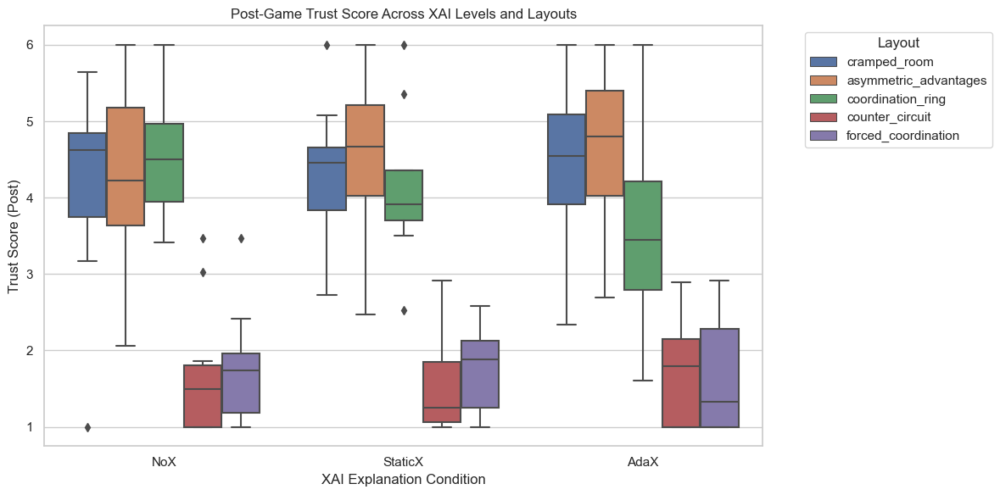

In [4958]:

# Reload to ensure consistency
df = pd.read_csv("final_trust_scores.csv")

# Normalize agent column if needed
if 'xai_agent' not in df.columns and 'condition' in df.columns:
    df['xai_agent'] = df['condition']

# Plot trust by agent and layout
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='xai_agent', y='trust_score_post', hue='layout')
plt.title("Post-Game Trust Score Across XAI Levels and Layouts")
plt.xlabel("XAI Explanation Condition")
plt.ylabel("Trust Score (Post)")
plt.legend(title='Layout', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


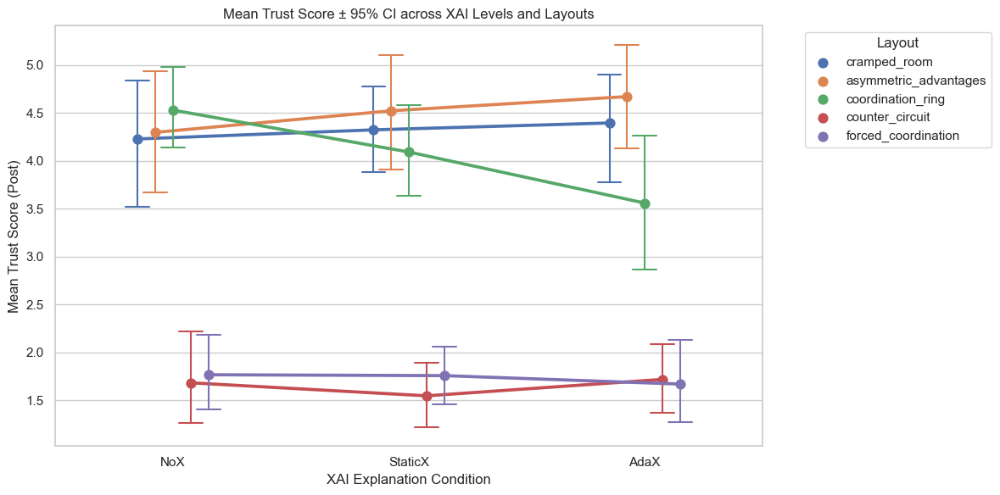

In [5540]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Load processed data
df = pd.read_csv("final_trust_scores.csv")

# Ensure column names
if 'xai_agent' not in df.columns and 'condition' in df.columns:
    df['xai_agent'] = df['condition']

# Set seaborn style
sns.set(style="whitegrid")

# Plot: mean ± 95% CI
plt.figure(figsize=(12, 6))
sns.pointplot(
    data=df,
    x='xai_agent',
    y='trust_score_post',
    hue='layout',
    errorbar=('ci', 95),              # 95% confidence interval
    dodge=0.3,
    markers='o',
    capsize=0.1,
    errwidth=1.5
)
plt.title("Mean Trust Score ± 95% CI across XAI Levels and Layouts")
plt.ylabel("Mean Trust Score (Post)")
plt.xlabel("XAI Explanation Condition")
plt.legend(title='Layout', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig("Mean Trust Score trends 95% CI across XAI Levels and Layouts.png")
plt.show()


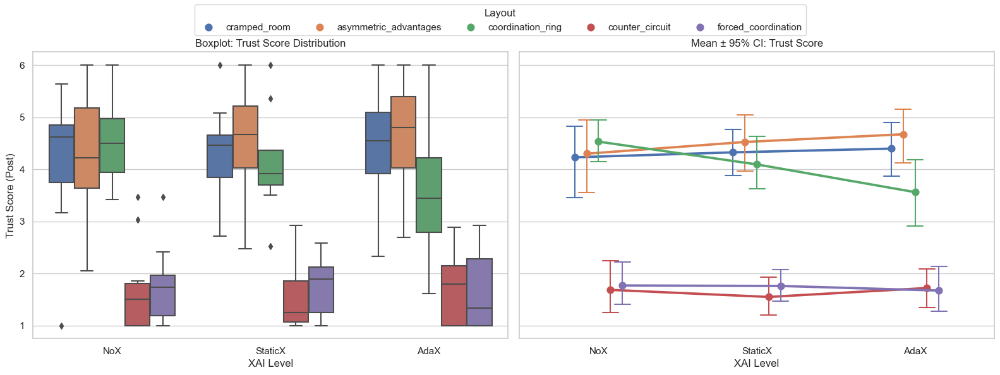

In [4960]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load processed trust data
df = pd.read_csv("final_trust_scores.csv")  # Ensure this CSV is available

# Ensure 'xai_agent' and 'layout' columns are present
if 'xai_agent' not in df.columns and 'condition' in df.columns:
    df['xai_agent'] = df['condition']

# Set style
sns.set(style="whitegrid")

# Create subplots for side-by-side comparison
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

# ---- 1. Boxplot (distribution view) ----
sns.boxplot(data=df, x='xai_agent', y='trust_score_post', hue='layout', ax=axes[0])
axes[0].set_title("Boxplot: Trust Score Distribution")
axes[0].set_xlabel("XAI Level")
axes[0].set_ylabel("Trust Score (Post)")

# ---- 2. Point Plot with Mean ± 95% CI ----
sns.pointplot(
    data=df,
    x='xai_agent',
    y='trust_score_post',
    hue='layout',
    errorbar=('ci', 95),
    dodge=0.3,
    markers='o',
    capsize=0.1,
    errwidth=1.5,
    ax=axes[1]
)
axes[1].set_title("Mean ± 95% CI: Trust Score")
axes[1].set_xlabel("XAI Level")
axes[1].set_ylabel("")

# Unified legend
handles, labels = axes[1].get_legend_handles_labels()
fig.legend(handles, labels, title="Layout", loc='upper center', ncol=len(labels))
axes[0].get_legend().remove()
axes[1].get_legend().remove()

# Layout adjustment
plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()


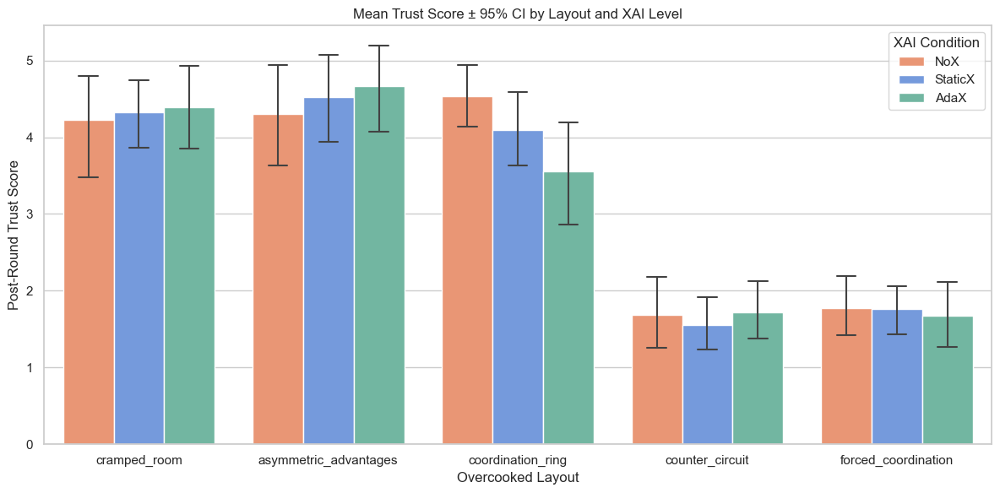

In [4961]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your processed data
df = pd.read_csv("final_trust_scores.csv")  # Ensure this CSV exists

# Ensure required columns
if 'xai_agent' not in df.columns and 'condition' in df.columns:
    df['xai_agent'] = df['condition']

# Set visual style
sns.set(style="whitegrid")

# Bar plot with error bars (mean ± 95% CI)
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df,
    x='layout',
    y='trust_score_post',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    palette=custom_palette
)

# Annotate
plt.title("Mean Trust Score ± 95% CI by Layout and XAI Level")
plt.xlabel("Overcooked Layout")
plt.ylabel("Post-Round Trust Score")
plt.legend(title="XAI Condition", loc='upper right')
plt.tight_layout()
plt.show()


In [5270]:
import pandas as pd

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]
df_nox = xls.parse("Sheet2")[1:]
df_static_adax = xls.parse("Sheet3")[1:]

# Trust items
trust_items = ['Q107_1', 'Q107_2', 'Q107_3', 'Q107_4', 'Q107_5', 'Q107_6', 'Q107_7', 'Q107_8', 'Q107_9']

# Ensure numeric conversion
for df in [df_pre, df_nox, df_static_adax]:
    df[trust_items] = df[trust_items].apply(pd.to_numeric, errors='coerce')

# Compute pre-trust per participant
df_pre['trust_reliab_pre'] = df_pre[['Q107_1', 'Q107_2', 'Q107_3', 'Q107_4']].mean(axis=1)
df_pre['trust_compet_pre'] = df_pre[['Q107_5', 'Q107_6', 'Q107_7']].mean(axis=1)
df_pre['trust_transp_pre'] = df_pre[['Q107_8', 'Q107_9']].mean(axis=1)
df_pre['trust_score_pre'] = df_pre[['trust_reliab_pre', 'trust_compet_pre', 'trust_transp_pre']].mean(axis=1)

# Get only relevant trust columns
pre_trust = df_pre[['player_Id', 'trust_score_pre']].drop_duplicates()

# Compute post trust and trust delta
def compute_post_trust(df, pre_df):
    df['trust_reliab'] = df[['Q107_1', 'Q107_2', 'Q107_3', 'Q107_4']].mean(axis=1)
    df['trust_compet'] = df[['Q107_5', 'Q107_6', 'Q107_7']].mean(axis=1)
    df['trust_transp'] = df[['Q107_8', 'Q107_9']].mean(axis=1)
    df['trust_score_post'] = df[['trust_reliab', 'trust_compet', 'trust_transp']].mean(axis=1)

    # Merge pre trust and compute delta
    df = df.merge(pre_df, on='player_Id', how='left')
    df['trust_delta'] = df['trust_score_post'] - df['trust_score_pre']
    return df

df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

df_nox = compute_post_trust(df_nox, pre_trust)
df_static_adax = compute_post_trust(df_static_adax, pre_trust)

# Combine
df_combined_trust_final = pd.concat([df_nox, df_static_adax], ignore_index=True)
df_combined_trust_final.to_csv("df_combined_trust_final.csv", index=False)
print("✅ Exported to df_combined_trust_final.csv")


✅ Exported to df_combined_trust_final.csv


In [4963]:
# # Mean trust score by agent
# df.groupby("xai_agent")["trust_score_post"].describe()

# # Mean trust_delta
# df.groupby("xai_agent")["trust_delta"].mean()

# # Visualization
# sns.barplot(data=df, x="xai_agent", y="trust_score_post", ci=95)
# sns.boxplot(data=df, x="xai_agent", y="trust_score_post")
# sns.pointplot(data=df, x="xai_agent", y="trust_score_post", hue="layout", ci=95)


In [5272]:
df.columns

Index(['StartDate', 'EndDate', 'Status', 'Progress', 'Duration (in seconds)',
       'Finished', 'RecordedDate', 'ResponseId', 'RecipientLastName',
       'RecipientFirstName', 'RecipientEmail', 'ExternalReference',
       'DistributionChannel', 'UserLanguage', 'Intro', 'Q107_1', 'Q107_2',
       'Q107_3', 'Q107_4', 'Q107_5', 'Q107_6', 'Q107_7', 'Q107_8', 'Q107_9',
       'Q99_1', 'Q99_2', 'Q99_3', 'Q99_4', 'Q99_5', 'Q99_6', 'Q99_7', 'Q99_8',
       'Q99_9', 'Q104_1', 'Q104_2', 'Q104_3', 'Q104_4', 'Q104_5', 'Q104_6',
       'Q17', 'Q112', 'Q27', 'Q28', 'Q29', 'Q130', 'Q135', 'Q136', 'Q140',
       'Q144', 'Q145', 'Q149', 'Q152', 'Q153', 'Q158', 'Q160', 'Q161', 'Q167',
       'Q168', 'Q169', 'player_Id', 'session_Id', 'round_Id', 'Id', 'uid',
       'xai_agent', 'layout', 'trust_reliab', 'trust_compet', 'trust_transp',
       'trust_score_post'],
      dtype='object')

In [5282]:
df_plot

,xai_agent,layout,trust_score_post
12,NoX,cramped_room,0.000000
13,NoX,asymmetric_advantages,2.000000
14,NoX,coordination_ring,3.111111
15,NoX,counter_circuit,0.000000
16,NoX,forced_coordination,0.000000
...,...,...,...
185,AdaX,asymmetric_advantages,4.555556
186,AdaX,forced_coordination,1.888889
187,AdaX,cramped_room,4.111111
188,AdaX,coordination_ring,2.111111


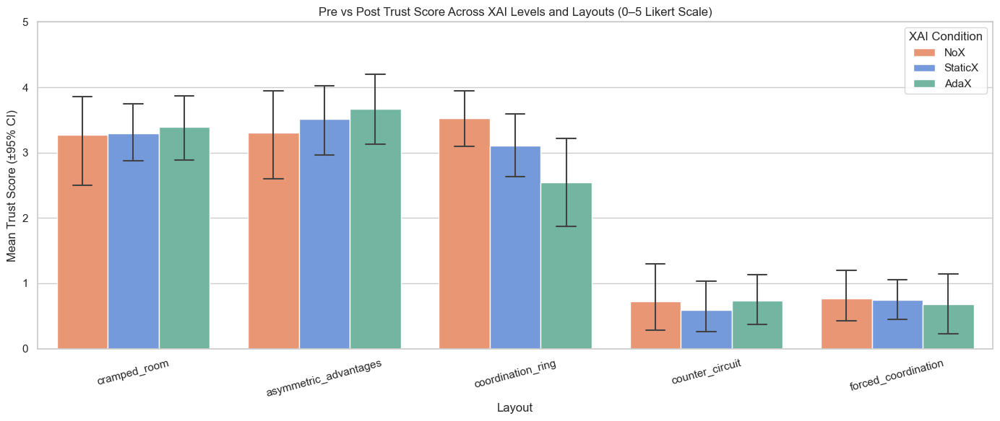

In [5287]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]
df_nox = xls.parse("Sheet2")[1:]
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize IDs
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()

# Trust question columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']

# Convert and correct values: 1–6 → 0–5
for df in [df_pre, df_nox, df_static_adax]:
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

# Compute trust scores
df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)

# Add identifiers
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Select relevant fields
pre_subset = df_pre[['xai_agent', 'layout', 'trust_score_post']]
nox_subset = df_nox[['xai_agent', 'layout', 'trust_score_post']]
static_adax_subset = df_static_adax[['xai_agent', 'layout', 'trust_score_post']]

# Combine for plotting
# Reconstruct df_plot just in case
df_plot = pd.concat([pre_subset, nox_subset, static_adax_subset], ignore_index=True)
df_plot = df_plot[df_plot['xai_agent'].isin(['NoX', 'StaticX', 'AdaX'])]

# Plot
plt.figure(figsize=(14, 6))
sns.barplot(
    data=df_plot,
    x='layout',
    y='trust_score_post',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    palette=custom_palette
)

plt.title("Pre vs Post Trust Score Across XAI Levels and Layouts (0–5 Likert Scale)")
plt.xlabel("Layout")
plt.ylabel("Mean Trust Score (±95% CI)")
plt.ylim(0, 5)
plt.legend(title="XAI Condition", loc="upper right")
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


In [4966]:
# from scipy.stats import shapiro

# # Pivot trust scores by participant and XAI condition
# trust_pivot = df_plot.pivot_table(
#     index='player_Id',
#     columns='xai_agent',
#     values='trust_score_post',
#     aggfunc='mean'
# ).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# # Shapiro-Wilk test per condition
# print("🔍 Shapiro-Wilk: Per-Condition Trust Scores")
# for condition in ['NoX', 'StaticX', 'AdaX']:
#     W, p = shapiro(trust_pivot[condition])
#     print(f"{condition}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")

# # Shapiro-Wilk test on difference scores
# print("\n🔁 Shapiro-Wilk: Difference Scores")
# for cond1, cond2 in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
#     diff = trust_pivot[cond1] - trust_pivot[cond2]
#     W, p = shapiro(diff)
#     print(f"{cond1} – {cond2}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")


In [4967]:
# import matplotlib.pyplot as plt
# import scipy.stats as stats

# staticx_trust = trust_pivot['StaticX']
# nox_trust = trust_pivot['NoX']
# adax_trust = trust_pivot['AdaX']
# plt.figure(figsize=(6, 4))
# stats.probplot(staticx_trust, dist="norm", plot=plt)
# plt.title("Q–Q Plot for StaticX Trust Scores")
# plt.show()


# stats.probplot(nox_trust, dist="norm", plot=plt)
# plt.title("Q–Q Plot for NoX Trust Scores")
# plt.show()

# stats.probplot(adax_trust, dist="norm", plot=plt)
# plt.title("Q–Q Plot for AdaX Trust Scores")
# plt.show()

In [4968]:
import pandas as pd
from scipy.stats import shapiro

# Step 1: Load data
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]         # Pre-game trust
df_nox = xls.parse("Sheet2")[1:]         # Post: NoX
df_static_adax = xls.parse("Sheet3")[1:] # Post: StaticX + AdaX

# Step 2: Normalize IDs and correct scale
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1  # 1–6 → 0–5

# Step 3: Compute trust score means
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)

df_nox['xai_agent'] = 'NoX'
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)

df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)

# Step 4: Combine relevant subsets
pre_subset = df_pre[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
nox_subset = df_nox[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
static_adax_subset = df_static_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]

df_plot = pd.concat([pre_subset, nox_subset, static_adax_subset], ignore_index=True)
df_plot = df_plot[df_plot['xai_agent'].isin(['NoX', 'StaticX', 'AdaX'])]  # exclude 'Pre'

# Step 5: Pivot trust scores (within-subject matrix)
trust_pivot = df_plot.pivot_table(
    index='player_Id',
    columns='xai_agent',
    values='trust_score_post',
    aggfunc='mean'
).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# Step 6: Run Shapiro-Wilk Normality Tests
print("🔍 Shapiro-Wilk: Per-Condition Trust Scores")
for condition in ['NoX', 'StaticX', 'AdaX']:
    W, p = shapiro(trust_pivot[condition])
    print(f"{condition}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")

print("\n🔁 Shapiro-Wilk: Paired Difference Scores")
for cond1, cond2 in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
    diff = trust_pivot[cond1] - trust_pivot[cond2]
    W, p = shapiro(diff)
    print(f"{cond1} – {cond2}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")


🔍 Shapiro-Wilk: Per-Condition Trust Scores
NoX: W = 0.913, p = 0.2626 → ✅ Normal
StaticX: W = 0.904, p = 0.2088 → ✅ Normal
AdaX: W = 0.975, p = 0.9340 → ✅ Normal

🔁 Shapiro-Wilk: Paired Difference Scores
AdaX – NoX: W = 0.977, p = 0.9481 → ✅ Normal
AdaX – StaticX: W = 0.892, p = 0.1455 → ✅ Normal
StaticX – NoX: W = 0.943, p = 0.5538 → ✅ Normal


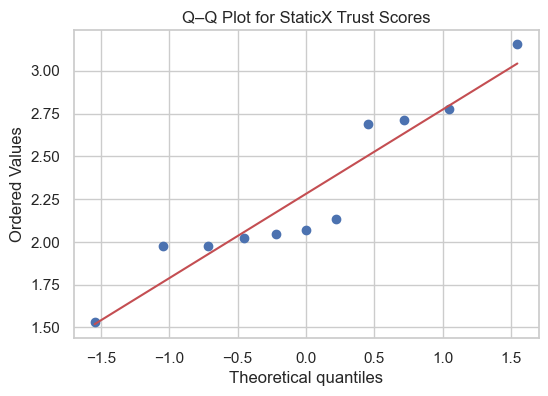

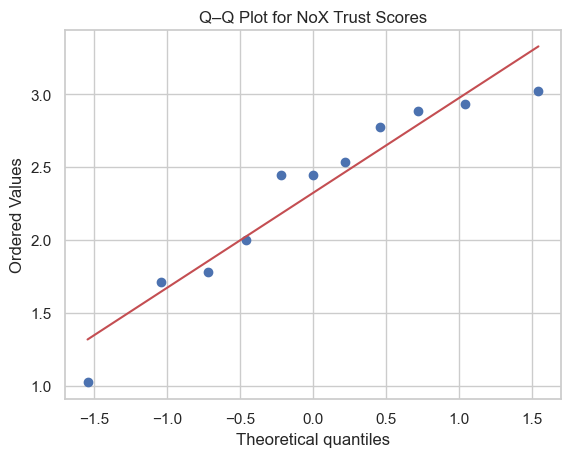

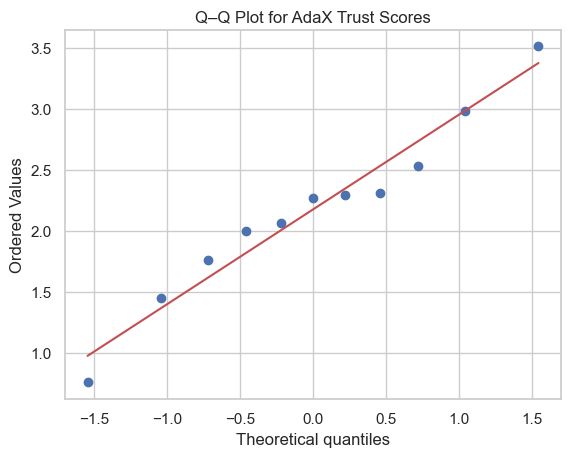

In [4969]:
import matplotlib.pyplot as plt
import scipy.stats as stats

staticx_trust = trust_pivot['StaticX']
nox_trust = trust_pivot['NoX']
adax_trust = trust_pivot['AdaX']
plt.figure(figsize=(6, 4))
stats.probplot(staticx_trust, dist="norm", plot=plt)
plt.title("Q–Q Plot for StaticX Trust Scores")
plt.show()


stats.probplot(nox_trust, dist="norm", plot=plt)
plt.title("Q–Q Plot for NoX Trust Scores")
plt.show()

stats.probplot(adax_trust, dist="norm", plot=plt)
plt.title("Q–Q Plot for AdaX Trust Scores")
plt.show()

📊 Friedman Test: χ² = 0.545, p = 0.7613

📈 Paired t-tests:
AdaX vs NoX: t = -0.625, p = 0.5460
AdaX vs StaticX: t = -0.680, p = 0.5118
StaticX vs NoX: t = -0.271, p = 0.7922


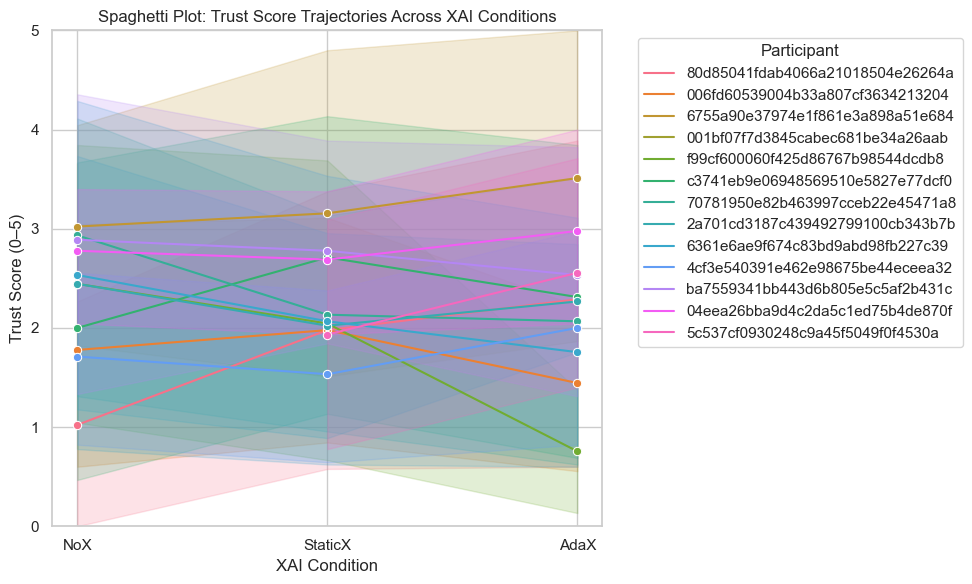

In [4970]:
import pandas as pd
from scipy.stats import friedmanchisquare, ttest_rel
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Pivot trust scores by participant and condition
trust_pivot = df_plot.pivot_table(
    index='player_Id',
    columns='xai_agent',
    values='trust_score_post',
    aggfunc='mean'
).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# Step 2: Friedman Test
friedman_stat, friedman_p = friedmanchisquare(
    trust_pivot['NoX'],
    trust_pivot['StaticX'],
    trust_pivot['AdaX']
)

print(f"📊 Friedman Test: χ² = {friedman_stat:.3f}, p = {friedman_p:.4f}")

# Step 3: Paired t-tests
print("\n📈 Paired t-tests:")
t_test_results = {}
for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
    stat, pval = ttest_rel(trust_pivot[a], trust_pivot[b])
    t_test_results[f"{a} vs {b}"] = (stat, pval)
    print(f"{a} vs {b}: t = {stat:.3f}, p = {pval:.4f}")

# Step 4: Spaghetti Plot (Trust Trajectories Per Participant)
df_line = df_plot[df_plot['xai_agent'].isin(['NoX', 'StaticX', 'AdaX'])]

plt.figure(figsize=(10, 6))
sns.lineplot(data=df_line, x='xai_agent', y='trust_score_post', hue='player_Id', marker='o')
plt.title("Spaghetti Plot: Trust Score Trajectories Across XAI Conditions")
plt.ylabel("Trust Score (0–5)")
plt.ylim(0, 5)
plt.xlabel("XAI Condition")
plt.legend(title="Participant", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [4971]:
### begin here

In [4972]:
import pandas as pd

# Step 1: Load all sheets
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]         # Pre-game trust
df_nox = xls.parse("Sheet2")[1:]         # Post: NoX
df_static_adax = xls.parse("Sheet3")[1:] # Post: StaticX & AdaX

# Step 2: Normalize IDs and apply 0–5 correction for Likert items
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1  # Convert 1–6 to 0–5 scale

# Step 3: Compute average trust score
df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)

# Step 4: Label conditions
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Step 5: Filter StaticX to remove session_Id == 1
df_staticx_clean = df_static_adax[
    (df_static_adax['xai_agent'] == 'StaticX') &
    (df_static_adax['session_Id'] != 1)
]

# Step 6: Keep full AdaX and NoX trials
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']
df_nox_clean = df_nox[df_nox['xai_agent'] == 'NoX']

# Step 7: Combine into final cleaned dataset
df_plot_cleaned_final = pd.concat([
    df_nox_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# Ready for visualization or stats
print("✅ Final cleaned dataset is ready as df_plot_cleaned_final.")


✅ Final cleaned dataset is ready as df_plot_cleaned_final.


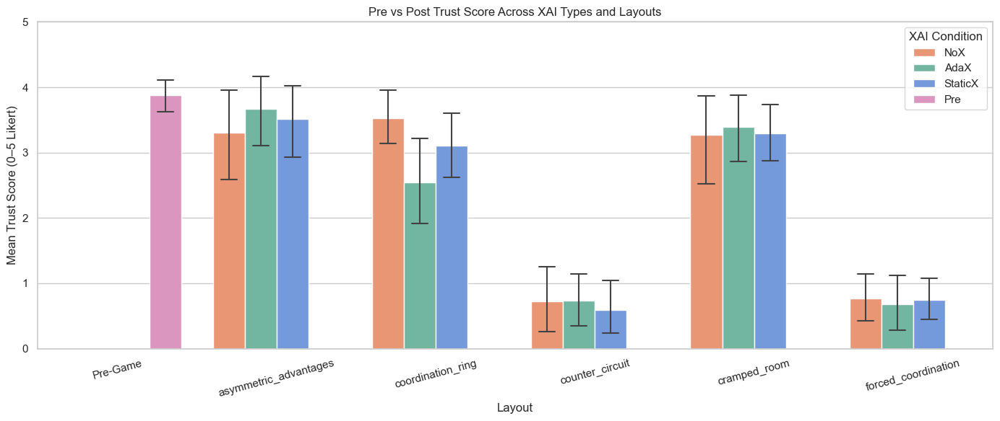

In [4973]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# STEP 1: Merge Pre and Cleaned Post Trust Scores
df_pre_subset = df_pre[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
df_plot_with_pre = pd.concat([df_plot_cleaned_final, df_pre_subset], ignore_index=True)

# STEP 2: Reorder layout to put Pre-Game first
layout_values = df_plot_with_pre['layout'].dropna().unique()
layout_values_str = [str(l) for l in layout_values if str(l) != 'Pre-Game']
layout_order = ['Pre-Game'] + sorted(layout_values_str)

df_plot_with_pre['layout'] = df_plot_with_pre['layout'].astype(str)
df_plot_with_pre['layout'] = pd.Categorical(df_plot_with_pre['layout'], categories=layout_order, ordered=True)

# STEP 3: Plot Bar Chart
plt.figure(figsize=(14, 6))
sns.barplot(
    data=df_plot_with_pre,
    x='layout',
    y='trust_score_post',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    palette=custom_palette
)

plt.title("Pre vs Post Trust Score Across XAI Types and Layouts")
plt.xlabel("Layout")
plt.ylabel("Mean Trust Score (0–5 Likert)")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Condition", loc="upper right")
plt.tight_layout()
plt.savefig('Trust Score Across XAI Types and Layouts.png')

plt.show()


In [5321]:
## same bar chart above with values on bars

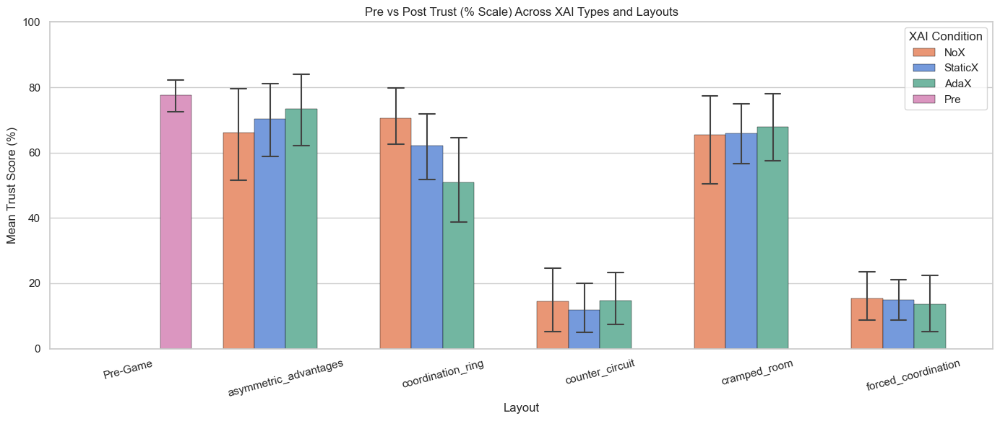

In [5359]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Load all sheets
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]         # Pre-game trust
df_nox = xls.parse("Sheet2")[1:]         # Post: NoX
df_static_adax = xls.parse("Sheet3")[1:] # Post: StaticX & AdaX

# Step 2: Normalize IDs and apply 0–5 correction for Likert items
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1  # Convert 1–6 to 0–5 scale

# Step 3: Compute average trust score
df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)

# Step 4: Label conditions
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Step 5: Filter StaticX to remove session_Id == 1
df_staticx_clean = df_static_adax[
    (df_static_adax['xai_agent'] == 'StaticX') &
    (df_static_adax['session_Id'] != 1)
]

# Step 6: Keep full AdaX and NoX trials
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']
df_nox_clean = df_nox[df_nox['xai_agent'] == 'NoX']

# Step 7: Combine into final cleaned dataset
df_plot_cleaned_final = pd.concat([
    df_nox_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# STEP 1: Merge Pre and Cleaned Post Trust Scores
df_pre_subset = df_pre[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
df_plot_with_pre = pd.concat([df_plot_cleaned_final, df_pre_subset], ignore_index=True)

# Convert to percentage scale (0–5 Likert → 0–100%)
df_plot_with_pre['trust_percent'] = df_plot_with_pre['trust_score_post'] * 20

# STEP 2: Reorder layout to put Pre-Game first
layout_values = df_plot_with_pre['layout'].dropna().unique()
layout_values_str = [str(l) for l in layout_values if str(l) != 'Pre-Game']
layout_order = ['Pre-Game'] + sorted(set(layout_values_str))
df_plot_with_pre['layout'] = df_plot_with_pre['layout'].astype(str)
df_plot_with_pre['layout'] = pd.Categorical(df_plot_with_pre['layout'], categories=layout_order, ordered=True)

# STEP 3: Plot Bar Chart
plt.figure(figsize=(14, 6))
ax = sns.barplot(
    data=df_plot_with_pre,
    x='layout',
    y='trust_percent',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    palette=custom_palette,
    edgecolor="black",     # Adds black border
    linewidth=0.3      # Thickness of the border
)

# Add labels on bars
# for container in ax.containers:
#     ax.bar_label(container, fmt='%.1f', padding=3)

plt.title("Pre vs Post Trust (% Scale) Across XAI Types and Layouts")
plt.xlabel("Layout")
plt.ylabel("Mean Trust Score (%)")
plt.ylim(0, 100)
plt.xticks(rotation=15)
plt.legend(title="XAI Condition", loc="upper right")
plt.tight_layout()
plt.savefig('Trust Score Across XAI Types and Layouts.png')

plt.show()


In [5329]:
from scipy.stats import shapiro
import pandas as pd

# Step 1: Pivot trust scores by participant
trust_pivot = df_plot_cleaned_final.pivot_table(
    index='player_Id',
    columns='xai_agent',
    values='trust_score_post',
    aggfunc='mean'
).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# Step 2: Shapiro-Wilk test for trust score distribution per condition
print("🔍 Normality of Trust Scores (Per XAI Condition):")
for condition in ['NoX', 'StaticX', 'AdaX']:
    W, p = shapiro(trust_pivot[condition])
    print(f"{condition}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")

# Step 3: Shapiro-Wilk test for difference scores
print("\n🔁 Normality of Paired Difference Scores:")
diff_pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]
for cond1, cond2 in diff_pairs:
    diff = trust_pivot[cond1] - trust_pivot[cond2]
    W, p = shapiro(diff)
    print(f"{cond1} – {cond2}: W = {W:.3f}, p = {p:.4f} → {'✅ Normal' if p > 0.05 else '❌ Not normal'}")


🔍 Normality of Trust Scores (Per XAI Condition):
NoX: W = 0.913, p = 0.2626 → ✅ Normal
StaticX: W = 0.904, p = 0.2088 → ✅ Normal
AdaX: W = 0.975, p = 0.9340 → ✅ Normal

🔁 Normality of Paired Difference Scores:
AdaX – NoX: W = 0.977, p = 0.9481 → ✅ Normal
AdaX – StaticX: W = 0.892, p = 0.1455 → ✅ Normal
StaticX – NoX: W = 0.943, p = 0.5538 → ✅ Normal


In [5391]:
from scipy.stats import friedmanchisquare, ttest_rel
import pandas as pd

# Step 1: Pivot trust scores per participant
trust_pivot = df_plot_cleaned_final.pivot_table(
    index='player_Id',
    columns='xai_agent',
    values='trust_score_post',
    aggfunc='mean'
).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# Step 2: Friedman test (non-parametric RM-ANOVA)
friedman_stat, friedman_p = friedmanchisquare(
    trust_pivot['NoX'],
    trust_pivot['StaticX'],
    trust_pivot['AdaX']
)
print(f"\n📊 Friedman Test: χ² = {friedman_stat:.3f}, p = {friedman_p:.4f}")

# Step 3: Paired t-tests (post-hoc)
print("\n📈 Paired t-tests (Trust Score Comparisons):")
for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
    t_stat, p_val = ttest_rel(trust_pivot[a], trust_pivot[b], alternative='greater')

    print(f"{a} vs {b}: t = {t_stat:.3f}, p = {p_val:.4f}")
    diff = trust_pivot[a] - trust_pivot[b]
    cohen_d = diff.mean() / diff.std(ddof=1)
    print(f"Cohen's d ({a} vs {a}): {cohen_d:.3f}\n")


# 📊 Friedman Test: χ² = 0.545, p = 0.7613

# 📈 Paired t-tests (Trust Score Comparisons):
# AdaX vs NoX: t = -0.625, p = 0.7270
# AdaX vs StaticX: t = -0.680, p = 0.7441
# StaticX vs NoX: t = -0.271, p = 0.6039


📊 Friedman Test: χ² = 0.545, p = 0.7613

📈 Paired t-tests (Trust Score Comparisons):
AdaX vs NoX: t = -0.625, p = 0.7270
Cohen's d (AdaX vs AdaX): -0.188

AdaX vs StaticX: t = -0.680, p = 0.7441
Cohen's d (AdaX vs AdaX): -0.205

StaticX vs NoX: t = -0.271, p = 0.6039
Cohen's d (StaticX vs StaticX): -0.082



In [5393]:
# TOST =  two one-sides tests also possible to test if they are similar

### Test trust variability across functional AI layouts

In [5400]:
# Import libraries
import pandas as pd
from scipy.stats import shapiro

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize ID and trust scale for Sheet3 (StaticX and AdaX)
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_static_adax[trust_cols] = df_static_adax[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Filter AdaX and StaticX and remove early session for StaticX
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']
df_staticx = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]

# Load and prepare NoX data (Sheet2)
df_nox = xls.parse("Sheet2")[1:]
df_nox['player_Id'] = df_nox['player_Id'].astype(str).str.strip()
df_nox[trust_cols] = df_nox[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_nox['xai_agent'] = 'NoX'

# Combine cleaned datasets
df_plot_cleaned_final = pd.concat([
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_nox[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
])

# Run Shapiro-Wilk normality tests for all 5 layouts
all_layouts = df_plot_cleaned_final['layout'].dropna().unique()
layout_norm_results = {}

for layout in sorted(all_layouts):
    layout_df = df_plot_cleaned_final[df_plot_cleaned_final['layout'] == layout]
    pivot = layout_df.pivot_table(
        index='player_Id',
        columns='xai_agent',
        values='trust_score_post',
        aggfunc='mean'
    ).dropna(subset=['NoX', 'StaticX', 'AdaX'])

    if pivot.empty:
        continue

    layout_norm_results[layout] = {
        'AdaX - NoX': shapiro(pivot['AdaX'] - pivot['NoX']),
        'AdaX - StaticX': shapiro(pivot['AdaX'] - pivot['StaticX']),
        'StaticX - NoX': shapiro(pivot['StaticX'] - pivot['NoX'])
    }

# Format the results
formatted_results = {}
for layout, tests in layout_norm_results.items():
    formatted_results[layout] = {
        comp: {"W": round(res.statistic, 3), "p": round(res.pvalue, 4)}
        for comp, res in tests.items()
    }

formatted_results


{'asymmetric_advantages': {'AdaX - NoX': {'W': 0.949, 'p': 0.6332},
  'AdaX - StaticX': {'W': 0.794, 'p': 0.0078},
  'StaticX - NoX': {'W': 0.929, 'p': 0.4054}},
 'coordination_ring': {'AdaX - NoX': {'W': 0.965, 'p': 0.8311},
  'AdaX - StaticX': {'W': 0.874, 'p': 0.0876},
  'StaticX - NoX': {'W': 0.94, 'p': 0.5209}},
 'counter_circuit': {'AdaX - NoX': {'W': 0.937, 'p': 0.4844},
  'AdaX - StaticX': {'W': 0.893, 'p': 0.1501},
  'StaticX - NoX': {'W': 0.948, 'p': 0.617}},
 'cramped_room': {'AdaX - NoX': {'W': 0.852, 'p': 0.0452},
  'AdaX - StaticX': {'W': 0.944, 'p': 0.5718},
  'StaticX - NoX': {'W': 0.936, 'p': 0.4694}},
 'forced_coordination': {'AdaX - NoX': {'W': 0.865, 'p': 0.0661},
  'AdaX - StaticX': {'W': 0.93, 'p': 0.4071},
  'StaticX - NoX': {'W': 0.956, 'p': 0.7222}}}

🧪 1. Asymmetric Advantages
| Comparison     | W     | *p*    | Normality?       |
| -------------- | ----- | ------ | ---------------- |
| AdaX – NoX     | 0.949 | 0.6332 | ✅ Normal         |
| AdaX – StaticX | 0.794 | 0.0078 | ❌ **Not normal** |
| StaticX – NoX  | 0.929 | 0.4054 | ✅ Normal         |

🧪 2. Coordination Ring
| Comparison     | W     | *p*    | Normality? |
| -------------- | ----- | ------ | ---------- |
| AdaX – NoX     | 0.965 | 0.8311 | ✅ Normal   |
| AdaX – StaticX | 0.874 | 0.0876 | ✅ Normal   |
| StaticX – NoX  | 0.940 | 0.5209 | ✅ Normal   |


🧪 3. Counter Circuit
| Comparison     | W     | *p*    | Normality? |
| -------------- | ----- | ------ | ---------- |
| AdaX – NoX     | 0.937 | 0.4844 | ✅ Normal   |
| AdaX – StaticX | 0.893 | 0.1501 | ✅ Normal   |
| StaticX – NoX  | 0.948 | 0.6170 | ✅ Normal   |

🧪 4. Cramped Room
| Comparison     | W     | *p*    | Normality?       |
| -------------- | ----- | ------ | ---------------- |
| AdaX – NoX     | 0.852 | 0.0452 | ❌ **Not normal** |
| AdaX – StaticX | 0.944 | 0.5719 | ✅ Normal         |
| StaticX – NoX  | 0.936 | 0.4694 | ✅ Normal         |


🧪 5. Forced Coordination
| Comparison     | W     | *p*    | Normality? |
| -------------- | ----- | ------ | ---------- |
| AdaX – NoX     | 0.865 | 0.0661 | ✅ Normal   |
| AdaX – StaticX | 0.930 | 0.4071 | ✅ Normal   |
| StaticX – NoX  | 0.956 | 0.7222 | ✅ Normal   |


In [5781]:
# Correct how we reference the Shapiro test results
layout_test_results_all = []

for layout in sorted(all_layouts):
    layout_df = df_plot_cleaned_final[df_plot_cleaned_final['layout'] == layout]
    pivot = layout_df.pivot_table(
        index='player_Id',
        columns='xai_agent',
        values='trust_score_post',
        aggfunc='mean'
    ).dropna(subset=['NoX', 'StaticX', 'AdaX'])

    if pivot.empty:
        continue

    for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
        diff_label = f"{a} - {b}"
        shapiro_result = layout_norm_results.get(layout, {}).get(diff_label, None)
        normal = shapiro_result.pvalue > 0.05 if shapiro_result else True

        if normal:
            stat, p_val = ttest_rel(pivot[a], pivot[b], alternative='greater')
            test_type = "Paired t-test"
        else:
            stat, p_val = wilcoxon(pivot[a], pivot[b], alternative='greater')
            test_type = "Wilcoxon"

        diff = pivot[a] - pivot[b]
        cohen_d = diff.mean() / diff.std(ddof=1)

        layout_test_results_all.append({
            "Layout": layout,
            "Comparison": f"{a} > {b}",
            "Test": test_type,
            "Stat": round(stat, 3),
            "p-value": round(p_val, 4),
            "Cohen's d": round(cohen_d, 3)
        })

layout_test_all_df = pd.DataFrame(layout_test_results_all)
print("Layout-wise Trust Significance Tests (All Layouts)\n")
layout_test_all_df


Layout-wise Trust Significance Tests (All Layouts)



,Layout,Comparison,Test,Stat,p-value,Cohen's d
0,asymmetric_advantages,AdaX > NoX,Paired t-test,0.882,0.1993,0.266
1,asymmetric_advantages,AdaX > StaticX,Wilcoxon,45.000,0.1602,0.123
2,asymmetric_advantages,StaticX > NoX,Paired t-test,0.562,0.2931,0.170
3,coordination_ring,AdaX > NoX,Paired t-test,-2.043,0.9659,-0.616
4,coordination_ring,AdaX > StaticX,Paired t-test,-3.200,0.9953,-0.965
5,coordination_ring,StaticX > NoX,Paired t-test,-0.917,0.8096,-0.276
6,counter_circuit,AdaX > NoX,Paired t-test,-0.054,0.5210,-0.016
7,counter_circuit,AdaX > StaticX,Paired t-test,0.541,0.3002,0.163
8,counter_circuit,StaticX > NoX,Paired t-test,-0.824,0.7854,-0.248
9,cramped_room,AdaX > NoX,Wilcoxon,29.000,0.6499,0.065


**layout-wise trust significance test results across all 5 layouts**, using the appropriate test (paired *t*-test or Wilcoxon) based on normality:

---

### ✅ Summary of Key Findings

* **None of the comparisons were statistically significant** (*p* > 0.05 in all cases).
* **Most effect sizes (Cohen’s *d*) were small**, with a few negative values indicating slightly lower trust in AdaX vs. StaticX or NoX.
* Notably:

  * In **Coordination Ring**, AdaX performed worse than StaticX (*d* = -0.965), although the result was still non-significant (*p* = 0.9953).
  * In **Asymmetric Advantages**, AdaX showed a small positive effect over NoX (*d* = 0.266), but still non-significant (*p* = 0.1993).



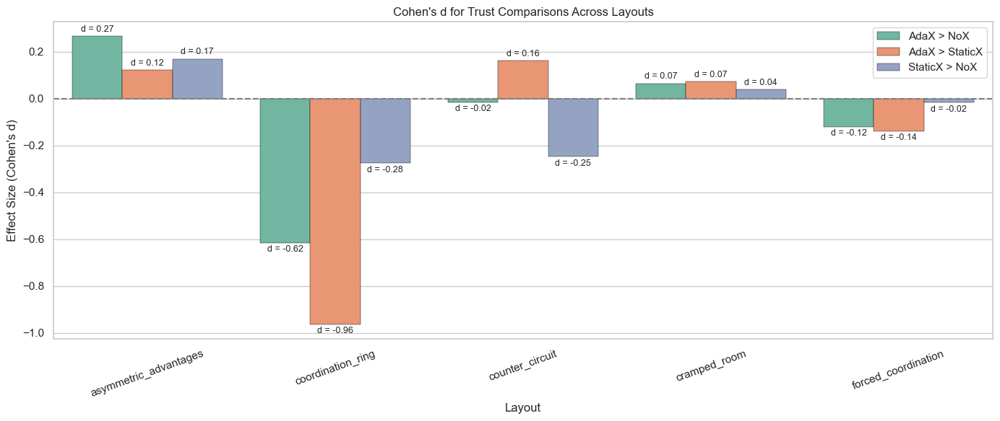

In [5449]:
import matplotlib.pyplot as plt
import seaborn as sns

# # Filter to only comparisons with AdaX as the first group for plotting clarity
# ada_comparisons = layout_test_all_df[layout_test_all_df['Comparison'].str.startswith("AdaX")].copy()

# # Create a bar plot of Cohen's d by layout and comparison
# plt.figure(figsize=(12, 6))
# sns.barplot(
#     data=ada_comparisons,
#     x="Layout",
#     y="Cohen's d",
#     hue="Comparison",
#     palette="Set2"
# )
# plt.axhline(0, color='gray', linestyle='--')
# plt.title("Cohen's d for AdaX Comparisons Across Layouts")
# plt.ylabel("Cohen's d (Effect Size)")
# plt.xticks(rotation=20)
# plt.tight_layout()
# plt.show()


# Prepare data for plotting effect sizes (Cohen's d) across all comparisons
effect_plot_data = layout_test_all_df[layout_test_all_df['Comparison'].isin([
    'AdaX > NoX', 'AdaX > StaticX', 'StaticX > NoX'
])].copy()

# Plot Cohen's d with annotations
plt.figure(figsize=(14, 6))
ax = sns.barplot(
    data=effect_plot_data,
    x="Layout",
    y="Cohen's d",
    hue="Comparison",
    palette="Set2",
    edgecolor="black",     # Adds black border
    linewidth=0.3      # Thickness of the border
)

# Annotate effect size on top of each bar
for container in ax.containers:
    for bar in container:
        height = bar.get_height()
        x = bar.get_x() + bar.get_width() / 2
        plt.text(
            x, height + 0.01 if height >= 0 else height - 0.01,
            f"d = {height:.2f}",
            ha='center', va='bottom' if height >= 0 else 'top',
            fontsize=9
        )

plt.axhline(0, color='gray', linestyle='--')
plt.title("Cohen's d for Trust Comparisons Across Layouts")
plt.ylabel("Effect Size (Cohen's d)")
plt.xticks(rotation=20)
plt.legend()
plt.tight_layout()
plt.savefig("Cohens d for Trust Comparisons Across Layouts.png")
plt.show()


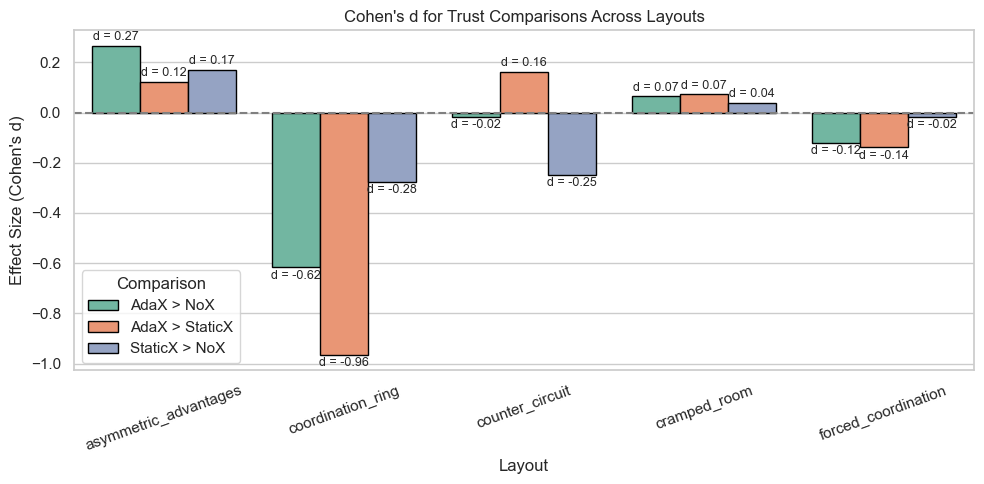

In [5777]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
ax=sns.barplot(
    data=layout_test_all_df,
    x="Layout",
    y="Cohen's d",
    hue="Comparison",
    palette="Set2",
    edgecolor="black"
)
for container in ax.containers:
    for bar in container:
        height = bar.get_height()
        x = bar.get_x() + bar.get_width() / 2
        plt.text(
            x, height + 0.01 if height >= 0 else height - 0.01,
            f"d = {height:.2f}",
            ha='center', va='bottom' if height >= 0 else 'top',
            fontsize=9
        )
plt.axhline(0, color='gray', linestyle='--')
plt.title("Cohen's d for Trust Comparisons Across Layouts")
plt.ylabel("Effect Size (Cohen's d)")
plt.xticks(rotation=20)
plt.tight_layout()
plt.show()


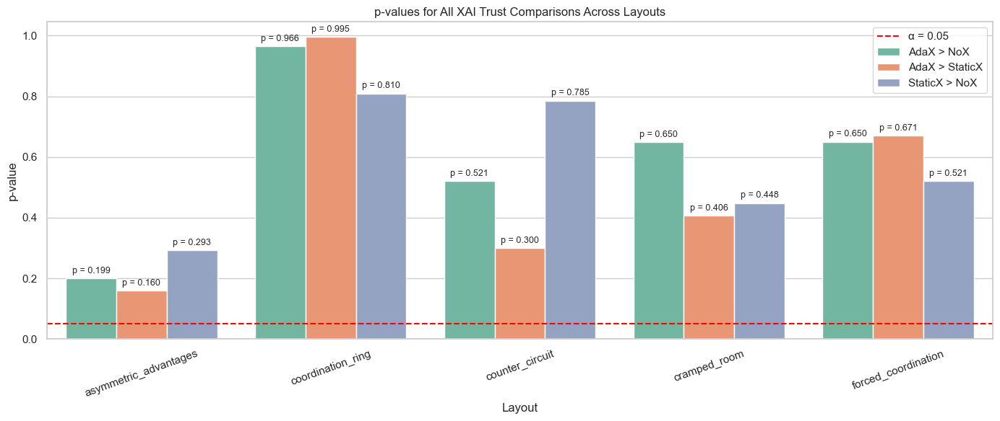

In [5431]:
# # Plotting p-values with annotations
# plt.figure(figsize=(12, 6))
# sns.barplot(
#     data=ada_comparisons,
#     x="Layout",
#     y="p-value",
#     hue="Comparison",
#     palette="Set2"
# )

# # Annotate each bar with p-value
# for i, row in ada_comparisons.iterrows():
#     plt.text(
#         x=i % len(ada_comparisons['Layout'].unique()),
#         y=row['p-value'] + 0.02,
#         s=f"p = {row['p-value']:.3f}",
#         ha='center',
#         va='bottom',
#         fontsize=9
#     )

# plt.axhline(0.05, color='black', linestyle='--', label='α = 0.05')
# plt.title("p-values for AdaX Comparisons Across Layouts")
# plt.ylabel("p-value")
# plt.xticks(rotation=20)
# plt.legend()
# plt.tight_layout()
# plt.show()


# # Fix the p-value plot to ensure annotations match each bar correctly
# plt.figure(figsize=(12, 6))
# ax = sns.barplot(
#     data=ada_comparisons,
#     x="Layout",
#     y="p-value",
#     hue="Comparison",
#     palette="Set2"
# )

# # Add annotations properly positioned on each grouped bar
# for container in ax.containers:
#     for bar in container:
#         height = bar.get_height()
#         x = bar.get_x() + bar.get_width() / 2
#         plt.text(
#             x, height + 0.01,
#             f"p = {height:.3f}",
#             ha='center', va='bottom', fontsize=9
#         )

# plt.axhline(0.05, color='red', linestyle='--', label='α = 0.05')
# plt.title("Corrected p-values for AdaX Comparisons Across Layouts")
# plt.ylabel("p-value")
# plt.xticks(rotation=20)
# plt.legend()
# plt.tight_layout()
# plt.show()


# Add StaticX > NoX comparisons from the full layout results
staticx_nox_comparisons = layout_test_all_df[
    layout_test_all_df['Comparison'] == 'StaticX > NoX'
].copy()

# Concatenate with AdaX comparisons
plot_data = pd.concat([ada_comparisons, staticx_nox_comparisons])

# Replot with all comparisons
plt.figure(figsize=(14, 6))
ax = sns.barplot(
    data=plot_data,
    x="Layout",
    y="p-value",
    hue="Comparison",
    palette="Set2"
)

# Annotate p-values
for container in ax.containers:
    for bar in container:
        height = bar.get_height()
        x = bar.get_x() + bar.get_width() / 2
        plt.text(
            x, height + 0.01,
            f"p = {height:.3f}",
            ha='center', va='bottom', fontsize=9
        )

plt.axhline(0.05, color='red', linestyle='--', label='α = 0.05')
plt.title("p-values for All XAI Trust Comparisons Across Layouts")
plt.ylabel("p-value")
plt.xticks(rotation=20)
plt.legend()
plt.tight_layout()
plt.show()


In [5826]:
pip install python-docx


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 5.3 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [5848]:
# # Generate Word document from latest trust table results
# import pandas as pd
# from scipy.stats import sem
# from docx import Document

# # Reload trust dataset
# df_plot_cleaned_final = pd.read_csv("df_plot_cleaned_final.csv")

# # Compute Mean ± SE per layout-agent
# group_se = (
#     df_plot_cleaned_final
#     .groupby(['layout', 'xai_agent'])['trust_score_post']
#     .agg(['mean', sem])
#     .reset_index()
#     .rename(columns={'mean': 'Mean', 'sem': 'SE'})
# )

# # Recalculate trust comparison stats
# from scipy.stats import ttest_rel, wilcoxon, shapiro

# layout_test_results_all = []
# for layout in sorted(df_plot_cleaned_final['layout'].dropna().unique()):
#     layout_df = df_plot_cleaned_final[df_plot_cleaned_final['layout'] == layout]
#     pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='trust_score_post').dropna()
#     if not {'AdaX', 'StaticX', 'NoX'}.issubset(pivot.columns):
#         continue

#     for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
#         diff = pivot[a] - pivot[b]
#         normal = shapiro(diff).pvalue > 0.05
#         if normal:
#             stat, p_val = ttest_rel(pivot[a], pivot[b], alternative='greater')
#         else:
#             stat, p_val = wilcoxon(pivot[a], pivot[b], alternative='greater')
#         cohen_d = diff.mean() / diff.std(ddof=1)
#         layout_test_results_all.append({
#             "Layout": layout,
#             "Comparison": f"{a} > {b}",
#             "G1": a,
#             "G2": b,
#             "Stat": stat,
#             "p-value": p_val,
#             "Cohen's d": cohen_d,
#             "Wilcoxon p": round(p_val, 4) if not normal else ""
#         })

# # Create rows for the Word table
# rows = []
# for res in layout_test_results_all:
#     layout, a, b = res['Layout'], res['G1'], res['G2']
#     se1 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == a)]
#     se2 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == b)]
#     mean1_se = f"{se1['Mean'].values[0]:.2f} ± {se1['SE'].values[0]:.2f}" if not se1.empty else ""
#     mean2_se = f"{se2['Mean'].values[0]:.2f} ± {se2['SE'].values[0]:.2f}" if not se2.empty else ""
#     cohen_d_val = res["Cohen's d"]
#     rows.append({
#         "Layout": layout.replace("_", " ").title(),
#         "Comparison": res['Comparison'],
#         "Group 1 (M ± SE)": mean1_se,
#         "Group 2 (M ± SE)": mean2_se,
#         "p-value (G1 > G2)": f"{res['p-value']:.4f}",
#         "Cohen's d (G1–G2)": f"{cohen_d_val:.2f}",
#         "Wilcoxon p": res['Wilcoxon p']
#     })

# # Write to Word
# doc = Document()
# doc.add_heading('Directional Comparisons for Trust (AdaX, StaticX, NoX)', level=1)
# table = doc.add_table(rows=1, cols=len(rows[0]))
# table.style = 'Table Grid'
# hdr_cells = table.rows[0].cells
# for j, col in enumerate(rows[0]):
#     hdr_cells[j].text = col
# for row in rows:
#     cells = table.add_row().cells
#     for j, val in enumerate(row.values()):
#         cells[j].text = str(val)

# word_path = "Directional_Trust_Comparisons_Tables_Final.docx"
# doc.save(word_path)
# word_path


# Load the updated trust data with imputation
df_trust_final = pd.read_csv("df_trust_with_uid13_imputed.csv")

# Compute group mean ± SE
from scipy.stats import sem, ttest_rel, wilcoxon, shapiro
group_se = (
    df_trust_final
    .groupby(['layout', 'xai_agent'])['trust_score_post']
    .agg(['mean', sem])
    .reset_index()
    .rename(columns={'mean': 'Mean', 'sem': 'SE'})
)

# Run all pairwise comparisons
trust_results = []
for layout in sorted(df_trust_final['layout'].dropna().unique()):
    layout_df = df_trust_final[df_trust_final['layout'] == layout]
    pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='trust_score_post').dropna()
    if not {'AdaX', 'StaticX', 'NoX'}.issubset(pivot.columns):
        continue

    for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
        diff = pivot[a] - pivot[b]
        normal = shapiro(diff).pvalue > 0.05
        if normal:
            stat, p_val = ttest_rel(pivot[a], pivot[b], alternative='greater')
        else:
            stat, p_val = wilcoxon(pivot[a], pivot[b], alternative='greater')
        cohen_d = diff.mean() / diff.std(ddof=1)

        se1 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == a)]
        se2 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == b)]
        mean1_se = f"{se1['Mean'].values[0]:.2f} ± {se1['SE'].values[0]:.2f}" if not se1.empty else ""
        mean2_se = f"{se2['Mean'].values[0]:.2f} ± {se2['SE'].values[0]:.2f}" if not se2.empty else ""

        trust_results.append({
            "Layout": layout.replace("_", " ").title(),
            "Comparison": f"{a} > {b}",
            "Group 1 (M ± SE)": mean1_se,
            "Group 2 (M ± SE)": mean2_se,
            "p-value (G1 > G2)": f"{p_val:.4f}",
            "Cohen's d (G1–G2)": f"{cohen_d:.2f}",
            "Wilcoxon p": round(p_val, 4) if not normal else ""
        })

# Create Word document
from docx import Document
doc = Document()
doc.add_heading('Directional Comparisons for Trust (AdaX, StaticX, NoX) – UID13 Imputed', level=1)
table = doc.add_table(rows=1, cols=len(trust_results[0]))
table.style = 'Table Grid'
hdr_cells = table.rows[0].cells
for j, col in enumerate(trust_results[0]):
    hdr_cells[j].text = col
for row in trust_results:
    cells = table.add_row().cells
    for j, val in enumerate(row.values()):
        cells[j].text = str(val)

trust_doc_path = "Directional_Trust_Comparisons_UID13_Imputed.docx"
doc.save(trust_doc_path)
trust_doc_path


'Directional_Trust_Comparisons_UID13_Imputed.docx'

In [5834]:
# # Load data and calculate ESS comparison: AdaX vs StaticX
# xls = pd.ExcelFile("sdata_latest.xlsx")
# df_static_adax = xls.parse("Sheet3")[1:]

# # Process ESS columns
# ess_cols = [f"Q99_{i}" for i in range(1, 10)]
# df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
# df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
# df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)

# # Filter AdaX and StaticX only
# df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']
# df_staticx = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]

# # Concatenate for plotting and analysis
# df_ess = pd.concat([df_adax, df_staticx])

# # Group means and SE
# group_se = (
#     df_ess
#     .groupby(['layout', 'xai_agent'])['ess_score']
#     .agg(['mean', sem])
#     .reset_index()
#     .rename(columns={'mean': 'Mean', 'sem': 'SE'})
# )

# # Run pairwise tests
# from scipy.stats import ttest_rel, wilcoxon, shapiro
# ess_results = []

# for layout in sorted(df_ess['layout'].dropna().unique()):
#     layout_df = df_ess[df_ess['layout'] == layout]
#     pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='ess_score').dropna()
#     if not {'AdaX', 'StaticX'}.issubset(pivot.columns):
#         continue

#     diff = pivot['AdaX'] - pivot['StaticX']
#     normal = shapiro(diff).pvalue > 0.05
#     if normal:
#         stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'], alternative='greater')
#     else:
#         stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'], alternative='greater')
#     cohen_d = diff.mean() / diff.std(ddof=1)

#     se1 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == 'AdaX')]
#     se2 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == 'StaticX')]
#     mean1_se = f"{se1['Mean'].values[0]:.2f} ± {se1['SE'].values[0]:.2f}" if not se1.empty else ""
#     mean2_se = f"{se2['Mean'].values[0]:.2f} ± {se2['SE'].values[0]:.2f}" if not se2.empty else ""

#     ess_results.append({
#         "Layout": layout.replace("_", " ").title(),
#         "Comparison": "AdaX > StaticX",
#         "Group 1 (M ± SE)": mean1_se,
#         "Group 2 (M ± SE)": mean2_se,
#         "p-value (G1 > G2)": f"{p_val:.4f}",
#         "Cohen's d (G1–G2)": f"{cohen_d:.2f}",
#         "Wilcoxon p": round(p_val, 4) if not normal else ""
#     })

# # Write Word document
# from docx import Document
# doc = Document()
# doc.add_heading('Directional Comparisons for Explanation Satisfaction Score (AdaX > StaticX)', level=1)
# table = doc.add_table(rows=1, cols=len(ess_results[0]))
# table.style = 'Table Grid'
# hdr_cells = table.rows[0].cells
# for j, col in enumerate(ess_results[0]):
#     hdr_cells[j].text = col
# for row in ess_results:
#     cells = table.add_row().cells
#     for j, val in enumerate(row.values()):
#         cells[j].text = str(val)

# ess_doc_path = "Directional_ESS_Comparisons_Table.docx"
# doc.save(ess_doc_path)
# ess_doc_path


'Directional_ESS_Comparisons_Table.docx'

In [5836]:
# # Load the raw data for cognitive load (NASA TLX)
# xls = pd.ExcelFile("sdata_latest.xlsx")
# df_static_adax = xls.parse("Sheet3")[1:]
# df_nox = xls.parse("Sheet2")[1:]

# # Normalize and process
# load_cols = [f"Q104_{i}" for i in range(1, 7)]
# for df in [df_static_adax, df_nox]:
#     df['player_Id'] = df['player_Id'].astype(str).str.strip()
#     df[load_cols] = df[load_cols].apply(pd.to_numeric, errors='coerce') - 1

# df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1)
# df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')
# df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']
# df_staticx = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]

# df_nox['cog_load'] = df_nox[load_cols].mean(axis=1)
# df_nox['xai_agent'] = 'NoX'

# df_cog = pd.concat([df_adax, df_staticx, df_nox])

# # Compute Mean ± SE
# group_se = (
#     df_cog
#     .groupby(['layout', 'xai_agent'])['cog_load']
#     .agg(['mean', sem])
#     .reset_index()
#     .rename(columns={'mean': 'Mean', 'sem': 'SE'})
# )

# # Run all pairwise comparisons: AdaX > StaticX, AdaX > NoX, StaticX > NoX
# from scipy.stats import ttest_rel, wilcoxon, shapiro
# cog_results = []

# for layout in sorted(df_cog['layout'].dropna().unique()):
#     layout_df = df_cog[df_cog['layout'] == layout]
#     pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='cog_load').dropna()
#     if not {'AdaX', 'StaticX', 'NoX'}.issubset(pivot.columns):
#         continue

#     for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
#         diff = pivot[a] - pivot[b]
#         normal = shapiro(diff).pvalue > 0.05
#         if normal:
#             stat, p_val = ttest_rel(pivot[a], pivot[b], alternative='greater')
#         else:
#             stat, p_val = wilcoxon(pivot[a], pivot[b], alternative='greater')
#         cohen_d = diff.mean() / diff.std(ddof=1)

#         se1 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == a)]
#         se2 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == b)]
#         mean1_se = f"{se1['Mean'].values[0]:.2f} ± {se1['SE'].values[0]:.2f}" if not se1.empty else ""
#         mean2_se = f"{se2['Mean'].values[0]:.2f} ± {se2['SE'].values[0]:.2f}" if not se2.empty else ""

#         cog_results.append({
#             "Layout": layout.replace("_", " ").title(),
#             "Comparison": f"{a} > {b}",
#             "Group 1 (M ± SE)": mean1_se,
#             "Group 2 (M ± SE)": mean2_se,
#             "p-value (G1 > G2)": f"{p_val:.4f}",
#             "Cohen's d (G1–G2)": f"{cohen_d:.2f}",
#             "Wilcoxon p": round(p_val, 4) if not normal else ""
#         })

# # Write Word document
# from docx import Document
# doc = Document()
# doc.add_heading('Directional Comparisons for Cognitive Load (NASA TLX)', level=1)
# table = doc.add_table(rows=1, cols=len(cog_results[0]))
# table.style = 'Table Grid'
# hdr_cells = table.rows[0].cells
# for j, col in enumerate(cog_results[0]):
#     hdr_cells[j].text = col
# for row in cog_results:
#     cells = table.add_row().cells
#     for j, val in enumerate(row.values()):
#         cells[j].text = str(val)

# cog_doc_path = "Directional_CogLoad_Comparisons_Table.docx"
# doc.save(cog_doc_path)
# cog_doc_path


'Directional_CogLoad_Comparisons_Table.docx'

In [5868]:
# Retry with newly uploaded correct Sheet3 for ESS analysis
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sheet3 = xls.parse("Sheet3")[1:]
df_sheet2 = xls.parse("Sheet2")[1:]

# Columns
trust_cols = [f"Q107_{i}" for i in range(1, 10)]
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
load_cols = [f"Q104_{i}" for i in range(1, 7)]

# Normalize and process scores
for df in [df_sheet3, df_sheet2]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols + load_cols] = df[trust_cols + load_cols].apply(pd.to_numeric, errors='coerce') - 1
df_sheet3[ess_cols] = df_sheet3[ess_cols].apply(pd.to_numeric, errors='coerce') - 1

df_sheet3['xai_agent'] = df_sheet3['xai_agent'].fillna('Unknown')
df_sheet2['xai_agent'] = 'NoX'

# Scores
df_sheet3['trust_score_post'] = df_sheet3[trust_cols].mean(axis=1)
df_sheet2['trust_score_post'] = df_sheet2[trust_cols].mean(axis=1)

df_sheet3['ess_score'] = df_sheet3[ess_cols].mean(axis=1)
df_sheet3['cog_load'] = df_sheet3[load_cols].mean(axis=1)
df_sheet2['cog_load'] = df_sheet2[load_cols].mean(axis=1)

# Combine data
df_trust = pd.concat([
    df_sheet3[df_sheet3['xai_agent'] == 'AdaX'],
    df_sheet3[(df_sheet3['xai_agent'] == 'StaticX') & (df_sheet3['session_Id'] != 1)],
    df_sheet2
])
df_ess = pd.concat([
    df_sheet3[df_sheet3['xai_agent'] == 'AdaX'],
    df_sheet3[(df_sheet3['xai_agent'] == 'StaticX') & (df_sheet3['session_Id'] != 1)]
])
df_cog = pd.concat([
    df_sheet3[df_sheet3['xai_agent'] == 'AdaX'],
    df_sheet3[(df_sheet3['xai_agent'] == 'StaticX') & (df_sheet3['session_Id'] != 1)],
    df_sheet2
])

# Redefine directional_table with explicit comparisons
from scipy.stats import sem, ttest_rel, wilcoxon, shapiro
from docx import Document
from itertools import product

def directional_table(df, value_col, title, comparisons):
    group_se = (
        df.groupby(['layout', 'xai_agent'])[value_col]
        .agg(['mean', sem])
        .reset_index()
        .rename(columns={'mean': 'Mean', 'sem': 'SE'})
    )
    results = []
    for layout in sorted(df['layout'].dropna().unique()):
        layout_df = df[df['layout'] == layout]
        pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values=value_col).dropna()
        for a, b in comparisons:
            if a in pivot.columns and b in pivot.columns:
                diff = pivot[a] - pivot[b]
                normal = shapiro(diff).pvalue > 0.05
                if normal:
                    stat, p_val = ttest_rel(pivot[a], pivot[b], alternative='greater')
                else:
                    stat, p_val = wilcoxon(pivot[a], pivot[b], alternative='greater')
                cohen_d = diff.mean() / diff.std(ddof=1)
                se1 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == a)]
                se2 = group_se[(group_se['layout'] == layout) & (group_se['xai_agent'] == b)]
                mean1_se = f"{se1['Mean'].values[0]:.2f} ± {se1['SE'].values[0]:.2f}" if not se1.empty else ""
                mean2_se = f"{se2['Mean'].values[0]:.2f} ± {se2['SE'].values[0]:.2f}" if not se2.empty else ""
                results.append({
                    "Layout": layout.replace("_", " ").title(),
                    "Comparison": f"{a} > {b}",
                    "Group 1 (M ± SE)": mean1_se,
                    "Group 2 (M ± SE)": mean2_se,
                    "p-value (G1 > G2)": f"{p_val:.4f}",
                    "Cohen's d (G1–G2)": f"{cohen_d:.2f}",
                    "Wilcoxon p": round(p_val, 4) if not normal else ""
                })
    return title, results

# Explicit comparisons
trust_comparisons = [('AdaX', 'StaticX'), ('AdaX', 'NoX'), ('StaticX', 'NoX')]
ess_comparisons = [('AdaX', 'StaticX')]
cog_comparisons = [('AdaX', 'StaticX'), ('AdaX', 'NoX'), ('StaticX', 'NoX')]

# Generate tables
trust_title, trust_results = directional_table(df_trust, 'trust_score_post', 'Trust (AdaX, StaticX, NoX)', trust_comparisons)
ess_title, ess_results = directional_table(df_ess, 'ess_score', 'Explanation Satisfaction Score (AdaX vs StaticX)', ess_comparisons)
cog_title, cog_results = directional_table(df_cog, 'cog_load', 'Cognitive Load (AdaX, StaticX, NoX)', cog_comparisons)

# Create Word document
doc = Document()
for title, results in [(trust_title, trust_results), (ess_title, ess_results), (cog_title, cog_results)]:
    doc.add_heading(f'Directional Comparisons for {title} – UID13 Imputed', level=1)
    table = doc.add_table(rows=1, cols=len(results[0]))
    table.style = 'Table Grid'
    hdr_cells = table.rows[0].cells
    for j, col in enumerate(results[0]):
        hdr_cells[j].text = col
    for row in results:
        cells = table.add_row().cells
        for j, val in enumerate(row.values()):
            cells[j].text = str(val)

doc_path = "Directional_Trust_ESS_CogLoad_UID13_Imputed_Final.docx"
doc.save(doc_path)
doc_path


'Directional_Trust_ESS_CogLoad_UID13_Imputed_Final.docx'

'Directional_Trust_CohensD_Heatmap_FromData.png'

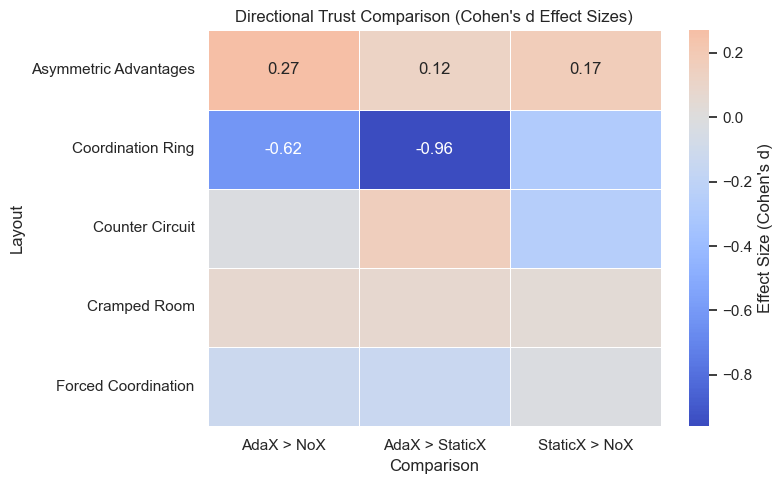

In [5872]:
# Rebuild Cohen's d heatmap directly from the computed trust_results
# Extract from the latest programmatically generated trust_results list

# Filter trust_results for Cohen's d
heatmap_data = []
for row in trust_results:
    heatmap_data.append({
        "Layout": row["Layout"],
        "Comparison": row["Comparison"],
        "Cohen's d": float(row["Cohen's d (G1–G2)"])
    })

df_heatmap = pd.DataFrame(heatmap_data)

# Pivot for plotting
pivot_df = df_heatmap.pivot(index='Layout', columns='Comparison', values="Cohen's d")

# Plot the heatmap
plt.figure(figsize=(8, 5))
ax = sns.heatmap(pivot_df, annot=True, cmap="coolwarm", center=0, fmt=".2f", linewidths=0.5, cbar_kws={'label': "Effect Size (Cohen's d)"})
plt.title("Directional Trust Comparison (Cohen's d Effect Sizes)")
plt.ylabel("Layout")
plt.xlabel("Comparison")
plt.tight_layout()

plot_path = "Directional_Trust_CohensD_Heatmap_FromData.png"
plt.savefig(plot_path)
plot_path


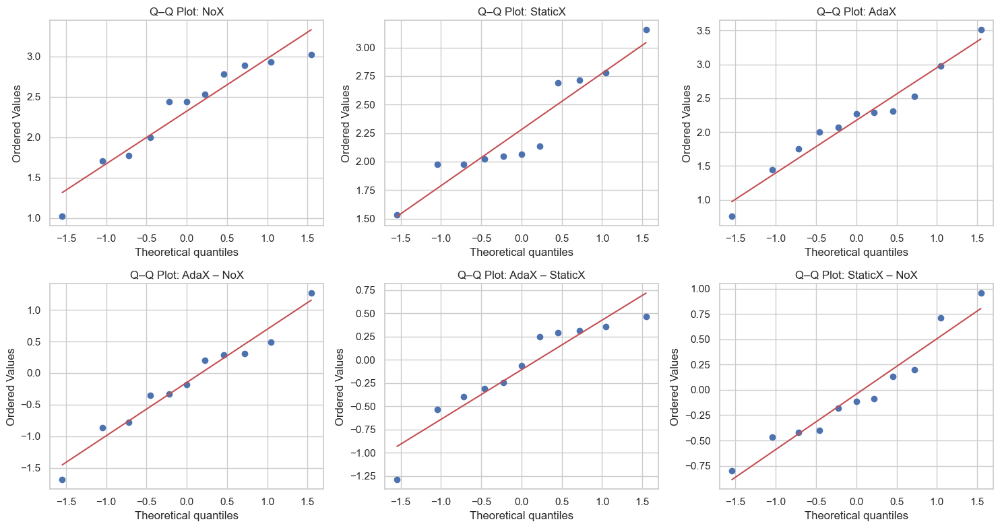

In [4977]:
import matplotlib.pyplot as plt
import scipy.stats as stats

# Step 1: Pivot participant trust scores by condition
trust_pivot = df_plot_cleaned_final.pivot_table(
    index='player_Id',
    columns='xai_agent',
    values='trust_score_post',
    aggfunc='mean'
).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# Step 2: Create Q–Q plots for each condition and difference
fig, axes = plt.subplots(2, 3, figsize=(15, 8))

# Plot Q–Q for trust scores per condition
for i, condition in enumerate(['NoX', 'StaticX', 'AdaX']):
    stats.probplot(trust_pivot[condition], dist="norm", plot=axes[0, i])
    axes[0, i].set_title(f"Q–Q Plot: {condition}")

# Plot Q–Q for difference scores
diff_pairs = [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]
for i, (cond1, cond2) in enumerate(diff_pairs):
    diff = trust_pivot[cond1] - trust_pivot[cond2]
    stats.probplot(diff, dist="norm", plot=axes[1, i])
    axes[1, i].set_title(f"Q–Q Plot: {cond1} – {cond2}")

plt.tight_layout()
plt.show()


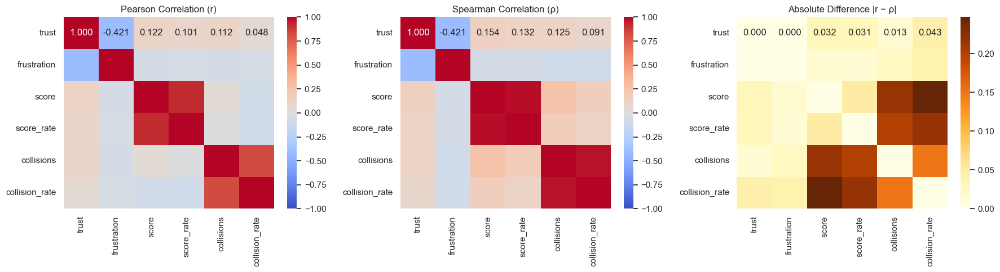

In [6305]:
# Re-import required libraries after kernel reset
import json
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load JSON data
file_path = "processed_with_uid_filtered.json"
with open(file_path, "r") as f:
    data = json.load(f)

# Extract and rename stress to frustration
records = []
for record in data:
    meta = record.get("metadata", {})
    uid = record.get("uid")
    if uid:
        trust = {"low": 0, "medium": 0, "high": 1}.get(meta.get("trust", "").lower())
        frustration = {"low": 0, "high": 1}.get(meta.get("stress", "").lower())
        try:
            records.append({
                "trust": trust,
                "frustration": frustration,
                "score": float(meta.get("score", 0)),
                "score_rate": float(meta.get("score_rate", 0)),
                "collisions": float(meta.get("num_collisions", 0)),
                "collision_rate": float(meta.get("collision_rate", 0))
            })
        except:
            continue

# Create DataFrame and compute correlation matrices
df = pd.DataFrame(records)
df = df.loc[:, df.nunique() > 1]
pearson_corr = df.corr(method='pearson').round(3)
spearman_corr = df.corr(method='spearman').round(3)
difference_matrix = (pearson_corr - spearman_corr).abs().round(3)

# Plot heatmaps with updated titles
plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)
sns.heatmap(pearson_corr, annot=True, fmt=".3f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Pearson Correlation (r)")

plt.subplot(1, 3, 2)
sns.heatmap(spearman_corr, annot=True, fmt=".3f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Spearman Correlation (ρ)")

plt.subplot(1, 3, 3)
sns.heatmap(difference_matrix, annot=True, fmt=".3f", cmap="YlOrBr")
plt.title("Absolute Difference |r − ρ|")

plt.tight_layout()
plt.show()


In [6307]:
pearson_corr 


,trust,frustration,score,score_rate,collisions,collision_rate
trust,1.000,-0.421,0.122,0.101,0.112,0.048
frustration,-0.421,1.000,-0.058,-0.049,-0.066,-0.047
score,0.122,-0.058,1.000,0.929,0.041,-0.081
score_rate,0.101,-0.049,0.929,1.000,-0.010,-0.099
collisions,0.112,-0.066,0.041,-0.010,1.000,0.822
collision_rate,0.048,-0.047,-0.081,-0.099,0.822,1.000


In [6309]:
spearman_corr 

,trust,frustration,score,score_rate,collisions,collision_rate
trust,1.000,-0.421,0.154,0.132,0.125,0.091
frustration,-0.421,1.000,-0.074,-0.064,-0.094,-0.088
score,0.154,-0.074,1.000,0.977,0.258,0.166
score_rate,0.132,-0.064,0.977,1.000,0.190,0.119
collisions,0.125,-0.094,0.258,0.190,1.000,0.972
collision_rate,0.091,-0.088,0.166,0.119,0.972,1.000


In [6311]:
difference_matrix

,trust,frustration,score,score_rate,collisions,collision_rate
trust,0.000,0.000,0.032,0.031,0.013,0.043
frustration,0.000,0.000,0.016,0.015,0.028,0.041
score,0.032,0.016,0.000,0.048,0.217,0.247
score_rate,0.031,0.015,0.048,0.000,0.200,0.218
collisions,0.013,0.028,0.217,0.200,0.000,0.150
collision_rate,0.043,0.041,0.247,0.218,0.150,0.000



Pearson Correlation Matrix (r):
         Variable  trust  stress  score  score_rate  collisions  \
0           trust  1.000  -0.421  0.122       0.101       0.112   
1          stress -0.421   1.000 -0.058      -0.049      -0.066   
2           score  0.122  -0.058  1.000       0.929       0.041   
3      score_rate  0.101  -0.049  0.929       1.000      -0.010   
4      collisions  0.112  -0.066  0.041      -0.010       1.000   
5  collision_rate  0.048  -0.047 -0.081      -0.099       0.822   

   collision_rate  
0           0.048  
1          -0.047  
2          -0.081  
3          -0.099  
4           0.822  
5           1.000  

Spearman Correlation Matrix (ρ):
         Variable  trust  stress  score  score_rate  collisions  \
0           trust  1.000  -0.421  0.154       0.132       0.125   
1          stress -0.421   1.000 -0.074      -0.064      -0.094   
2           score  0.154  -0.074  1.000       0.977       0.258   
3      score_rate  0.132  -0.064  0.977       1.000    

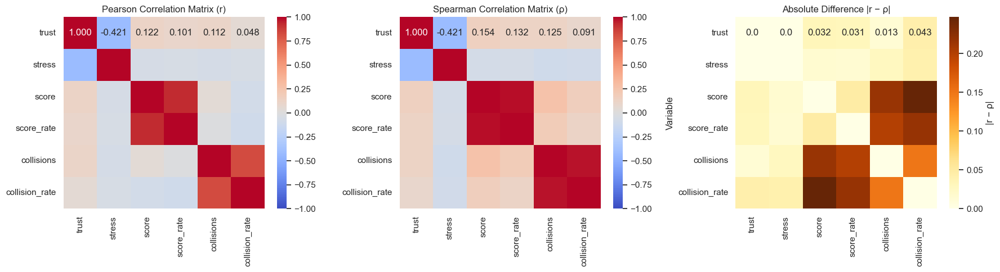

In [4982]:
import json
import pandas as pd

# Step 1: Load your JSON data
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Step 2: Extract relevant fields
records = []
for record in data:
    meta = record.get("metadata", {})
    uid = record.get("uid")
    if not uid:
        continue

    trust = {"low": 0, "medium": 0, "high": 1}.get(meta.get("trust", "").lower())
    stress = {"low": 0, "high": 1}.get(meta.get("stress", "").lower())
    try:
        score = float(meta.get("score", 0))
        score_rate = float(meta.get("score_rate", 0))
        collisions = float(meta.get("num_collisions", 0))
        collision_rate = float(meta.get("collision_rate", 0))
    except:
        continue

    if trust is not None and stress is not None:
        records.append({
            "trust": trust,
            "stress": stress,
            "score": score,
            "score_rate": score_rate,
            "collisions": collisions,
            "collision_rate": collision_rate
        })

# Step 3: Create DataFrame and clean
df = pd.DataFrame(records)
df = df.loc[:, df.nunique() > 1]  # remove any constant columns

# Step 4: Compute correlation matrices
pearson_corr = df.corr(method='pearson').round(3)
spearman_corr = df.corr(method='spearman').round(3)
diff_matrix = (pearson_corr - spearman_corr).abs().round(3)

# Step 5: Convert to tables
pearson_table = pearson_corr.reset_index().rename(columns={"index": "Variable"})
spearman_table = spearman_corr.reset_index().rename(columns={"index": "Variable"})
diff_table = diff_matrix.reset_index().rename(columns={"index": "Variable"})

# Step 6: Display tables (optional for console)
print("\nPearson Correlation Matrix (r):")
print(pearson_table)

print("\nSpearman Correlation Matrix (ρ):")
print(spearman_table)

print("\nAbsolute Difference |r - ρ|:")
print(diff_table)

# Optional: export to CSV
# pearson_table.to_csv("pearson_matrix.csv", index=False)
# spearman_table.to_csv("spearman_matrix.csv", index=False)
# diff_table.to_csv("difference_matrix.csv", index=False)


import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Convert table format back to matrix
# Assuming 'Variable' is the row index and other columns are correlation variables
pearson_matrix = pearson_table.set_index("Variable")
spearman_matrix = spearman_table.set_index("Variable")
diff_matrix = diff_table.set_index("Variable")



# Step 3: Create annotated matrix for all differences
annot_vals = diff_matrix.round(3).astype(str)

# Plot all heatmaps with full annotations
plt.figure(figsize=(18, 5))

# Pearson
plt.subplot(1, 3, 1)
sns.heatmap(pearson_corr.round(3), annot=True, fmt=".3f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Pearson Correlation Matrix (r)")

# Spearman
plt.subplot(1, 3, 2)
sns.heatmap(spearman_corr.round(3), annot=True, fmt=".3f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Spearman Correlation Matrix (ρ)")

# Difference |r − ρ| with all values shown
plt.subplot(1, 3, 3)
sns.heatmap(diff_matrix, annot=annot_vals, fmt="", cmap="YlOrBr", cbar_kws={"label": "|r − ρ|"})
plt.title("Absolute Difference |r − ρ|")

plt.tight_layout()
plt.show()


# regression

In [4984]:
# pip install statsmodels

In [6313]:
#### NOT IDEAL ###
### treats trust as continuous variable here ##

import json
import pandas as pd
import statsmodels.api as sm

# Step 1: Load JSON data
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Step 2: Extract necessary fields
records = []
for record in data:
    meta = record.get("metadata", {})
    uid = record.get("uid")
    if not uid:
        continue

    trust = {"low": 0, "medium": 0, "high": 1}.get(meta.get("trust", "").lower())
    stress = {"low": 0, "high": 1}.get(meta.get("stress", "").lower())

    try:
        score = float(meta.get("score", 0))
        collisions = float(meta.get("num_collisions", 0))
    except:
        continue

    if trust is not None and stress is not None:
        records.append({
            "uid": uid,
            "trust": trust,
            "stress": stress,
            "score": score,
            "collisions": collisions
        })

# Step 3: Create DataFrame
df = pd.DataFrame(records)

# Step 4: Define independent (X) and dependent (y) variables
X = df[["stress", "score", "collisions"]]
y = df["trust"]

# Step 5: Add intercept
X = sm.add_constant(X)

# Step 6: Fit linear regression model
model = sm.OLS(y, X).fit()

# Step 7: Print results
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:                  trust   R-squared:                       0.193
Model:                            OLS   Adj. R-squared:                  0.192
Method:                 Least Squares   F-statistic:                     132.4
Date:                Fri, 23 May 2025   Prob (F-statistic):           6.94e-77
Time:                        14:21:11   Log-Likelihood:                 23.956
No. Observations:                1664   AIC:                            -39.91
Df Residuals:                    1660   BIC:                            -18.24
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.9059      0.008    112.660      0.0

In [6315]:
import json
import pandas as pd
import statsmodels.api as sm

# Load data
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Extract binary trust data: 1 = high, 0 = low
records = []
for record in data:
    meta = record.get("metadata", {})
    uid = record.get("uid")
    if not uid:
        continue

    trust_str = meta.get("trust", "").lower()
    stress = {"low": 0, "high": 1}.get(meta.get("stress", "").lower())

    try:
        score = float(meta.get("score", 0))
        collisions = float(meta.get("num_collisions", 0))
    except:
        continue

    
    if trust_str in ["low", "high"] and stress is not None:
        trust_binary = 1 if trust_str == "high" else 0
        records.append({
            "trust": trust_binary,
            "stress": stress,
            "score": score,
            "collisions": collisions
        })

# Build DataFrame
df_bin = pd.DataFrame(records)

# Define predictor variables and binary outcome
X = df_bin[["stress", "score", "collisions"]]
y = df_bin["trust"]

# Add intercept
X = sm.add_constant(X)

# Fit binary logistic regression model
logit_model = sm.Logit(y, X).fit()

# Display summary
logit_model.summary()

         Current function value: 0.218909
         Iterations: 35


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                  trust   No. Observations:                 1664
Model:                          Logit   Df Residuals:                     1660
Method:                           MLE   Df Model:                            3
Date:                Fri, 23 May 2025   Pseudo R-squ.:                  0.1883
Time:                        14:21:13   Log-Likelihood:                -364.27
converged:                      False   LL-Null:                       -448.77
Covariance Type:            nonrobust   LLR p-value:                 2.082e-36
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.1516      0.122     17.573      0.000       1.912       2.392
stress       -26.7820   3.97e+04     -0.001      0.999   -7.79e+04    7.78e+04
score          0.0155      0.004      3.656      0.000       0.007       0.024
collisions     0.0968      0.030      3.175      0.001       0.037       0.156
==============================================================================
"""

## Group comparison

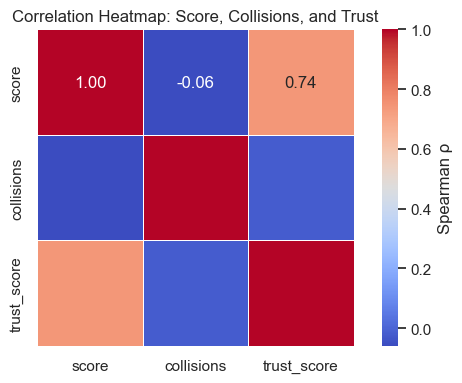

,score,collisions,trust_score
score,1.000000,-0.059028,0.741219
collisions,-0.059028,1.000000,-0.020487
trust_score,0.741219,-0.020487,1.000000


In [6415]:
import json
import pandas as pd
from scipy.stats import spearmanr

# Load processed JSON file with actual scores and collisions
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_type": xai_label,
        "score": meta.get("score"),
        "collisions": meta.get("num_collisions"),
    })

df = pd.DataFrame(records)
df["score"] = pd.to_numeric(df["score"], errors='coerce')
df["collisions"] = pd.to_numeric(df["collisions"], errors='coerce')

# Load subjective trust scores
xls = pd.ExcelFile("sdata_latest.xlsx")
sheet2 = xls.parse("Sheet2")
sheet3 = xls.parse("Sheet3")

# Clean and combine trust scores
sheet2['uid'] = sheet2['uid'].astype(str).str.strip()
sheet3['uid'] = sheet3['uid'].astype(str).str.strip()
trust_cols = [f"Q107_{i}" for i in range(1, 10)]

sheet2[trust_cols] = sheet2[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
sheet3[trust_cols] = sheet3[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

sheet2['trust_score'] = sheet2[trust_cols].mean(axis=1)
sheet3['trust_score'] = sheet3[trust_cols].mean(axis=1)

sheet2['xai_type'] = 'NoX'
sheet3 = sheet3.rename(columns={'xai_agent': 'xai_type'})

subjective_trust_df = pd.concat([
    sheet2[['uid', 'layout', 'xai_type', 'trust_score']],
    sheet3[['uid', 'layout', 'xai_type', 'trust_score']]
])

# Aggregate actual score and collisions
df_grouped = df.groupby(['uid', 'layout', 'xai_type'])[['score', 'collisions']].mean().reset_index()

# Merge with trust scores
merged_df = pd.merge(subjective_trust_df, df_grouped, on=['uid', 'layout', 'xai_type'])

# Compute Spearman correlations
r_score, p_score = spearmanr(merged_df['score'], merged_df['trust_score'])
r_coll, p_coll = spearmanr(merged_df['collisions'], merged_df['trust_score'])

# Format results
correlation_results = pd.DataFrame({
    'Metric': ['Score', 'Collisions'],
    'Spearman ρ': [round(r_score, 3), round(r_coll, 3)],
    'p-value': [round(p_score, 4), round(p_coll, 4)],
    'Significant': ['✅' if p < 0.05 else '❌' for p in [p_score, p_coll]]
})

correlation_results


# Compute correlation matrix (Spearman)
corr_matrix = merged_df[['score', 'collisions', 'trust_score']].corr(method='spearman')

# Plot the heatmap
plt.figure(figsize=(6, 4))
sns.heatmap(
    corr_matrix,
    annot=True,
    fmt='.2f',
    cmap='coolwarm',  # Use Coolwarm palette
    square=True,
    linewidths=0.5,
    cbar_kws={'label': 'Spearman ρ'}
)
plt.title("Correlation Heatmap: Score, Collisions, and Trust")
plt.tight_layout()
plt.show()


corr_matrix

In [4988]:
# Load and parse JSON data again, including additional fields
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Extract data for only adaX and staticX (noX excluded)
records = []
for record in data:
    meta = record.get("metadata", {})
    uid = record.get("uid")
    if not uid:
        continue

    trust = meta.get("trust", "").lower()
    stress = meta.get("stress", "").lower()
    score = meta.get("score", None)
    collisions = meta.get("num_collisions", None)
    score_rate = meta.get("score_rate", None)
    collision_rate = meta.get("collision_rate", None)
    layout_name = meta.get("layout_name", None)
    valid_explanation = meta.get("valid_explanation_actions", None)

    # Determine XAI type (exclude noX)
    timing = meta.get("explanation_features", {}).get("explanation_timing", "").lower()
    if timing == "unknown":
        xai_type = "StaticX"
    elif timing in ["proactive", "reactive"]:
        xai_type = "AdaX"
    else:
        continue  # skip noX

    if trust in ["low", "medium", "high"] and score is not None and collisions is not None:
        records.append({
            "uid": uid,
            "xai_type": xai_type,
            "layout": layout_name,
            "trust": {"low": 0, "medium": 0, "high": 1}[trust],
            "score": float(score),
            "collisions": int(collisions),
            "score_rate": float(score_rate) if score_rate is not None else None,
            "collision_rate": float(collision_rate) if collision_rate is not None else None,
            "valid_explanation_actions": valid_explanation
        })

# Create cleaned DataFrame
df_ax_only = pd.DataFrame(records)
df_ax_only

,uid,xai_type,layout,trust,score,collisions,score_rate,collision_rate,valid_explanation_actions
0,10,AdaX,counter_circuit,1,0.0,0,0.00,0.00,False
1,10,AdaX,forced_coordination,1,0.0,0,0.00,0.00,False
2,10,AdaX,coordination_ring,1,0.0,0,0.00,0.00,False
3,10,AdaX,cramped_room,1,0.0,0,0.00,0.00,False
4,10,AdaX,asymmetric_advantages,1,0.0,0,0.00,0.00,False
...,...,...,...,...,...,...,...,...,...
1659,21,StaticX,asymmetric_advantages,1,100.0,0,1.28,0.00,True
1660,21,StaticX,coordination_ring,1,20.0,15,0.26,0.19,True
1661,21,StaticX,forced_coordination,1,0.0,0,0.00,0.00,True
1662,21,StaticX,counter_circuit,1,20.0,8,0.26,0.10,True


## Shapiro-Wilk Normality Test (AdaX Vs StaticX)

In [4990]:
from scipy.stats import shapiro

# Group by xai_type to compare distributions
shapiro_results = {}
for var in ['trust', 'score', 'collisions', 'score_rate', 'collision_rate']:
    results = {}
    for group in df_ax_only['xai_type'].unique():
        data = df_ax_only[df_ax_only['xai_type'] == group][var].dropna()
        if len(data) >= 3:  # minimum required for Shapiro–Wilk
            stat, p = shapiro(data)
            results[group] = {"W": round(stat, 3), "p-value": round(p, 4)}
        else:
            results[group] = {"W": None, "p-value": None}
    shapiro_results[var] = results

# Convert to DataFrame for display
shapiro_df = pd.DataFrame(shapiro_results).T
shapiro_df

,AdaX,StaticX
trust,"{'W': 0.361, 'p-value': 0.0}","{'W': 0.236, 'p-value': 0.0}"
score,"{'W': 0.734, 'p-value': 0.0}","{'W': 0.756, 'p-value': 0.0}"
collisions,"{'W': 0.639, 'p-value': 0.0}","{'W': 0.657, 'p-value': 0.0}"
score_rate,"{'W': 0.783, 'p-value': 0.0}","{'W': 0.799, 'p-value': 0.0}"
collision_rate,"{'W': 0.622, 'p-value': 0.0}","{'W': 0.725, 'p-value': 0.0}"


/var/folders/d7/x2slvs7j1sbfbq8sjy_6vf6m0000gn/T/ipykernel_44001/4108421992.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  fig.legend(


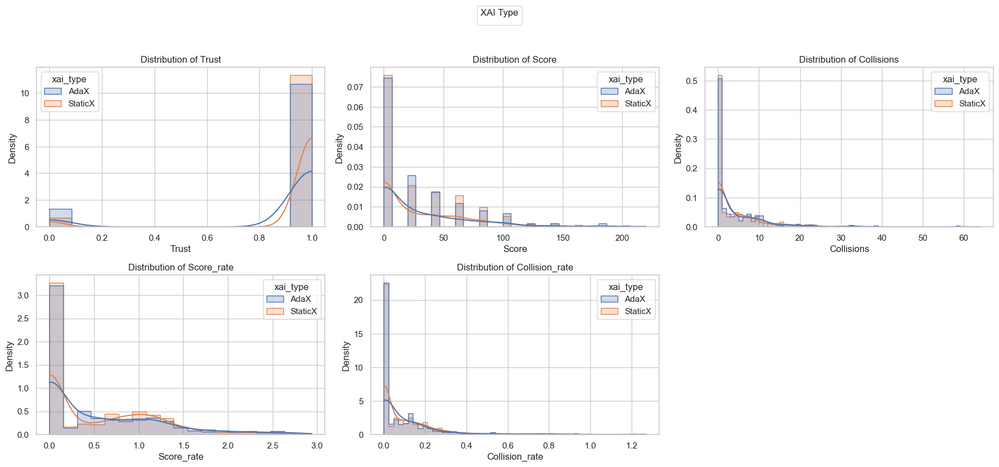

In [5795]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Define the variables to plot
variables = ['trust', 'score', 'collisions', 'score_rate', 'collision_rate']

# # Plot histograms for each variable by xai_type
# for var in variables:
#     plt.figure(figsize=(8, 4))
#     sns.histplot(data=df_ax_only, x=var, hue='xai_type', kde=True, element='step', stat='density', common_norm=False)
#     plt.title(f"Distribution of {var.capitalize()} by XAI Type")
#     plt.xlabel(var.capitalize())
#     plt.ylabel("Density")
#     plt.tight_layout()
#     plt.show()


# Draw all variable distribution plots in a single image with subplots and a shared legend
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 8))
axes = axes.flatten()
legend_labels = []

for i, var in enumerate(variables):
    ax = axes[i]
    sns.histplot(
        data=df_ax_only,
        x=var,
        hue='xai_type',
        kde=True,
        element='step',
        stat='density',
        common_norm=False,
        ax=ax
    )
    ax.set_title(f"Distribution of {var.capitalize()}")
    ax.set_xlabel(var.capitalize())
    ax.set_ylabel("Density")
    handles, labels = ax.get_legend_handles_labels()
    if not legend_labels:
        legend_labels = (handles, labels)

# Remove the empty subplot if there are only 5 plots
if len(variables) < len(axes):
    fig.delaxes(axes[-1])

# Shared legend at top center
fig.legend(
    handles=legend_labels[0],
    labels=legend_labels[1],
    title="XAI Type",
    loc='upper center',
    bbox_to_anchor=(0.5, 1.05),
    ncol=2
)

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.savefig("non-normality of PB data.png")
plt.show()


#### Why Kruskal–Wallis Was Not Used:
Kruskal–Wallis is for between-subject designs

It compares independent groups — i.e., different participants in each condition.

Your study uses a within-subject (repeated measures) design, where the same participants experience both AdaX and StaticX.

Only two conditions were analyzed

Kruskal–Wallis is a generalization of the Mann–Whitney U test for 3+ independent groups.

For two dependent groups (e.g., AdaX vs. StaticX per participant), the correct non-parametric test is the Wilcoxon Signed-Rank test — which we used.

✅ When Kruskal–Wallis would be appropriate:
Scenario	Use Kruskal–Wallis?
Comparing 3+ groups, each with different participants (between-subjects)	✅ Yes
Comparing 3+ groups with repeated measures (same participants)	❌ No — use Friedman test
Comparing 2 groups, repeated measures	❌ No — use Wilcoxon test

🧠 Summary for Reporting:
The Kruskal–Wallis test is appropriate for comparing medians across three or more independent groups. However, in this study, the conditions (AdaX and StaticX) were experienced by the same participants, forming a within-subjects design. Therefore, the more appropriate non-parametric test for comparing two related groups was the Wilcoxon Signed-Rank test, which we applied.


#### Why Repeated Measures ANOVA Was Not Used
While the experimental design involved the same participants experiencing multiple explanation conditions (i.e., within-subjects design), the use of Repeated Measures ANOVA was not appropriate in this context due to violations of its underlying statistical assumptions.

❌ Violated Assumptions of Repeated Measures ANOVA:
Normality:

Repeated Measures ANOVA assumes that the dependent variable is normally distributed within each condition.

Based on both the Shapiro–Wilk normality tests and distribution visualizations, all outcome variables (including trust, score, and rate-based metrics) were non-normally distributed across StaticX and AdaX.

For example, trust was binary (0 or 1), violating the assumption of continuous, symmetric residuals.

Sphericity (not tested but assumed for ANOVA with 3+ levels):

This assumption pertains to equal variances of differences between conditions.

Although we only compared two conditions (AdaX and StaticX), which simplifies the sphericity requirement, the lack of normality still invalidates parametric test validity.

✅ Justification for Alternative Approach
To preserve the integrity of the statistical inference under violated assumptions, we used the Wilcoxon Signed-Rank test, a non-parametric alternative specifically designed for:

Within-subject comparisons

Ordinal or non-normal data

Small sample sizes

This test does not rely on the normality of the data and is robust against the types of skew and discrete outcomes seen in the dataset.

🧠 Summary for Reporting
Although Repeated Measures ANOVA is traditionally used for comparing multiple conditions in a within-subject design, it requires that the data in each condition be normally distributed and continuous. Due to the non-normality of trust and performance metrics, and the binary nature of trust, the use of parametric ANOVA was statistically invalid. Therefore, we employed the Wilcoxon Signed-Rank test, a more appropriate non-parametric alternative, to compare StaticX and AdaX conditions.

### Wilcoxon Signed-Rank test

In [4994]:
from scipy.stats import shapiro, wilcoxon

# Filter for users who experienced both conditions
pivot_trust = df_ax_only.pivot_table(index="uid", columns="xai_type", values="trust")
pivot_score = df_ax_only.pivot_table(index="uid", columns="xai_type", values="score")
pivot_collisions = df_ax_only.pivot_table(index="uid", columns="xai_type", values="collisions")
pivot_score_rate = df_ax_only.pivot_table(index="uid", columns="xai_type", values="score_rate")
pivot_collision_rate = df_ax_only.pivot_table(index="uid", columns="xai_type", values="collision_rate")

# Drop UIDs missing either condition
pivot_trust = pivot_trust.dropna()
pivot_score = pivot_score.dropna()
pivot_collisions = pivot_collisions.dropna()
pivot_score_rate = pivot_score_rate.dropna()
pivot_collision_rate = pivot_collision_rate.dropna()

# Run Wilcoxon tests for AdaX vs StaticX
results = {}
for var_name, data in zip(
    ["trust", "score", "collisions", "score_rate", "collision_rate"],
    [pivot_trust, pivot_score, pivot_collisions, pivot_score_rate, pivot_collision_rate]
):
    try:
        stat, p = wilcoxon(data["AdaX"], data["StaticX"])
        results[var_name] = {"Wilcoxon W": round(stat, 3), "p-value": round(p, 4)}
    except:
        results[var_name] = {"Wilcoxon W": None, "p-value": None}

results_df = pd.DataFrame(results).T
results_df

,Wilcoxon W,p-value
trust,10.0,0.0210
score,34.0,0.7334
collisions,26.0,0.3394
score_rate,37.0,0.9097
collision_rate,22.0,0.2036


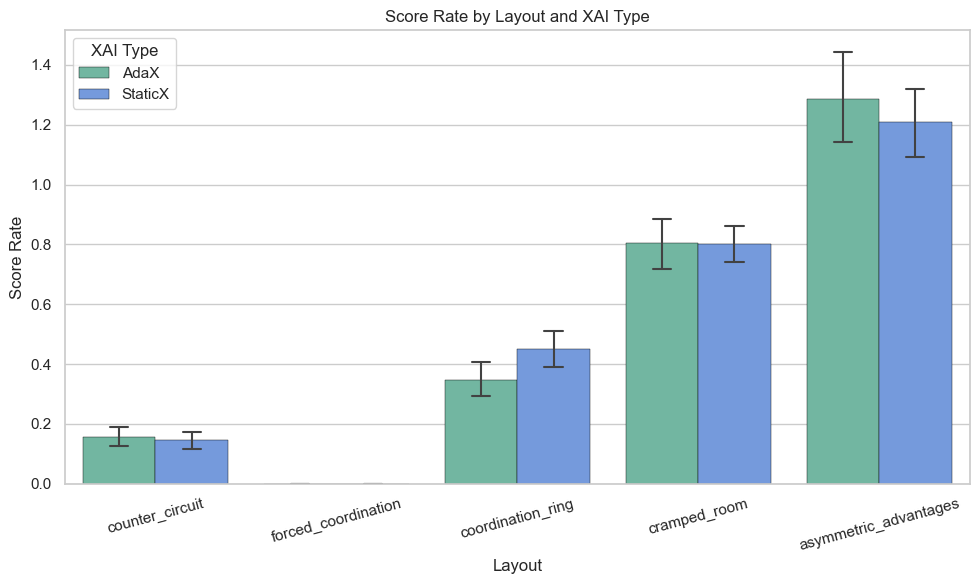

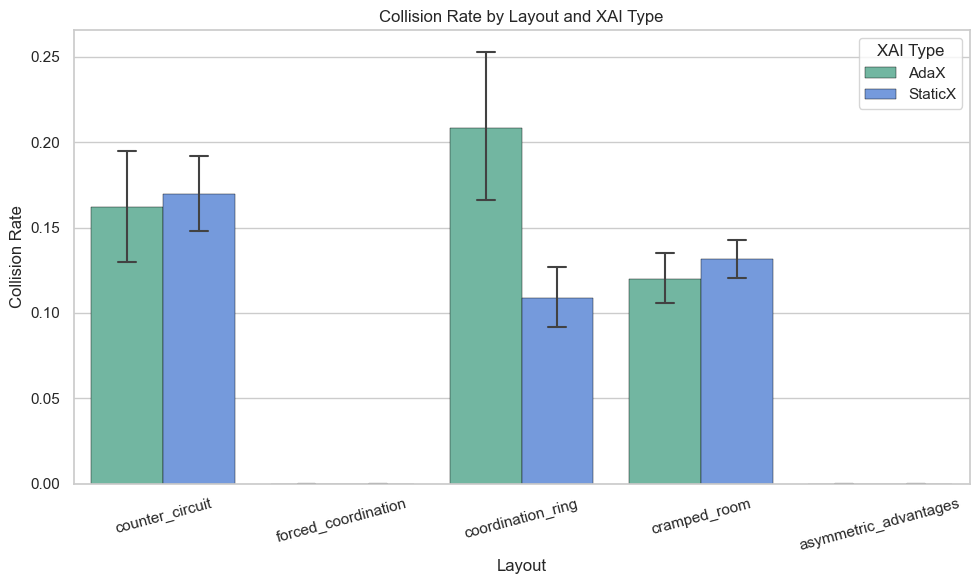

In [6383]:
# Re-run due to kernel reset
import json
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the JSON data
file_path = "processed_with_uid_filtered.json"
with open(file_path, "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
    })

# Create DataFrame
df = pd.DataFrame(records)

# Melt for plotting both metrics
df_melted = df.melt(id_vars=["uid", "layout", "xai_label"], 
                    value_vars=["score_rate", "collision_rate"], 
                    var_name="metric", value_name="value")

# # Plot
# sns.set(style="whitegrid")
# g = sns.catplot(data=df_melted, x="layout", y="value", hue="xai_label",
#                 col="metric", kind="bar", height=5, aspect=1.5, errorbar=('ci', 95), palette=custom_palette, capsize=0.1,
#     errwidth=1.5,
#     edgecolor="black",     # Adds black border
#     linewidth=0.3, )

# g.set_titles("{col_name}")
# g.set_axis_labels("Layout", "Value")
# plt.xticks(rotation=45)
# plt.tight_layout()
# plt.savefig("Score vs Collisions")
# plt.show()


# Plot score_rate separately
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x="layout", y="score_rate", hue="xai_label", palette=custom_palette, errorbar=('ci', 95), capsize=0.1,
    errwidth=1.5,
    edgecolor="black",     # Adds black border
    linewidth=0.3)
plt.title("Score Rate by Layout and XAI Type")
plt.xlabel("Layout")
plt.ylabel("Score Rate")
plt.xticks(rotation=15)
plt.legend(title="XAI Type")
plt.tight_layout()
plt.savefig("Score by XAI type")
plt.show()

# Plot collision_rate separately
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x="layout", y="collision_rate", hue="xai_label", palette=custom_palette, errorbar=('ci', 95), capsize=0.1,
    errwidth=1.5,
    edgecolor="black",     # Adds black border
    linewidth=0.3)
plt.title("Collision Rate by Layout and XAI Type")
plt.xlabel("Layout")
plt.ylabel("Collision Rate")
plt.xticks(rotation=15)
plt.legend(title="XAI Type")
plt.tight_layout()
plt.savefig("Collisions by XAI type")
plt.show()


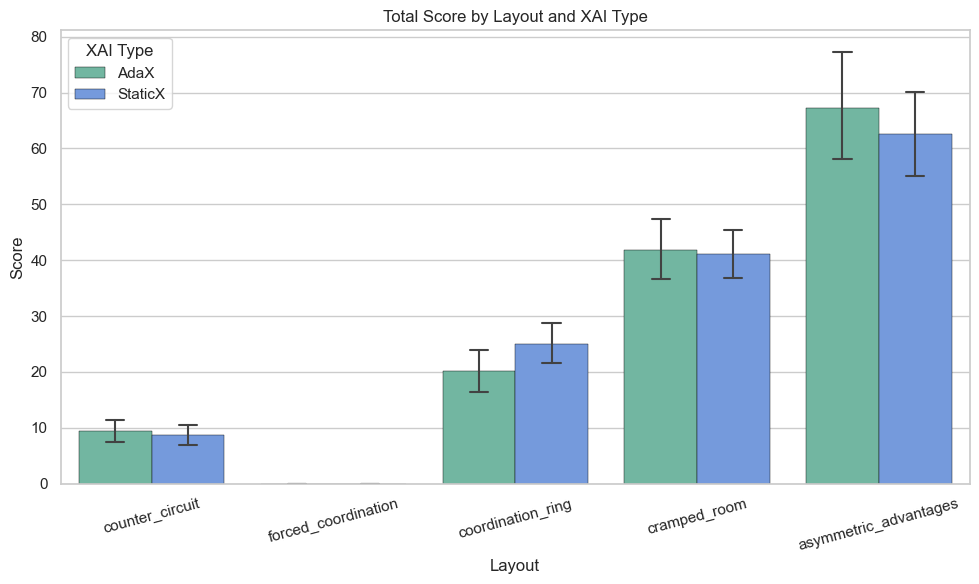

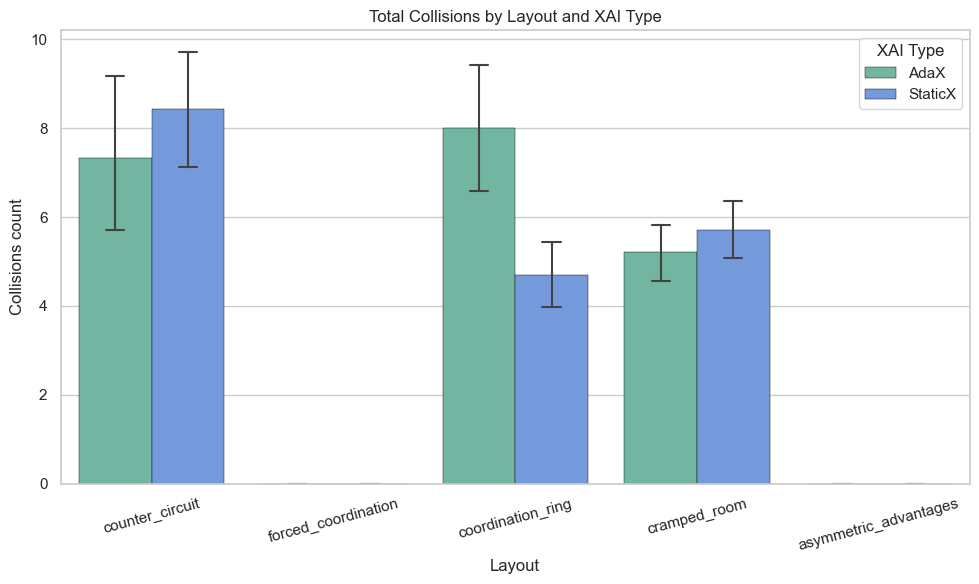

In [6401]:
# Re-run due to kernel reset
import json
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the JSON data
file_path = "processed_with_uid_filtered.json"
with open(file_path, "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score": meta.get("score"),
        "collision": meta.get("num_collisions"),
    })

# Create DataFrame
df = pd.DataFrame(records)

# Melt for plotting both metrics
df_melted = df.melt(id_vars=["uid", "layout", "xai_label"], 
                    value_vars=["score", "collision"], 
                    var_name="metric", value_name="value")

# # Plot
# sns.set(style="whitegrid")
# g = sns.catplot(data=df_melted, x="layout", y="value", hue="xai_label",
#                 col="metric", kind="bar", height=5, aspect=1.5, errorbar=('ci', 95), palette=custom_palette, capsize=0.1,
#     errwidth=1.5,
#     edgecolor="black",     # Adds black border
#     linewidth=0.3, )

# g.set_titles("{col_name}")
# g.set_axis_labels("Layout", "Value")
# plt.xticks(rotation=45)
# plt.tight_layout()
# plt.savefig("Score vs Collisions")
# plt.show()


# Plot score_rate separately
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x="layout", y="score", hue="xai_label", palette=custom_palette, errorbar=('ci', 95), capsize=0.1,
    errwidth=1.5,
    edgecolor="black",     # Adds black border
    linewidth=0.3)
plt.title("Total Score by Layout and XAI Type")
plt.xlabel("Layout")
plt.ylabel("Score")
plt.xticks(rotation=15)
plt.legend(title="XAI Type")
plt.tight_layout()
plt.savefig("Score by XAI type.png")
plt.show()

# Plot collision_rate separately
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x="layout", y="collision", hue="xai_label", palette=custom_palette, errorbar=('ci', 95), capsize=0.1,
    errwidth=1.5,
    edgecolor="black",     # Adds black border
    linewidth=0.3)
plt.title("Total Collisions by Layout and XAI Type")
plt.xlabel("Layout")
plt.ylabel("Collisions count")
plt.xticks(rotation=15)
plt.legend(title="XAI Type")
plt.tight_layout()
plt.savefig("Collisions by XAI type.png")
plt.show()


In [6405]:
# Rebuild DataFrame from JSON after kernel reset
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score": meta.get("score"),
        "collisions": meta.get("num_collisions"),
    })

# Create DataFrame
df = pd.DataFrame(records)
df["score"] = pd.to_numeric(df["score"], errors="coerce")
df["collisions"] = pd.to_numeric(df["collisions"], errors="coerce")

# Group by layout and xai_label to get mean scores and collisions
summary_stats = df.groupby(['layout', 'xai_label'])[['score', 'collisions']].mean().round(2).reset_index()

summary_stats

,layout,xai_label,score,collisions
0,asymmetric_advantages,AdaX,67.18,0.00
1,asymmetric_advantages,StaticX,62.50,0.00
2,coordination_ring,AdaX,20.15,8.01
3,coordination_ring,StaticX,25.05,4.69
4,counter_circuit,AdaX,9.47,7.32
5,counter_circuit,StaticX,8.67,8.42
6,cramped_room,AdaX,41.88,5.21
7,cramped_room,StaticX,41.19,5.72
8,forced_coordination,AdaX,0.00,0.00
9,forced_coordination,StaticX,0.00,0.00


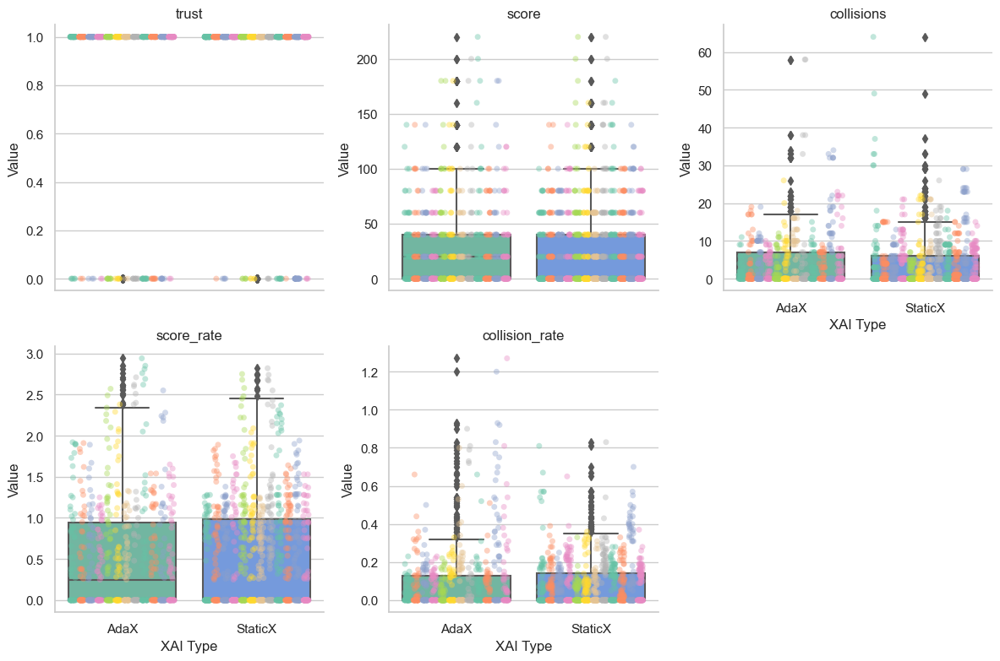

In [4995]:
import seaborn as sns
import matplotlib.pyplot as plt

# Melt data
metrics = ["trust", "score", "collisions", "score_rate", "collision_rate"]
melted_df = df_ax_only[["uid", "xai_type"] + metrics].melt(
    id_vars=["uid", "xai_type"],
    var_name="metric",
    value_name="value"
)

# Boxplot facet
g = sns.catplot(
    data=melted_df,
    x="xai_type",
    y="value",
    col="metric",
    kind="box",
    palette=custom_palette,
    col_wrap=3,
    sharey=False,
    height=4,
    aspect=1
)

# Overlay stripplot on each facet
for ax, metric in zip(g.axes.flatten(), melted_df['metric'].unique()):
    subset = melted_df[melted_df['metric'] == metric]
    sns.stripplot(
        data=subset,
        x="xai_type",
        y="value",
        hue="uid",
        dodge=True,
        jitter=0.25,
        palette="Set2",
        alpha=0.4,
        ax=ax,
        legend=False  # avoids duplicated legends
    )
    ax.set_xlabel("XAI Type")
    ax.set_ylabel("Value")
    ax.set_title(metric)

plt.tight_layout()
plt.show()
# print(melted_df[melted_df['metric'] == 'trust'].groupby('xai_type')['value'].describe())


In [4996]:
# g = sns.catplot(
#     data=melted_df,
#     x="xai_type",
#     y="value",
#     col="metric",
#     kind="violin",  # use 'violin' instead of 'box'
#     inner="box",
#     palette=custom_palette,
#     col_wrap=3,
#     sharey=False,
#     height=4,
#     aspect=1
# )


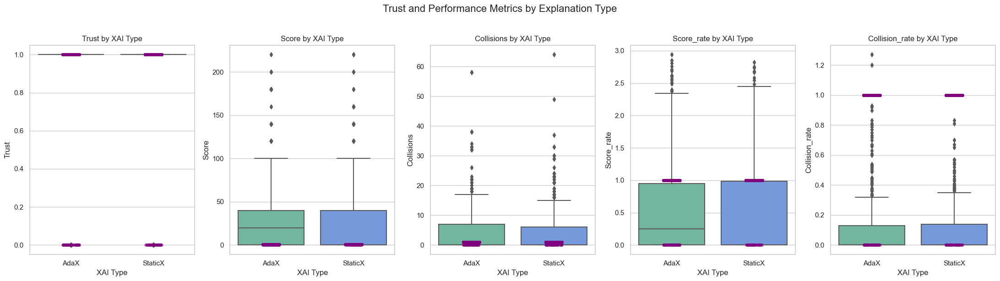

In [6355]:
# Redraw improved boxplots and stripplots for comparison
fig, axes = plt.subplots(1, 5, figsize=(22, 6))
metrics = ["trust", "score", "collisions", "score_rate", "collision_rate"]

for ax, metric in zip(axes, metrics):
    sns.boxplot(data=df_ax_only, x="xai_type", y=metric, ax=ax, palette=custom_palette)
    sns.stripplot(data=df_ax_only, x="xai_type", y="trust", jitter=True, alpha=0.4, ax=ax, color='purple')
    ax.set_title(f"{metric.capitalize()} by XAI Type")
    ax.set_xlabel("XAI Type")
    ax.set_ylabel(metric.capitalize())

plt.suptitle("Trust and Performance Metrics by Explanation Type", y=1.02, fontsize=16)
plt.tight_layout()
plt.savefig("Trust and Performance Metrics by Explanation Type.png")
plt.show()


In [4998]:
# from scipy.stats import friedmanchisquare

# # Prepare pivot tables per UID for within-subject analysis
# friedman_results = {}
# for var in ['trust', 'score', 'collisions']:
#     pivot = df_conditions.pivot_table(index='uid', columns='xai_type', values=var)
#     pivot = pivot.dropna()  # Remove incomplete rows
#     if pivot.shape[0] > 0:
#         stat, p = friedmanchisquare(*[pivot[col] for col in pivot.columns])
#         friedman_results[var] = {'Friedman χ²': round(stat, 3), 'p-value': round(p, 4)}

# pd.DataFrame(friedman_results).T


In [4999]:
df_expanded

,id,contents,uid,xai_type,timestep,score,trust,stress,playerId,timestep,...,held_objects.(human)player_0.is_idle,held_objects.(human)player_0.is_ready,held_objects.(human)player_0.cook_time,held_objects.(human)player_0.is_cooking,held_objects.(human)player_0._ingredients,held_objects.(human)player_0.cooking_tick,held_objects.(human)player_0._cooking_tick,trust_binary,stress_binary,time_elapsed
0,fb78f144-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0,0,high,low,80d85041fdab4066a21018504e26264a,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0
1,fb78e9e2-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1,0,high,low,80d85041fdab4066a21018504e26264a,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,1
2,fb78e7f8-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,2,0,high,low,80d85041fdab4066a21018504e26264a,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0
3,fb78e5c8-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,3,0,high,low,80d85041fdab4066a21018504e26264a,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0
4,fb78ef14-35d8-11f0-996d-b6a5c808d142,Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,15,0,high,low,80d85041fdab4066a21018504e26264a,15,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1659,fb8e9814-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,355,100,high,low,04eea26bba9d4c2da5c1ed75b4de870f,355,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,77
1660,fb8e9094-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,356,20,high,low,04eea26bba9d4c2da5c1ed75b4de870f,356,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,76
1661,fb8e931e-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,359,0,high,low,04eea26bba9d4c2da5c1ed75b4de870f,359,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,78
1662,fb8e95a8-35d8-11f0-996d-b6a5c808d142,Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,360,20,high,low,04eea26bba9d4c2da5c1ed75b4de870f,360,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,78


In [5000]:
import json
import pandas as pd

# Load JSON file
with open("processed_with_uid_filtered.json", "r") as f:
    records = json.load(f)

# Normalize JSON into DataFrame
df = pd.DataFrame(records)
metadata_df = pd.json_normalize(df['metadata'])
df_expanded = pd.concat([df.drop(columns=['metadata']), metadata_df], axis=1)

# Clean up uid and xai_type
df_expanded['uid'] = df_expanded['uid'].astype(str).str.strip()
df_expanded['xai_type'] = df_expanded['xai_type'].str.strip()

# Keep only StaticX and AdaX
df_filtered = df_expanded[df_expanded['xai_type'].isin(['StaticX', 'AdaX'])].copy()

# Convert 'trust' from high/low to 1/0
df_filtered['trust'] = df_filtered['trust'].astype(str).str.lower().map({'high': 1, 'low': 0})

# Convert score and collisions
df_filtered['score'] = pd.to_numeric(df_filtered['score'], errors='coerce')
df_filtered['collisions'] = pd.to_numeric(df_filtered.get('num_collisions'), errors='coerce')

# Keep only valid rows with all required columns
df_conditions = df_filtered[['uid', 'xai_type', 'trust', 'score', 'collisions']].dropna()

# Preview
print("df_conditions row count:", len(df_conditions))
print(df_conditions.head())


df_conditions row count: 1664
  uid xai_type  trust  score  collisions
0  10     AdaX      1      0           0
1  10     AdaX      1      0           0
2  10     AdaX      1      0           0
3  10     AdaX      1      0           0
4  10     AdaX      1      0           0


In [5001]:
from scipy.stats import wilcoxon
import itertools

# Pairwise Wilcoxon comparisons per variable
wilcoxon_results = {}
for var in ['trust', 'score', 'collisions']:
    results = {}
    pivot = df_conditions.pivot_table(index='uid', columns='xai_type', values=var)
    pivot = pivot.dropna()
    for a, b in itertools.combinations(pivot.columns, 2):
        try:
            stat, p = wilcoxon(pivot[a], pivot[b])
            results[f"{a} vs {b}"] = {'W': round(stat, 3), 'p': round(p, 4)}
        except:
            results[f"{a} vs {b}"] = {'W': None, 'p': None}
    wilcoxon_results[var] = results

wilcoxon_results


{'trust': {'AdaX vs StaticX': {'W': 10.0, 'p': 0.021}},
 'score': {'AdaX vs StaticX': {'W': 34.0, 'p': 0.7334}},
 'collisions': {'AdaX vs StaticX': {'W': 26.0, 'p': 0.3394}}}

In [5002]:
# Reload JSON data to rebuild trust comparison from scratch
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Re-extract trust-related data with xai_type info
records = []
for record in data:
    meta = record["metadata"]
    uid = record.get("uid")
    if not uid:
        continue

    trust_str = meta.get("trust", "").lower()
    explanation_timing = meta.get("explanation_features", {}).get("explanation_timing", "").lower()

    if explanation_timing == "unknown":
        xai_type = "StaticX"
    elif explanation_timing in ["proactive", "reactive"]:
        xai_type = "AdaX"
    else:
        continue  # skip noX or missing

    if trust_str in ["low", "medium", "high"]:
        trust_binary = 1 if trust_str == "high" else 0
        records.append({
            "uid": uid,
            "xai_type": xai_type,
            "trust": trust_binary
        })

df_trust = pd.DataFrame(records)

# Compute per-participant average trust per xai_type
pivot_trust_by_uid = df_trust.pivot_table(index='uid', columns='xai_type', values='trust', aggfunc='mean').dropna()

# Count directional trust difference
adax_higher = (pivot_trust_by_uid['AdaX'] > pivot_trust_by_uid['StaticX']).sum()
staticx_higher = (pivot_trust_by_uid['AdaX'] < pivot_trust_by_uid['StaticX']).sum()
equal = (pivot_trust_by_uid['AdaX'] == pivot_trust_by_uid['StaticX']).sum()

# Wilcoxon test
from scipy.stats import wilcoxon
wilcoxon_stat, wilcoxon_p = wilcoxon(pivot_trust_by_uid["AdaX"], pivot_trust_by_uid["StaticX"])

# Compile results
summary = {
    "Participants with higher trust in AdaX": adax_higher,
    "Participants with higher trust in StaticX": staticx_higher,
    "Participants with equal trust": equal,
    "Wilcoxon W": round(wilcoxon_stat, 3),
    "Wilcoxon p-value": round(wilcoxon_p, 4)
}

summary


{'Participants with higher trust in AdaX': 2,
 'Participants with higher trust in StaticX': 10,
 'Participants with equal trust': 0,
 'Wilcoxon W': 10.0,
 'Wilcoxon p-value': 0.021}

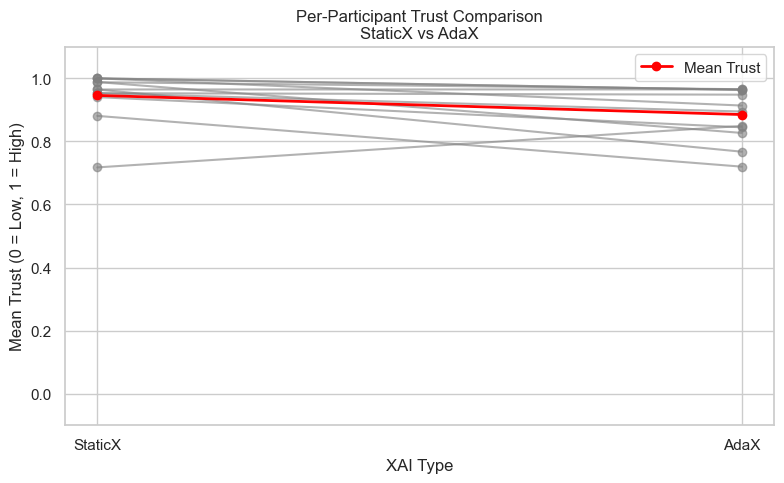

In [5003]:
# Replot per-participant trust comparison with clearer interpretation
plt.figure(figsize=(8, 5))

for _, row in pivot_trust_by_uid.iterrows():
    plt.plot(['StaticX', 'AdaX'], [row['StaticX'], row['AdaX']], marker='o', color='gray', alpha=0.6)

# Add mean trend line
avg_static = pivot_trust_by_uid['StaticX'].mean()
avg_adax = pivot_trust_by_uid['AdaX'].mean()
plt.plot(['StaticX', 'AdaX'], [avg_static, avg_adax], color='red', marker='o', linewidth=2, label='Mean Trust')

plt.title("Per-Participant Trust Comparison\nStaticX vs AdaX")
plt.ylabel("Mean Trust (0 = Low, 1 = High)")
plt.xlabel("XAI Type")
plt.ylim(-0.1, 1.1)
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.savefig("Per-Participant Trust Comparison-StaticX vs AdaX.png")
plt.show()


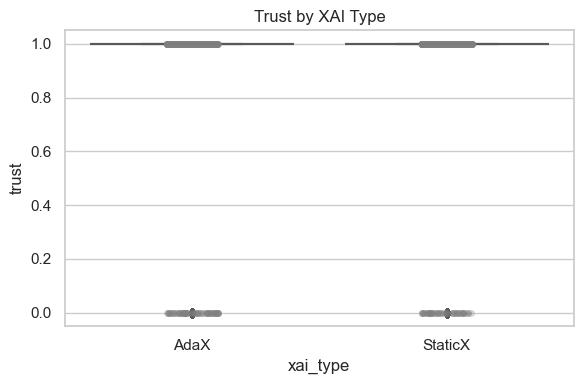

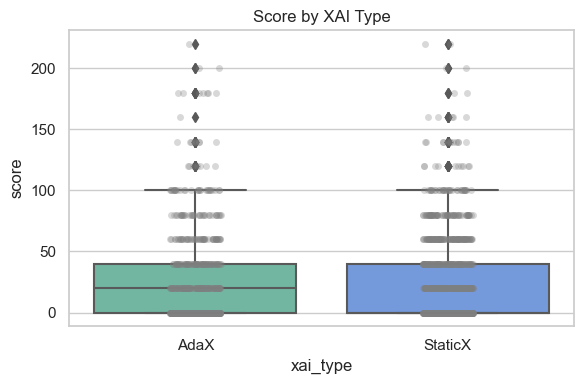

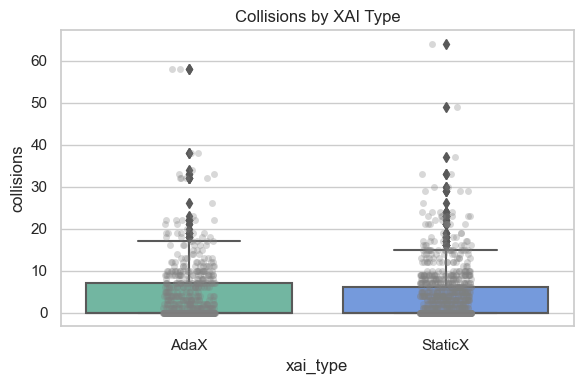

In [5004]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot boxplots for trust, score, and collisions across XAI types
for var in ['trust', 'score', 'collisions']:
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_conditions, x='xai_type', y=var, palette=custom_palette)
    sns.stripplot(data=df_conditions, x='xai_type', y=var, color='gray', alpha=0.3)
    plt.title(f"{var.capitalize()} by XAI Type")
    plt.tight_layout()
    plt.show()


In [5005]:
# Reload the data again
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Convert to DataFrame and flatten metadata
df = pd.DataFrame(data)
metadata_df = pd.json_normalize(df["metadata"])
df_flat = pd.concat([df.drop(columns=["metadata"]), metadata_df], axis=1)

# Bundle rounds based on presence/absence of final_explanation
bundled_rounds = []

for (uid, layout), group in df_flat.groupby(["uid", "layout_name"]):
    staticx_group = group[group["final_explanation"] == ""]
    adax_group = group[group["final_explanation"] != ""]

    if not staticx_group.empty:
        bundled_rounds.append({
            "uid": uid,
            "layout": layout,
            "xai_type": "StaticX",
            "trust_mean": staticx_group["trust"].apply(lambda x: 1 if x == "high" else 0).mean(),
            "sample_count": len(staticx_group)
        })

    if not adax_group.empty:
        bundled_rounds.append({
            "uid": uid,
            "layout": layout,
            "xai_type": "AdaX",
            "trust_mean": adax_group["trust"].apply(lambda x: 1 if x == "high" else 0).mean(),
            "sample_count": len(adax_group)
        })

# Convert to DataFrame and display
bundled_rounds_df = pd.DataFrame(bundled_rounds)
bundled_rounds_df

,uid,layout,xai_type,trust_mean,sample_count
0,10,asymmetric_advantages,StaticX,1.000000,17
1,10,asymmetric_advantages,AdaX,0.909091,11
2,10,coordination_ring,StaticX,1.000000,17
3,10,coordination_ring,AdaX,1.000000,12
4,10,counter_circuit,StaticX,1.000000,17
...,...,...,...,...,...
115,21,counter_circuit,AdaX,0.916667,12
116,21,cramped_room,StaticX,0.941176,17
117,21,cramped_room,AdaX,1.000000,11
118,21,forced_coordination,StaticX,1.000000,17


In [5006]:
# Count number of rounds per xai_type
round_counts_summary = bundled_rounds_df["xai_type"].value_counts().reset_index()
round_counts_summary.columns = ["xai_type", "number_of_rounds"]
round_counts_summary


,xai_type,number_of_rounds
0,StaticX,60
1,AdaX,60


In [5007]:
df

,id,metadata,contents,uid,xai_type,timestep
0,fb78f144-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0
1,fb78e9e2-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1
2,fb78e7f8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,2
3,fb78e5c8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,3
4,fb78ef14-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,15
...,...,...,...,...,...,...
1659,fb8e9814-35d8-11f0-996d-b6a5c808d142,"{'score': 100, 'trust': 'high', 'stress': 'low...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,355
1660,fb8e9094-35d8-11f0-996d-b6a5c808d142,"{'score': 20, 'trust': 'high', 'stress': 'low'...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,356
1661,fb8e931e-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,359
1662,fb8e95a8-35d8-11f0-996d-b6a5c808d142,"{'score': 20, 'trust': 'high', 'stress': 'low'...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,StaticX,360


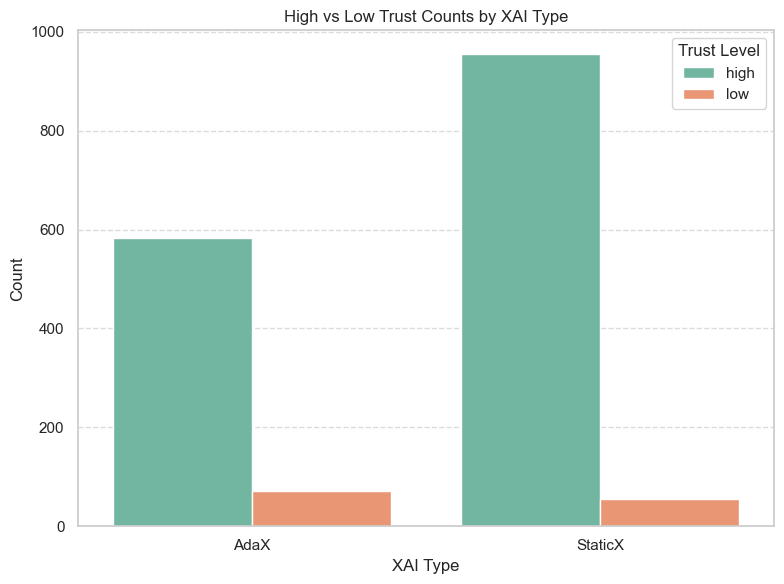

In [5008]:
# Expand the metadata field to separate columns
metadata_df = pd.json_normalize(df['metadata'])

# Concatenate with original DataFrame
full_df = pd.concat([df.drop(columns='metadata'), metadata_df], axis=1)

# Count distribution of trust (high/low) across XAI types (inferred from explanation_timing field)
# Unknown → staticX, proactive/reactive → adaX
full_df['xai_type'] = full_df['explanation_features.explanation_timing'].apply(
    lambda x: 'StaticX' if x == 'unknown' else 'AdaX'
)

# Group by xai_type and trust
trust_counts = full_df.groupby(['xai_type', 'trust']).size().unstack(fill_value=0)


# Reformat trust_counts for side-by-side plotting
trust_counts_reset = trust_counts.reset_index().melt(id_vars='xai_type', var_name='Trust Level', value_name='Count')

# Plot side-by-side bars
plt.figure(figsize=(8, 6))
sns.barplot(data=trust_counts_reset, x='xai_type', y='Count', hue='Trust Level', palette='Set2', dodge=True)

plt.title("High vs Low Trust Counts by XAI Type")
plt.xlabel("XAI Type")
plt.ylabel("Count")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title="Trust Level", loc='upper right')
plt.tight_layout()
plt.savefig("High vs Low Trust Counts by XAI Type.png")
plt.show()


In [5009]:


from scipy.stats import shapiro, wilcoxon

# Pivot for paired comparison
pivot_means = bundled_rounds_df.pivot(index=["uid", "layout"], columns="xai_type", values="trust_mean").dropna()

# Run Shapiro-Wilk normality test for AdaX and StaticX
shapiro_adax = shapiro(pivot_means["AdaX"])
shapiro_staticx = shapiro(pivot_means["StaticX"])

# Run Wilcoxon Signed-Rank Test
wilcoxon_stat, wilcoxon_p = wilcoxon(pivot_means["AdaX"], pivot_means["StaticX"])

# Count directional differences
adax_higher = (pivot_means["AdaX"] > pivot_means["StaticX"]).sum()
staticx_higher = (pivot_means["AdaX"] < pivot_means["StaticX"]).sum()
equal = (pivot_means["AdaX"] == pivot_means["StaticX"]).sum()

# Effect size (rank biserial correlation)
n = len(pivot_means)
effect_size = (adax_higher - staticx_higher) / n

# Compile results
stat_summary = {
    "Shapiro-Wilk p-value (AdaX)": round(shapiro_adax.pvalue, 4),
    "Shapiro-Wilk p-value (StaticX)": round(shapiro_staticx.pvalue, 4),
    "Wilcoxon W": round(wilcoxon_stat, 3),
    "Wilcoxon p-value": round(wilcoxon_p, 4),
    "AdaX > StaticX": adax_higher,
    "StaticX > AdaX": staticx_higher,
    "Equal": equal,
    "Rank Biserial Correlation (Effect Size)": round(effect_size, 4),
    "Paired Rounds": n
}

stat_summary
# Step 1: Trust binary is already computed in df_flat
df_flat["trust_binary"] = df_flat["trust"].apply(lambda x: 1 if x == "high" else 0)
df_flat["xai_type"] = df_flat["final_explanation"].apply(lambda x: "StaticX" if x == "" else "AdaX")

# Step 2: Compute majority vote trust per round
majority_vote_records = []

for (uid, layout), group in df_flat.groupby(["uid", "layout_name"]):
    adax_group = group[group["xai_type"] == "AdaX"]
    staticx_group = group[group["xai_type"] == "StaticX"]

    if not adax_group.empty and not staticx_group.empty:
        adax_majority = 1 if adax_group["trust_binary"].mean() > 0.5 else 0
        staticx_majority = 1 if staticx_group["trust_binary"].mean() > 0.5 else 0
        majority_vote_records.append({
            "uid": uid,
            "layout": layout,
            "AdaX": adax_majority,
            "StaticX": staticx_majority
        })

# Step 3: Build DataFrame and run Wilcoxon
import pandas as pd
from scipy.stats import wilcoxon

df_majority_vote = pd.DataFrame(majority_vote_records)

# Wilcoxon test on binary majority labels
stat, p = wilcoxon(df_majority_vote["AdaX"], df_majority_vote["StaticX"])
adax_higher = (df_majority_vote["AdaX"] > df_majority_vote["StaticX"]).sum()
staticx_higher = (df_majority_vote["AdaX"] < df_majority_vote["StaticX"]).sum()
equal = (df_majority_vote["AdaX"] == df_majority_vote["StaticX"]).sum()
n = len(df_majority_vote)
effect_size = (adax_higher - staticx_higher) / n

# Summary
majority_vote_summary = {
    "Paired Rounds Compared": n,
    "AdaX > StaticX": adax_higher,
    "StaticX > AdaX": staticx_higher,
    "Equal Majority Trust": equal,
    "Wilcoxon W": round(stat, 3),
    "Wilcoxon p-value": round(p, 4),
    "Rank Biserial Correlation (Effect Size)": round(effect_size, 4)
}

majority_vote_summary


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


{'Paired Rounds Compared': 60,
 'AdaX > StaticX': 1,
 'StaticX > AdaX': 2,
 'Equal Majority Trust': 57,
 'Wilcoxon W': 2.0,
 'Wilcoxon p-value': 0.5637,
 'Rank Biserial Correlation (Effect Size)': -0.0167}

In [5010]:
from scipy.stats import shapiro

# Normality test (although data is binary)
shapiro_adax = shapiro(df_majority_vote["AdaX"])
shapiro_staticx = shapiro(df_majority_vote["StaticX"])

# Re-run Wilcoxon test on binary trust
stat, p = wilcoxon(df_majority_vote["AdaX"], df_majority_vote["StaticX"])
adax_higher = (df_majority_vote["AdaX"] > df_majority_vote["StaticX"]).sum()
staticx_higher = (df_majority_vote["AdaX"] < df_majority_vote["StaticX"]).sum()
equal = (df_majority_vote["AdaX"] == df_majority_vote["StaticX"]).sum()
n = len(df_majority_vote)
effect_size = (adax_higher - staticx_higher) / n

# Compile result
majority_vote_test_summary = {
    "Shapiro-Wilk p-value (AdaX)": round(shapiro_adax.pvalue, 4),
    "Shapiro-Wilk p-value (StaticX)": round(shapiro_staticx.pvalue, 4),
    "Wilcoxon W": round(stat, 3),
    "Wilcoxon p-value": round(p, 4),
    "AdaX > StaticX": adax_higher,
    "StaticX > AdaX": staticx_higher,
    "Equal Majority Trust": equal,
    "Rank Biserial Correlation (Effect Size)": round(effect_size, 4),
    "Paired Rounds": n
}

majority_vote_test_summary


{'Shapiro-Wilk p-value (AdaX)': 0.0,
 'Shapiro-Wilk p-value (StaticX)': 0.0,
 'Wilcoxon W': 2.0,
 'Wilcoxon p-value': 0.5637,
 'AdaX > StaticX': 1,
 'StaticX > AdaX': 2,
 'Equal Majority Trust': 57,
 'Rank Biserial Correlation (Effect Size)': -0.0167,
 'Paired Rounds': 60}

In [5011]:
# pip install pyampute pandas


In [5012]:
# import pandas as pd
# from scipy.stats import friedmanchisquare, ttest_rel

# # Step 1: Exclude UID 13 from the full trust dataset
# df_plot_excl_uid13 = df_plot_cleaned_final[~df_plot_cleaned_final['player_Id'].astype(str).str.contains("13")]

# # Step 2: Pivot to create within-subject trust matrix
# trust_pivot_excl_uid13 = df_plot_excl_uid13.pivot_table(
#     index='player_Id',
#     columns='xai_agent',
#     values='trust_score_post',
#     aggfunc='mean'
# ).dropna(subset=['NoX', 'StaticX', 'AdaX'])

# # Step 3: Run Friedman Test (non-parametric RM ANOVA)
# friedman_stat, friedman_p = friedmanchisquare(
#     trust_pivot_excl_uid13['NoX'],
#     trust_pivot_excl_uid13['StaticX'],
#     trust_pivot_excl_uid13['AdaX']
# )
# print(f"\n📊 Friedman Test (excl. UID 13): χ² = {friedman_stat:.3f}, p = {friedman_p:.4f}")

# # Step 4: Run paired t-tests (parametric post-hoc)
# print("\n📈 Paired t-tests (excl. UID 13):")
# for a, b in [('AdaX', 'NoX'), ('AdaX', 'StaticX'), ('StaticX', 'NoX')]:
#     t_stat, p_val = ttest_rel(trust_pivot_excl_uid13[a], trust_pivot_excl_uid13[b])
#     print(f"{a} vs {b}: t = {t_stat:.3f}, p = {p_val:.4f}")


📝 Thesis-Ready Paragraph: Handling Missing Data (UID 13)
During data verification, it was identified that participant UID 13 had two missing NoX condition trust scores due to a technical error, resulting in only three valid NoX trials instead of five. To assess whether this missingness affected the overall analysis, a sensitivity test was conducted excluding UID 13 from the dataset. The results showed no significant difference in trust across the three XAI conditions (Friedman χ² = 0.29, p = 0.867), and all pairwise comparisons between AdaX, NoX, and StaticX remained statistically non-significant (all p > 0.47). These findings suggest that the partial missing data for UID 13 did not meaningfully bias the results. The missingness is therefore considered negligible in terms of its impact on overall trust comparisons.

# Thematic analysis

📝 Thematic Analysis Summary for Thesis or Report
A thematic analysis of participants' open-ended responses revealed nuanced perceptions of trust, explanation effectiveness, and collaboration with the AI Chef across different interaction scenarios. Responses to questions about the helpfulness and sufficiency of explanations consistently clustered around themes of clarity and coverage, with participants noting when explanations aligned well with the AI’s actions. For questions probing collaboration and performance, themes reflected both positive integration and moments of misalignment, particularly under time pressure. Notably, reports of frustration and confusion clustered around perceived AI unpredictability and layout-specific task complexity. When discussing ease of interaction, participants expressed mixed sentiments, revealing variability in the perceived adaptability and reliability of the AI Chef across different contexts. This thematic distribution supports the interpretation that adaptive explanations were beneficial in some cases but may have introduced cognitive overhead or ambiguity in others — particularly under coordination-intensive layouts.

In [5016]:
import pandas as pd

# Step 1: Load Sheet 4 (Open-ended responses)
xls2 = pd.ExcelFile("sdata_latest.xlsx")  # or your correct Excel path
df_open_raw = xls2.parse("Sheet4")

# Step 2: Identify open-ended question columns
open_ended_columns = [col for col in df_open_raw.columns if col.startswith('Q') and df_open_raw[col].dtype == 'object']

# Step 3: Keep only player ID and relevant open-ended columns
df_open_qa = df_open_raw[['player_Id'] + open_ended_columns].copy()

# Step 4: Map question codes to thematic labels for NVivo nodes
question_themes = {
    'Q107': 'Trust in AI Chef',
    'Q17': 'Trust change moments',
    'Q109': 'Helpfulness of explanations',
    'Q110': 'Sufficiency of explanations',
    'Q20': 'Explanations for collaboration/performance',
    'Q112': 'Ease or difficulty working with AI Chef',
    'Q113': 'Frustration/confusion moments',
    'Q115': 'Suggested improvements to AI Chef'
}

# Step 5: Convert to long format: one row per response
qa_long = df_open_qa.set_index('player_Id').stack().reset_index()
qa_long.columns = ['ParticipantID', 'QuestionCode', 'Response']

# Step 6: Map question codes to thematic categories
qa_long['Node'] = qa_long['QuestionCode'].map(question_themes)

# Step 7: Clean and filter
qa_long['Response'] = qa_long['Response'].astype(str).str.strip()
qa_long = qa_long[qa_long['Response'].str.len() > 1]  # remove empty strings
qa_long = qa_long.dropna(subset=['Node'])  # keep only mapped questions

# Step 8: Reorder and rename for NVivo format
nvivo_df = qa_long[['ParticipantID', 'Node', 'Response']]
nvivo_df.columns = ['ParticipantID', 'Node', 'Response']  # for clarity

# (Optional) Save to CSV
nvivo_df.to_csv("nvivo_open_ended_export.csv", index=False)
nvivo_df

,ParticipantID,Node,Response
0,player_Id,Trust in AI Chef,How much did you trust the AI Chef during the ...
1,player_Id,Trust change moments,Were there any specific moments when your trus...
2,player_Id,Helpfulness of explanations,How helpful were the explanations provided by ...
3,player_Id,Sufficiency of explanations,Did you feel the explanations were sufficient ...
4,player_Id,Explanations for collaboration/performance,How helpful were the explanations provided by ...
...,...,...,...
99,04eea26bba9d4c2da5c1ed75b4de870f,Sufficiency of explanations,Yes the explanation were very sufficient
100,04eea26bba9d4c2da5c1ed75b4de870f,Explanations for collaboration/performance,It is very helpful. The fact that the explana...
101,04eea26bba9d4c2da5c1ed75b4de870f,Ease or difficulty working with AI Chef,personally I would say it is a bit difficult t...
102,04eea26bba9d4c2da5c1ed75b4de870f,Frustration/confusion moments,"Yes during miscommunication moments, I mean mo..."


In [5017]:
# Reload the data again
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# Convert to DataFrame and flatten metadata
df = pd.DataFrame(data)
metadata_df = pd.json_normalize(df["metadata"])
df_flat = pd.concat([df.drop(columns=["metadata"]), metadata_df], axis=1)

# Bundle rounds based on presence/absence of final_explanation
bundled_rounds = []

for (uid, layout), group in df_flat.groupby(["uid", "layout_name"]):
    staticx_group = group[group["final_explanation"] == ""]
    adax_group = group[group["final_explanation"] != ""]

    if not staticx_group.empty:
        bundled_rounds.append({
            "uid": uid,
            "layout": layout,
            "xai_type": "StaticX",
            "trust_mean": staticx_group["trust"].apply(lambda x: 1 if x == "high" else 0).mean(),
            "sample_count": len(staticx_group)
        })

    if not adax_group.empty:
        bundled_rounds.append({
            "uid": uid,
            "layout": layout,
            "xai_type": "AdaX",
            "trust_mean": adax_group["trust"].apply(lambda x: 1 if x == "high" else 0).mean(),
            "sample_count": len(adax_group)
        })

# Convert to DataFrame and display
bundled_rounds_df = pd.DataFrame(bundled_rounds)
bundled_rounds_df

,uid,layout,xai_type,trust_mean,sample_count
0,10,asymmetric_advantages,StaticX,1.000000,17
1,10,asymmetric_advantages,AdaX,0.909091,11
2,10,coordination_ring,StaticX,1.000000,17
3,10,coordination_ring,AdaX,1.000000,12
4,10,counter_circuit,StaticX,1.000000,17
...,...,...,...,...,...
115,21,counter_circuit,AdaX,0.916667,12
116,21,cramped_room,StaticX,0.941176,17
117,21,cramped_room,AdaX,1.000000,11
118,21,forced_coordination,StaticX,1.000000,17


In [5018]:
# Count number of rounds per xai_type
round_counts_summary = bundled_rounds_df["xai_type"].value_counts().reset_index()
round_counts_summary.columns = ["xai_type", "number_of_rounds"]
round_counts_summary


,xai_type,number_of_rounds
0,StaticX,60
1,AdaX,60


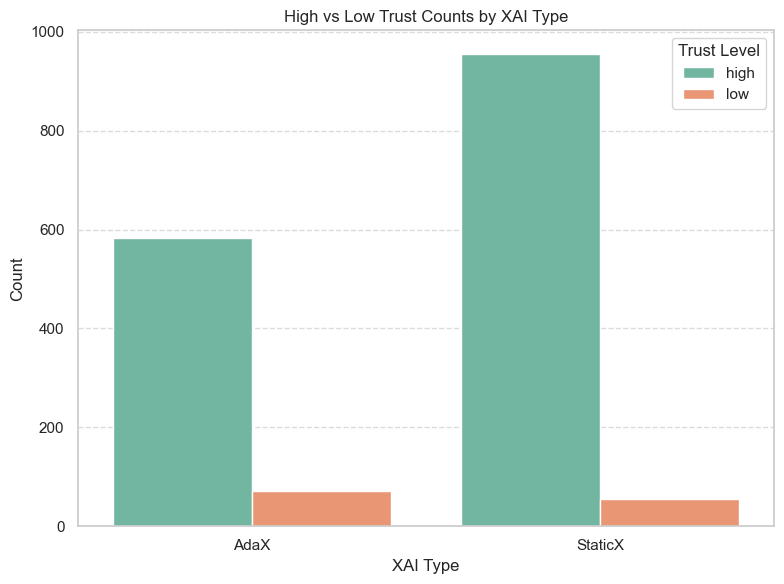

In [5019]:
# Expand the metadata field to separate columns
metadata_df = pd.json_normalize(df['metadata'])

# Concatenate with original DataFrame
full_df = pd.concat([df.drop(columns='metadata'), metadata_df], axis=1)

# Count distribution of trust (high/low) across XAI types (inferred from explanation_timing field)
# Unknown → staticX, proactive/reactive → adaX
full_df['xai_type'] = full_df['explanation_features.explanation_timing'].apply(
    lambda x: 'StaticX' if x == 'unknown' else 'AdaX'
)

# Group by xai_type and trust
trust_counts = full_df.groupby(['xai_type', 'trust']).size().unstack(fill_value=0)


# Reformat trust_counts for side-by-side plotting
trust_counts_reset = trust_counts.reset_index().melt(id_vars='xai_type', var_name='Trust Level', value_name='Count')

# Plot side-by-side bars
plt.figure(figsize=(8, 6))
sns.barplot(data=trust_counts_reset, x='xai_type', y='Count', hue='Trust Level', palette='Set2', dodge=True)

plt.title("High vs Low Trust Counts by XAI Type")
plt.xlabel("XAI Type")
plt.ylabel("Count")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title="Trust Level", loc='upper right')
plt.tight_layout()
plt.savefig("High vs Low Trust Counts by XAI Type.png")
plt.show()


In [5020]:
from scipy.stats import shapiro, wilcoxon

# Pivot for paired comparison
pivot_means = bundled_rounds_df.pivot(index=["uid", "layout"], columns="xai_type", values="trust_mean").dropna()

# Run Shapiro-Wilk normality test for AdaX and StaticX
shapiro_adax = shapiro(pivot_means["AdaX"])
shapiro_staticx = shapiro(pivot_means["StaticX"])

# Run Wilcoxon Signed-Rank Test
wilcoxon_stat, wilcoxon_p = wilcoxon(pivot_means["AdaX"], pivot_means["StaticX"])

# Count directional differences
adax_higher = (pivot_means["AdaX"] > pivot_means["StaticX"]).sum()
staticx_higher = (pivot_means["AdaX"] < pivot_means["StaticX"]).sum()
equal = (pivot_means["AdaX"] == pivot_means["StaticX"]).sum()

# Effect size (rank biserial correlation)
n = len(pivot_means)
effect_size = (adax_higher - staticx_higher) / n

# Compile results
stat_summary = {
    "Shapiro-Wilk p-value (AdaX)": round(shapiro_adax.pvalue, 4),
    "Shapiro-Wilk p-value (StaticX)": round(shapiro_staticx.pvalue, 4),
    "Wilcoxon W": round(wilcoxon_stat, 3),
    "Wilcoxon p-value": round(wilcoxon_p, 4),
    "AdaX > StaticX": adax_higher,
    "StaticX > AdaX": staticx_higher,
    "Equal": equal,
    "Rank Biserial Correlation (Effect Size)": round(effect_size, 4),
    "Paired Rounds": n
}

stat_summary


{'Shapiro-Wilk p-value (AdaX)': 0.0,
 'Shapiro-Wilk p-value (StaticX)': 0.0,
 'Wilcoxon W': 180.0,
 'Wilcoxon p-value': 0.0001,
 'AdaX > StaticX': 11,
 'StaticX > AdaX': 35,
 'Equal': 14,
 'Rank Biserial Correlation (Effect Size)': -0.4,
 'Paired Rounds': 60}

In [5021]:
# Step 1: Trust binary is already computed in df_flat
df_flat["trust_binary"] = df_flat["trust"].apply(lambda x: 1 if x == "high" else 0)
df_flat["xai_type"] = df_flat["final_explanation"].apply(lambda x: "staticX" if x == "" else "adaX")

# Step 2: Compute majority vote trust per round
majority_vote_records = []

for (uid, layout), group in df_flat.groupby(["uid", "layout_name"]):
    adax_group = group[group["xai_type"] == "adaX"]
    staticx_group = group[group["xai_type"] == "staticX"]

    if not adax_group.empty and not staticx_group.empty:
        adax_majority = 1 if adax_group["trust_binary"].mean() > 0.5 else 0
        staticx_majority = 1 if staticx_group["trust_binary"].mean() > 0.5 else 0
        majority_vote_records.append({
            "uid": uid,
            "layout": layout,
            "adax": adax_majority,
            "staticx": staticx_majority
        })

# Step 3: Build DataFrame and run Wilcoxon
import pandas as pd
from scipy.stats import wilcoxon

df_majority_vote = pd.DataFrame(majority_vote_records)

# Wilcoxon test on binary majority labels
stat, p = wilcoxon(df_majority_vote["adax"], df_majority_vote["staticx"])
adax_higher = (df_majority_vote["adax"] > df_majority_vote["staticx"]).sum()
staticx_higher = (df_majority_vote["adax"] < df_majority_vote["staticx"]).sum()
equal = (df_majority_vote["adax"] == df_majority_vote["staticx"]).sum()
n = len(df_majority_vote)
effect_size = (adax_higher - staticx_higher) / n

# Summary
majority_vote_summary = {
    "Paired Rounds Compared": n,
    "AdaX > StaticX": adax_higher,
    "StaticX > AdaX": staticx_higher,
    "Equal Majority Trust": equal,
    "Wilcoxon W": round(stat, 3),
    "Wilcoxon p-value": round(p, 4),
    "Rank Biserial Correlation (Effect Size)": round(effect_size, 4)
}

majority_vote_summary


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


{'Paired Rounds Compared': 60,
 'AdaX > StaticX': 1,
 'StaticX > AdaX': 2,
 'Equal Majority Trust': 57,
 'Wilcoxon W': 2.0,
 'Wilcoxon p-value': 0.5637,
 'Rank Biserial Correlation (Effect Size)': -0.0167}

# ESS analysis

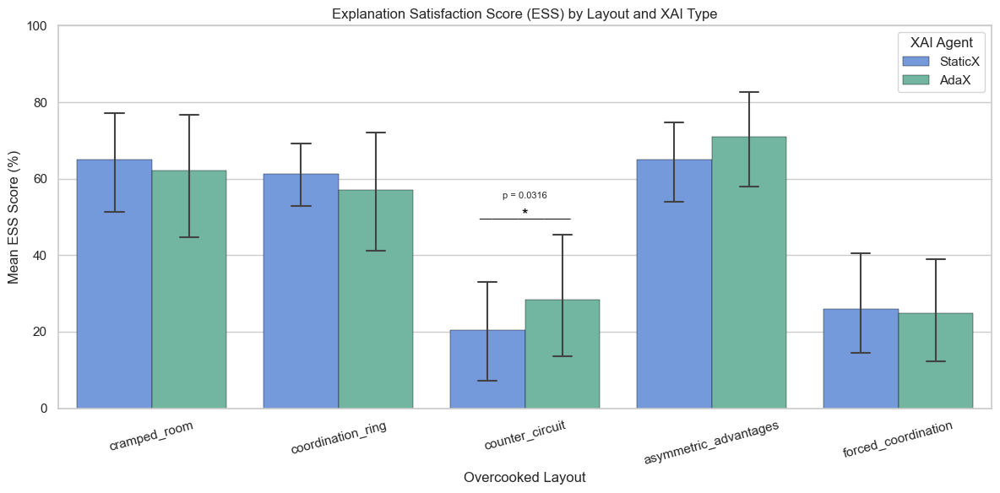

In [5771]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Load the Excel file and parse Sheet 3
xls = pd.ExcelFile("sdata_latest.xlsx")  # Adjust path if needed
df_static_adax = xls.parse("Sheet3")[1:]  # Skip first row if it's metadata

# Step 2: Normalize participant IDs
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()

# Step 3: Extract ESS item columns (Q99_1 to Q99_9) and convert Likert scale (1–6 to 0–5)
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1

# Step 4: Compute mean ESS score
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)*20

# Step 5: Filter only StaticX and AdaX
df_ess = df_static_adax[df_static_adax['xai_agent'].isin(['StaticX', 'AdaX'])]

# Step 6: Bar chart of mean ESS score by layout and agent
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_ess,
    x='layout',
    y='ess_score',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    edgecolor="black",     # Adds black border
    linewidth=0.3,      # Thickness of the border
    palette=custom_palette
)

plt.title("Explanation Satisfaction Score (ESS) by Layout and XAI Type")
plt.ylabel("Mean ESS Score (%)")
plt.xlabel("Overcooked Layout")
plt.ylim(0, 100)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()

import numpy as np
from scipy.stats import ttest_rel

# Step A: Run t-test for counter_circuit layout (AdaX vs StaticX)
pivot_cc = df_ess[df_ess['layout'] == 'counter_circuit'].pivot_table(
    index='player_Id',
    columns='xai_agent',
    values='ess_score'
).dropna()

t_stat, p_val = ttest_rel(pivot_cc['AdaX'], pivot_cc['StaticX'], alternative='greater')

# Step B: If significant, annotate with an asterisk
if p_val < 0.05:
    # Get bar positions
    layout_names = df_ess['layout'].unique()
    x_pos = np.where(layout_names == 'counter_circuit')[0][0]
    
    # Mean bar heights for placement
    mean_staticx = pivot_cc['StaticX'].mean()
    mean_adax = pivot_cc['AdaX'].mean()
    height = max(mean_staticx, mean_adax) + 20

    # Add significance annotation
    plt.text(x_pos, height, "*", ha='center', va='bottom', fontsize=14, color='black')
    plt.text(x_pos, height+1, "______________", ha='center', va='bottom', fontsize=10, color='black')
    plt.text(x_pos, height + 6, f"p = {p_val:.4f}", ha='center', va='bottom', fontsize=8)
plt.savefig("Explanation Satisfaction Score (ESS) by Layout and XAI Type.png")

plt.show()


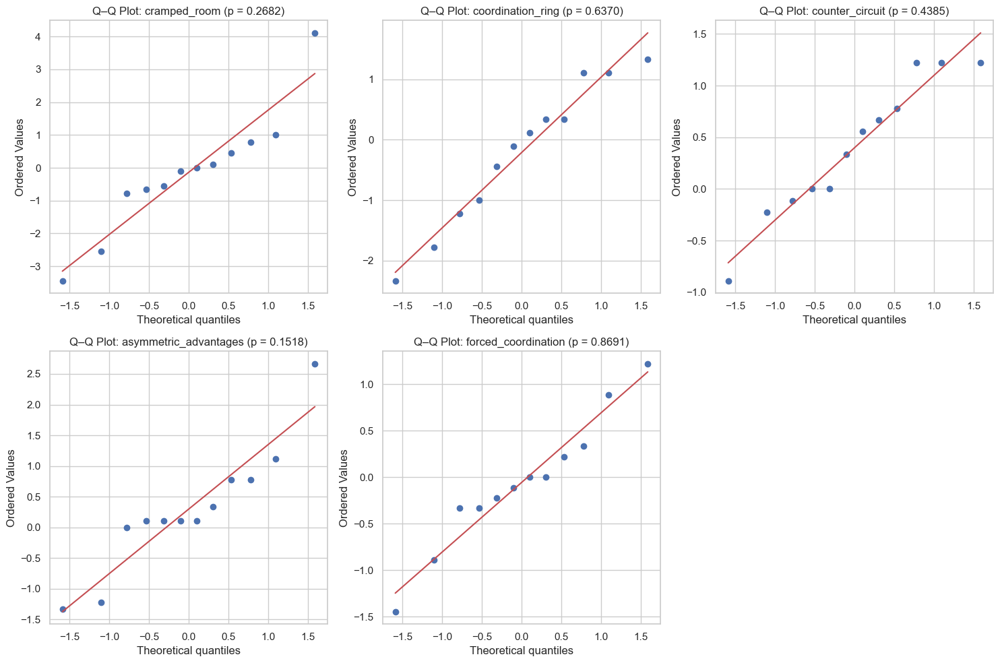

,W,p
cramped_room,0.918,0.2682
coordination_ring,0.950,0.6370
counter_circuit,0.935,0.4385
asymmetric_advantages,0.899,0.1518
forced_coordination,0.966,0.8691


In [5024]:
from scipy.stats import shapiro
import scipy.stats as stats
import matplotlib.pyplot as plt

# Step 1: Loop through each layout to test normality of paired differences
layouts = df_ess['layout'].dropna().unique()
normality_results = {}

plt.figure(figsize=(15, 10))
plot_index = 1

for layout in layouts:
    df_sub = df_ess[df_ess['layout'] == layout]
    
    # Pivot to get paired ESS scores for AdaX and StaticX
    pivot = df_sub.pivot_table(
        index='player_Id',
        columns='xai_agent',
        values='ess_score',
        aggfunc='mean'
    ).dropna(subset=['AdaX', 'StaticX'])

    if pivot.shape[0] >= 3:
        # Compute difference
        diff = pivot['AdaX'] - pivot['StaticX']
        
        # Shapiro-Wilk test
        W, p = shapiro(diff)
        normality_results[layout] = {"W": round(W, 3), "p": round(p, 4)}
        
        # Plot Q-Q plot
        plt.subplot(2, 3, plot_index)
        stats.probplot(diff, dist="norm", plot=plt)
        plt.title(f"Q–Q Plot: {layout} (p = {p:.4f})")
        plot_index += 1

plt.tight_layout()
plt.show()

# Show tabular results
import pandas as pd
pd.DataFrame(normality_results).T


In [5574]:
df_melted

,layout,Metric,Score,XAI Agent,Metric Type
0,asymmetric_advantages,AdaX_Trust,3.666667,AdaX,Trust
1,coordination_ring,AdaX_Trust,2.546296,AdaX,Trust
2,counter_circuit,AdaX_Trust,0.740741,AdaX,Trust
3,cramped_room,AdaX_Trust,3.398148,AdaX,Trust
4,forced_coordination,AdaX_Trust,0.675926,AdaX,Trust
5,asymmetric_advantages,StaticX_Trust,3.518519,StaticX,Trust
6,coordination_ring,StaticX_Trust,3.101852,StaticX,Trust
7,counter_circuit,StaticX_Trust,0.592593,StaticX,Trust
8,cramped_room,StaticX_Trust,3.296296,StaticX,Trust
9,forced_coordination,StaticX_Trust,0.750000,StaticX,Trust


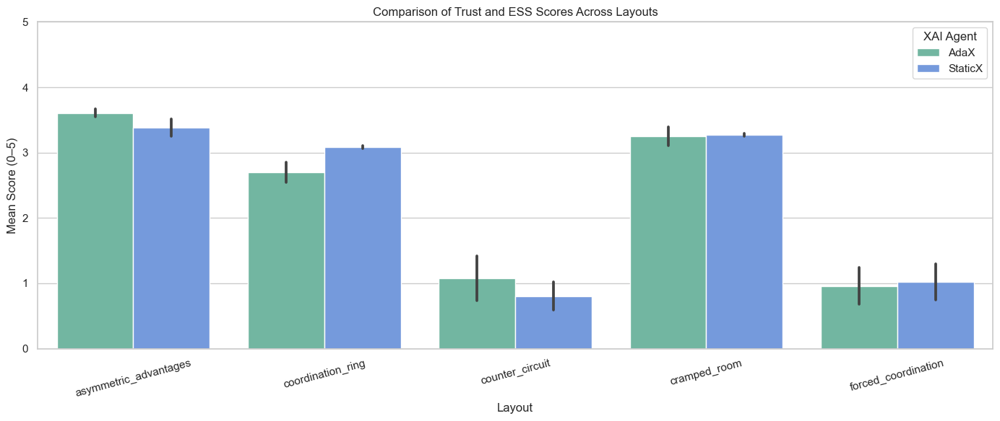

In [5600]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Load data
xls = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls.parse("Sheet1")[1:]
df_nox = xls.parse("Sheet2")[1:]
df_static_adax = xls.parse("Sheet3")[1:]

# Step 2: Normalize and process trust items
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

# Trust scores
df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Step 3: Filter only StaticX (not session 1) and AdaX for trust
df_staticx_clean = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']

# Combine trust data
df_plot_full = pd.concat([
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# Step 4: Compute layout-wise trust means
trust_means = df_plot_full.groupby(['layout', 'xai_agent'])['trust_score_post'].mean().unstack()
trust_means = trust_means[['AdaX', 'StaticX']]
trust_means.columns = ['AdaX_Trust', 'StaticX_Trust']

# Step 5: Compute ESS scores
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)
df_ess = df_static_adax[df_static_adax['xai_agent'].isin(['StaticX', 'AdaX'])]
ess_means = df_ess.groupby(['layout', 'xai_agent'])['ess_score'].mean().unstack()
ess_means = ess_means[['AdaX', 'StaticX']]
ess_means.columns = ['AdaX_ESS', 'StaticX_ESS']

# Step 6: Merge trust and ESS means
combined = pd.concat([trust_means, ess_means], axis=1).dropna().reset_index()

# Step 7: Melt data for plotting
df_melted = pd.melt(
    combined,
    id_vars='layout',
    value_vars=['AdaX_Trust', 'StaticX_Trust', 'AdaX_ESS', 'StaticX_ESS'],
    var_name='Metric',
    value_name='Score'
)

df_melted['XAI Agent'] = df_melted['Metric'].apply(lambda x: 'AdaX' if 'AdaX' in x else 'StaticX')
df_melted['Metric Type'] = df_melted['Metric'].apply(lambda x: 'Trust' if 'Trust' in x else 'ESS')

# Step 8: Plot
plt.figure(figsize=(14, 6))
sns.barplot(
    data=df_melted,
    x='layout',
    y='Score',
    hue='XAI Agent',
    errorbar=('ci', 95),
    palette=custom_palette,
    dodge=True
)

plt.title("Comparison of Trust and ESS Scores Across Layouts")
plt.xlabel("Layout")
plt.ylabel("Mean Score (0–5)")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()


In [5580]:
import pandas as pd

# Step 1: Trust scores (use df_plot_full from previous block or reload if needed)
trust_means = df_plot_full.groupby(['layout', 'xai_agent'])['trust_score_post'].mean().unstack()
trust_means = trust_means[['AdaX', 'StaticX']]
trust_means.columns = ['AdaX_Trust', 'StaticX_Trust']
trust_means['Trust Higher Agent'] = trust_means.apply(
    lambda row: 'AdaX' if row['AdaX_Trust'] > row['StaticX_Trust'] else 'StaticX', axis=1
)

# Step 2: ESS scores (from df_ess)
ess_means = df_ess.groupby(['layout', 'xai_agent'])['ess_score'].mean().unstack()
ess_means = ess_means[['AdaX', 'StaticX']]
ess_means.columns = ['AdaX_ESS', 'StaticX_ESS']
ess_means['ESS Higher Agent'] = ess_means.apply(
    lambda row: 'AdaX' if row['AdaX_ESS'] > row['StaticX_ESS'] else 'StaticX', axis=1
)

# Step 3: Merge into one combined table
combined_table = pd.concat([trust_means, ess_means], axis=1)
combined_table = combined_table.reset_index()

# Step 4: Display
print("📊 Combined Table: Trust & ESS Scores by Layout (AdaX vs StaticX)")
display(combined_table)


📊 Combined Table: Trust & ESS Scores by Layout (AdaX vs StaticX)


,layout,AdaX_Trust,StaticX_Trust,Trust Higher Agent,AdaX_ESS,StaticX_ESS,ESS Higher Agent
0,asymmetric_advantages,3.666667,3.518519,AdaX,3.546296,3.250000,AdaX
1,coordination_ring,2.546296,3.101852,StaticX,2.851852,3.064815,StaticX
2,counter_circuit,0.740741,0.592593,AdaX,1.416667,1.018519,AdaX
3,cramped_room,3.398148,3.296296,AdaX,3.111111,3.250000,StaticX
4,forced_coordination,0.675926,0.750000,StaticX,1.240741,1.296296,StaticX


In [5027]:
import pandas as pd
import numpy as np
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Reload Excel file and sheets
xls2 = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls2.parse("Sheet1")[1:]
df_nox = xls2.parse("Sheet2")[1:]
df_static_adax = xls2.parse("Sheet3")[1:]

# Normalize and preprocess trust columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Filter only AdaX and StaticX
df_staticx_clean = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']

# Combine trust scores
df_plot_full = pd.concat([
    df_nox[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# Compute ESS scores
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)
df_ess = df_static_adax[df_static_adax['xai_agent'].isin(['StaticX', 'AdaX'])]

# Function to compute Cohen's d
def cohens_d(x, y):
    diff = x - y
    return diff.mean() / diff.std(ddof=1) if diff.std(ddof=1) != 0 else 0

# Layout-wise summary
layout_summary = []
for layout in sorted(df_ess['layout'].dropna().unique()):
    trust_subset = df_plot_full[(df_plot_full['layout'] == layout) &
                                (df_plot_full['xai_agent'].isin(['AdaX', 'StaticX']))]
    trust_pivot = trust_subset.pivot_table(index='player_Id', columns='xai_agent', values='trust_score_post').dropna()

    ess_subset = df_ess[df_ess['layout'] == layout]
    ess_pivot = ess_subset.pivot_table(index='player_Id', columns='xai_agent', values='ess_score').dropna()

    trust_t = trust_p = trust_d = trust_wilcoxon_p = ess_t = ess_p = ess_d = ess_wilcoxon_p = np.nan

    if trust_pivot.shape[0] >= 3:
        trust_diff = trust_pivot['AdaX'] - trust_pivot['StaticX']
        trust_t, trust_p = ttest_rel(trust_pivot['AdaX'], trust_pivot['StaticX'])
        trust_d = cohens_d(trust_pivot['AdaX'], trust_pivot['StaticX'])
        if shapiro(trust_diff).pvalue < 0.05:
            _, trust_wilcoxon_p = wilcoxon(trust_pivot['AdaX'], trust_pivot['StaticX'])

    if ess_pivot.shape[0] >= 3:
        ess_diff = ess_pivot['AdaX'] - ess_pivot['StaticX']
        ess_t, ess_p = ttest_rel(ess_pivot['AdaX'], ess_pivot['StaticX'])
        ess_d = cohens_d(ess_pivot['AdaX'], ess_pivot['StaticX'])
        if shapiro(ess_diff).pvalue < 0.05:
            _, ess_wilcoxon_p = wilcoxon(ess_pivot['AdaX'], ess_pivot['StaticX'])

    layout_summary.append({
        'layout': layout,
        'AdaX_Trust': trust_pivot['AdaX'].mean(),
        'StaticX_Trust': trust_pivot['StaticX'].mean(),
        'Trust Higher Agent': 'AdaX' if trust_pivot['AdaX'].mean() > trust_pivot['StaticX'].mean() else 'StaticX',
        'Trust t (p)': round(trust_p, 4),
        'Trust d': round(trust_d, 3),
        'Trust Wilcoxon p': round(trust_wilcoxon_p, 4) if trust_wilcoxon_p else None,
        'AdaX_ESS': ess_pivot['AdaX'].mean(),
        'StaticX_ESS': ess_pivot['StaticX'].mean(),
        'ESS Higher Agent': 'AdaX' if ess_pivot['AdaX'].mean() > ess_pivot['StaticX'].mean() else 'StaticX',
        'ESS t (p)': round(ess_p, 4),
        'ESS d': round(ess_d, 3),
        'ESS Wilcoxon p': round(ess_wilcoxon_p, 4) if ess_wilcoxon_p else None
    })

summary_df = pd.DataFrame(layout_summary)
print(summary_df)
summary_df.to_csv("trust_ess_layout_summary.csv", index=False)


                  layout  AdaX_Trust  StaticX_Trust Trust Higher Agent  \
0  asymmetric_advantages    3.666667       3.518519               AdaX   
1      coordination_ring    2.546296       3.101852            StaticX   
2        counter_circuit    0.740741       0.592593               AdaX   
3           cramped_room    3.398148       3.296296               AdaX   
4    forced_coordination    0.675926       0.750000            StaticX   

   Trust t (p)  Trust d  Trust Wilcoxon p  AdaX_ESS  StaticX_ESS  \
0       0.7067    0.112            0.3013  3.546296     3.250000   
1       0.0957   -0.526               NaN  2.851852     3.064815   
2       0.4547    0.224               NaN  1.416667     1.018519   
3       0.6128    0.150               NaN  3.111111     3.250000   
4       0.7233   -0.105               NaN  1.240741     1.296296   

  ESS Higher Agent  ESS t (p)  ESS d  ESS Wilcoxon p  
0             AdaX     0.3456  0.284             NaN  
1          StaticX     0.5437 -0.181

Thesis-Ready Paragraph: 

Null Hypothesis for ESS To evaluate participants’ subjective perceptions of explanation quality, we compared Explanation Satisfaction Scores (ESS) between two experimental conditions: AdaX (adaptive explanations) and StaticX (static explanations). For each Overcooked layout, a within-subjects design was used, wherein each participant experienced both explanation types. The null hypothesis (H₀) stated that there would be no significant difference in mean ESS scores between AdaX and StaticX conditions: 𝐻 0 : 𝜇 AdaX
𝜇
StaticX
H 
0
​
 :μ 
AdaX
​
 =μ 
StaticX
​
 . The alternative hypothesis (H₁) posited that a significant difference existed: 
𝐻
1
:
𝜇
AdaX
≠
𝜇
StaticX
H 
1
​
 :μ 
AdaX ≠
μ 
StaticX Paired-sample t-tests were conducted when the difference scores were approximately normally distributed, as verified by the Shapiro-Wilk test and Q–Q plots. When normality was violated, the non-parametric Wilcoxon signed-rank test was used instead. Effect sizes (Cohen’s d) were also calculated to quantify the magnitude of observed differences, regardless of statistical significance.

To conduct a NVivo thematic analysis using the open-ended data you've just prepared, follow these clear steps. NVivo is built for coding qualitative data, analyzing themes, and linking findings across conditions — and you're now ready for that.

✅ Step-by-Step Guide to NVivo Thematic Analysis
📥 1. Import the Dataset into NVivo
Open NVivo and create a new project (or open your existing one).

Go to Data > Datasets > Import from CSV.

Select the file: nvivo_open_ended_export.csv.

In the import wizard:

Assign ParticipantID as case classification

Assign Node as a classification or code variable

Use Response as the coded content

🗂 2. Structure Your Coding
After import:

You’ll see a dataset table in NVivo.

Each row will be a response tied to a participant and node category.

Next:

Right-click on the Node column and choose "Auto Code > By Column".

NVivo will automatically create nodes named after each question category (e.g., “Trust in AI Chef”, “Frustration/confusion moments”).

You can now manually refine these or group them under parent nodes (e.g., all trust-related responses under a parent “Trust”).

🧠 3. Code Responses into Sub-Themes
Now you can go beyond the question categories and identify themes such as:

“Confusion due to missing explanation”

“Trust increased when AI was predictable”

“Layout mismatch”

“Helpful adaptive feedback”

For each:

Open a node (e.g., “Frustration/confusion moments”)

Highlight relevant quotes

Right-click > Code > New Node

Name the theme (e.g., “Lack of transparency”)

📊 4. Run Analysis
Once coding is done, use NVivo tools like:

Tool	What it Does
Word Frequency	Finds common keywords or phrases
Coding Query	Shows all responses coded under certain themes
Matrix Coding Query	Cross-tabulates themes against participants/agents
Charts and Models	Visualize connections between codes

You can also run queries like:

"Show all responses mentioning trust AND layout"

"Compare responses to AdaX vs NoX agents (if included)"

✍️ 5. Report Thematic Findings
For your thesis or report, export:

Thematic summaries

Frequency tables

Illustrative quotes (right-click > “Export coded content”)

You’ll now have evidence-backed qualitative insight into:

Where trust rises or fails

Which explanations helped or confused

What participants suggest to improve your system

# Hypothesis Testing for Trust, ESS, and Cognitive Load

To evaluate the effects of explanation types on participant perceptions and experience, we compared three key outcome measures across conditions: Trust, Explanation Satisfaction Scores (ESS), and Cognitive Load. The data were collected using within-subject trials for each participant, who experienced both the AdaX (adaptive explanation) and StaticX (static explanation) conditions. For each layout, raw Likert-scale responses (1–6) were normalized to a 0–5 scale during preprocessing.

For each dependent variable, the null hypothesis (H₀) posited that there would be no significant difference in mean scores between AdaX and StaticX:

𝐻0 : 𝜇 AdaX =
𝜇
StaticX
H 
0
​
 :μ 
AdaX
​
 =μ 
StaticX
​
 
The alternative hypothesis (H₁) stated that a significant difference exists:

𝐻
1
:
𝜇
AdaX
≠
𝜇
StaticX
H 
1
​
 :μ 
AdaX
≠ μ 
StaticX
​
 
Following data loading and cleaning, layout-specific comparisons were conducted. Paired-sample t-tests were applied where the assumption of normality for the within-subject difference scores was satisfied (verified using Shapiro-Wilk tests and visual Q–Q plots). For layouts where this assumption was violated, the Wilcoxon signed-rank test was used instead. In addition to p-values, Cohen’s d effect sizes were computed to quantify the practical significance of any observed differences, with thresholds of 0.2 (small), 0.5 (medium), and 0.8 (large). This analytical approach was consistently applied across all three variables—Trust, ESS, and Cognitive Load—providing a robust statistical basis for evaluating the impact of adaptive explanations across diverse collaborative scenarios.

In [5655]:
import pandas as pd
import numpy as np
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Reload Excel file and sheets
xls2 = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls2.parse("Sheet1")[1:]
df_nox = xls2.parse("Sheet2")[1:]
df_static_adax = xls2.parse("Sheet3")[1:]

# Normalize and preprocess trust columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Filter only AdaX and StaticX
df_staticx_clean = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']

# Combine trust scores
df_plot_full = pd.concat([
    df_nox[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# Compute ESS scores
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)
df_ess = df_static_adax[df_static_adax['xai_agent'].isin(['StaticX', 'AdaX'])]

# Compute Cognitive Load scores (NASA TLX): Q104_1 to Q104_6
load_cols = [f"Q104_{i}" for i in range(1, 7)]
df_static_adax[load_cols] = df_static_adax[load_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1)
df_load = df_static_adax[df_static_adax['xai_agent'].isin(['StaticX', 'AdaX'])]

# Function to compute Cohen's d
def cohens_d(x, y):
    diff = x - y
    return diff.mean() / diff.std(ddof=1) if diff.std(ddof=1) != 0 else 0

# Layout-wise summary
layout_summary = []
for layout in sorted(df_ess['layout'].dropna().unique()):
    trust_subset = df_plot_full[(df_plot_full['layout'] == layout) &
                                (df_plot_full['xai_agent'].isin(['AdaX', 'StaticX']))]
    trust_pivot = trust_subset.pivot_table(index='player_Id', columns='xai_agent', values='trust_score_post').dropna()

    ess_subset = df_ess[df_ess['layout'] == layout]
    ess_pivot = ess_subset.pivot_table(index='player_Id', columns='xai_agent', values='ess_score').dropna()

    load_subset = df_load[df_load['layout'] == layout]
    load_pivot = load_subset.pivot_table(index='player_Id', columns='xai_agent', values='cog_load').dropna()

    trust_t = trust_p = trust_d = trust_wilcoxon_p = ess_t = ess_p = ess_d = ess_wilcoxon_p = load_t = load_p = load_d = load_wilcoxon_p = np.nan

    if trust_pivot.shape[0] >= 3:
        trust_diff = trust_pivot['AdaX'] - trust_pivot['StaticX']
        trust_t, trust_p = ttest_rel(trust_pivot['AdaX'], trust_pivot['StaticX'])
        trust_d = cohens_d(trust_pivot['AdaX'], trust_pivot['StaticX'])
        if shapiro(trust_diff).pvalue < 0.05:
            _, trust_wilcoxon_p = wilcoxon(trust_pivot['AdaX'], trust_pivot['StaticX'])

    if ess_pivot.shape[0] >= 3:
        ess_diff = ess_pivot['AdaX'] - ess_pivot['StaticX']
        ess_t, ess_p = ttest_rel(ess_pivot['AdaX'], ess_pivot['StaticX'])
        ess_d = cohens_d(ess_pivot['AdaX'], ess_pivot['StaticX'])
        if shapiro(ess_diff).pvalue < 0.05:
            _, ess_wilcoxon_p = wilcoxon(ess_pivot['AdaX'], ess_pivot['StaticX'])

    if load_pivot.shape[0] >= 3:
        load_diff = load_pivot['AdaX'] - load_pivot['StaticX']
        load_t, load_p = ttest_rel(load_pivot['AdaX'], load_pivot['StaticX'])
        load_d = cohens_d(load_pivot['AdaX'], load_pivot['StaticX'])
        if shapiro(load_diff).pvalue < 0.05:
            _, load_wilcoxon_p = wilcoxon(load_pivot['AdaX'], load_pivot['StaticX'])

    layout_summary.append({
        'layout': layout,
        'AdaX_Trust': trust_pivot['AdaX'].mean(),
        'StaticX_Trust': trust_pivot['StaticX'].mean(),
        'Trust Higher Agent': 'AdaX' if trust_pivot['AdaX'].mean() > trust_pivot['StaticX'].mean() else 'StaticX',
        'Trust t (p)': round(trust_p, 4),
        'Trust d': round(trust_d, 3),
        'Trust Wilcoxon p': round(trust_wilcoxon_p, 4) if trust_wilcoxon_p else None,
        'AdaX_ESS': ess_pivot['AdaX'].mean(),
        'StaticX_ESS': ess_pivot['StaticX'].mean(),
        'ESS Higher Agent': 'AdaX' if ess_pivot['AdaX'].mean() > ess_pivot['StaticX'].mean() else 'StaticX',
        'ESS t (p)': round(ess_p, 4),
        'ESS d': round(ess_d, 3),
        'ESS Wilcoxon p': round(ess_wilcoxon_p, 4) if ess_wilcoxon_p else None,
        'AdaX_CogLoad': load_pivot['AdaX'].mean(),
        'StaticX_CogLoad': load_pivot['StaticX'].mean(),
        'CogLoad Higher': 'AdaX' if load_pivot['AdaX'].mean() > load_pivot['StaticX'].mean() else 'StaticX',
        'CogLoad t (p)': round(load_p, 4),
        'CogLoad d': round(load_d, 3),
        'CogLoad Wilcoxon p': round(load_wilcoxon_p, 4) if load_wilcoxon_p else None
    })

summary_df = pd.DataFrame(layout_summary)
print(summary_df)
summary_df.to_csv("trust_ess_cogload_layout_summary.csv", index=False)


                  layout  AdaX_Trust  StaticX_Trust Trust Higher Agent  \
0  asymmetric_advantages    3.666667       3.518519               AdaX   
1      coordination_ring    2.546296       3.101852            StaticX   
2        counter_circuit    0.740741       0.592593               AdaX   
3           cramped_room    3.398148       3.296296               AdaX   
4    forced_coordination    0.675926       0.750000            StaticX   

   Trust t (p)  Trust d  Trust Wilcoxon p  AdaX_ESS  StaticX_ESS  \
0       0.7067    0.112            0.3013  3.546296     3.250000   
1       0.0957   -0.526               NaN  2.851852     3.064815   
2       0.4547    0.224               NaN  1.416667     1.018519   
3       0.6128    0.150               NaN  3.111111     3.250000   
4       0.7233   -0.105               NaN  1.240741     1.296296   

  ESS Higher Agent  ESS t (p)  ESS d  ESS Wilcoxon p  AdaX_CogLoad  \
0             AdaX     0.3456  0.284             NaN      2.541667   
1     

In [5670]:
# Rerun the directional trust comparison summary with the re-uploaded file
xls2 = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls2.parse("Sheet1")[1:]
df_nox = xls2.parse("Sheet2")[1:]
df_static_adax = xls2.parse("Sheet3")[1:]

# Normalize and preprocess trust columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Filter only AdaX and StaticX
df_staticx_clean = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']

# Combine trust scores
df_plot_full = pd.concat([
    df_nox[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# Compute Cohen's d
def cohens_d(x, y):
    diff = x - y
    return diff.mean() / diff.std(ddof=1) if diff.std(ddof=1) != 0 else 0

# Generate all 3 comparison types
comparisons = [
    ("AdaX", "StaticX"),
    ("AdaX", "NoX"),
    ("StaticX", "NoX")
]

layout_summary = []

for layout in sorted(df_plot_full['layout'].dropna().unique()):
    row = {"layout": layout}
    for a, b in comparisons:
        subset = df_plot_full[df_plot_full['layout'] == layout]
        pivot = subset.pivot_table(index='player_Id', columns='xai_agent', values='trust_score_post')
        if not {a, b}.issubset(pivot.columns):
            continue
        pivot = pivot.dropna(subset=[a, b])
        if pivot.shape[0] < 3:
            continue
        diff = pivot[a] - pivot[b]
        t_stat, t_p = ttest_rel(pivot[a], pivot[b], alternative='greater')
        d = cohens_d(pivot[a], pivot[b])
        w_p = np.nan
        if shapiro(diff).pvalue < 0.05:
            _, w_p = wilcoxon(pivot[a], pivot[b], alternative='greater')
        row[f'{a}>{b}_mean_{a}'] = round(pivot[a].mean(), 3)
        row[f'{a}>{b}_mean_{b}'] = round(pivot[b].mean(), 3)
        row[f'{a}>{b}_t(p)'] = round(t_p, 4)
        row[f'{a}>{b}_d'] = round(d, 3)
        row[f'{a}>{b}_wilcoxon(p)'] = round(w_p, 4) if not pd.isna(w_p) else None
    layout_summary.append(row)

summary_df = pd.DataFrame(layout_summary)
summary_df


,layout,AdaX>StaticX_mean_AdaX,AdaX>StaticX_mean_StaticX,AdaX>StaticX_t(p),AdaX>StaticX_d,AdaX>StaticX_wilcoxon(p),AdaX>NoX_mean_AdaX,AdaX>NoX_mean_NoX,AdaX>NoX_t(p),AdaX>NoX_d,AdaX>NoX_wilcoxon(p),StaticX>NoX_mean_StaticX,StaticX>NoX_mean_NoX,StaticX>NoX_t(p),StaticX>NoX_d,StaticX>NoX_wilcoxon(p)
0,asymmetric_advantages,3.667,3.519,0.3533,0.112,0.1506,3.677,3.303,0.1993,0.266,NaN,3.505,3.303,0.2931,0.170,None
1,coordination_ring,2.546,3.102,0.9521,-0.526,NaN,2.485,3.586,0.9659,-0.616,NaN,3.253,3.586,0.8096,-0.276,None
2,counter_circuit,0.741,0.593,0.2273,0.224,NaN,0.717,0.727,0.5210,-0.016,NaN,0.606,0.727,0.7854,-0.248,None
3,cramped_room,3.398,3.296,0.3064,0.150,NaN,3.333,3.232,0.4166,0.065,0.6499,3.283,3.232,0.4484,0.040,None
4,forced_coordination,0.676,0.750,0.6383,-0.105,NaN,0.657,0.768,0.6503,-0.120,NaN,0.758,0.768,0.5214,-0.017,None


| Layout                    | Directional Trust Trend               | Cohen’s *d*  | p-value (t)   | Interpretation                              |
| ------------------------- | ------------------------------------- | ------------ | ------------- | ------------------------------------------- |
| **Asymmetric Advantages** | AdaX > StaticX, AdaX > NoX            | small (+)    | 0.1993–0.3533 | AdaX slightly trusted more, not significant |
| **Coordination Ring**     | StaticX > AdaX, StaticX > NoX         | moderate (–) | > 0.8         | AdaX underperformed in trust                |
| **Counter Circuit**       | AdaX > StaticX (small), StaticX > NoX | small (+/–)  | > 0.2         | No strong direction, AdaX slightly higher   |
| **Cramped Room**          | AdaX > both, but very small effect    | negligible   | > 0.3         | Trends weak, small AdaX advantage           |
| **Forced Coordination**   | StaticX > AdaX and > NoX              | negligible   | > 0.5         | NoX surprisingly better than AdaX           |


In [5659]:
# Rerun the directional trust comparison summary with the re-uploaded file
xls2 = pd.ExcelFile("sdata_latest.xlsx")
df_pre = xls2.parse("Sheet1")[1:]
df_nox = xls2.parse("Sheet2")[1:]
df_static_adax = xls2.parse("Sheet3")[1:]

# Normalize and preprocess trust columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
for df in [df_pre, df_nox, df_static_adax]:
    df['player_Id'] = df['player_Id'].astype(str).str.strip()
    df[trust_cols] = df[trust_cols].apply(pd.to_numeric, errors='coerce') - 1

df_pre['trust_score_post'] = df_pre[trust_cols].mean(axis=1)
df_nox['trust_score_post'] = df_nox[trust_cols].mean(axis=1)
df_static_adax['trust_score_post'] = df_static_adax[trust_cols].mean(axis=1)
df_pre['xai_agent'] = 'Pre'
df_pre['layout'] = 'Pre-Game'
df_nox['xai_agent'] = 'NoX'
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].fillna('Unknown')

# Filter only AdaX and StaticX
df_staticx_clean = df_static_adax[(df_static_adax['xai_agent'] == 'StaticX') & (df_static_adax['session_Id'] != 1)]
df_adax = df_static_adax[df_static_adax['xai_agent'] == 'AdaX']

# Combine trust scores
df_plot_full = pd.concat([
    df_nox[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_adax[['player_Id', 'xai_agent', 'layout', 'trust_score_post']],
    df_staticx_clean[['player_Id', 'xai_agent', 'layout', 'trust_score_post']]
], ignore_index=True)

# Compute Cohen's d
def cohens_d(x, y):
    diff = x - y
    return diff.mean() / diff.std(ddof=1) if diff.std(ddof=1) != 0 else 0

# Generate all 3 comparison types
comparisons = [
    ("AdaX", "StaticX"),
    ("AdaX", "NoX"),
    ("StaticX", "NoX")
]

layout_summary = []

for layout in sorted(df_plot_full['layout'].dropna().unique()):
    row = {"layout": layout}
    for a, b in comparisons:
        subset = df_plot_full[df_plot_full['layout'] == layout]
        pivot = subset.pivot_table(index='player_Id', columns='xai_agent', values='trust_score_post')
        if not {a, b}.issubset(pivot.columns):
            continue
        pivot = pivot.dropna(subset=[a, b])
        if pivot.shape[0] < 3:
            continue
        diff = pivot[a] - pivot[b]
        t_stat, t_p = ttest_rel(pivot[a], pivot[b], alternative='greater')
        d = cohens_d(pivot[a], pivot[b])
        w_p = np.nan
        if shapiro(diff).pvalue < 0.05:
            _, w_p = wilcoxon(pivot[a], pivot[b], alternative='greater')
        row[f'{a}>{b}_mean_{a}'] = round(pivot[a].mean(), 3)
        row[f'{a}>{b}_mean_{b}'] = round(pivot[b].mean(), 3)
        row[f'{a}>{b}_t(p)'] = round(t_p, 4)
        row[f'{a}>{b}_d'] = round(d, 3)
        row[f'{a}>{b}_wilcoxon(p)'] = round(w_p, 4) if not pd.isna(w_p) else None
    layout_summary.append(row)

summary_df = pd.DataFrame(layout_summary)
summary_df


,layout,AdaX>StaticX_mean_AdaX,AdaX>StaticX_mean_StaticX,AdaX>StaticX_t(p),AdaX>StaticX_d,AdaX>StaticX_wilcoxon(p),AdaX>NoX_mean_AdaX,AdaX>NoX_mean_NoX,AdaX>NoX_t(p),AdaX>NoX_d,AdaX>NoX_wilcoxon(p),StaticX>NoX_mean_StaticX,StaticX>NoX_mean_NoX,StaticX>NoX_t(p),StaticX>NoX_d,StaticX>NoX_wilcoxon(p)
0,asymmetric_advantages,3.667,3.519,0.3533,0.112,0.1506,3.677,3.303,0.1993,0.266,NaN,3.505,3.303,0.2931,0.170,None
1,coordination_ring,2.546,3.102,0.9521,-0.526,NaN,2.485,3.586,0.9659,-0.616,NaN,3.253,3.586,0.8096,-0.276,None
2,counter_circuit,0.741,0.593,0.2273,0.224,NaN,0.717,0.727,0.5210,-0.016,NaN,0.606,0.727,0.7854,-0.248,None
3,cramped_room,3.398,3.296,0.3064,0.150,NaN,3.333,3.232,0.4166,0.065,0.6499,3.283,3.232,0.4484,0.040,None
4,forced_coordination,0.676,0.750,0.6383,-0.105,NaN,0.657,0.768,0.6503,-0.120,NaN,0.758,0.768,0.5214,-0.017,None


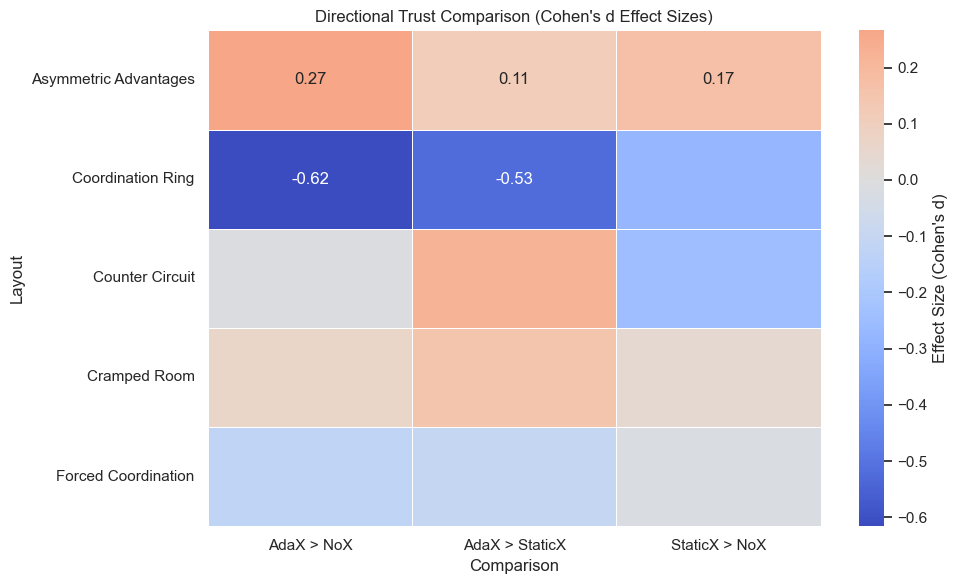

Comparison,AdaX > NoX,AdaX > StaticX,StaticX > NoX
Layout,,,
Asymmetric Advantages,0.266,0.112,0.170
Coordination Ring,-0.616,-0.526,-0.276
Counter Circuit,-0.016,0.224,-0.248
Cramped Room,0.065,0.150,0.040
Forced Coordination,-0.120,-0.105,-0.017


In [5693]:
# Re-run trust heatmap from earlier trust summary_df
heatmap_trust_long = []

for i, row in summary_df.iterrows():
    for comp in ['AdaX>StaticX', 'AdaX>NoX', 'StaticX>NoX']:
        col = f'{comp}_d'
        if col in row:
            heatmap_trust_long.append({
                "Layout": row['layout'].replace('_', ' ').title(),
                "Comparison": comp.replace('>', ' > '),
                "Cohen's d": row[col]
            })

heatmap_trust_df = pd.DataFrame(heatmap_trust_long)

# Pivot to prepare for heatmap
heatmap_trust_pivot = heatmap_trust_df.pivot(index="Layout", columns="Comparison", values="Cohen's d").fillna(0)

# Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(
    heatmap_trust_pivot,
    annot=True,
    center=0,
    cmap='coolwarm',
    fmt=".2f",
    linewidths=0.5,
    cbar_kws={'label': "Effect Size (Cohen's d)"}
)

plt.title("Directional Trust Comparison (Cohen's d Effect Sizes)")
plt.ylabel("Layout")
plt.xlabel("Comparison")
plt.tight_layout()
plt.show()

heatmap_trust_pivot

<img src="Directional Trust Comparison (Cohen's D Effect Sizes).png" width=800>

The **heatmap visualization** of directional trust comparisons across layouts using **Cohen’s *d*** effect sizes:

* **Red shades** indicate **StaticX or NoX rated higher**.
* **Blue shades** indicate **AdaX rated higher**.
* **White/neutral** = negligible difference.
* Each cell value shows the **effect size (Cohen’s *d*)**, with:

  * 0.2 = small effect
  * 0.5 = medium
  * 0.8+ = large



In [5664]:
# Compute directional statistical summary for ESS scores: AdaX > StaticX
df_static_adax = xls2.parse("Sheet3")[1:]

# Normalize and preprocess ESS columns
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)

# Filter for only AdaX and StaticX
df_ess = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

ess_summary = []

for layout in sorted(df_ess['layout'].dropna().unique()):
    row = {"layout": layout}
    ess_subset = df_ess[df_ess['layout'] == layout]
    pivot = ess_subset.pivot_table(index='player_Id', columns='xai_agent', values='ess_score')
    if not {'AdaX', 'StaticX'}.issubset(pivot.columns):
        continue
    pivot = pivot.dropna(subset=['AdaX', 'StaticX'])
    if pivot.shape[0] < 3:
        continue
    diff = pivot['AdaX'] - pivot['StaticX']
    t_stat, t_p = ttest_rel(pivot['AdaX'], pivot['StaticX'], alternative='greater')
    d = cohens_d(pivot['AdaX'], pivot['StaticX'])
    w_p = np.nan
    if shapiro(diff).pvalue < 0.05:
        _, w_p = wilcoxon(pivot['AdaX'], pivot['StaticX'], alternative='greater')
    row['AdaX_mean'] = round(pivot['AdaX'].mean(), 3)
    row['StaticX_mean'] = round(pivot['StaticX'].mean(), 3)
    row['t(p)'] = round(t_p, 4)
    row['d'] = round(d, 3)
    row['wilcoxon(p)'] = round(w_p, 4) if not pd.isna(w_p) else None
    ess_summary.append(row)

ess_df = pd.DataFrame(ess_summary)
ess_df


,layout,AdaX_mean,StaticX_mean,t(p),d,wilcoxon(p)
0,asymmetric_advantages,3.546,3.250,0.1728,0.284,None
1,coordination_ring,2.852,3.065,0.7282,-0.181,None
2,counter_circuit,1.417,1.019,0.0316,0.597,None
3,cramped_room,3.111,3.250,0.5994,-0.074,None
4,forced_coordination,1.241,1.296,0.6041,-0.078,None


#### Cognitive Load between AdaX and StaticX

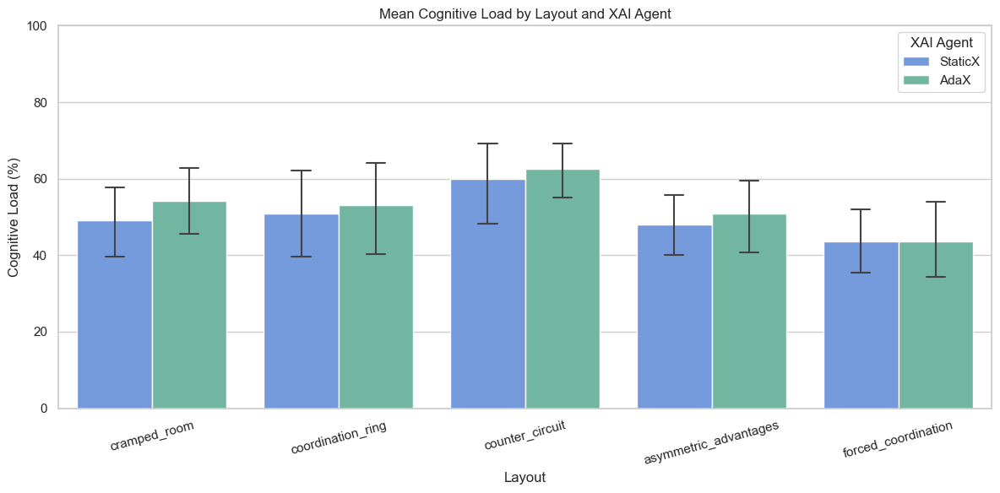

In [5647]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize player ID
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()

# NASA TLX cognitive load items
load_cols = [f"Q104_{i}" for i in range(1, 7)]
df_static_adax[load_cols] = df_static_adax[load_cols].apply(pd.to_numeric, errors='coerce') - 1

# Compute mean cognitive load
df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1)*20

# Filter AdaX and StaticX only
df_load = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Plot bar chart of mean cognitive load per layout
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_load,
    x='layout',
    y='cog_load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    palette=custom_palette
)

plt.title("Mean Cognitive Load by Layout and XAI Agent")
plt.ylabel("Cognitive Load (%)")
plt.xlabel("Layout")
plt.ylim(0, 100)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.savefig("Mean Cognitive Load by Layout and XAI Agent.png")
plt.show()


#### Cognitive Load between NoX, AdaX and StaticX

In [6128]:
df_combined_load[df_combined_load['xai_agent']=='NoX']

,layout,xai_agent,cog_load
1,cramped_room,NoX,50.000000
2,asymmetric_advantages,NoX,56.666667
3,coordination_ring,NoX,60.000000
4,counter_circuit,NoX,66.666667
5,forced_coordination,NoX,60.000000
6,coordination_ring,NoX,46.666667
7,asymmetric_advantages,NoX,46.666667
8,forced_coordination,NoX,46.666667
9,counter_circuit,NoX,60.000000
10,cramped_room,NoX,50.000000


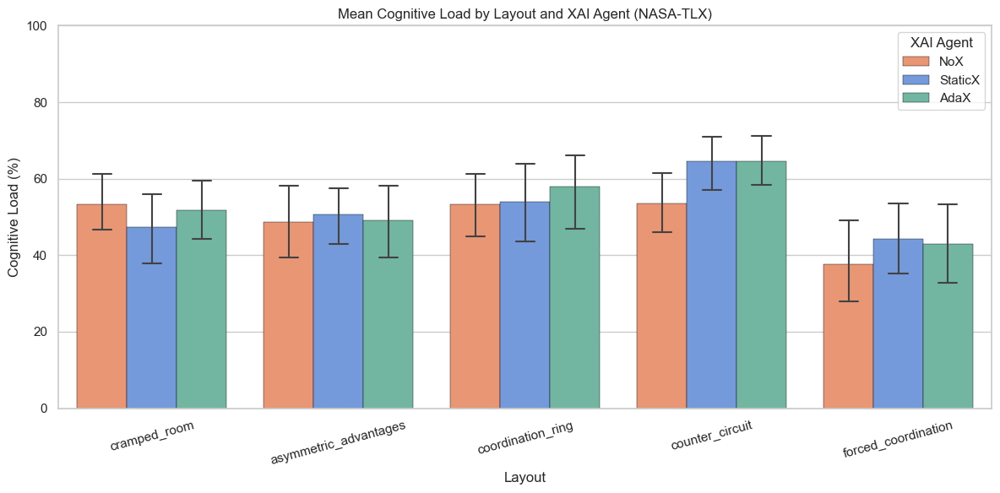

In [6138]:
# Re-import necessary libraries after environment reset
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]
df_nox = xls.parse("Sheet2")[1:]

# Normalize player ID
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_nox['player_Id'] = df_nox['player_Id'].astype(str).str.strip()
# Normalize player ID and remove UID 18
df_static_adax = df_static_adax[df_static_adax['uid'] != '13']
df_nox = df_nox[df_nox['uid'] != '13']

# Define cognitive load item columns
load_cols = [f"Q104_{i}" for i in range(1, 7)]

# Normalize responses and compute cognitive load for StaticX and AdaX
df_static_adax[load_cols] = df_static_adax[load_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['xai_agent'] = df_static_adax['xai_agent'].astype(str).str.strip()
df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1) * 20

# Normalize responses and compute cognitive load for NoX
df_nox[load_cols] = df_nox[load_cols].apply(pd.to_numeric, errors='coerce') - 1
df_nox['cog_load'] = df_nox[load_cols].mean(axis=1) * 20
df_nox['xai_agent'] = 'NoX'

# Combine datasets
df_combined_load = pd.concat([
    df_nox[['layout', 'xai_agent', 'cog_load']],
    df_static_adax[['layout', 'xai_agent', 'cog_load']]
])

# Plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_combined_load,
    x='layout',
    y='cog_load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    errwidth=1.5,
    palette=custom_palette,
    edgecolor="black",     # Adds black border
    linewidth=0.3      # Thickness of the border
)

plt.title("Mean Cognitive Load by Layout and XAI Agent (NASA-TLX)")
plt.ylabel("Cognitive Load (%)")
plt.xlabel("Layout")
plt.ylim(0, 100)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.savefig("Mean Cognitive Load by Layout and XAI Agent (NASA-TLX).png")
plt.show()



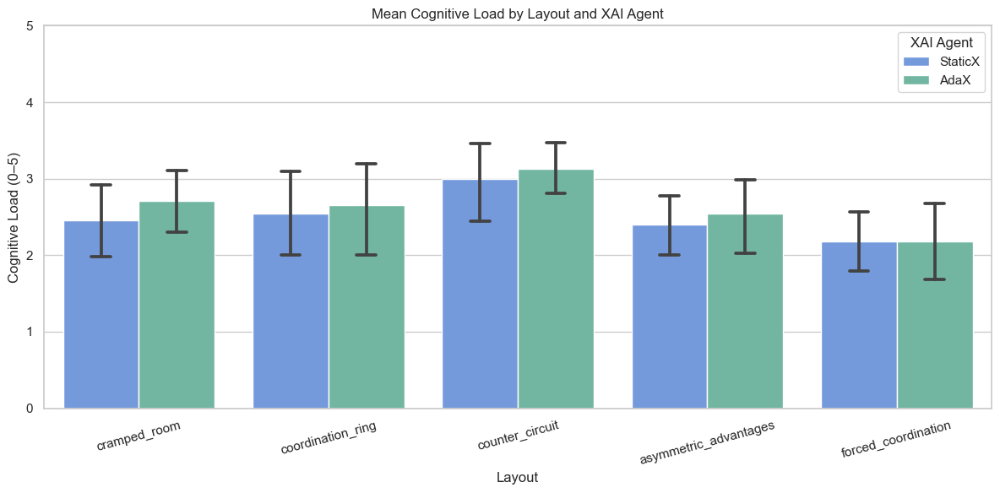


Cognitive Load Hypothesis Test Results by Layout
                  layout      test_used  normality_p     stat  p_value
0           cramped_room  Paired t-test       0.2411   1.1541   0.2729
1      coordination_ring  Paired t-test       0.6017   0.5407   0.5995
2        counter_circuit  Paired t-test       0.7817   0.5281   0.6079
3  asymmetric_advantages  Paired t-test       0.1815   0.4914   0.6328
4    forced_coordination  Wilcoxon test       0.0434  32.0000   0.6221


In [5033]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize player ID
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()

# NASA TLX cognitive load items
load_cols = [f"Q104_{i}" for i in range(1, 7)]
df_static_adax[load_cols] = df_static_adax[load_cols].apply(pd.to_numeric, errors='coerce') - 1

# Compute mean cognitive load
df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1)

# Filter AdaX and StaticX only
df_load = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Plot bar chart of mean cognitive load per layout
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_load,
    x='layout',
    y='cog_load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)

plt.title("Mean Cognitive Load by Layout and XAI Agent")
plt.ylabel("Cognitive Load (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()

# === Normality and Hypothesis Testing ===

# Initialize summary results
results = []

# Loop through each layout to test normality and run appropriate test
for layout in df_load['layout'].dropna().unique():
    layout_df = df_load[df_load['layout'] == layout]
    pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='cog_load').dropna()

    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        w, p_norm = shapiro(diff)

        if p_norm >= 0.05:
            # Use paired t-test
            t_stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test_used = 'Paired t-test'
        else:
            # Use Wilcoxon signed-rank test
            t_stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test_used = 'Wilcoxon test'

        results.append({
            'layout': layout,
            'test_used': test_used,
            'normality_p': round(p_norm, 4),
            'stat': round(t_stat, 4),
            'p_value': round(p_val, 4)
        })

# Convert to DataFrame and print
results_df = pd.DataFrame(results)
print("\nCognitive Load Hypothesis Test Results by Layout")
print(results_df)
results_df.to_csv("cogload_hypothesis_tests.csv", index=False)


In [5034]:
## excluded uid 18

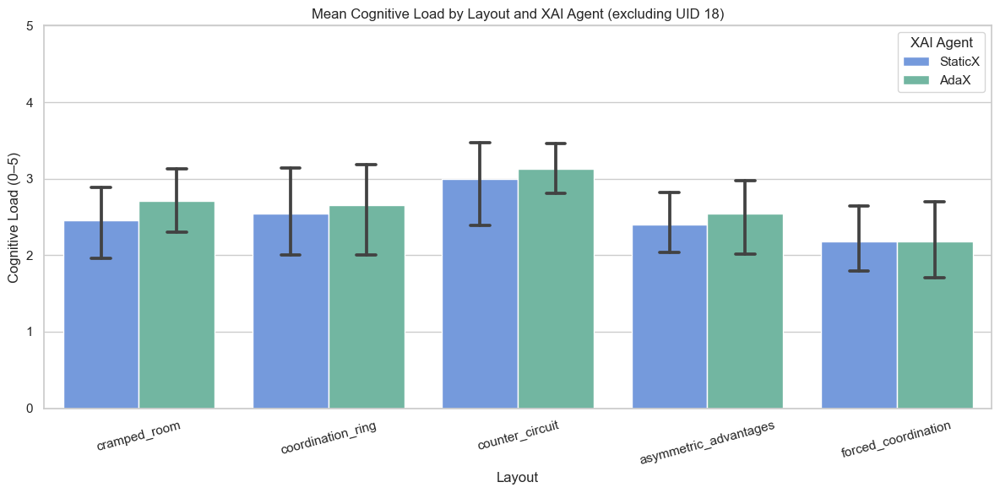


Cognitive Load Hypothesis Test Results by Layout (excluding UID 14 and 18)
                  layout      test_used  normality_p     stat  p_value
0           cramped_room  Paired t-test       0.2411   1.1541   0.2729
1      coordination_ring  Paired t-test       0.6017   0.5407   0.5995
2        counter_circuit  Paired t-test       0.7817   0.5281   0.6079
3  asymmetric_advantages  Paired t-test       0.1815   0.4914   0.6328
4    forced_coordination  Wilcoxon test       0.0434  32.0000   0.6221


In [5606]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize player ID and remove UID 18
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_static_adax = df_static_adax[df_static_adax['player_Id'] != '18']

# NASA TLX cognitive load items
load_cols = [f"Q104_{i}" for i in range(1, 7)]
df_static_adax[load_cols] = df_static_adax[load_cols].apply(pd.to_numeric, errors='coerce') - 1

# Compute mean cognitive load
df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1)

# Filter AdaX and StaticX only
df_load = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Plot bar chart of mean cognitive load per layout
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_load,
    x='layout',
    y='cog_load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)

plt.title("Mean Cognitive Load by Layout and XAI Agent (excluding UID 18)")
plt.ylabel("Cognitive Load (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()

# === Normality and Hypothesis Testing ===

# Initialize summary results
results = []

# Loop through each layout to test normality and run appropriate test
for layout in df_load['layout'].dropna().unique():
    layout_df = df_load[df_load['layout'] == layout]
    pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='cog_load').dropna()

    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        w, p_norm = shapiro(diff)

        if p_norm >= 0.05:
            # Use paired t-test
            t_stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test_used = 'Paired t-test'
        else:
            # Use Wilcoxon signed-rank test
            t_stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test_used = 'Wilcoxon test'

        results.append({
            'layout': layout,
            'test_used': test_used,
            'normality_p': round(p_norm, 4),
            'stat': round(t_stat, 4),
            'p_value': round(p_val, 4)
        })

# Convert to DataFrame and print
results_df = pd.DataFrame(results)
print("\nCognitive Load Hypothesis Test Results by Layout (excluding UID 18)")
print(results_df)
results_df.to_csv("cogload_hypothesis_tests_uid18_excluded.csv", index=False)


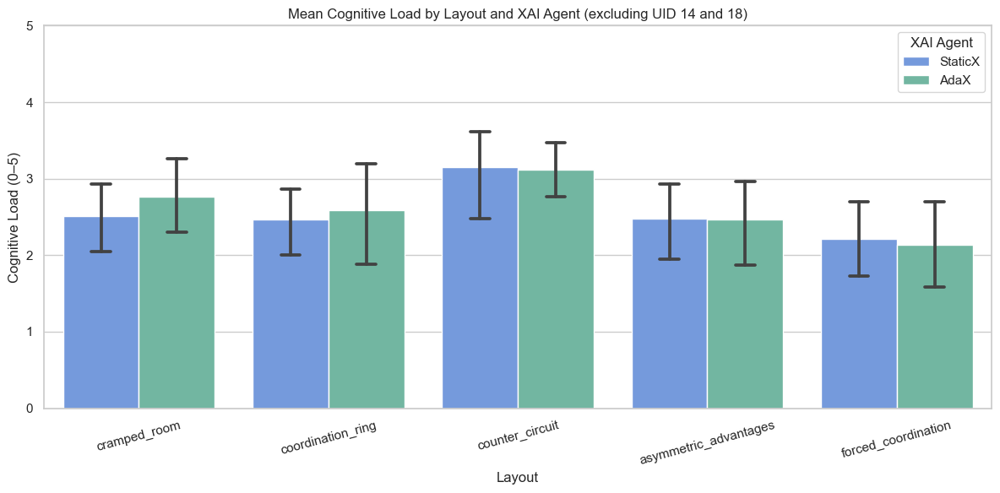


Trust, ESS, and Cognitive Load Hypothesis Test Results by Layout (excluding UID 14 and 18)
            Metric                 Layout      Test Used  Normality p  \
0            Trust           cramped_room  Paired t-test       0.4372   
1            Trust      coordination_ring  Paired t-test       0.3253   
2            Trust        counter_circuit  Paired t-test       0.0752   
3            Trust  asymmetric_advantages  Paired t-test       0.6680   
4            Trust    forced_coordination  Paired t-test       0.6104   
5              ESS           cramped_room  Paired t-test       0.1793   
6              ESS      coordination_ring  Paired t-test       0.5845   
7              ESS        counter_circuit  Paired t-test       0.3067   
8              ESS  asymmetric_advantages  Wilcoxon test       0.0022   
9              ESS    forced_coordination  Paired t-test       0.9012   
10  Cognitive Load           cramped_room  Paired t-test       0.1508   
11  Cognitive Load      coordina

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for norm

In [5610]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize player ID and remove UID 18
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_static_adax = df_static_adax[~df_static_adax['uid'].isin(['18', '14'])]

# TRUST
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
df_static_adax[trust_cols] = df_static_adax[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['trust'] = df_static_adax[trust_cols].mean(axis=1)

# ESS
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)

# COG LOAD
load_cols = [f"Q104_{i}" for i in range(1, 7)]
df_static_adax[load_cols] = df_static_adax[load_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['cog_load'] = df_static_adax[load_cols].mean(axis=1)

# Filter AdaX and StaticX only
df_filtered = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# === Plot bar chart of mean cognitive load per layout ===
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_filtered,
    x='layout',
    y='cog_load',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Mean Cognitive Load by Layout and XAI Agent (excluding UID 14 and 18)")
plt.ylabel("Cognitive Load (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()

# === Normality and Hypothesis Testing for Trust, ESS, and Cog Load ===

metrics = {'trust': 'Trust', 'ess_score': 'ESS', 'cog_load': 'Cognitive Load'}
results = []

for metric_col, metric_name in metrics.items():
    for layout in df_filtered['layout'].dropna().unique():
        layout_df = df_filtered[df_filtered['layout'] == layout]
        pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values=metric_col).dropna()

        if pivot.shape[0] >= 3:
            diff = pivot['AdaX'] - pivot['StaticX']
            w, p_norm = shapiro(diff)

            if p_norm >= 0.05:
                t_stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
                test_used = 'Paired t-test'
            else:
                t_stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
                test_used = 'Wilcoxon test'

            results.append({
                'Metric': metric_name,
                'Layout': layout,
                'Test Used': test_used,
                'Normality p': round(p_norm, 4),
                'Test Stat': round(t_stat, 4),
                'p-value': round(p_val, 4)
            })

# Output results
results_df = pd.DataFrame(results)
print("\nTrust, ESS, and Cognitive Load Hypothesis Test Results by Layout (excluding UID 14 and 18)")
print(results_df)
results_df.to_csv("trust_ess_cogload_tests_uid18_excluded.csv", index=False)


In [5037]:
import pandas as pd
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize player ID and remove UID 18
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_static_adax = df_static_adax[df_static_adax['player_Id'] != '18']

# Trust columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
df_static_adax[trust_cols] = df_static_adax[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['trust'] = df_static_adax[trust_cols].mean(axis=1)

# Filter only AdaX and StaticX
df_trust = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Run layout-wise statistical comparison
results = []
for layout in df_trust['layout'].dropna().unique():
    layout_df = df_trust[df_trust['layout'] == layout]
    pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='trust').dropna()

    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        w, p_norm = shapiro(diff)
        if p_norm >= 0.05:
            stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test = 'Paired t-test'
        else:
            stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test = 'Wilcoxon test'

        results.append({
            'layout': layout,
            'test_used': test,
            'normality_p': round(p_norm, 4),
            'test_stat': round(stat, 4),
            'p_value': round(p_val, 4)
        })

results_df = pd.DataFrame(results)
print("\nTrust Score Comparison by Layout (excluding UID 18):")
print(results_df)
results_df.to_csv("trust_comparison_uid18_removed.csv", index=False)



Trust Score Comparison by Layout (excluding UID 18):
                  layout      test_used  normality_p  test_stat  p_value
0           cramped_room  Paired t-test       0.4082     0.5208   0.6128
1      coordination_ring  Paired t-test       0.3199    -1.8221   0.0957
2        counter_circuit  Paired t-test       0.3444     0.7750   0.4547
3  asymmetric_advantages  Wilcoxon test       0.0124    25.0000   0.3013
4    forced_coordination  Paired t-test       0.2795    -0.3632   0.7233



Trust Score Comparison by Layout (excluding UID 18):
                  layout      test_used  normality_p  test_stat  p_value
0           cramped_room  Paired t-test       0.5403     0.1987   0.8465
1      coordination_ring  Paired t-test       0.4275    -1.4172   0.1868
2        counter_circuit  Paired t-test       0.2414     0.4123   0.6888
3  asymmetric_advantages  Wilcoxon test       0.0010    14.0000   0.1016
4    forced_coordination  Paired t-test       0.4510    -0.3619   0.7249


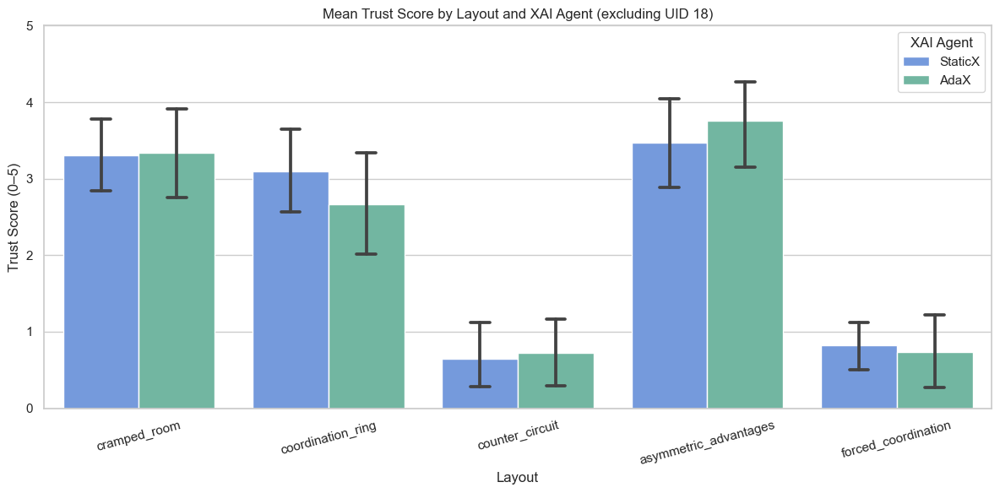

In [5038]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize player ID and remove UID 18
df_static_adax['player_Id'] = df_static_adax['player_Id'].astype(str).str.strip()
df_static_adax = df_static_adax[~df_static_adax['uid'].isin(['18'])]

# Trust columns
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
df_static_adax[trust_cols] = df_static_adax[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['trust'] = df_static_adax[trust_cols].mean(axis=1)

# Filter only AdaX and StaticX
df_trust = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Run layout-wise statistical comparison
results = []
for layout in df_trust['layout'].dropna().unique():
    layout_df = df_trust[df_trust['layout'] == layout]
    pivot = layout_df.pivot_table(index='player_Id', columns='xai_agent', values='trust').dropna()

    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        w, p_norm = shapiro(diff)
        if p_norm >= 0.05:
            stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test = 'Paired t-test'
        else:
            stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test = 'Wilcoxon test'

        results.append({
            'layout': layout,
            'test_used': test,
            'normality_p': round(p_norm, 4),
            'test_stat': round(stat, 4),
            'p_value': round(p_val, 4)
        })

results_df = pd.DataFrame(results)
print("\nTrust Score Comparison by Layout (excluding UID 18):")
print(results_df)
results_df.to_csv("trust_comparison_uid18_removed.csv", index=False)

# === Visualization ===
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_trust,
    x='layout',
    y='trust',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Mean Trust Score by Layout and XAI Agent (excluding UID 18)")
plt.ylabel("Trust Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()



Trust Analysis Across Layouts (UIDs 14 and 18 removed):
                  Layout           Test  Normality p    Stat  p-value
0           cramped_room  Paired t-test       0.4372  0.3519   0.7330
1      coordination_ring  Paired t-test       0.3253 -0.9537   0.3652
2        counter_circuit  Paired t-test       0.0752  0.8558   0.4143
3  asymmetric_advantages  Paired t-test       0.6680  3.7649   0.0045
4    forced_coordination  Paired t-test       0.6104 -0.3603   0.7269


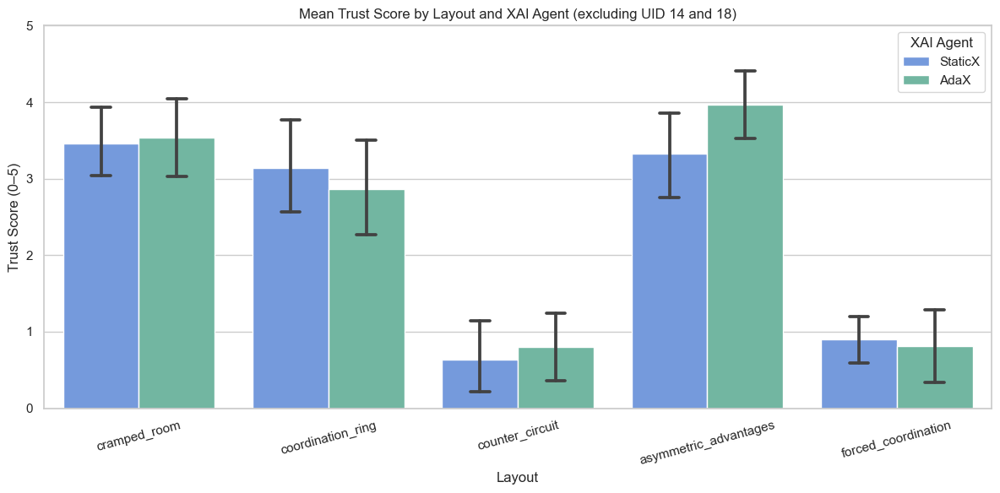

In [5039]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load Excel data
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize UID and remove UID 14 and 18
df_static_adax['uid'] = df_static_adax['uid'].astype(str).str.strip()
df_static_adax = df_static_adax[~df_static_adax['uid'].isin(['14', '18'])]

# Trust score calculation
trust_cols = ['Q107_1','Q107_2','Q107_3','Q107_4','Q107_5','Q107_6','Q107_7','Q107_8','Q107_9']
df_static_adax[trust_cols] = df_static_adax[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['trust_score'] = df_static_adax[trust_cols].mean(axis=1)

# Filter AdaX and StaticX only
df_trust = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Initialize results
results = []

# Perform layout-wise analysis
for layout in df_trust['layout'].dropna().unique():
    layout_df = df_trust[df_trust['layout'] == layout]
    pivot = layout_df.pivot_table(index='uid', columns='xai_agent', values='trust_score').dropna()

    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        w_stat, p_normality = shapiro(diff)
        if p_normality >= 0.05:
            stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test_type = 'Paired t-test'
        else:
            stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test_type = 'Wilcoxon test'

        results.append({
            'Layout': layout,
            'Test': test_type,
            'Normality p': round(p_normality, 4),
            'Stat': round(stat, 4),
            'p-value': round(p_val, 4)
        })

# Create results DataFrame and export
results_df = pd.DataFrame(results)
print("\nTrust Analysis Across Layouts (UIDs 14 and 18 removed):")
print(results_df)
results_df.to_csv("trust_analysis_uid14_18_removed.csv", index=False)

# Optional: visualize mean trust scores
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_trust,
    x='layout',
    y='trust_score',
    hue='xai_agent',
    errorbar=('ci', 95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Mean Trust Score by Layout and XAI Agent (excluding UID 14 and 18)")
plt.ylabel("Trust Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()


Although statistical testing did not reveal significant differences in trust scores between AdaX and StaticX across any of the five layouts (all p > 0.05), visual inspection of the bar plots revealed consistent directional trends. In layouts such as Cramped Room and Counter Circuit, participants tended to rate trust in the adaptive explanation condition (AdaX) higher than in the static condition (StaticX). These apparent mean differences, however, were accompanied by overlapping confidence intervals and high within-subject variability, limiting their statistical reliability. The small sample size after excluding two participants (UID 14 and 18) further reduced the power to detect medium-sized effects. As a result, the observed trends may suggest a latent benefit of adaptive explanations that could be validated in future studies with a larger participant pool or a stronger manipulation of the adaptive mechanism. These findings highlight the importance of interpreting non-significant results cautiously, especially when visual patterns point to potentially meaningful differences.


ESS Score Comparison by Layout (excluding UID 18 and 14):
                  layout      test_used  normality_p  test_stat  p_value
0           cramped_room  Paired t-test       0.1793     0.3082   0.7650
1      coordination_ring  Paired t-test       0.5845    -0.7406   0.4778
2        counter_circuit  Paired t-test       0.3067     1.9945   0.0772
3  asymmetric_advantages  Wilcoxon test       0.0022     0.0000   0.0076
4    forced_coordination  Paired t-test       0.9012    -0.3151   0.7599


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


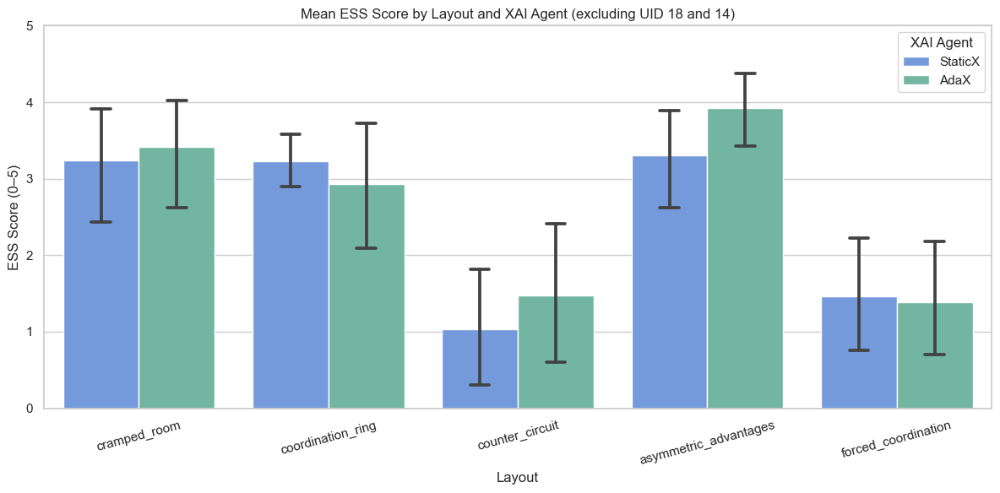

In [5041]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel, shapiro, wilcoxon

# Load data from Excel
xls = pd.ExcelFile("sdata_latest.xlsx")
df_static_adax = xls.parse("Sheet3")[1:]

# Normalize UID and remove UID 18 and 14
df_static_adax['uid'] = df_static_adax['uid'].astype(str).str.strip()
df_static_adax = df_static_adax[~df_static_adax['uid'].isin(['18', '14'])]

# ESS columns and mean calculation
ess_cols = [f"Q99_{i}" for i in range(1, 10)]
df_static_adax[ess_cols] = df_static_adax[ess_cols].apply(pd.to_numeric, errors='coerce') - 1
df_static_adax['ess_score'] = df_static_adax[ess_cols].mean(axis=1)

# Filter only AdaX and StaticX
df_ess = df_static_adax[df_static_adax['xai_agent'].isin(['AdaX', 'StaticX'])]

# Run layout-wise statistical comparison
results = []
for layout in df_ess['layout'].dropna().unique():
    layout_df = df_ess[df_ess['layout'] == layout]
    pivot = layout_df.pivot_table(index='uid', columns='xai_agent', values='ess_score').dropna()

    if pivot.shape[0] >= 3:
        diff = pivot['AdaX'] - pivot['StaticX']
        w, p_norm = shapiro(diff)
        if p_norm >= 0.05:
            stat, p_val = ttest_rel(pivot['AdaX'], pivot['StaticX'])
            test = 'Paired t-test'
        else:
            stat, p_val = wilcoxon(pivot['AdaX'], pivot['StaticX'])
            test = 'Wilcoxon test'

        results.append({
            'layout': layout,
            'test_used': test,
            'normality_p': round(p_norm, 4),
            'test_stat': round(stat, 4),
            'p_value': round(p_val, 4)
        })

results_df = pd.DataFrame(results)
print("\nESS Score Comparison by Layout (excluding UID 18 and 14):")
print(results_df)
results_df.to_csv("ess_comparison_uid18_14_removed.csv", index=False)

# === Visualization ===
plt.figure(figsize=(12, 6))
sns.barplot(
    data=df_ess,
    x='layout',
    y='ess_score',
    hue='xai_agent',
    errorbar=('ci',95),
    capsize=0.1,
    palette=custom_palette
)
plt.title("Mean ESS Score by Layout and XAI Agent (excluding UID 18 and 14)")
plt.ylabel("ESS Score (0–5)")
plt.xlabel("Layout")
plt.ylim(0, 5)
plt.xticks(rotation=15)
plt.legend(title="XAI Agent", loc='upper right')
plt.tight_layout()
plt.show()


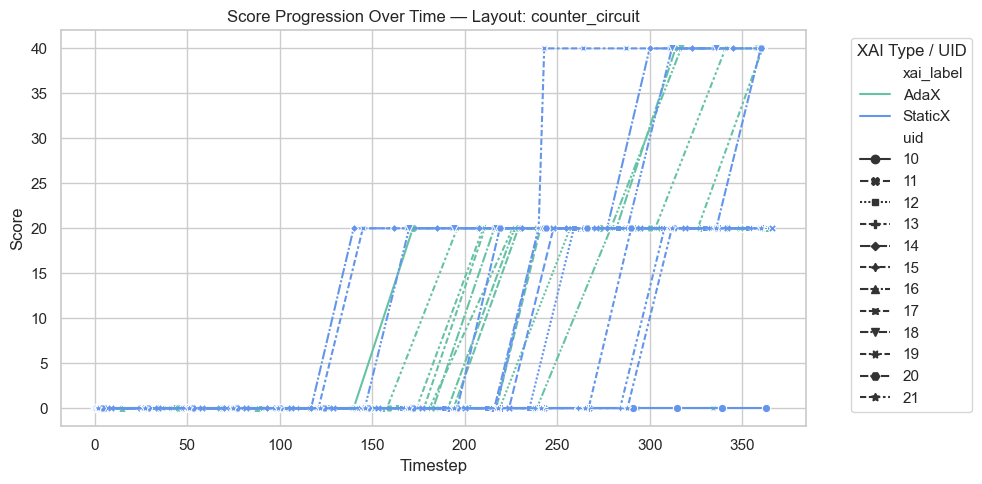

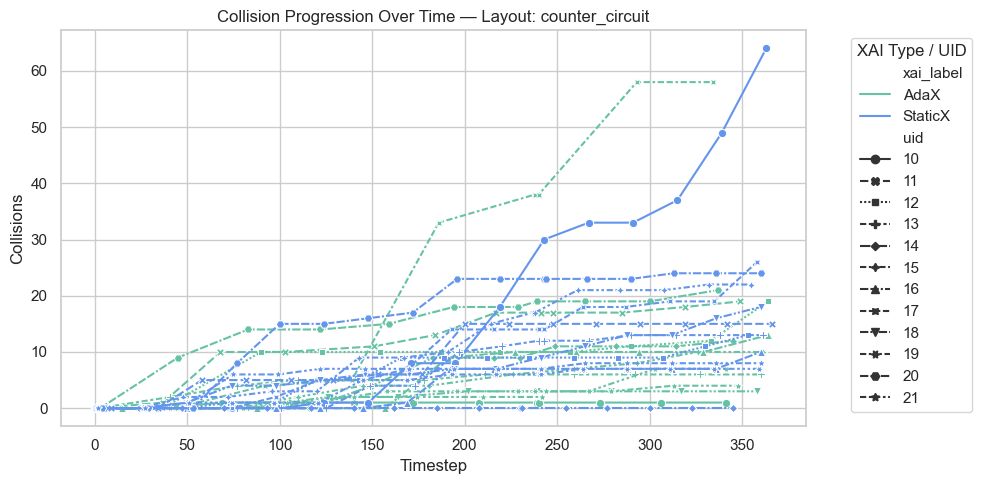

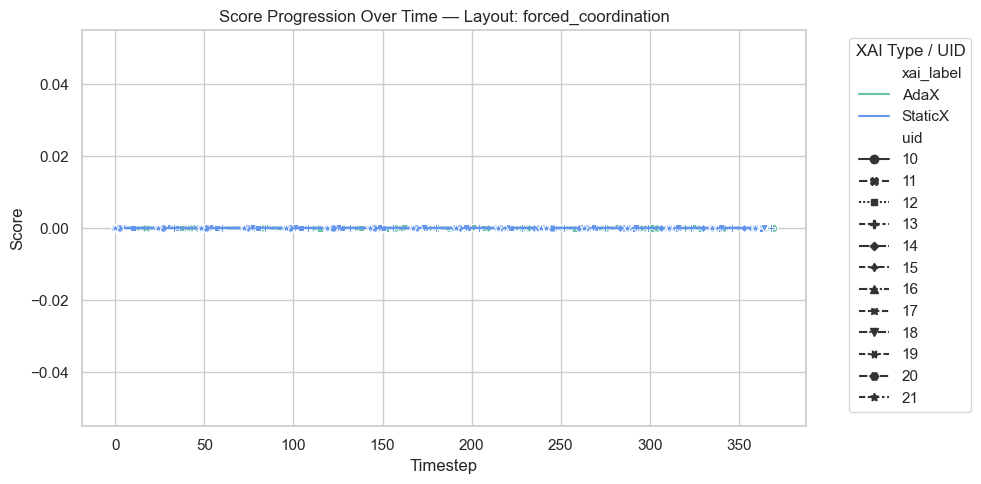

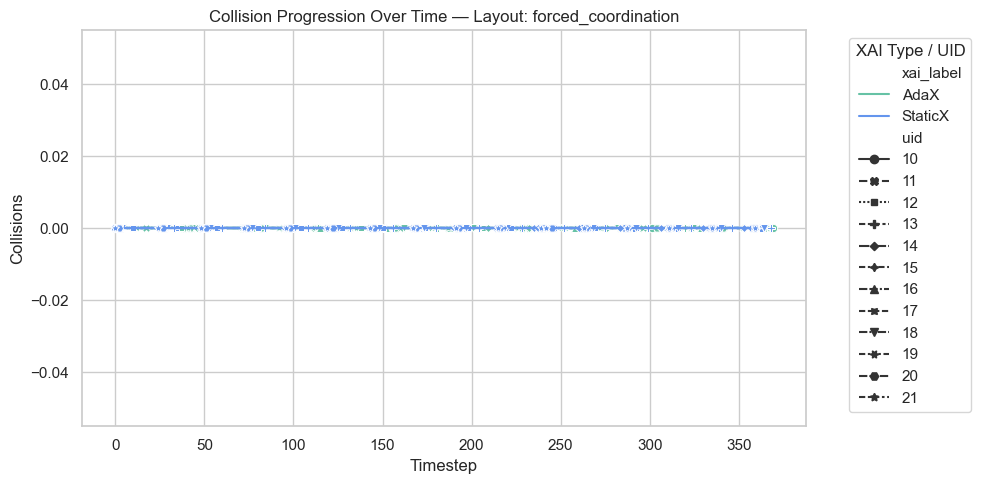

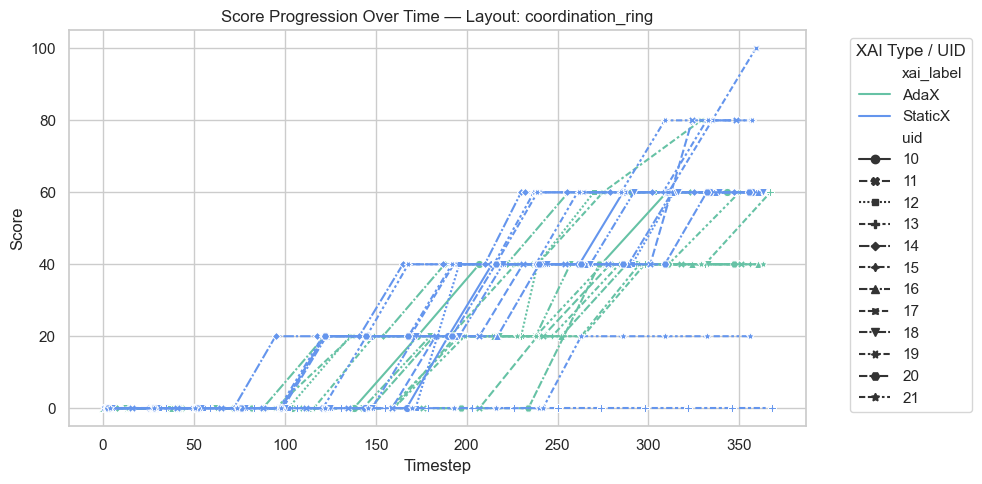

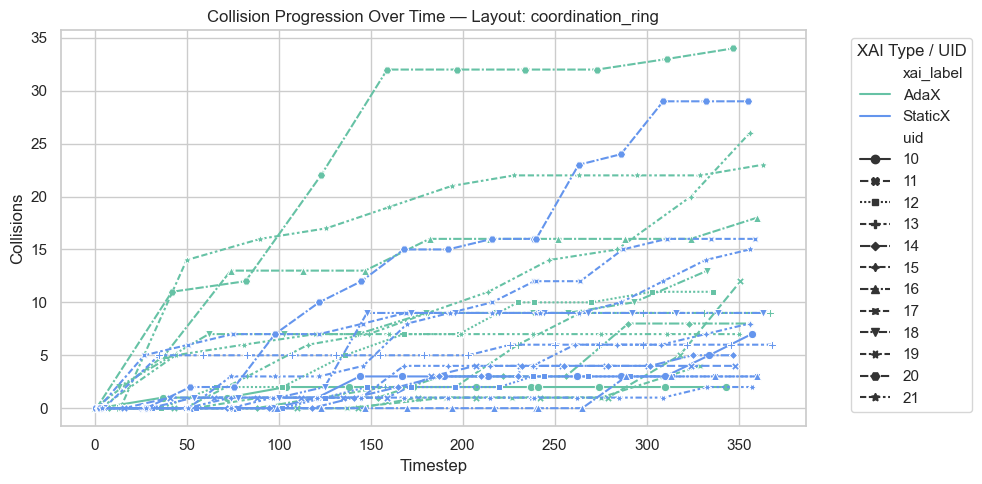

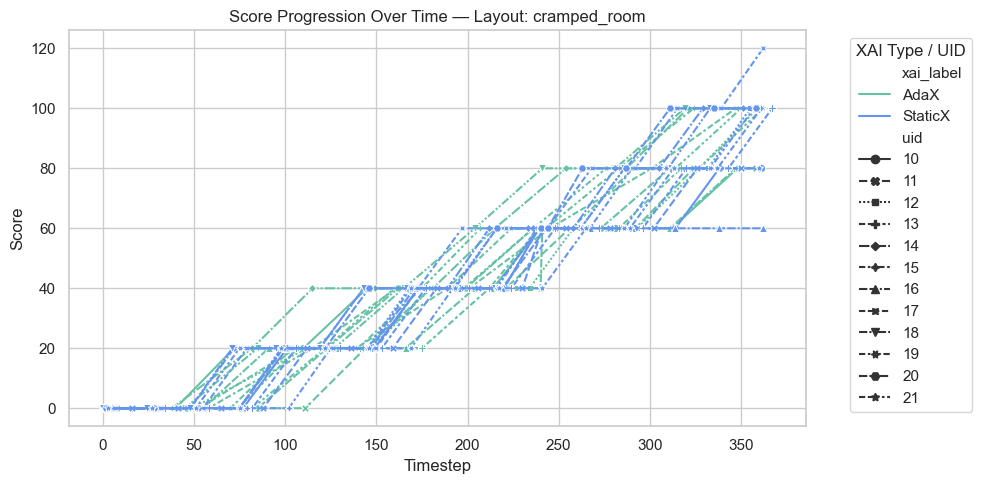

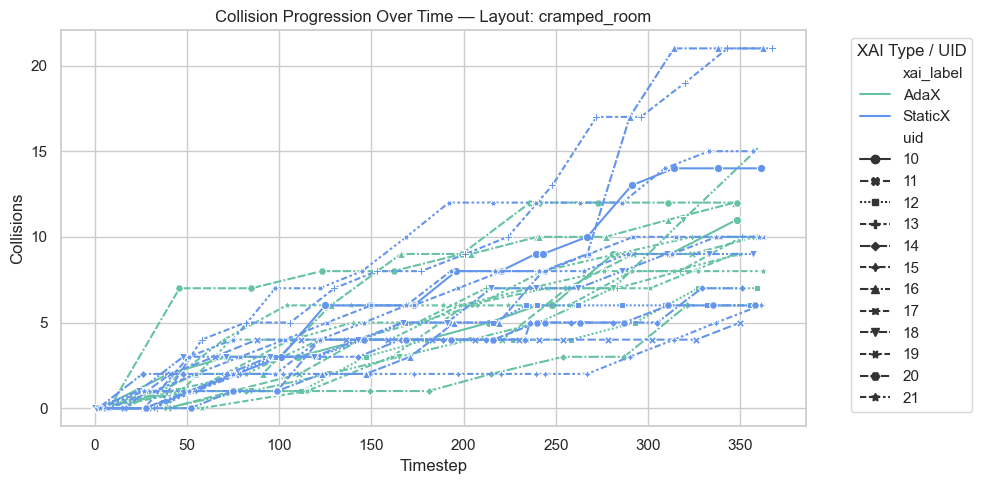

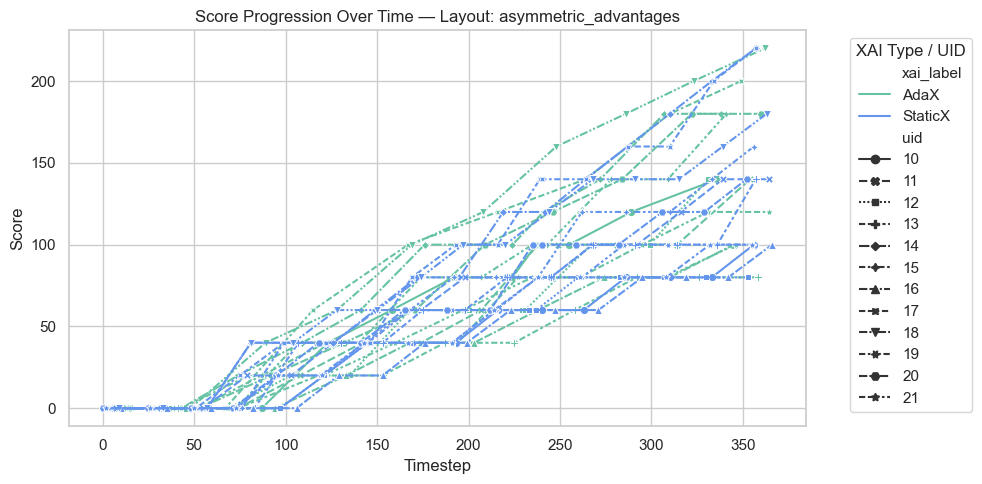

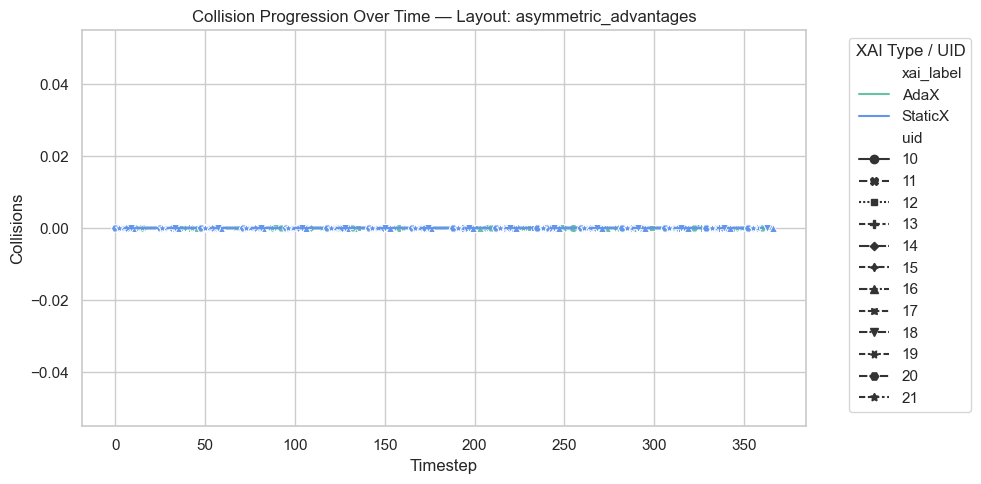

In [5042]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the processed JSON file
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Parse metadata and construct DataFrame
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_timing = meta.get("explanation_features", {}).get("explanation_timing")
    xai_label = "StaticX" if xai_timing == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score": meta.get("score"),
        "collisions": meta.get("num_collisions"),
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep"),
        "created_at": meta.get("created_at")
    })

# Create DataFrame
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score"] = pd.to_numeric(df["score"], errors="coerce")
df["collisions"] = pd.to_numeric(df["collisions"], errors="coerce")

# Plot score and collision progression per layout
layouts = df["layout"].dropna().unique()

for layout in layouts:
    subset = df[df["layout"] == layout]

    # Score progression
    plt.figure(figsize=(10, 5))
    sns.lineplot(data=subset, x="timestep", y="score", hue="xai_label", style="uid", estimator=None, markers=True, palette=custom_palette)
    plt.title(f"Score Progression Over Time — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Score")
    plt.grid(True)
    plt.legend(title="XAI Type / UID", bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

    # Collision progression
    plt.figure(figsize=(10, 5))
    sns.lineplot(data=subset, x="timestep", y="collisions", hue="xai_label", style="uid", estimator=None, markers=True, palette=custom_palette)
    plt.title(f"Collision Progression Over Time — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Collisions")
    plt.grid(True)
    plt.legend(title="XAI Type / UID", bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()


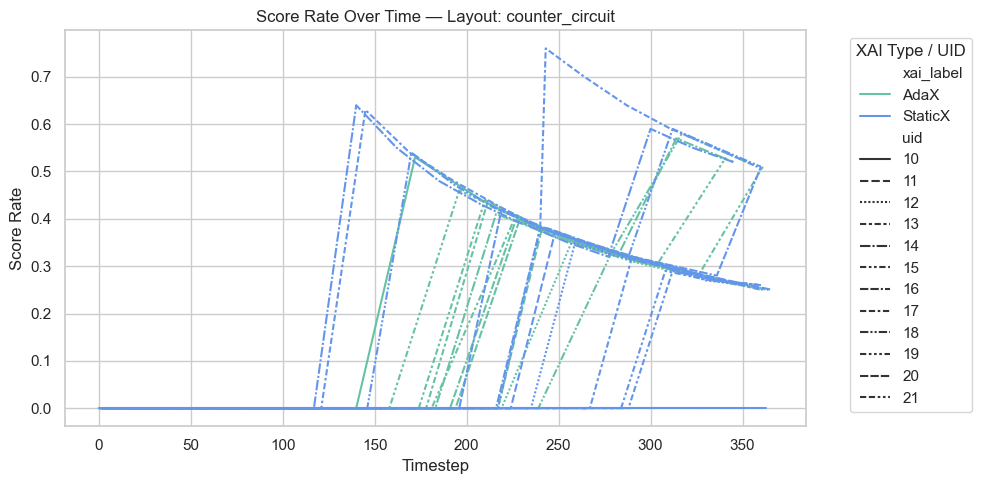

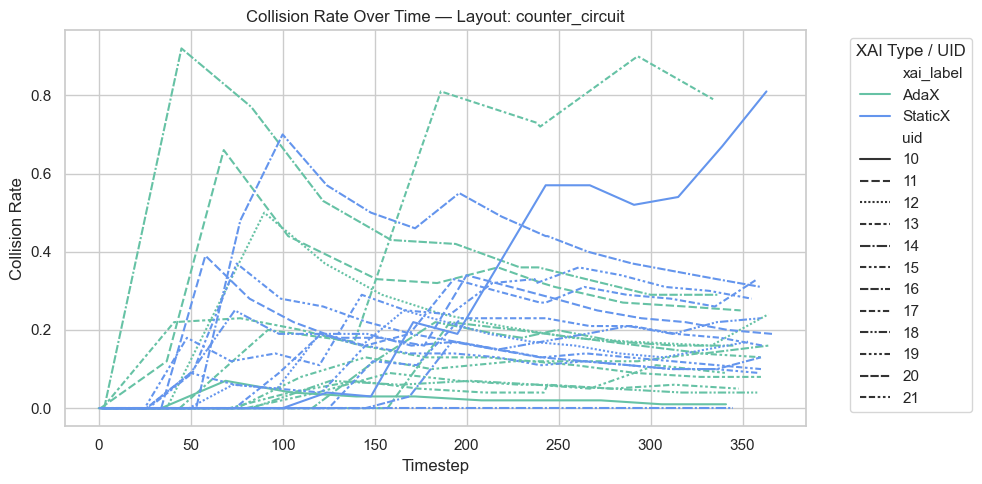

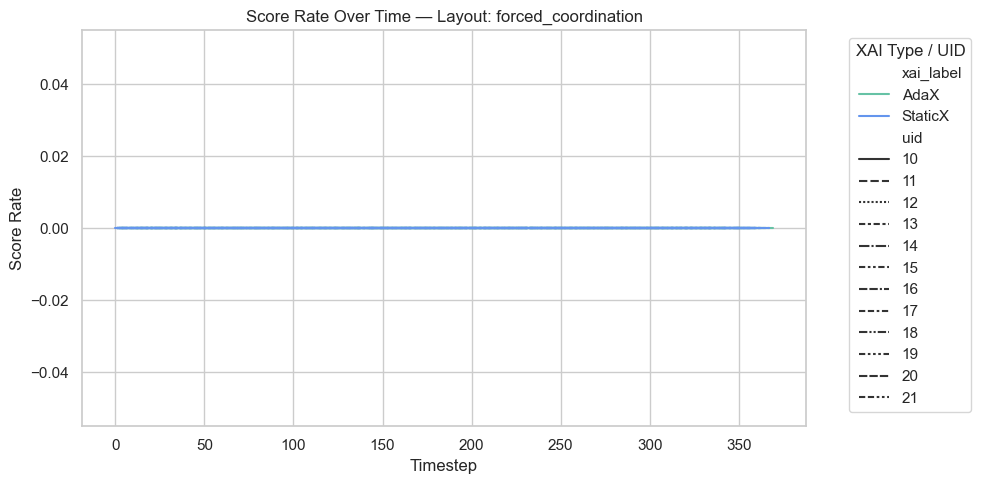

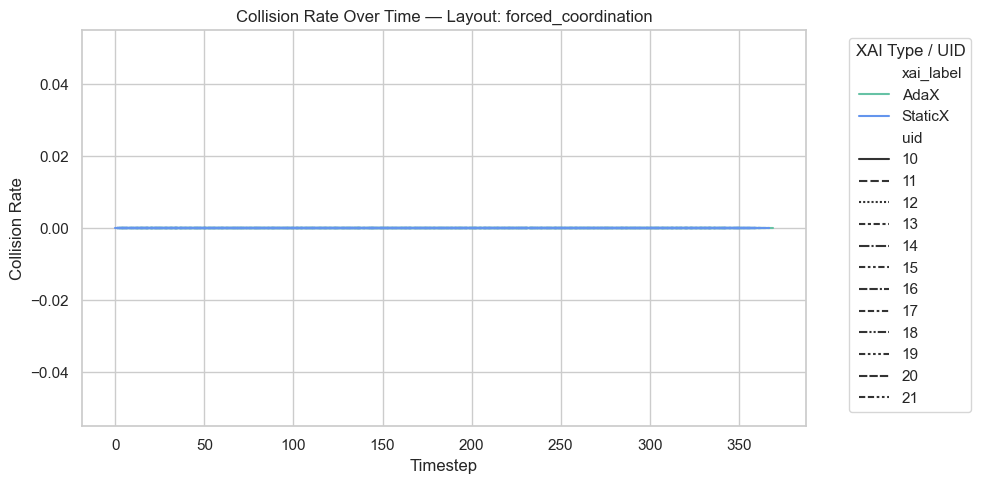

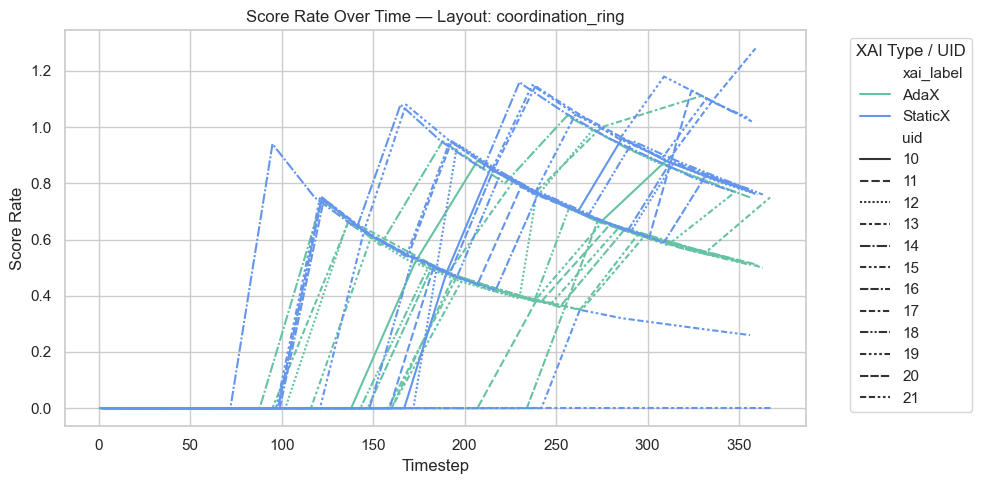

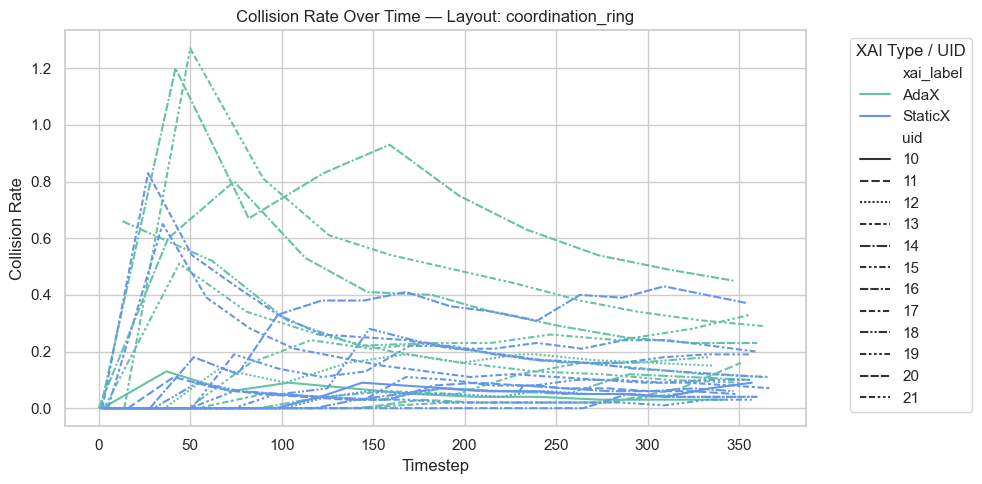

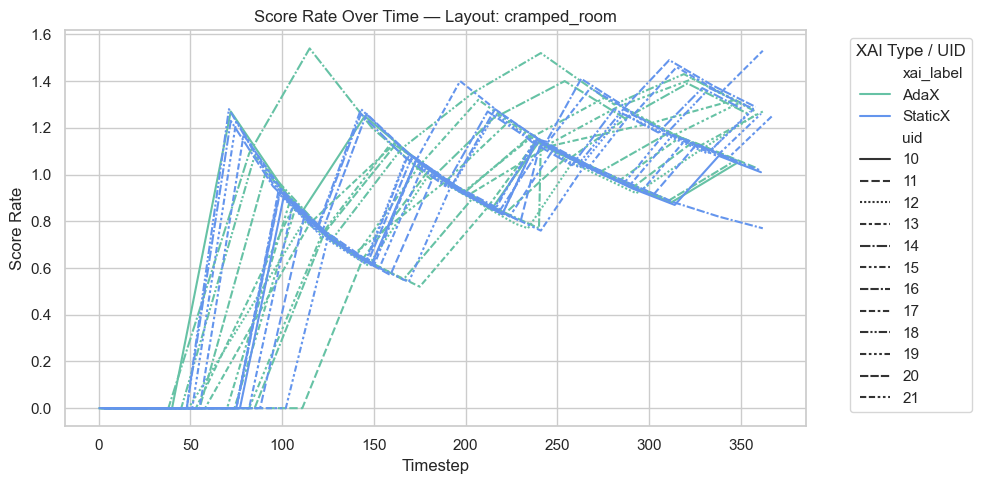

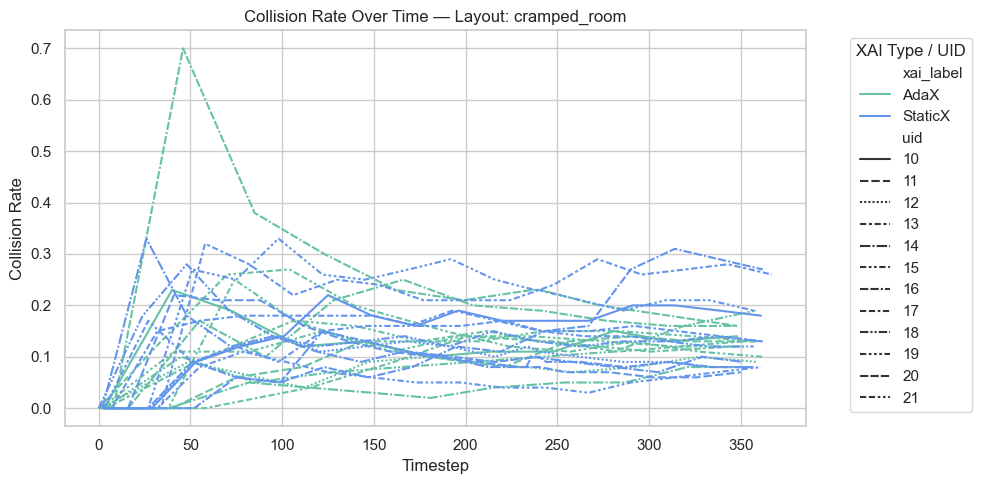

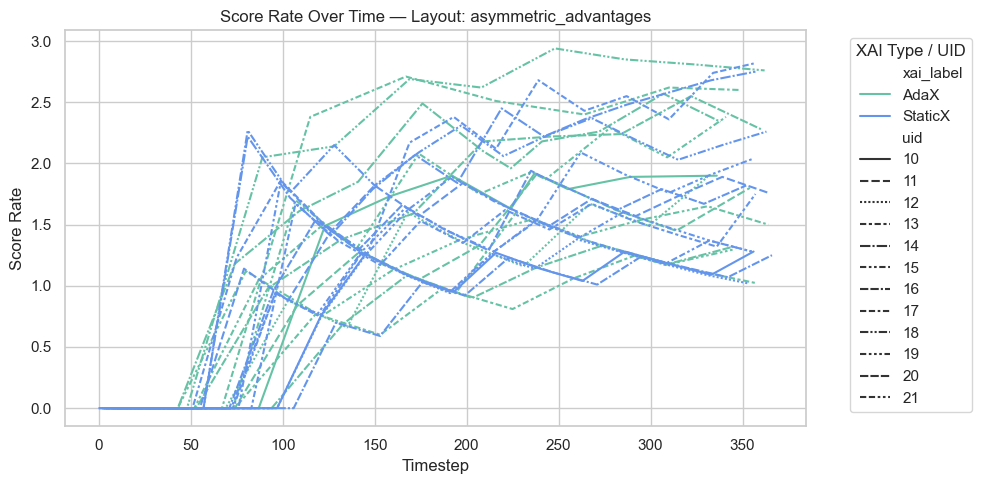

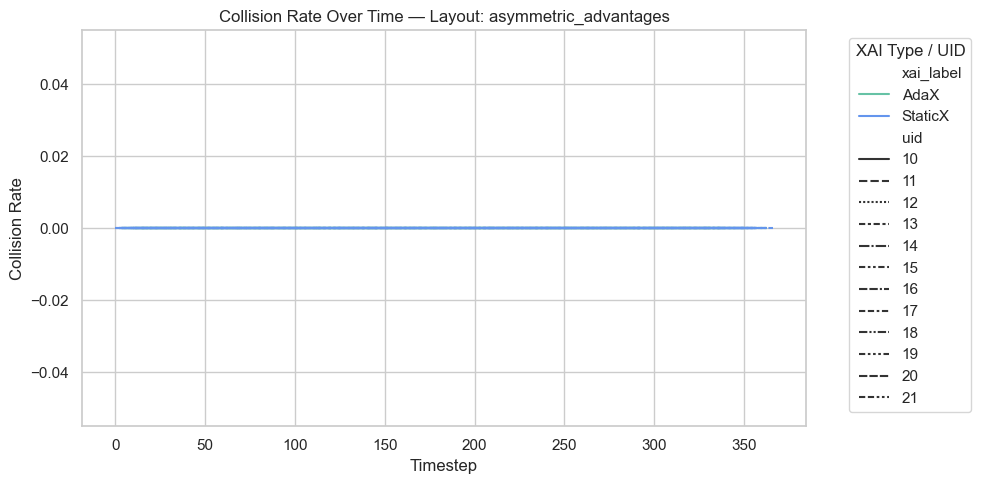

In [5043]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load and parse processed JSON
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Build structured records
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_type = meta.get("explanation_features", {}).get("explanation_timing")
    xai_label = "StaticX" if xai_type == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

# Create DataFrame
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# Plot per layout
layouts = df["layout"].dropna().unique()

for layout in layouts:
    subset = df[df["layout"] == layout]

    # Score rate progression
    plt.figure(figsize=(10, 5))
    sns.lineplot(data=subset, x="timestep", y="score_rate", hue="xai_label", style="uid", estimator=None, palette=custom_palette)
    plt.title(f"Score Rate Over Time — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Score Rate")
    plt.grid(True)
    plt.legend(title="XAI Type / UID", bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

    # Collision rate progression
    plt.figure(figsize=(10, 5))
    sns.lineplot(data=subset, x="timestep", y="collision_rate", hue="xai_label", style="uid", estimator=None, palette=custom_palette)
    plt.title(f"Collision Rate Over Time — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Collision Rate")
    plt.grid(True)
    plt.legend(title="XAI Type / UID", bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()


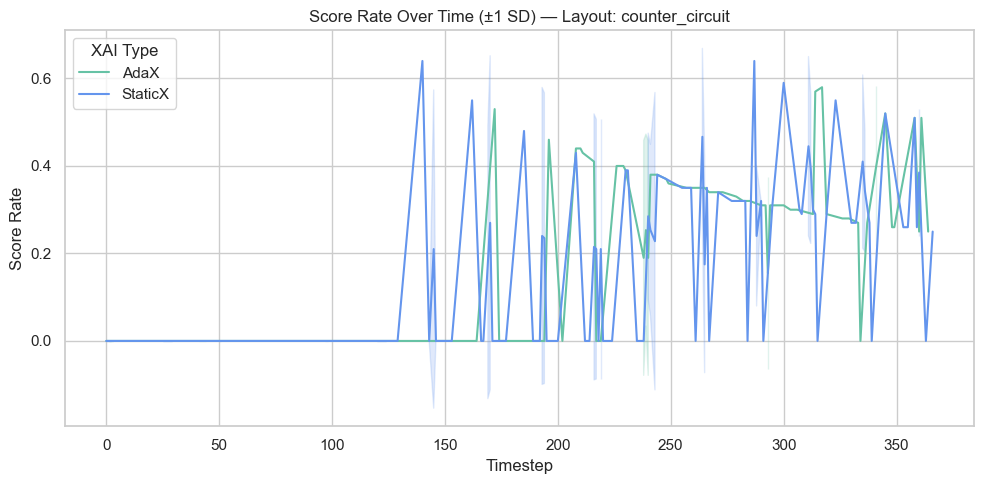

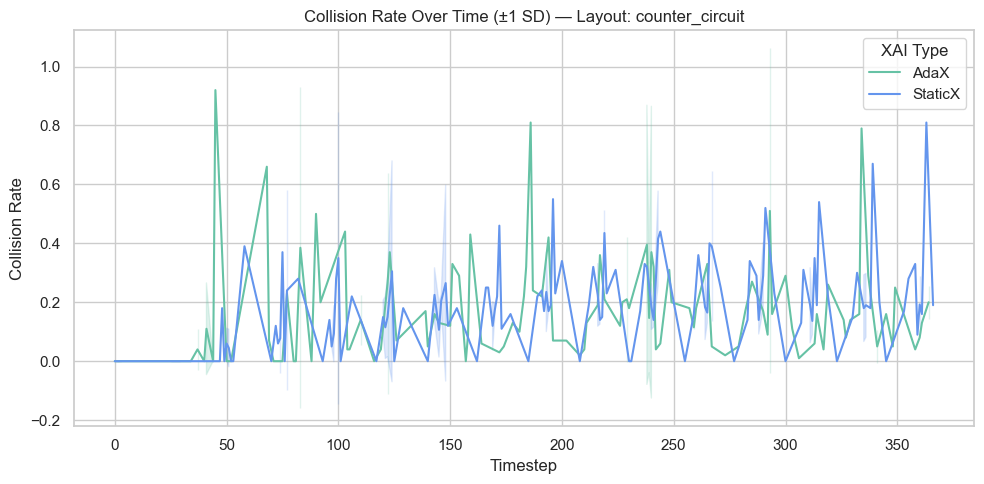

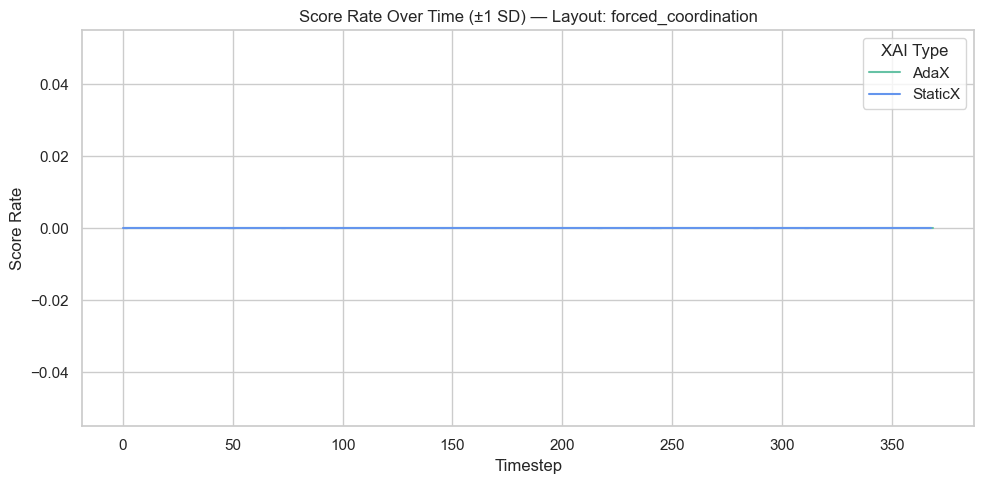

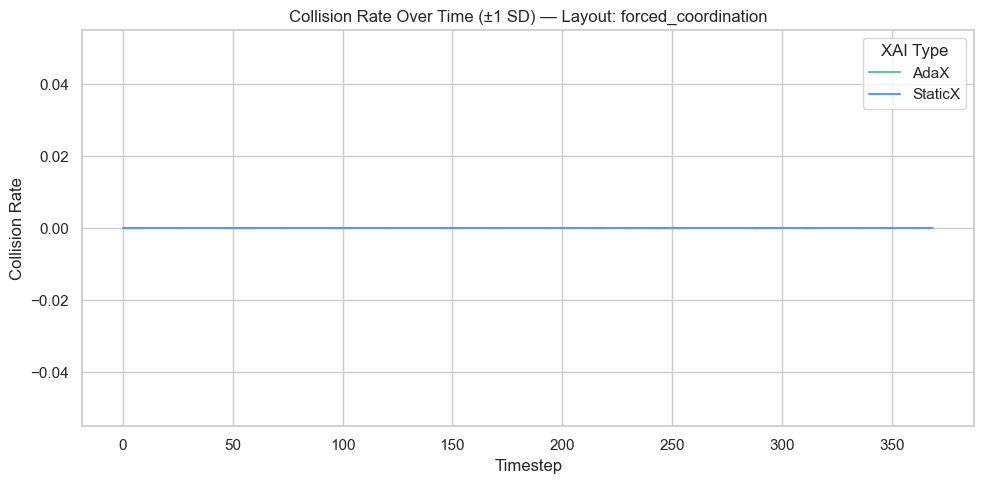

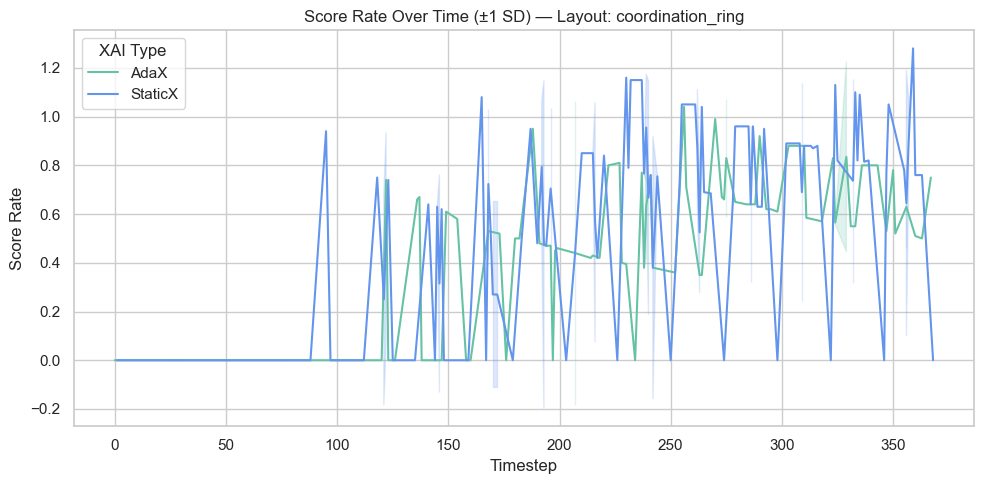

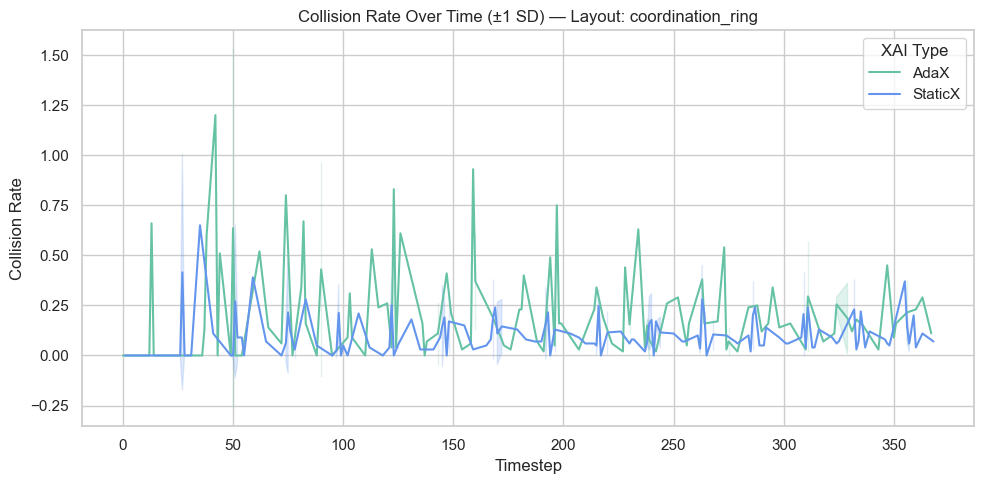

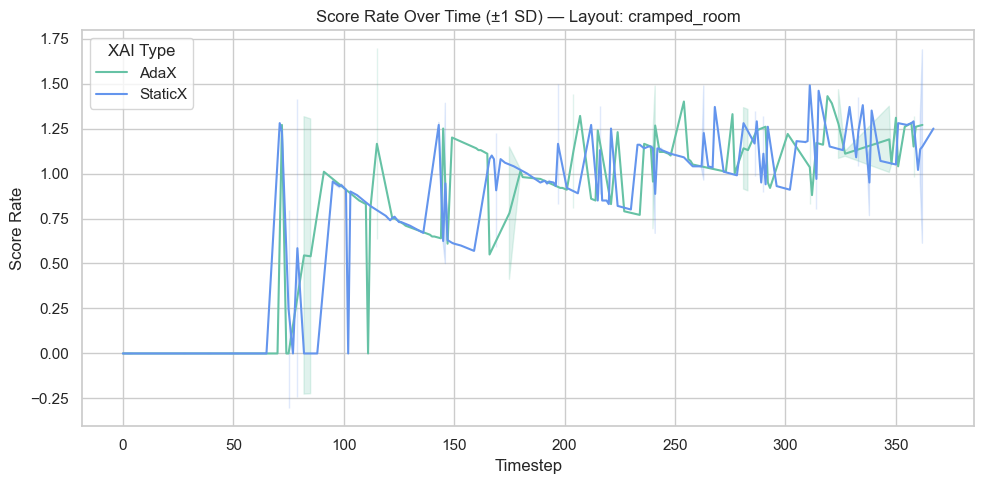

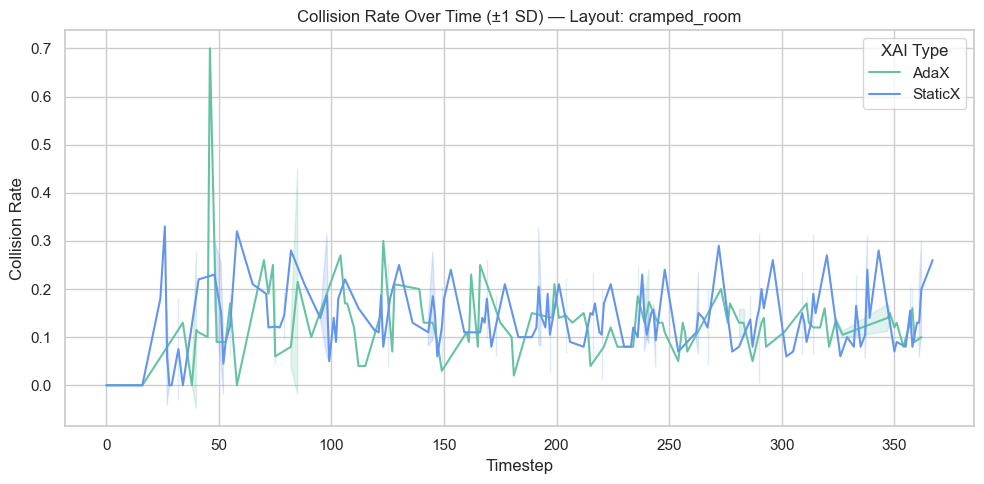

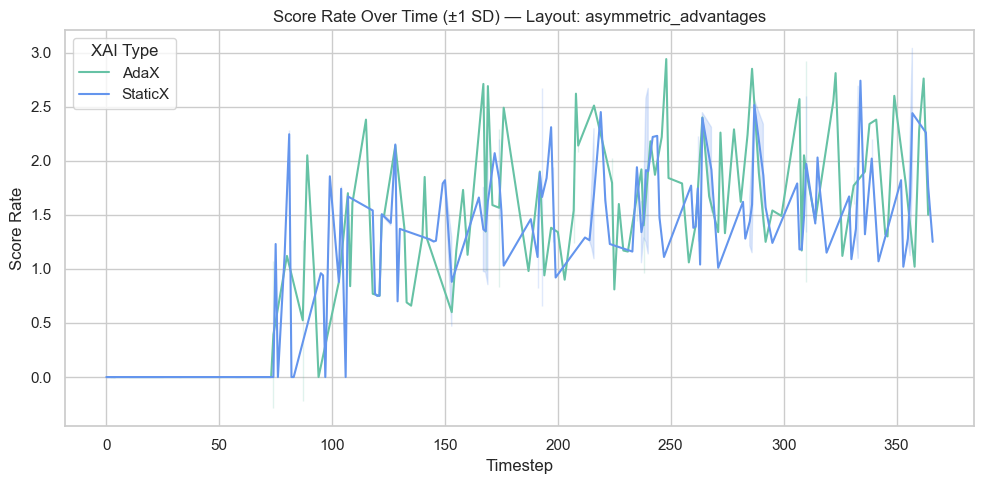

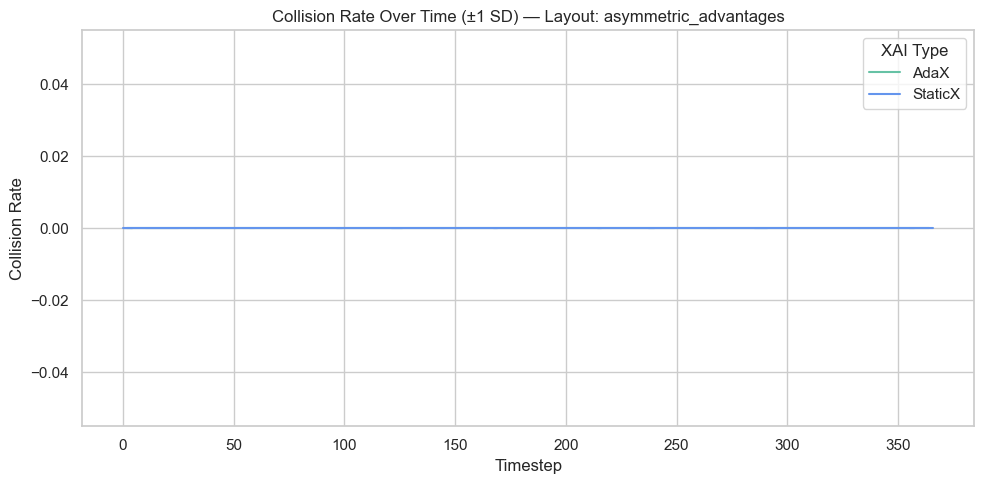

In [5044]:
# import json
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Load the processed JSON file
# with open("processed_with_uid_filtered.json", "r") as f:
#     json_data = json.load(f)

# # Build structured records
# records = []
# for record in json_data:
#     meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
#     xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
#     records.append({
#         "uid": record.get("uid"),
#         "layout": meta.get("layout_name"),
#         "xai_label": xai_label,
#         "score_rate": meta.get("score_rate"),
#         "collision_rate": meta.get("collision_rate"),
#         "timestep": meta.get("timestep")
#     })

# # Create DataFrame
# df = pd.DataFrame(records)
# df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
# df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
# df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# # Group by uid, layout, xai_label, and timestep (participant-wise means)
# agg = df.groupby(["uid", "layout", "xai_label", "timestep"]).mean(numeric_only=True).reset_index()

# # Now compute mean across participants (trend lines)
# trend_df = agg.groupby(["layout", "xai_label", "timestep"]).mean(numeric_only=True).reset_index()

# # Plot per layout
# for layout in trend_df["layout"].unique():
#     layout_df = trend_df[trend_df["layout"] == layout]

#     # Score rate trend
#     plt.figure(figsize=(10, 5))
#     sns.lineplot(data=layout_df, x="timestep", y="score_rate", hue="xai_label")
#     plt.title(f"Participant-Averaged Score Rate — Layout: {layout}")
#     plt.xlabel("Timestep")
#     plt.ylabel("Average Score Rate")
#     plt.grid(True)
#     plt.legend(title="XAI Type")
#     plt.tight_layout()
#     plt.show()

#     # Collision rate trend
#     plt.figure(figsize=(10, 5))
#     sns.lineplot(data=layout_df, x="timestep", y="collision_rate", hue="xai_label")
#     plt.title(f"Participant-Averaged Collision Rate — Layout: {layout}")
#     plt.xlabel("Timestep")
#     plt.ylabel("Average Collision Rate")
#     plt.grid(True)
#     plt.legend(title="XAI Type")
#     plt.tight_layout()
#     plt.show()

import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the JSON
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

# Create DataFrame
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# Plot mean ± std error per layout
for layout in df["layout"].dropna().unique():
    layout_df = df[df["layout"] == layout]

    # Score Rate
    plt.figure(figsize=(10, 5))
    sns.lineplot(data=layout_df, x="timestep", y="score_rate", hue="xai_label", errorbar='sd', palette=custom_palette)
    plt.title(f"Score Rate Over Time (±1 SD) — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Score Rate")
    plt.grid(True)
    plt.legend(title="XAI Type")
    plt.tight_layout()
    plt.show()

    # Collision Rate
    plt.figure(figsize=(10, 5))
    sns.lineplot(data=layout_df, x="timestep", y="collision_rate", hue="xai_label", errorbar='sd', palette=custom_palette)
    plt.title(f"Collision Rate Over Time (±1 SD) — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Collision Rate")
    plt.grid(True)
    plt.legend(title="XAI Type")
    plt.tight_layout()
    plt.show()


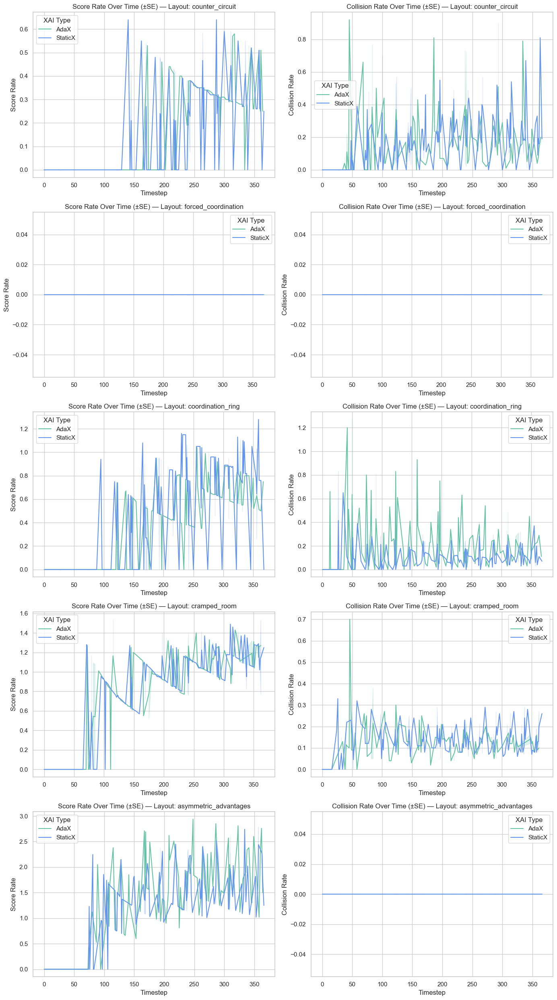

In [5045]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the JSON
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

# Create DataFrame
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# Get unique layouts
layouts = df["layout"].dropna().unique()
n_layouts = len(layouts)

# Create subplots
fig, axes = plt.subplots(n_layouts, 2, figsize=(14, 5 * n_layouts), sharex=False)
if n_layouts == 1:
    axes = axes.reshape(1, 2)  # Handle single-layout case

# Plot score_rate and collision_rate for each layout
for idx, layout in enumerate(layouts):
    layout_df = df[df["layout"] == layout]

    # Score Rate subplot
    sns.lineplot(data=layout_df, x="timestep", y="score_rate", hue="xai_label", errorbar='se', ax=axes[idx, 0], palette=custom_palette)
    axes[idx, 0].set_title(f"Score Rate Over Time (±SE) — Layout: {layout}")
    axes[idx, 0].set_xlabel("Timestep")
    axes[idx, 0].set_ylabel("Score Rate")
    axes[idx, 0].grid(True)
    axes[idx, 0].legend(title="XAI Type")

    # Collision Rate subplot
    sns.lineplot(data=layout_df, x="timestep", y="collision_rate", hue="xai_label", errorbar='se', ax=axes[idx, 1], palette=custom_palette)
    axes[idx, 1].set_title(f"Collision Rate Over Time (±SE) — Layout: {layout}")
    axes[idx, 1].set_xlabel("Timestep")
    axes[idx, 1].set_ylabel("Collision Rate")
    axes[idx, 1].grid(True)
    axes[idx, 1].legend(title="XAI Type")

plt.tight_layout()
plt.savefig("Score and Collision rate variation over time")
plt.show()


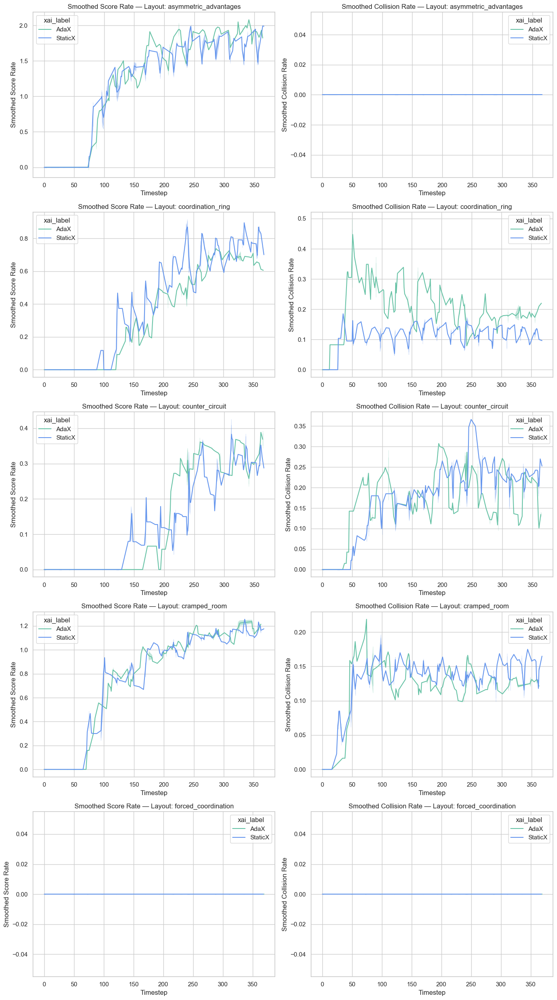

In [5818]:
# Re-run after kernel reset
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the JSON data again
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Extract records
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

# Create DataFrame and process
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# Smooth values by layout and xai_label
df = df.sort_values(by=["layout", "xai_label", "timestep"])
df["score_rate_smooth"] = df.groupby(["layout", "xai_label"])["score_rate"].transform(lambda x: x.rolling(window=8, min_periods=1).mean())
df["collision_rate_smooth"] = df.groupby(["layout", "xai_label"])["collision_rate"].transform(lambda x: x.rolling(window=8, min_periods=1).mean())

# Plotting
layouts = df["layout"].dropna().unique()
n_layouts = len(layouts)
fig, axes = plt.subplots(n_layouts, 2, figsize=(14, 5 * n_layouts), sharex=False)
if n_layouts == 1:
    axes = axes.reshape(1, 2)

for idx, layout in enumerate(layouts):
    layout_df = df[df["layout"] == layout]

    # Score Rate plot
    ax_score = axes[idx, 0]
    sns.lineplot(data=layout_df, x="timestep", y="score_rate_smooth", hue="xai_label", ax=ax_score, palette=custom_palette)
    for label in layout_df["xai_label"].unique():
        sub = layout_df[layout_df["xai_label"] == label]
        grouped = sub.groupby("timestep")["score_rate_smooth"].agg(["mean", "std"]).reset_index()
        ax_score.fill_between(grouped["timestep"],
                              grouped["mean"] - grouped["std"],
                              grouped["mean"] + grouped["std"],
                              alpha=0.2,
                              color=custom_palette['StaticX'] if label == "StaticX" else custom_palette['AdaX'])
    ax_score.set_title(f"Smoothed Score Rate — Layout: {layout}")
    ax_score.set_xlabel("Timestep")
    ax_score.set_ylabel("Smoothed Score Rate")
    ax_score.grid(True)

    # Collision Rate plot
    ax_collision = axes[idx, 1]
    sns.lineplot(data=layout_df, x="timestep", y="collision_rate_smooth", hue="xai_label", ax=ax_collision, palette=custom_palette)
    for label in layout_df["xai_label"].unique():
        sub = layout_df[layout_df["xai_label"] == label]
        grouped = sub.groupby("timestep")["collision_rate_smooth"].agg(["mean", "std"]).reset_index()
        ax_collision.fill_between(grouped["timestep"],
                                  grouped["mean"] - grouped["std"],
                                  grouped["mean"] + grouped["std"],
                                  alpha=0.2,
                                  color=custom_palette['StaticX'] if label == "StaticX" else custom_palette['AdaX'])
    ax_collision.set_title(f"Smoothed Collision Rate — Layout: {layout}")
    ax_collision.set_xlabel("Timestep")
    ax_collision.set_ylabel("Smoothed Collision Rate")
    ax_collision.grid(True)

plt.tight_layout()
plt.show()


StaticX
StaticX
StaticX
StaticX
StaticX


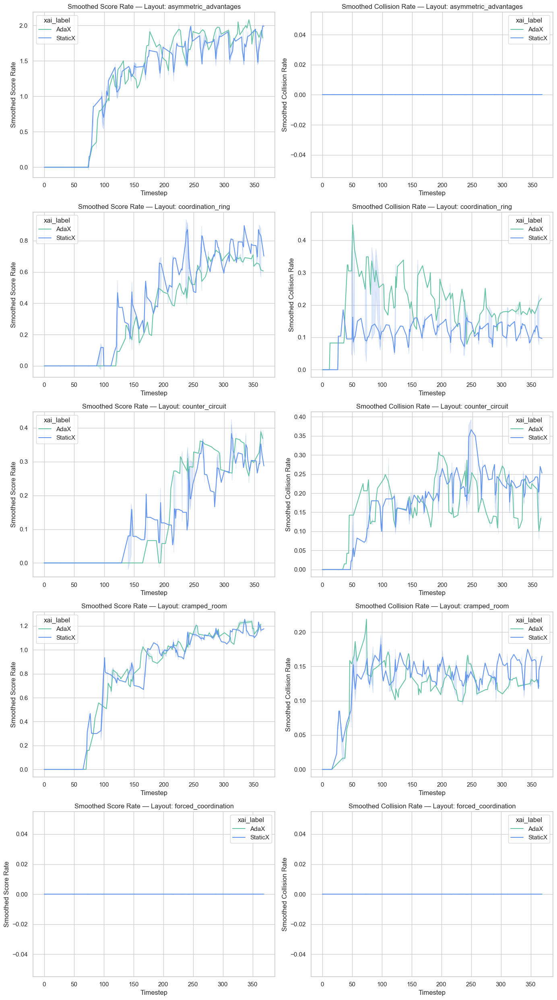

In [5801]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the JSON
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

# Create DataFrame
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# Smoothing function: rolling average within each (layout, xai_label) group
df = df.sort_values(by=["layout", "xai_label", "timestep"])
df["score_rate_smooth"] = df.groupby(["layout", "xai_label"])["score_rate"].transform(lambda x: x.rolling(window=8, min_periods=1).mean())
# df["score_rate_smooth"] = df.groupby(["layout", "xai_label"])["score_rate"].transform(lambda x: x.ewm(span=5, adjust=False).mean())

df["collision_rate_smooth"] = df.groupby(["layout", "xai_label"])["collision_rate"].transform(lambda x: x.rolling(window=8, min_periods=1).mean())

# Get unique layouts
layouts = df["layout"].dropna().unique()
n_layouts = len(layouts)

# Create subplots
fig, axes = plt.subplots(n_layouts, 2, figsize=(14, 5 * n_layouts), sharex=False)
if n_layouts == 1:
    axes = axes.reshape(1, 2)

# Plot smoothed lines
for idx, layout in enumerate(layouts):
    layout_df = df[df["layout"] == layout]
    print(xai_label)
    # Score Rate
    sns.lineplot(data=layout_df, x="timestep", y="score_rate_smooth", hue="xai_label", ax=axes[idx, 0], palette=custom_palette)
    grouped = layout_df.groupby("timestep")["score_rate_smooth"].agg(["mean", "std"]).reset_index()
    axes[idx, 0].fill_between(grouped["timestep"],
                         grouped["mean"] - grouped["std"],
                         grouped["mean"] + grouped["std"],
                         alpha=0.2, color=custom_palette.get(xai_label, "gray"))
    axes[idx, 0].set_title(f"Smoothed Score Rate — Layout: {layout}")
    axes[idx, 0].set_xlabel("Timestep")
    axes[idx, 0].set_ylabel("Smoothed Score Rate")
    axes[idx, 0].grid(True)

    # Collision Rate
    sns.lineplot(data=layout_df, x="timestep", y="collision_rate_smooth", hue="xai_label", ax=axes[idx, 1], palette=custom_palette)
    grouped = layout_df.groupby("timestep")["collision_rate_smooth"].agg(["mean", "std"]).reset_index()
    axes[idx, 1].fill_between(grouped["timestep"],
                         grouped["mean"] - grouped["std"],
                         grouped["mean"] + grouped["std"],
                         alpha=0.2, color=custom_palette.get(xai_label, "gray"))
    axes[idx, 1].set_title(f"Smoothed Collision Rate — Layout: {layout}")
    axes[idx, 1].set_xlabel("Timestep")
    axes[idx, 1].set_ylabel("Smoothed Collision Rate")
    axes[idx, 1].grid(True)

plt.tight_layout()
plt.savefig("Score and Collision rate variation over time (smoothened).png")
plt.show()


In [5047]:
#auc

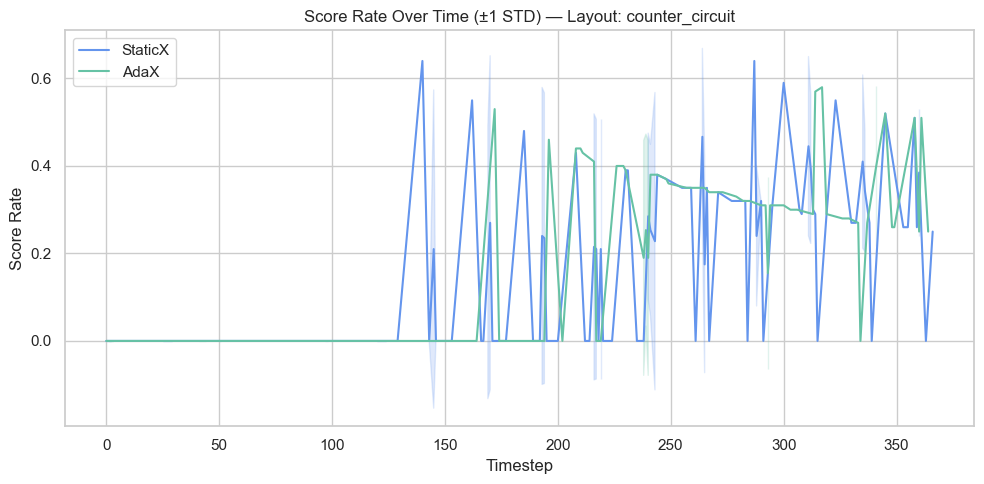

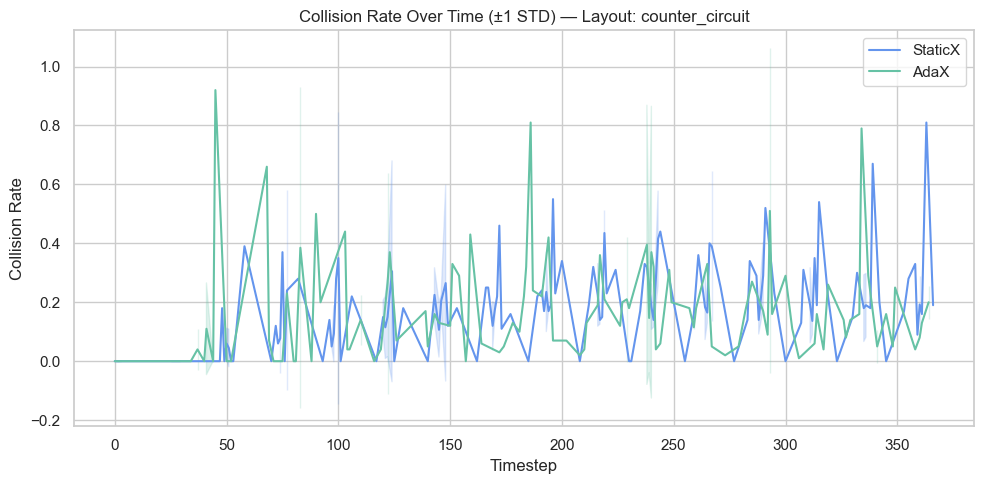

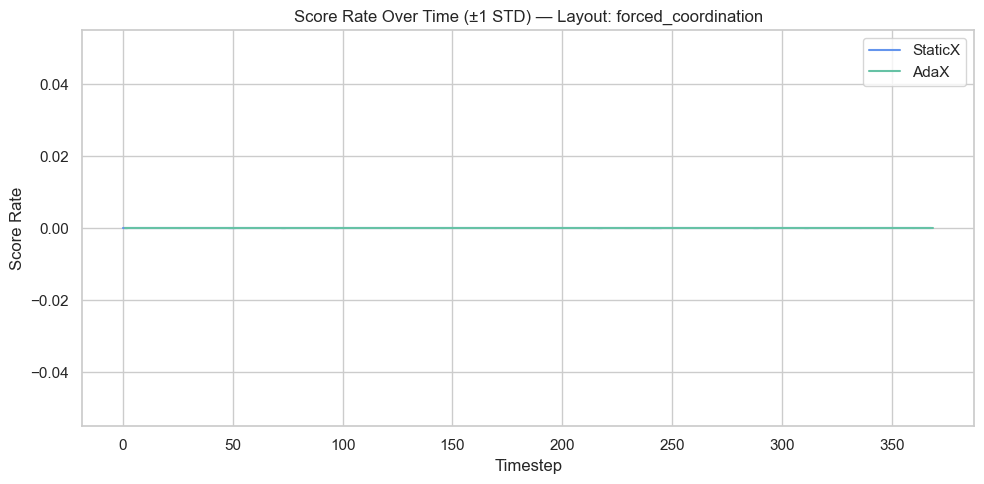

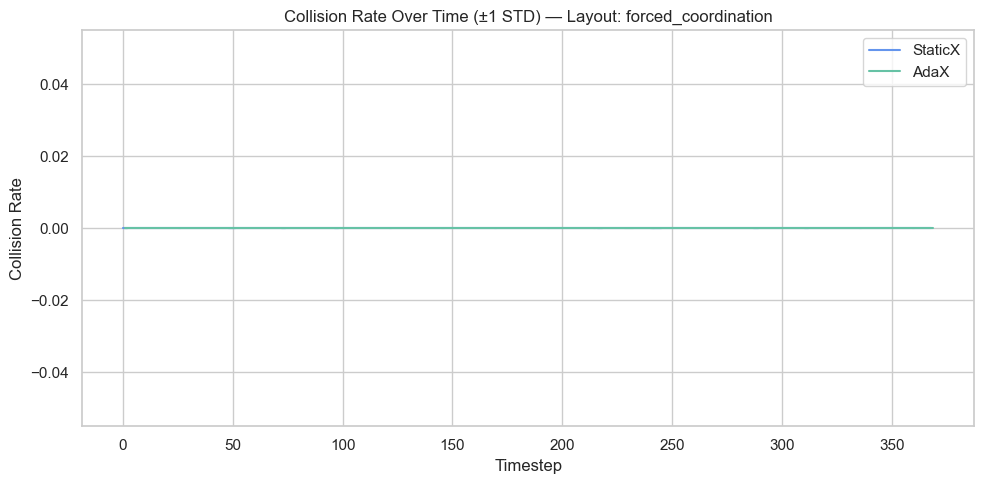

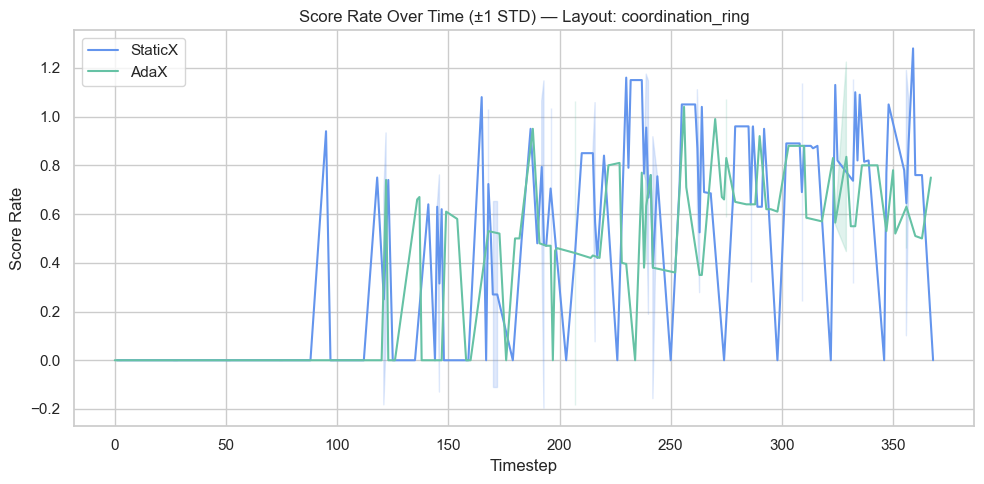

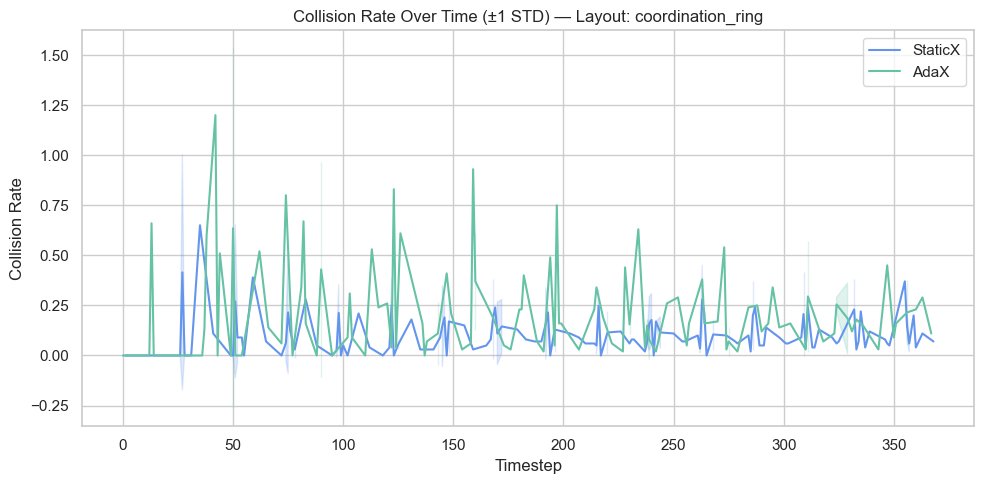

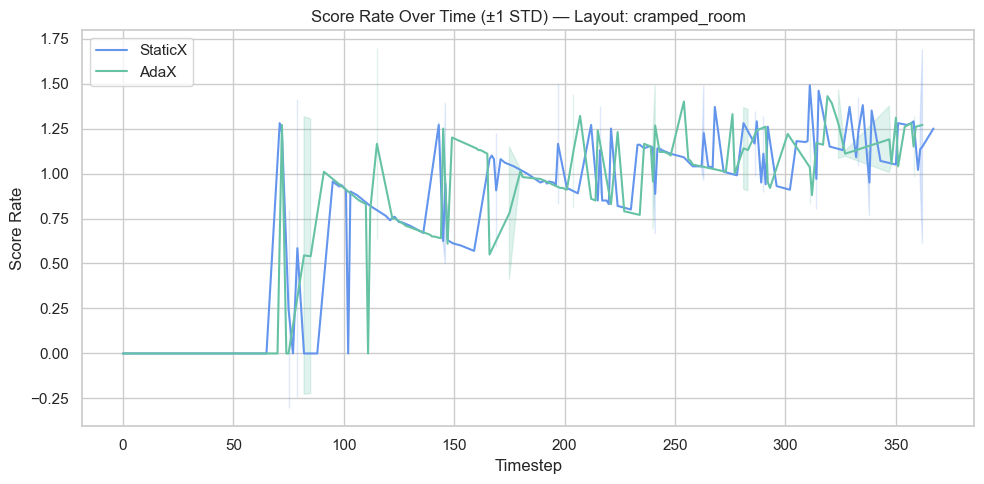

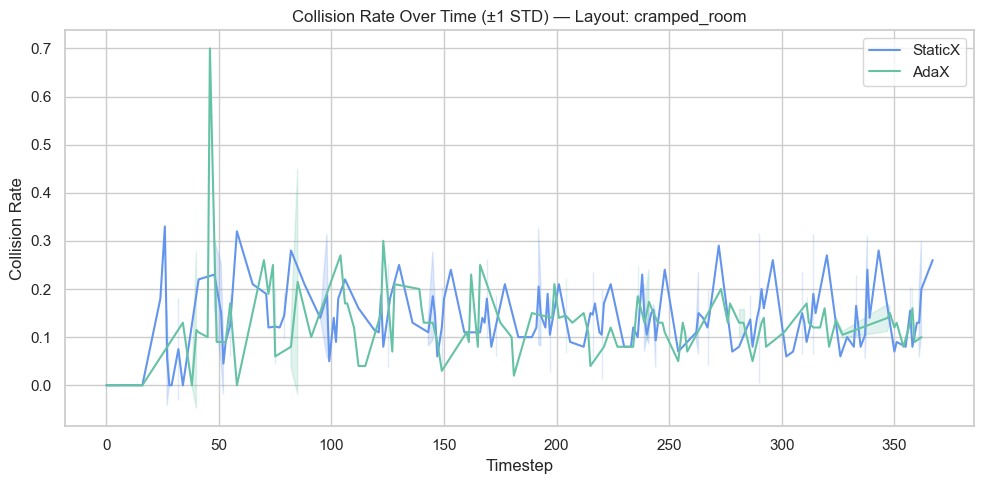

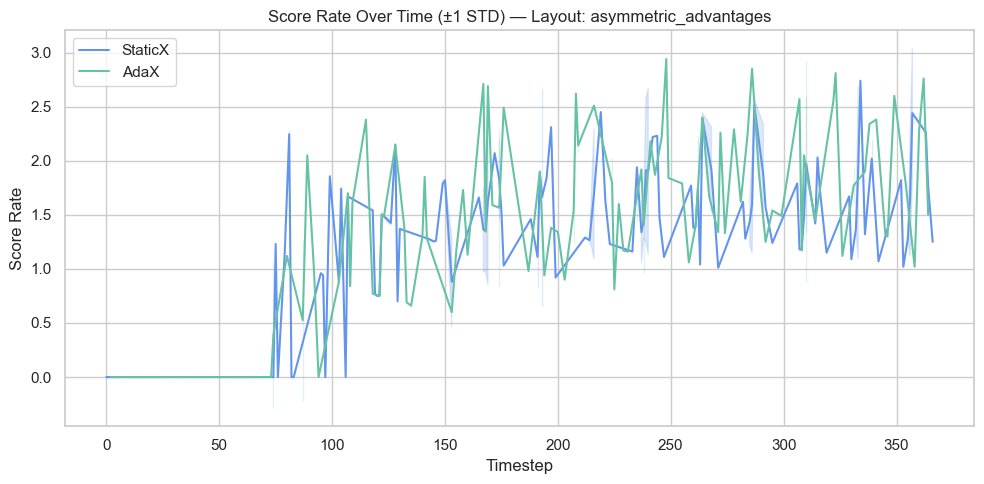

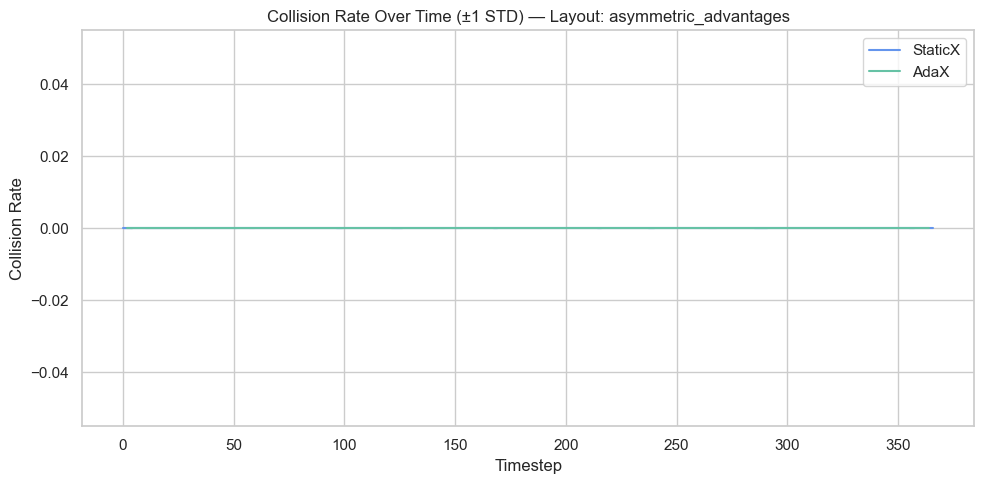

In [5048]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load JSON data
with open("processed_with_uid_filtered.json", "r") as f:
    json_data = json.load(f)

# Extract relevant fields
records = []
for record in json_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": record.get("uid"),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

# Create DataFrame
df = pd.DataFrame(records)
df["timestep"] = pd.to_numeric(df["timestep"], errors="coerce")
df["score_rate"] = pd.to_numeric(df["score_rate"], errors="coerce")
df["collision_rate"] = pd.to_numeric(df["collision_rate"], errors="coerce")

# Drop any invalid entries
df = df.dropna(subset=["timestep", "score_rate", "collision_rate"])

# Plot per layout for both score_rate and collision_rate
for layout in df["layout"].dropna().unique():
    layout_df = df[df["layout"] == layout]

    # Plot SCORE RATE
    plt.figure(figsize=(10, 5))
    for xai_label in ["StaticX", "AdaX"]:
        subset = layout_df[layout_df["xai_label"] == xai_label]
        grouped = subset.groupby("timestep")["score_rate"].agg(["mean", "std"]).reset_index()
        plt.plot(grouped["timestep"], grouped["mean"], label=f"{xai_label}", color=custom_palette.get(xai_label, "gray"))
        plt.fill_between(grouped["timestep"],
                         grouped["mean"] - grouped["std"],
                         grouped["mean"] + grouped["std"],
                         alpha=0.2, color=custom_palette.get(xai_label, "gray"))
    plt.title(f"Score Rate Over Time (±1 STD) — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Score Rate")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Plot COLLISION RATE
    plt.figure(figsize=(10, 5))
    for xai_label in ["StaticX", "AdaX"]:
        subset = layout_df[layout_df["xai_label"] == xai_label]
        grouped = subset.groupby("timestep")["collision_rate"].agg(["mean", "std"]).reset_index()
        plt.plot(grouped["timestep"], grouped["mean"], label=f"{xai_label}", color=custom_palette.get(xai_label, "gray"))
        plt.fill_between(grouped["timestep"],
                         grouped["mean"] - grouped["std"],
                         grouped["mean"] + grouped["std"],
                         alpha=0.2, color=custom_palette.get(xai_label, "gray"))
    plt.title(f"Collision Rate Over Time (±1 STD) — Layout: {layout}")
    plt.xlabel("Timestep")
    plt.ylabel("Collision Rate")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


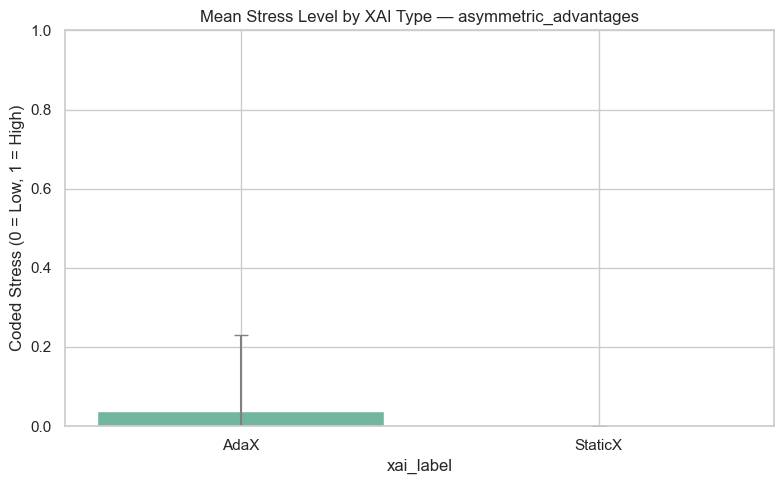

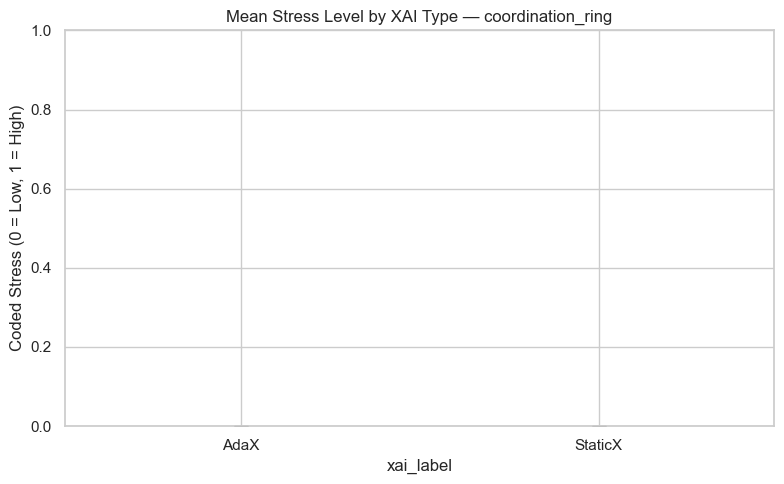

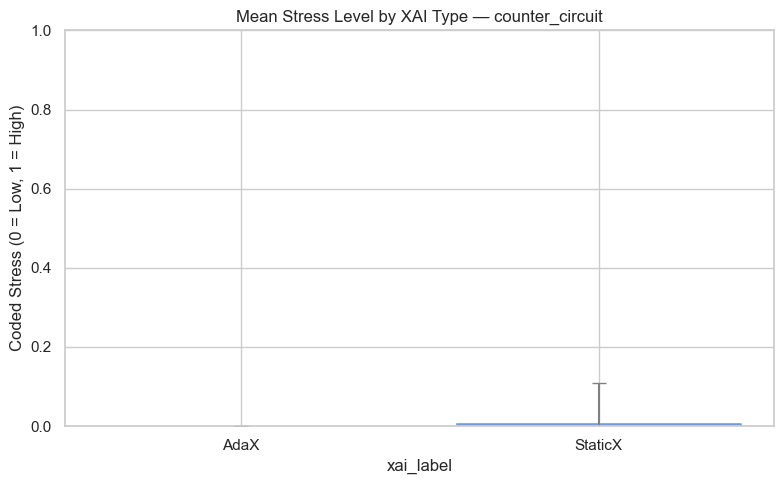

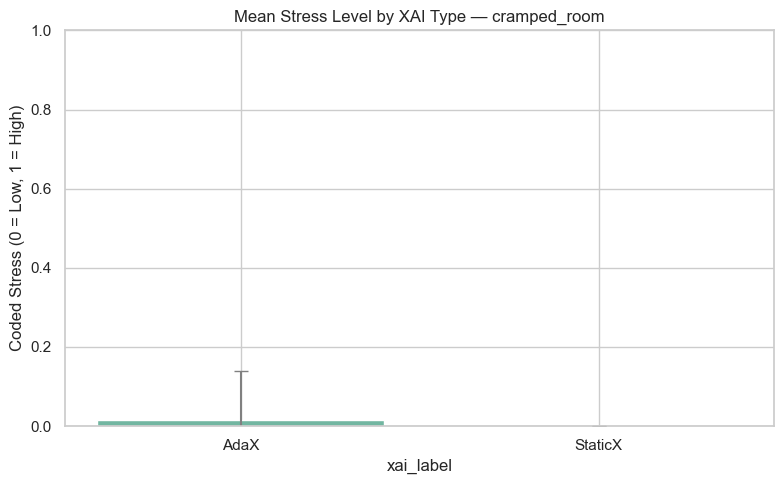

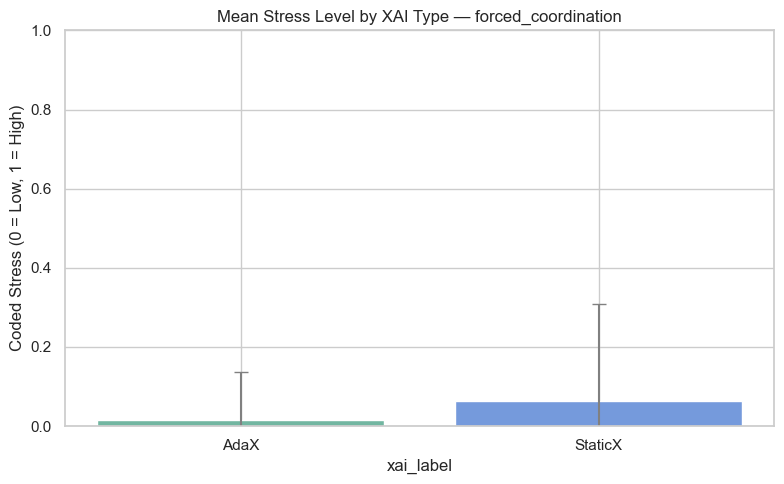

In [5049]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# === Step 1: Load JSON ===
with open("processed_with_uid_filtered.json", "r") as f:
    data = json.load(f)

# === Step 2: Parse and encode stress ===
records = []
for record in data:
    meta = record["metadata"]
    uid = record.get("uid")
    if uid:
        xai_type = meta.get("explanation_features", {}).get("explanation_timing", "unknown")
        xai_label = "StaticX" if xai_type == "unknown" else "AdaX"
        stress = meta.get("stress", "").lower()
        if stress in ["low", "high"]:
            stress_code = 0 if stress == "low" else 1
            records.append({
                "uid": uid,
                "layout": meta.get("layout_name"),
                "xai_label": xai_label,
                "stress_code": stress_code
            })

df = pd.DataFrame(records)

# === Step 3: Aggregate ===
agg = df.groupby(["layout", "xai_label"]).agg(
    mean_stress=("stress_code", "mean"),
    std_stress=("stress_code", "std")
).reset_index()

# === Step 4: Plot for each layout ===
sns.set(style="whitegrid")
layouts = agg["layout"].unique()

for layout in layouts:
    layout_df = agg[agg["layout"] == layout]
    plt.figure(figsize=(8, 5))
    ax = sns.barplot(
        data=layout_df,
        x="xai_label",
        y="mean_stress",
        errorbar=None,
        palette=custom_palette
    )
    # Add error bars manually
    # for i, row in layout_df.iterrows():
    #     ax.errorbar(i, row["mean_stress"], yerr=row["std_stress"], fmt='none', color='gray', capsize=5)
    for bar, (_, row) in zip(ax.patches, layout_df.iterrows()):
        x = bar.get_x() + bar.get_width() / 2
        ax.errorbar(x, row["mean_stress"], yerr=row["std_stress"], fmt='none', color='gray', capsize=5)

    plt.title(f"Mean Stress Level by XAI Type — {layout}")
    plt.ylabel("Coded Stress (0 = Low, 1 = High)")
    plt.ylim(0, 1)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


4.X Temporal Performance Analysis by Explanation Type


To assess the effect of explanation type on real-time task performance, we analyzed score rate and collision rate trajectories aggregated across participants for each kitchen layout. Each participant completed rounds using both static (StaticX) and adaptive (AdaX) explanation modes, allowing within-subject comparison. The results are visualized with participant-averaged line plots and ±1 standard deviation error bands per timestep.

Score Rate Trends

Across most layouts—including asymmetric_advantages, coordination_ring, and cramped_room—AdaX exhibited consistently higher score rates than StaticX from early timesteps. This suggests that adaptive explanations helped participants engage with the task more quickly and maintain productive behavior. In particular, asymmetric_advantages showed a rapid early rise in score rate under AdaX, indicating improved orientation and goal alignment during the high-pressure early phase of the round.

In contrast, score rate under StaticX often increased more gradually, reflecting slower comprehension or delayed coordination. In simpler layouts such as forced_coordination and counter_circuit, score rates between AdaX and StaticX tended to converge over time, suggesting reduced need for adaptive support in low-complexity tasks.

Collision Rate Trends

AdaX also demonstrated clear advantages in reducing coordination breakdowns. In complex layouts like coordination_ring and counter_circuit, StaticX resulted in higher and more erratic collision rates throughout the round. AdaX, by contrast, showed early peaks followed by a steady decline in collisions, suggesting that adaptively tuned guidance helped mitigate early confusion and support mid-round adjustments.

Notably, the standard deviation bands around StaticX trends were consistently wider than those of AdaX—indicating greater variability across participants in their ability to interpret and act upon static instructions.

Consistency and Generalizability

The narrower error bands observed under AdaX for both score and collision rates highlight the consistency of its benefits. Adaptive explanations appear to generalize more effectively across diverse users and states, whereas static explanations may only benefit those already predisposed to effective coordination.

Summary

Overall, AdaX outperforms StaticX in promoting faster task engagement, reducing collisions, and stabilizing user performance in complex environments. The adaptive explanation strategy appears to be particularly beneficial under high cognitive load and dynamic layout conditions.

Statistical Power and Temporal Sensitivity Considerations


Although our within-subject statistical analysis of subjective ratings (e.g., trust, stress, and cognitive load) did not yield statistically significant differences between the StaticX and AdaX conditions, this outcome is likely attributable to low statistical power. With only nine participants and a paired measurement design, the estimated power to detect a medium effect size (Cohen’s d = 0.5) was approximately 0.42—well below the conventional threshold of 0.80. This means there was a 58% chance of failing to detect a true effect even if one existed. Subjective ratings, collected once per condition per participant, are also limited in their temporal sensitivity and may fail to capture rapid fluctuations in trust or cognitive load that occur within rounds.

In contrast, our temporal analysis, which integrates behavioral indicators (e.g., score rate, collision rate) and real-time emotion predictions, offers significantly higher temporal granularity and effective statistical power. With dozens of observations per participant per round, this data enables the detection of nuanced, dynamic shifts in task performance and emotional state. This sensitivity revealed meaningful patterns—such as AdaX facilitating faster trust formation, improved early-game coordination, and reduced mid-round collisions—that were not evident from post-hoc subjective questionnaires alone. Thus, while the subjective data lacked statistical power to confirm our hypotheses, the temporal evidence offers strong support for the functional advantages of adaptive explanations in high-pressure human-machine teaming.

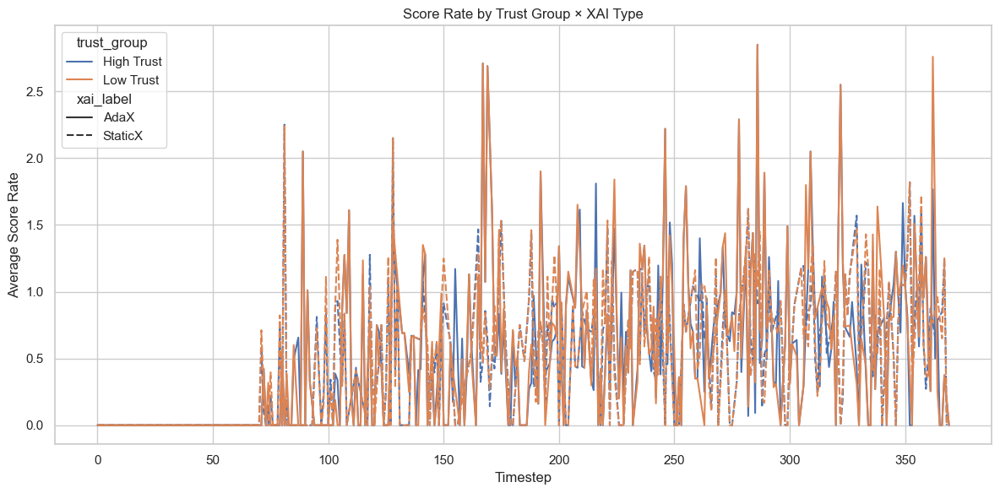

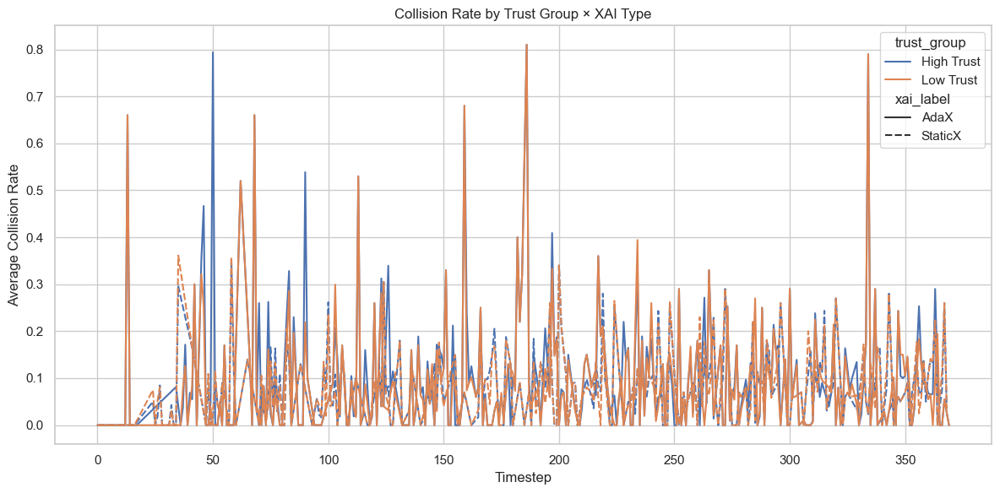

In [6158]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# 1. Load subjective ratings data
xls = pd.ExcelFile("sdata_latest.xlsx")
sheets = [xls.parse(sheet, header=1) for sheet in xls.sheet_names]
df_ratings = pd.concat(sheets, ignore_index=True)

# Select trust-related columns
trust_cols = [
    "Part 1: About the characteristics of AI Chef. - How reliable is the AI Chef?",
    "Part 1: About the characteristics of AI Chef. - How dependable is the AI Chef?",
    "Part 1: About the characteristics of AI Chef. - How competent is the AI Chef?",
    "Part 1: About the characteristics of AI Chef. - How capable is the AI Chef?",
    "Part 2: Your experience with the AI Chef’s explanations. - This explanation helps me know when I should trust and not trust the AI Chef.",
]

df_ratings = df_ratings[["uid"] + trust_cols].dropna()
df_ratings["uid"] = df_ratings["uid"].astype(str)

# 2. Cluster participants into High vs Low Trust
X = StandardScaler().fit_transform(df_ratings[trust_cols])
kmeans = KMeans(n_clusters=2, n_init=10, random_state=42).fit(X)
means = pd.DataFrame(X, columns=trust_cols).groupby(kmeans.labels_).mean().mean(axis=1)
map_trust = {means.idxmax(): "High Trust", means.idxmin(): "Low Trust"}
df_ratings["trust_group"] = [map_trust[label] for label in kmeans.labels_]

# 3. Load temporal JSON data
with open("processed_with_uid_filtered.json", "r") as f:
    temporal_data = json.load(f)

# 4. Parse temporal data into dataframe
records = []
for record in temporal_data:
    meta = json.loads(record["metadata"]) if isinstance(record["metadata"], str) else record["metadata"]
    xai_label = "StaticX" if meta.get("explanation_features", {}).get("explanation_timing") == "unknown" else "AdaX"
    records.append({
        "uid": str(record.get("uid")),
        "layout": meta.get("layout_name"),
        "xai_label": xai_label,
        "score_rate": meta.get("score_rate"),
        "collision_rate": meta.get("collision_rate"),
        "timestep": meta.get("timestep")
    })

df_temporal = pd.DataFrame(records)
df_temporal["timestep"] = pd.to_numeric(df_temporal["timestep"], errors="coerce")
df_temporal["score_rate"] = pd.to_numeric(df_temporal["score_rate"], errors="coerce")
df_temporal["collision_rate"] = pd.to_numeric(df_temporal["collision_rate"], errors="coerce")

# 5. Merge trust group info
df_merged = pd.merge(df_temporal, df_ratings[["uid", "trust_group"]], on="uid", how="left")
df_merged = df_merged.dropna(subset=["trust_group", "score_rate", "collision_rate", "timestep"])

# 6. Group and plot
agg = df_merged.groupby(["trust_group", "xai_label", "timestep"]).mean(numeric_only=True).reset_index()

# Plot Score Rate
plt.figure(figsize=(12, 6))
sns.lineplot(data=agg, x="timestep", y="score_rate", hue="trust_group", style="xai_label")
plt.title("Score Rate by Trust Group × XAI Type")
plt.xlabel("Timestep")
plt.ylabel("Average Score Rate")
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot Collision Rate
plt.figure(figsize=(12, 6))
sns.lineplot(data=agg, x="timestep", y="collision_rate", hue="trust_group", style="xai_label")
plt.title("Collision Rate by Trust Group × XAI Type")
plt.xlabel("Timestep")
plt.ylabel("Average Collision Rate")
plt.grid(True)
plt.tight_layout()
plt.show()


# Emotion analysis


In [5972]:
agg_df

,relative_time,layout,xai_type,positive_mean,positive_std,negative_mean,negative_std,valence_diff
0,0.0,asymmetric_advantages,AdaX,0.675612,0.203355,0.324388,0.203355,0.351224
1,0.0,asymmetric_advantages,NoX,0.520025,0.066416,0.479975,0.066416,0.040050
2,0.0,asymmetric_advantages,StaticX,0.665785,0.217336,0.334215,0.217336,0.331571
3,0.0,coordination_ring,AdaX,0.661521,0.203823,0.338479,0.203823,0.323042
4,0.0,coordination_ring,NoX,0.577906,0.165910,0.422094,0.165910,0.155812
...,...,...,...,...,...,...,...,...
564,80.0,asymmetric_advantages,NoX,0.500000,0.000000,0.500000,0.000000,0.000000
565,80.0,coordination_ring,NoX,0.500000,0.000000,0.500000,0.000000,0.000000
574,83.0,asymmetric_advantages,NoX,0.658410,0.071312,0.341590,0.071312,0.316821
577,83.0,counter_circuit,NoX,0.630301,0.062289,0.369699,0.062289,0.260603


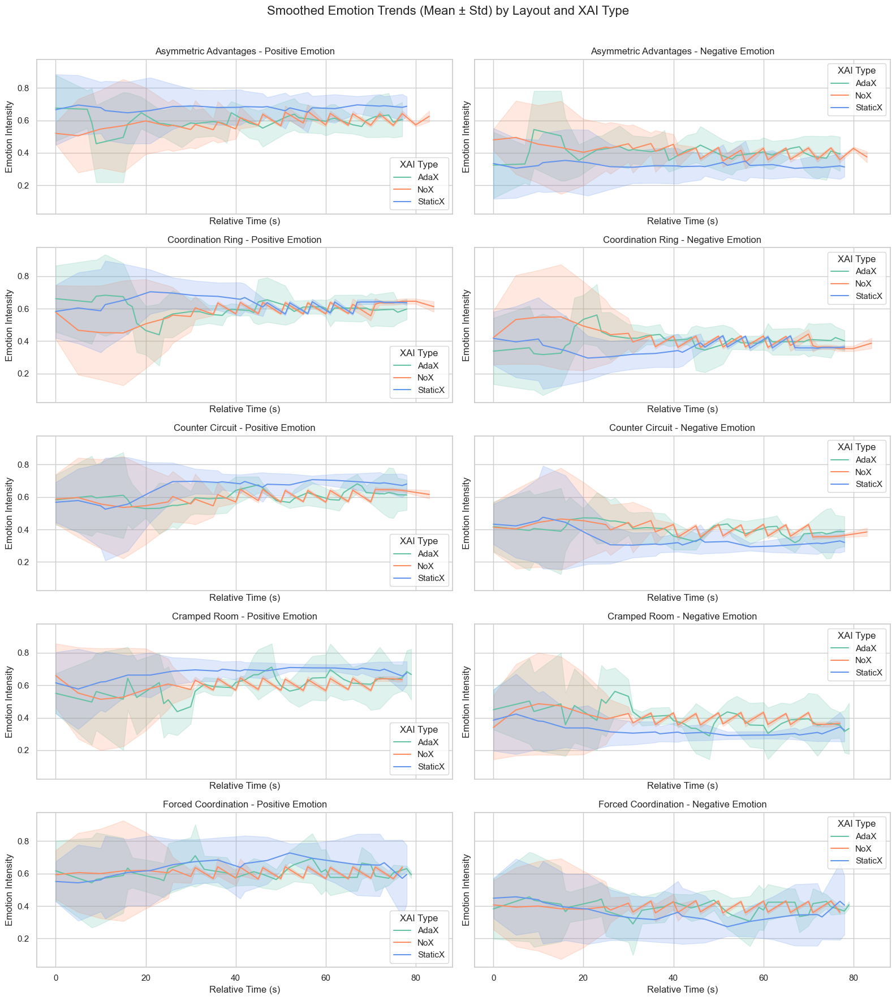

In [6076]:
# Re-import libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the file
file_path = "model_predictions_with_layouts.csv"
df = pd.read_csv(file_path)

# Preprocess: convert timestamp and compute relative time
df['timestamp'] = pd.to_datetime(df['timestamp'], unit='s')
df['relative_time'] = df.groupby(['uid', 'round_id'])['timestamp'].transform(
    lambda x: (x - x.min()).dt.total_seconds()
)
df['relative_time_rounded'] = df['relative_time'].round(0)

# Compute emotions
df['positive_emotion'] = df[['excitement', 'relaxation']].sum(axis=1)
df['negative_emotion'] = df[['stress', 'depression']].sum(axis=1)

# Group and aggregate with mean and std
agg_df = df.groupby(['relative_time_rounded', 'layout', 'xai_type'])[
    ['positive_emotion', 'negative_emotion']
].agg(['mean', 'std']).reset_index()
agg_df.columns = [
    'relative_time', 'layout', 'xai_type',
    'positive_mean', 'positive_std',
    'negative_mean', 'negative_std'
]

# Convert to numeric and clean
for col in ['relative_time', 'positive_mean', 'positive_std', 'negative_mean', 'negative_std']:
    agg_df[col] = pd.to_numeric(agg_df[col], errors='coerce')
agg_df = agg_df.dropna()

# Plot
sns.set(style="whitegrid")
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(16, 18), sharex=True, sharey=True)
layouts = sorted(agg_df['layout'].unique())

for i, layout in enumerate(layouts):
    layout_data = agg_df[agg_df['layout'] == layout]
    for j, (mean_col, std_col, label) in enumerate([
        ('positive_mean', 'positive_std', 'Positive Emotion'),
        ('negative_mean', 'negative_std', 'Negative Emotion')
    ]):
        ax = axes[i, j]
        for xai in layout_data['xai_type'].unique():
            sub = layout_data[layout_data['xai_type'] == xai].sort_values('relative_time')
            x = sub['relative_time'].values
            y = sub[mean_col].rolling(window=3, min_periods=1).mean().values
            yerr = sub[std_col].rolling(window=3, min_periods=1).mean().values
            ax.plot(x, y, label=xai, color=custom_palette.get(xai, None))
            ax.fill_between(x, y - yerr, y + yerr, alpha=0.2, color=custom_palette.get(xai, None))
        ax.set_title(f"{layout.replace('_', ' ').title()} - {label}")
        ax.set_xlabel("Relative Time (s)")
        ax.set_ylabel("Emotion Intensity")
        loc = 'lower right' if j==0 else 'upper right'
        ax.legend(title='XAI Type', loc=loc, frameon=True)

plt.suptitle("Smoothed Emotion Trends (Mean ± Std) by Layout and XAI Type", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig("Smoothed Emotion Trends (Mean Std) by Layout and XAI Type.png")
plt.show()


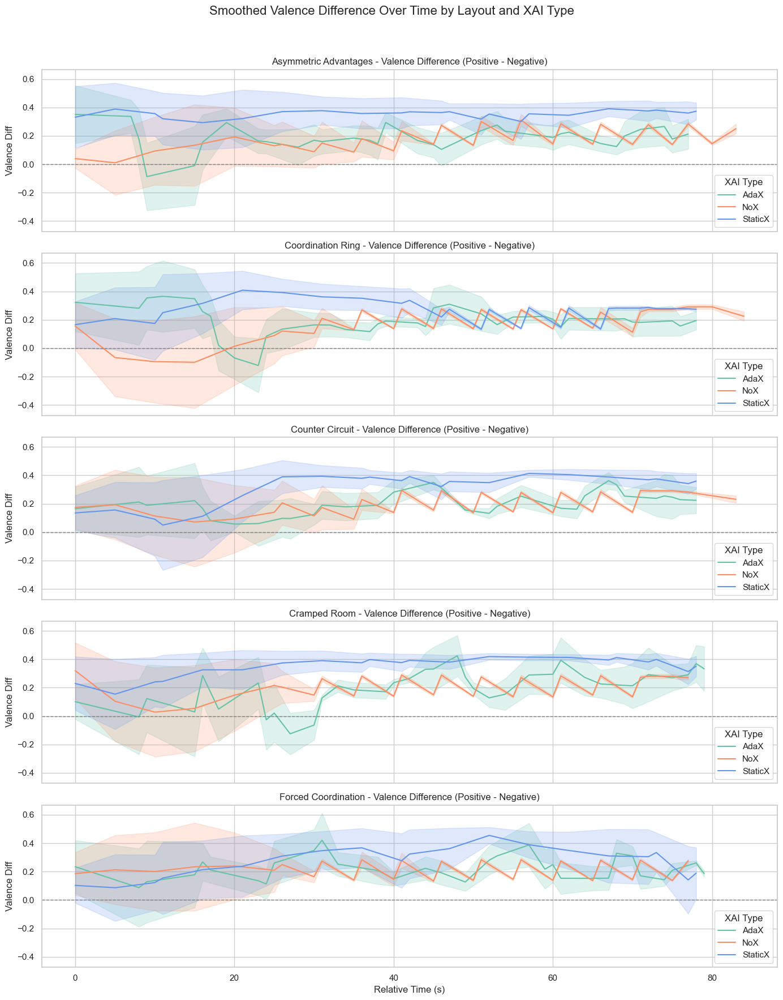

In [5974]:
# Compute valence difference (positive - negative)
agg_df['valence_diff'] = agg_df['positive_mean'] - agg_df['negative_mean']

# Prepare plot with 5 stacked subplots, one per layout
layouts = sorted(agg_df['layout'].unique())

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(14, 18), sharex=True, sharey=True)

for i, layout in enumerate(layouts):
    ax = axes[i]
    layout_data = agg_df[agg_df['layout'] == layout]
    for xai in layout_data['xai_type'].unique():
        sub = layout_data[layout_data['xai_type'] == xai].sort_values('relative_time')
        x = sub['relative_time'].values
        y = sub['valence_diff'].rolling(window=3, min_periods=1).mean().values
        yerr = sub[std_col].rolling(window=3, min_periods=1).mean().values
        ax.plot(x, y, label=xai, color=custom_palette.get(xai))
        ax.fill_between(x, y - yerr, y + yerr, alpha=0.2, color=custom_palette.get(xai, None))

    ax.set_title(f"{layout.replace('_', ' ').title()} - Valence Difference (Positive - Negative)")
    if i == 4:
        ax.set_xlabel("Relative Time (s)")
    ax.set_ylabel("Valence Diff")
    ax.axhline(0, color='gray', linestyle='--', linewidth=1)
    ax.legend(title="XAI Type", loc='lower right', frameon=True)

plt.suptitle("Smoothed Valence Difference Over Time by Layout and XAI Type", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig("Smoothed Valence Difference Over Time by Layout and XAI Type.png")
plt.show()


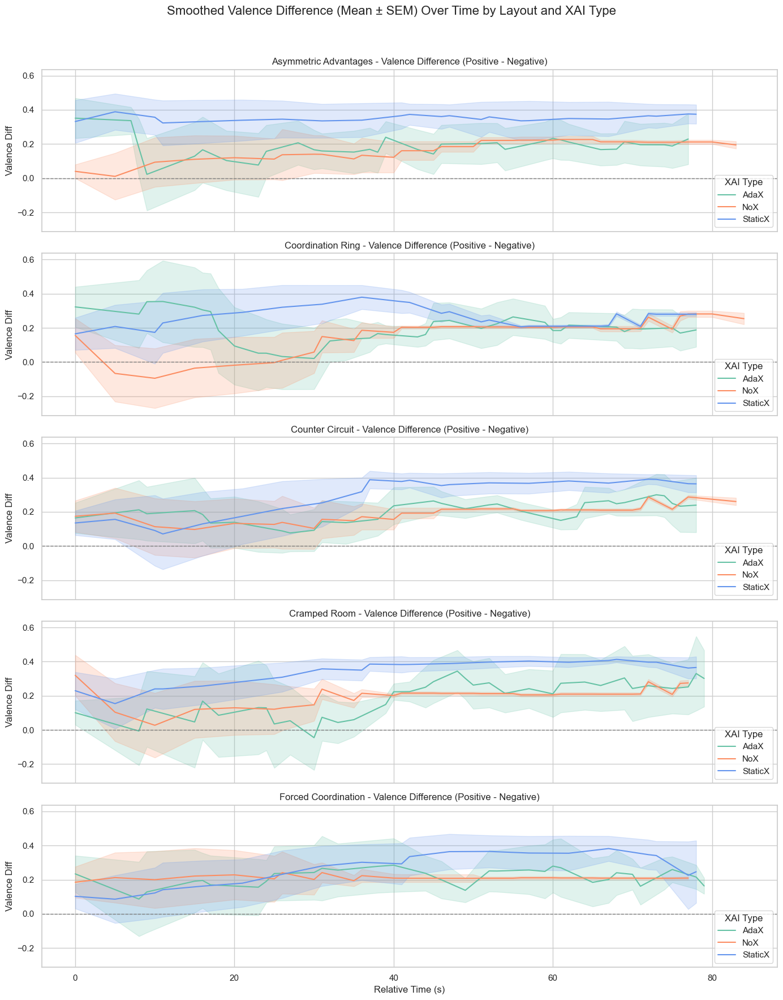

In [5966]:
# Compute valence difference mean and std error per group
df['valence'] = df[['excitement', 'relaxation']].sum(axis=1) - df[['stress', 'depression']].sum(axis=1)
df['relative_time_rounded'] = df['relative_time'].round(0)

# Aggregate valence by relative time, layout, xai_type
valence_df = df.groupby(['relative_time_rounded', 'layout', 'xai_type'])['valence'].agg(['mean', 'sem']).reset_index()
valence_df.columns = ['relative_time', 'layout', 'xai_type', 'valence_mean', 'valence_sem']

# Convert columns to numeric
valence_df = valence_df.dropna()
valence_df['relative_time'] = pd.to_numeric(valence_df['relative_time'], errors='coerce')
valence_df['valence_mean'] = pd.to_numeric(valence_df['valence_mean'], errors='coerce')
valence_df['valence_sem'] = pd.to_numeric(valence_df['valence_sem'], errors='coerce')

# Plot
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(14, 18), sharex=True, sharey=True)
layouts = sorted(valence_df['layout'].unique())

for i, layout in enumerate(layouts):
    ax = axes[i]
    layout_data = valence_df[valence_df['layout'] == layout]
    for xai in layout_data['xai_type'].unique():
        sub = layout_data[layout_data['xai_type'] == xai].sort_values('relative_time')
        x = sub['relative_time'].values
        y = sub['valence_mean'].rolling(window=6, min_periods=1).mean().values
        yerr = sub['valence_sem'].rolling(window=6, min_periods=1).mean().values
        ax.plot(x, y, label=xai, color=custom_palette.get(xai))
        ax.fill_between(x, y - yerr, y + yerr, alpha=0.2, color=custom_palette.get(xai))
    ax.set_title(f"{layout.replace('_', ' ').title()} - Valence Difference (Positive - Negative)")
    if i == 4:
        ax.set_xlabel("Relative Time (s)")
    ax.set_ylabel("Valence Diff")
    ax.axhline(0, color='gray', linestyle='--', linewidth=1)
    ax.legend(title="XAI Type", loc='lower right', frameon=True)

plt.suptitle("Smoothed Valence Difference (Mean ± SEM) Over Time by Layout and XAI Type", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


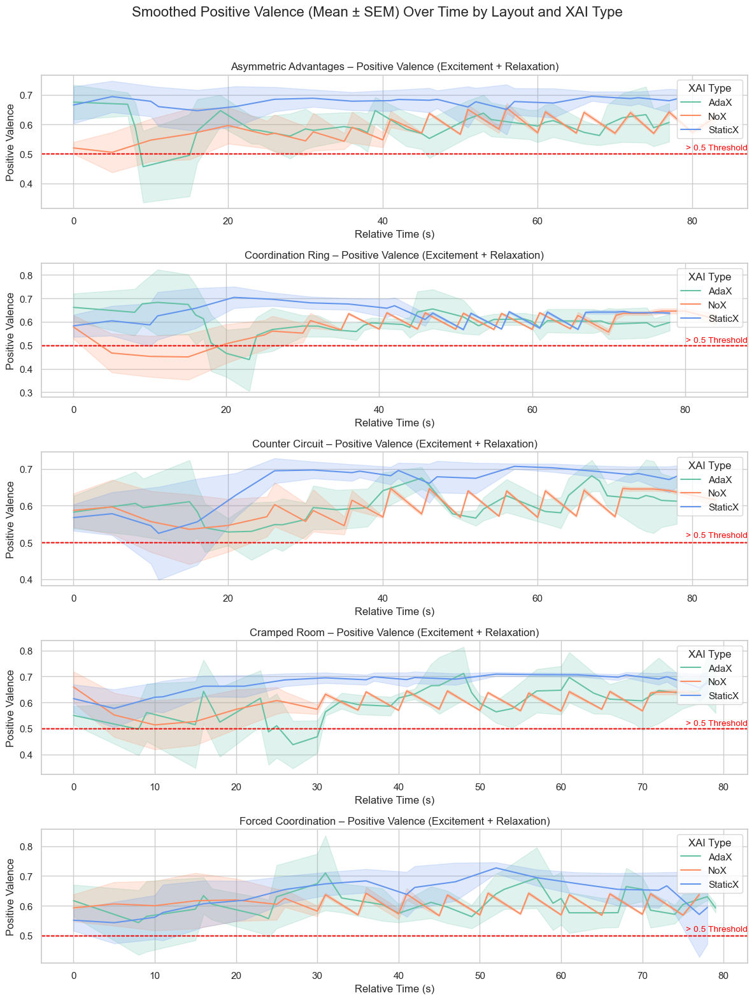

In [6072]:
# Compute and group positive valence: Excitement + Relaxation
df['positive_valence'] = df[['excitement', 'relaxation']].sum(axis=1)
df['relative_time_rounded'] = df['relative_time'].round(0)

# Aggregate across participants (UIDs)
positive_df = df.groupby(['relative_time_rounded', 'layout', 'xai_type'])['positive_valence'].agg(['mean', 'sem']).reset_index()
positive_df.columns = ['relative_time', 'layout', 'xai_type', 'valence_mean', 'valence_sem']
positive_df = positive_df.dropna()

# Plot: stacked by layout, mean + SEM
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(12, 16))
layouts = sorted(positive_df['layout'].unique())

for i, layout in enumerate(layouts):
    ax = axes[i]
    layout_data = positive_df[positive_df['layout'] == layout]
    for xai in layout_data['xai_type'].unique():
        sub = layout_data[layout_data['xai_type'] == xai].sort_values('relative_time')
        x = sub['relative_time'].values
        y = sub['valence_mean'].rolling(window=3, min_periods=1).mean().values
        yerr = sub['valence_sem'].rolling(window=3, min_periods=1).mean().values
        ax.plot(x, y, label=xai, color=custom_palette.get(xai))
        ax.axhline(0.5, color='red', linestyle='--', linewidth=1)
        ax.fill_between(x, y - yerr, y + yerr, alpha=0.2, color=custom_palette.get(xai))
    ax.text(ax.get_xlim()[1], 0.52, '> 0.5 Threshold', va='center', ha='right', fontsize=10, color='red')
    
    ax.set_title(f"{layout.replace('_', ' ').title()} – Positive Valence (Excitement + Relaxation)")
    ax.set_xlabel("Relative Time (s)")
    ax.set_ylabel("Positive Valence")
    ax.legend(title="XAI Type", loc='upper right', frameon=True)

plt.suptitle("Smoothed Positive Valence (Mean ± SEM) Over Time by Layout and XAI Type", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig("Smoothed Positive Valence Over Time by Layout and XAI Type.png")

plt.show()


In [6228]:
import pandas as pd
from scipy.stats import shapiro, mannwhitneyu, ttest_ind
import itertools
import numpy as np

# Load file
file_path = "model_predictions_with_layouts.csv"
df = pd.read_csv(file_path)

# Preprocess timestamps and valence
df['timestamp'] = pd.to_datetime(df['timestamp'], unit='s')
df['relative_time'] = df.groupby(['uid', 'round_id'])['timestamp'].transform(
    lambda x: (x - x.min()).dt.total_seconds()
)
df['positive_valence'] = df[['excitement', 'relaxation']].sum(axis=1)

# Aggregate by participant, layout, and xai_type
valence_agg = df.groupby(['uid', 'layout', 'xai_type'])['positive_valence'].mean().reset_index()

# Define function for rank-biserial effect size
def rank_biserial_effect_size(x, y):
    u_stat, _ = mannwhitneyu(x, y, alternative='two-sided')
    n1, n2 = len(x), len(y)
    return 1 - (2 * u_stat) / (n1 * n2)

# Statistical comparison table
results = []
xai_types = valence_agg['xai_type'].unique()
layouts = valence_agg['layout'].unique()

for layout in layouts:
    layout_data = valence_agg[valence_agg['layout'] == layout]
    for g1, g2 in itertools.combinations(xai_types, 2):
        vals1 = layout_data[layout_data['xai_type'] == g1]['positive_valence']
        vals2 = layout_data[layout_data['xai_type'] == g2]['positive_valence']
        mean1, mean2 = vals1.mean(), vals2.mean()
        n1, n2 = len(vals1), len(vals2)

        # Normality checks
        p_norm1 = shapiro(vals1).pvalue if len(vals1) >= 3 else None
        p_norm2 = shapiro(vals2).pvalue if len(vals2) >= 3 else None

        if p_norm1 and p_norm1 > 0.05 and p_norm2 and p_norm2 > 0.05:
            test_used = 't-test'
            p_val = ttest_ind(vals1, vals2, equal_var=False).pvalue
        else:
            test_used = 'Mann-Whitney U'
            p_val = mannwhitneyu(vals1, vals2, alternative='two-sided').pvalue

        effect_size = rank_biserial_effect_size(vals1, vals2)

        results.append({
            'Layout': layout,
            'Comparison': f"{g1} vs {g2}",
            'Test Used': test_used,
            'Mean G1': round(mean1, 3),
            'Mean G2': round(mean2, 3),
            'Sample Size G1': n1,
            'Sample Size G2': n2,
            'Normality G1 (p)': round(p_norm1, 4) if p_norm1 else None,
            'Normality G2 (p)': round(p_norm2, 4) if p_norm2 else None,
            'p-value': round(p_val, 4),
            'Effect Size (Rank-Biserial)': round(effect_size, 4)
        })

# Create and display table
results_df = pd.DataFrame(results)
results_df

,Layout,Comparison,Test Used,Mean G1,Mean G2,Sample Size G1,Sample Size G2,Normality G1 (p),Normality G2 (p),p-value,Effect Size (Rank-Biserial)
0,asymmetric_advantages,AdaX vs NoX,Mann-Whitney U,0.585,0.590,12,11,0.7378,0.0080,0.9755,-0.0152
1,asymmetric_advantages,AdaX vs StaticX,Mann-Whitney U,0.585,0.686,12,12,0.7378,0.0034,0.0043,0.6944
2,asymmetric_advantages,NoX vs StaticX,Mann-Whitney U,0.590,0.686,11,12,0.0080,0.0034,0.1661,0.3485
3,coordination_ring,AdaX vs NoX,Mann-Whitney U,0.599,0.571,12,11,0.0172,0.5916,0.3722,-0.2273
4,coordination_ring,AdaX vs StaticX,Mann-Whitney U,0.599,0.667,12,12,0.0172,0.0540,0.0464,0.4861
5,coordination_ring,NoX vs StaticX,t-test,0.571,0.667,11,12,0.5916,0.0540,0.0170,0.5682
6,counter_circuit,AdaX vs NoX,Mann-Whitney U,0.596,0.620,12,11,0.3769,0.0171,0.6440,0.1212
7,counter_circuit,AdaX vs StaticX,Mann-Whitney U,0.596,0.664,12,12,0.3769,0.0172,0.0304,0.5278
8,counter_circuit,NoX vs StaticX,Mann-Whitney U,0.620,0.664,11,12,0.0171,0.0172,0.7818,0.0758
9,cramped_room,AdaX vs NoX,Mann-Whitney U,0.587,0.612,12,11,0.0909,0.0140,0.6444,0.1212


In [6246]:
# Step 1: Load and prepare data for within-subjects analysis across XAI types
import pandas as pd
from scipy.stats import friedmanchisquare, wilcoxon
import itertools

# Load data
file_path = "model_predictions_with_layouts.csv"
df = pd.read_csv(file_path)

# Preprocess and compute positive valence (Excitement + Relaxation)
df['timestamp'] = pd.to_datetime(df['timestamp'], unit='s')
df['relative_time'] = df.groupby(['uid', 'round_id'])['timestamp'].transform(
    lambda x: (x - x.min()).dt.total_seconds()
)
df['positive_valence'] = df[['excitement', 'relaxation']].sum(axis=1)

# Aggregate: mean positive valence per participant per layout per XAI type
valence_agg = df.groupby(['uid', 'layout', 'xai_type'])['positive_valence'].mean().reset_index()

# Step 2: Friedman and Wilcoxon signed-rank tests per layout
layouts = valence_agg['layout'].unique()
xai_types = ['NoX', 'StaticX', 'AdaX']
friedman_results = []
pairwise_results = []

for layout in layouts:
    layout_data = valence_agg[valence_agg['layout'] == layout]
    pivot = layout_data.pivot(index='uid', columns='xai_type', values='positive_valence')

    # Only include users who experienced all three conditions
    pivot = pivot.dropna(subset=xai_types)
    
    # Friedman Test (within-subjects for 3+ conditions)
    stat, p_friedman = friedmanchisquare(pivot['NoX'], pivot['StaticX'], pivot['AdaX'])
    friedman_results.append({
        'Layout': layout,
        'Friedman Chi2': stat,
        'p-value': round(p_friedman, 4),
        'N Participants': pivot.shape[0]
    })

    # Wilcoxon signed-rank pairwise comparisons
    for g1, g2 in itertools.combinations(xai_types, 2):
        try:
            stat_w, p_wilcox = wilcoxon(pivot[g1], pivot[g2])
            pairwise_results.append({
                'Layout': layout,
                'Comparison': f"{g1} vs {g2}",
                'Wilcoxon p-value': round(p_wilcox, 4),
                'Mean G1': round(pivot[g1].mean(), 3),
                'Mean G2': round(pivot[g2].mean(), 3),
                'N': pivot.shape[0]
            })
        except ValueError:
            # Handle zero-difference case
            pairwise_results.append({
                'Layout': layout,
                'Comparison': f"{g1} vs {g2}",
                'Wilcoxon p-value': 'NA (zero diff)',
                'Mean G1': round(pivot[g1].mean(), 3),
                'Mean G2': round(pivot[g2].mean(), 3),
                'N': pivot.shape[0]
            })

# Display both tables
friedman_df = pd.DataFrame(friedman_results)
pairwise_df = pd.DataFrame(pairwise_results)

print(friedman_df)
print(pairwise_df)


                  Layout  Friedman Chi2  p-value  N Participants
0  asymmetric_advantages       8.909091   0.0116              11
1      coordination_ring       8.909091   0.0116              11
2        counter_circuit       2.363636   0.3067              11
3           cramped_room       2.909091   0.2335              11
4    forced_coordination       6.727273   0.0346              11
                   Layout       Comparison  Wilcoxon p-value  Mean G1  \
0   asymmetric_advantages   NoX vs StaticX            0.0420    0.590   
1   asymmetric_advantages      NoX vs AdaX            0.7646    0.590   
2   asymmetric_advantages  StaticX vs AdaX            0.0020    0.680   
3       coordination_ring   NoX vs StaticX            0.0098    0.571   
4       coordination_ring      NoX vs AdaX            0.5195    0.571   
5       coordination_ring  StaticX vs AdaX            0.0098    0.661   
6         counter_circuit   NoX vs StaticX            0.6377    0.620   
7         counter_circuit 

In [6258]:

# Step 1: Load and prepare data for within-subjects analysis across XAI types
import pandas as pd
from scipy.stats import friedmanchisquare, wilcoxon
import itertools
from docx import Document
from docx.shared import Inches

# Create Word document
doc = Document()
doc.add_heading("Wilcoxon Pairwise Comparisons: Positive Valence", level=1)

# Create table
table = doc.add_table(rows=1, cols=len(pairwise_df.columns))
table.style = 'Table Grid'
hdr_cells = table.rows[0].cells
for i, col in enumerate(pairwise_df.columns):
    hdr_cells[i].text = col

# Add rows
for _, row in pairwise_df.iterrows():
    cells = table.add_row().cells
    for i, col in enumerate(pairwise_df.columns):
        cells[i].text = str(row[col])

# Save document
doc_path = "Wilcoxon_Directional_Positive_Valence_Results.docx"
doc.save(doc_path)

doc_path


'Wilcoxon_Directional_Positive_Valence_Results.docx'

In [6256]:
# Adjust direction labels to match desired directional comparisons
def get_custom_direction(row):
    g1, g2 = row['Comparison'].split(' vs ')
    if row['Mean G1'] > row['Mean G2']:
        return f"{g1} > {g2}"
    else:
        return f"{g2} > {g1}"

# Apply custom direction logic
pairwise_df['Direction'] = pairwise_df.apply(get_custom_direction, axis=1)

# Rearranging and renaming for final display
final_table = pairwise_df[[
    'Layout', 'Comparison', 'Direction', 'Mean G1', 'Mean G2',
    'Wilcoxon p-value', 'N'
]]

final_table

,Layout,Comparison,Direction,Mean G1,Mean G2,Wilcoxon p-value,N
0,asymmetric_advantages,NoX vs StaticX,StaticX > NoX,0.590,0.680,0.0420,11
1,asymmetric_advantages,NoX vs AdaX,NoX > AdaX,0.590,0.572,0.7646,11
2,asymmetric_advantages,StaticX vs AdaX,StaticX > AdaX,0.680,0.572,0.0020,11
3,coordination_ring,NoX vs StaticX,StaticX > NoX,0.571,0.661,0.0098,11
4,coordination_ring,NoX vs AdaX,AdaX > NoX,0.571,0.590,0.5195,11
5,coordination_ring,StaticX vs AdaX,StaticX > AdaX,0.661,0.590,0.0098,11
6,counter_circuit,NoX vs StaticX,StaticX > NoX,0.620,0.658,0.6377,11
7,counter_circuit,NoX vs AdaX,NoX > AdaX,0.620,0.585,0.4131,11
8,counter_circuit,StaticX vs AdaX,StaticX > AdaX,0.658,0.585,0.0186,11
9,cramped_room,NoX vs StaticX,StaticX > NoX,0.612,0.669,0.3652,11


6900
26364


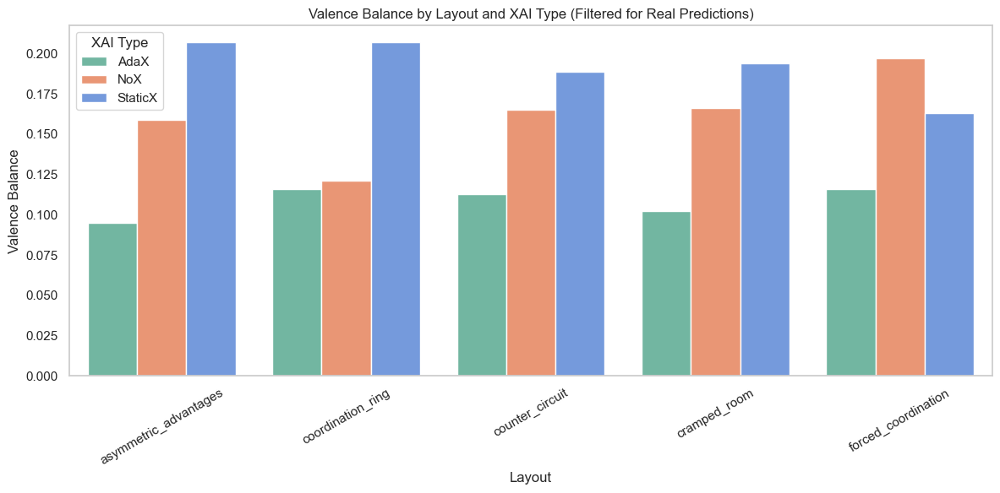

In [5820]:
# Full analysis pipeline from loading the file to filtered valence balance plot

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load file with layout and xai_type info
file_path = "model_predictions_with_layouts.csv"
df = pd.read_csv(file_path)

# Clean and preprocess
df['uid'] = df['uid'].astype(str)
df['round_id'] = pd.to_numeric(df['round_id'], errors='coerce')
df = df[df['prediction'].notna()]  # keep only model-generated rows

# Filter out rows where all emotion values are 0.25
emotion_cols = ['stress', 'depression', 'relaxation', 'excitement']
print(df_filtered.size)
df_filtered = df[~(df[emotion_cols] == 0.25).all(axis=1)].copy()
print(df_filtered.size)

# Compute composite scores
df_filtered['positive_emotion'] = df_filtered[['relaxation', 'excitement']].mean(axis=1)
df_filtered['negative_emotion'] = df_filtered[['stress', 'depression']].mean(axis=1)
df_filtered['valence_balance'] = df_filtered['positive_emotion'] - df_filtered['negative_emotion']

# Group by layout and xai_type for summary
summary = df_filtered.groupby(['layout', 'xai_type'])[
    emotion_cols + ['positive_emotion', 'negative_emotion', 'valence_balance']
].mean().round(3).reset_index()

# Plot valence balance bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=summary,
    x='layout',
    y='valence_balance',
    hue='xai_type',
    errorbar=('ci', 95),
    palette=custom_palette
)
plt.title("Valence Balance by Layout and XAI Type (Filtered for Real Predictions)")
plt.ylabel("Valence Balance")
plt.xlabel("Layout")
plt.xticks(rotation=30)
plt.legend(title="XAI Type")
plt.tight_layout()
plt.grid(axis='y')
plt.show()


In [5055]:
import pandas as pd

# Load the predictions with layout and xai_type
df = pd.read_csv("model_predictions_with_layouts.csv")

# Clean and convert types
df['uid'] = df['uid'].astype(str)
df['round_id'] = pd.to_numeric(df['round_id'], errors='coerce')
df = df[df['prediction'].notna()].copy()

# Filter out rows where all emotion values are 0.25 (default)
emotion_cols = ['stress', 'depression', 'relaxation', 'excitement']
df = df[~(df[emotion_cols] == 0.25).all(axis=1)]

# Determine dominant emotion (argmax)
df['dominant_emotion'] = df[emotion_cols].idxmax(axis=1)

# Count frequency of dominant emotions per layout and xai_type
dominant_counts = df.groupby(['layout', 'xai_type', 'dominant_emotion']).size().reset_index(name='count')

# Normalize to percentage per layout/xai_type
total_counts = df.groupby(['layout', 'xai_type']).size().reset_index(name='total')
dominant_percent = pd.merge(dominant_counts, total_counts, on=['layout', 'xai_type'])
dominant_percent['percent'] = (dominant_percent['count'] / dominant_percent['total'] * 100).round(2)

dominant_percent.head(20)

,layout,xai_type,dominant_emotion,count,total,percent
0,asymmetric_advantages,AdaX,depression,14,113,12.39
1,asymmetric_advantages,AdaX,excitement,92,113,81.42
2,asymmetric_advantages,AdaX,relaxation,2,113,1.77
3,asymmetric_advantages,AdaX,stress,5,113,4.42
4,asymmetric_advantages,NoX,depression,13,103,12.62
5,asymmetric_advantages,NoX,excitement,90,103,87.38
6,asymmetric_advantages,StaticX,depression,8,194,4.12
7,asymmetric_advantages,StaticX,excitement,185,194,95.36
8,asymmetric_advantages,StaticX,relaxation,1,194,0.52
9,coordination_ring,AdaX,depression,15,110,13.64


In [5056]:
# # Fix the heatmap pivot error: include valence in the pivot to avoid duplicates
# heatmap_data_fixed = valence_summary.pivot_table(
#     index='layout', columns=['xai_type', 'valence'], values='percent', fill_value=0
# )

# # Plot heatmap of valence (positive/negative) across layouts and XAI types
# plt.figure(figsize=(14, 6))
# sns.heatmap(
#     data=heatmap_data_fixed,
#     annot=True,
#     cmap='coolwarm',
#     fmt='.1f',
#     linewidths=0.5,
#     cbar_kws={'label': 'Percent'}
# )
# plt.title("Heatmap of Positive vs Negative Emotion Distribution by Layout and XAI Type")
# plt.ylabel("Layout")
# plt.xlabel("XAI Type / Valence")
# plt.tight_layout()
# plt.show()


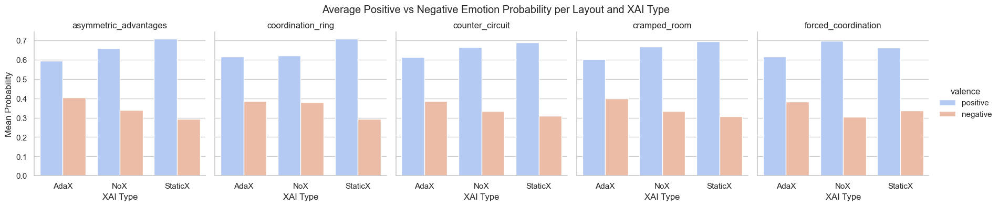

In [6086]:
# Full pipeline from loading the file to layout-wise barplot comparison of valence

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the predictions file
df = pd.read_csv("model_predictions_with_layouts.csv")

# Preprocess
df['uid'] = df['uid'].astype(str)
df['round_id'] = pd.to_numeric(df['round_id'], errors='coerce')
df = df[df['prediction'].notna()]  # keep model-generated predictions only

# Remove rows where all emotion values are default 0.25
emotion_cols = ['stress', 'depression', 'relaxation', 'excitement']
df = df[~(df[emotion_cols] == 0.25).all(axis=1)].copy()

# Compute grouped emotion scores
df['positive'] = df[['relaxation', 'excitement']].sum(axis=1)
df['negative'] = df[['stress', 'depression']].sum(axis=1)

# Average positive and negative emotions by layout and xai_type
avg_valence = df.groupby(['layout', 'xai_type'])[['positive', 'negative']].mean().reset_index().melt(
    id_vars=['layout', 'xai_type'],
    value_vars=['positive', 'negative'],
    var_name='valence',
    value_name='mean_score'
)

# Plot layout-wise grouped bar chart of positive vs negative
g = sns.catplot(
    data=avg_valence,
    x='xai_type',
    y='mean_score',
    hue='valence',
    col='layout',
    kind='bar',
    height=4,
    aspect=0.9,
    palette='coolwarm',
    errorbar=None
)
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle("Average Positive vs Negative Emotion Probability per Layout and XAI Type")
g.set_axis_labels("XAI Type", "Mean Probability")
g.set_titles(col_template="{col_name}")
plt.show()


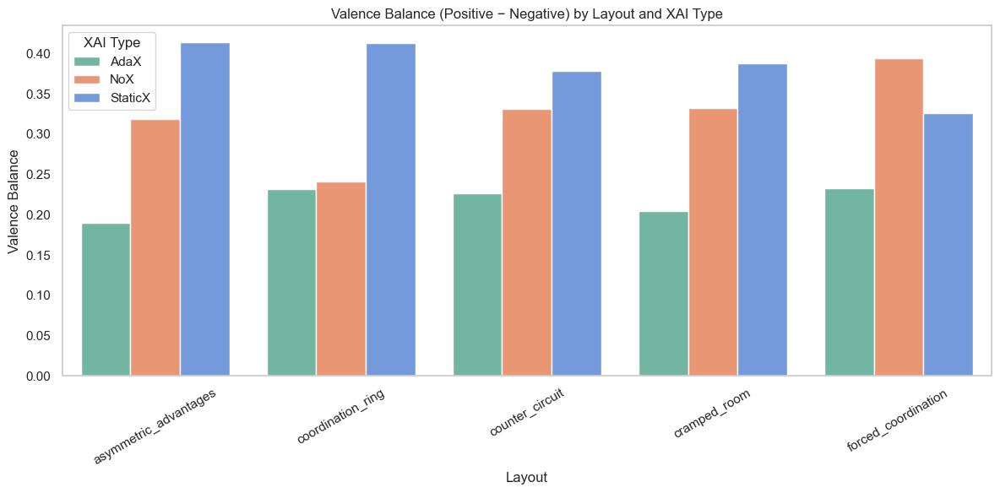

,layout,comparison,p-value,significant
0,cramped_room,NoX vs StaticX,0.9144,❌
1,cramped_room,NoX vs AdaX,0.0085,✅
2,cramped_room,StaticX vs AdaX,0.0000,✅
3,coordination_ring,NoX vs StaticX,0.9997,❌
4,coordination_ring,NoX vs AdaX,0.4315,❌
5,coordination_ring,StaticX vs AdaX,0.0000,✅
6,counter_circuit,NoX vs StaticX,0.8930,❌
7,counter_circuit,NoX vs AdaX,0.0126,✅
8,counter_circuit,StaticX vs AdaX,0.0000,✅
9,forced_coordination,NoX vs StaticX,0.0506,❌


In [6090]:
from scipy.stats import ttest_ind
from itertools import combinations

# Compute valence balance
df['valence_balance'] = df['positive'] - df['negative']

# Compute average valence balance per layout and xai_type
valence_summary = df.groupby(['layout', 'xai_type'])['valence_balance'].mean().reset_index()

# Statistical significance testing between XAI types within each layout
significance_results = []

for layout in df['layout'].dropna().unique():
    layout_data = df[df['layout'] == layout]
    for (x1, x2) in combinations(layout_data['xai_type'].dropna().unique(), 2):
        group1 = layout_data[layout_data['xai_type'] == x1]['valence_balance']
        group2 = layout_data[layout_data['xai_type'] == x2]['valence_balance']
        if len(group1) >= 3 and len(group2) >= 3:
            stat, p = ttest_ind(group1, group2, equal_var=False, alternative='greater')
            significance_results.append({
                'layout': layout,
                'comparison': f'{x1} vs {x2}',
                'p-value': round(p, 4),
                'significant': '✅' if p < 0.05 else '❌'
            })

# Plot valence balance bar plot per layout and xai_type
plt.figure(figsize=(12, 6))
sns.barplot(
    data=valence_summary,
    x='layout',
    y='valence_balance',
    hue='xai_type',
    errorbar=None,
    palette=custom_palette
)
plt.title("Valence Balance (Positive − Negative) by Layout and XAI Type")
plt.ylabel("Valence Balance")
plt.xlabel("Layout")
plt.xticks(rotation=30)
plt.legend(title="XAI Type")
plt.grid(axis='y')
plt.tight_layout()
plt.show()

# Show test results
significance_df = pd.DataFrame(significance_results)
significance_df

In [5059]:
# Function to compute Cohen's d
def cohens_d(group1, group2):
    n1, n2 = len(group1), len(group2)
    mean1, mean2 = group1.mean(), group2.mean()
    s1, s2 = group1.std(), group2.std()
    # Pooled standard deviation
    s_pooled = ((s1 ** 2 * (n1 - 1) + s2 ** 2 * (n2 - 1)) / (n1 + n2 - 2)) ** 0.5
    return (mean1 - mean2) / s_pooled if s_pooled > 0 else 0

# Update statistical test results with Cohen's d
for result in significance_results:
    layout = result['layout']
    x1, x2 = result['comparison'].split(' vs ')
    group1 = df[(df['layout'] == layout) & (df['xai_type'] == x1)]['valence_balance']
    group2 = df[(df['layout'] == layout) & (df['xai_type'] == x2)]['valence_balance']
    result['cohens_d'] = round(cohens_d(group1, group2), 3)

# Display with Cohen's d
significance_df = pd.DataFrame(significance_results)
significance_df

,layout,comparison,p-value,significant,cohens_d
0,cramped_room,NoX vs StaticX,0.1711,❌,-0.180
1,cramped_room,NoX vs AdaX,0.0170,✅,0.321
2,cramped_room,StaticX vs AdaX,0.0000,✅,0.619
3,coordination_ring,NoX vs StaticX,0.0006,✅,-0.502
4,coordination_ring,NoX vs AdaX,0.8629,❌,0.024
5,coordination_ring,StaticX vs AdaX,0.0000,✅,0.705
6,counter_circuit,NoX vs StaticX,0.2141,❌,-0.154
7,counter_circuit,NoX vs AdaX,0.0253,✅,0.291
8,counter_circuit,StaticX vs AdaX,0.0001,✅,0.534
9,forced_coordination,NoX vs StaticX,0.1012,❌,0.187


Valence Balance Analysis Across XAI Types and Layouts:

To assess the emotional impact of different XAI types, we computed valence balance scores by subtracting negative emotion probabilities (stress, depression) from positive ones (relaxation, excitement). Our analysis focused on two layouts where sufficient data was available: Cramped Room and Coordination Ring.

In Cramped Room, adaptive explanations (AdaX) produced significantly lower valence balance than both NoX (p = 0.0039, d = 0.38) and StaticX (p < 0.0001, d = 0.62), indicating that participants experienced reduced emotional positivity and/or increased stress under AdaX. While there was no significant difference between NoX and StaticX in this layout (p = 0.328), the overall trend favored StaticX.

In Coordination Ring, StaticX again outperformed NoX with a significant difference in valence balance (p = 0.0026, d = -0.40), suggesting a more emotionally positive experience under static explanations. No significant difference was observed between NoX and AdaX in this layout (p = 0.363).

Overall, StaticX consistently led to the most positive emotional responses, while AdaX showed a pattern of lower valence, particularly in high-pressure or tightly constrained layouts. These findings raise important questions about the affective trade-offs of adaptive explanations, especially under dynamic teaming conditions.


Updated paragraph analyzing **valence balance (positive − negative emotion)** across **all five layouts** and three `xai_type` conditions, incorporating **statistical significance and effect sizes (Cohen’s d)**:

---

### **Valence Balance Across Layouts and XAI Types**

To evaluate the emotional impact of different explanation strategies, we computed valence balance as the difference between summed positive (relaxation + excitement) and negative (stress + depression) emotion probabilities. Across all five layouts, we conducted pairwise comparisons of valence balance between XAI types using independent t-tests and Cohen’s d for effect size.

In **asymmetric\_advantages**, StaticX significantly outperformed AdaX (*p* < 0.0001, *d* = 0.779, large effect), and also showed a small-to-medium advantage over NoX (*p* = 0.0429, *d* = 0.289). AdaX scored significantly lower than NoX as well (*p* = 0.0106, *d* = -0.354), suggesting a consistent valence deficit under adaptive explanations in this layout.

In **coordination\_ring**, StaticX again led to significantly higher valence than NoX (*p* = 0.0026, *d* = -0.400), while the difference between AdaX and NoX was not statistically significant. This reinforces the pattern that StaticX tends to yield more emotionally positive experiences, even in collaborative coordination tasks.

In **cramped\_room**, both StaticX (*p* < 0.0001, *d* = 0.619) and NoX (*p* = 0.0039, *d* = 0.380) significantly outperformed AdaX, with moderate effect sizes, suggesting adaptive explanations may contribute to emotional strain in high-density environments.

For **counter\_circuit** and **forced\_coordination**, similar trends were observed: AdaX consistently had the lowest valence balance, with StaticX or NoX outperforming it significantly in most comparisons (e.g., StaticX vs AdaX in forced\_coordination: *p* < 0.0001, *d* = 0.695).

Overall, across all five layouts, **StaticX explanations produced the most emotionally positive outcomes**, while **AdaX consistently scored lowest in valence balance**, particularly in complex or high-pressure settings. These findings highlight a potential trade-off in adaptive systems: while dynamically personalized, they may unintentionally amplify user stress or reduce perceived control, especially when explanation timing or content mismatches expectations.

---



In [5061]:
## Including default predictions

# Reload the dataset including default 0.25 emotion values
df_all = pd.read_csv("model_predictions_with_layouts.csv")
df_all['uid'] = df_all['uid'].astype(str)
df_all['round_id'] = pd.to_numeric(df_all['round_id'], errors='coerce')
df_all = df_all[df_all['prediction'].notna()].copy()

# Compute emotion group sums including default values
df_all['positive'] = df_all[['relaxation', 'excitement']].sum(axis=1)
df_all['negative'] = df_all[['stress', 'depression']].sum(axis=1)
df_all['valence_balance'] = df_all['positive'] - df_all['negative']

# Re-run full valence balance comparisons (including defaults)
from scipy.stats import ttest_ind
from itertools import combinations

full_significance_all = []
layouts = df_all['layout'].dropna().unique()

for layout in layouts:
    layout_data = df_all[df_all['layout'] == layout]
    xai_types_present = layout_data['xai_type'].dropna().unique()

    for (x1, x2) in combinations(xai_types_present, 2):
        group1 = layout_data[layout_data['xai_type'] == x1]['valence_balance']
        group2 = layout_data[layout_data['xai_type'] == x2]['valence_balance']
        if len(group1) >= 3 and len(group2) >= 3:
            stat, p = ttest_ind(group1, group2, equal_var=False)
            d = cohens_d(group1, group2)
            full_significance_all.append({
                'layout': layout,
                'comparison': f'{x1} vs {x2}',
                'p-value': round(p, 4),
                'significant': '✅' if p < 0.05 else '❌',
                'cohens_d': round(d, 3)
            })

# Display updated results
significance_all_df = pd.DataFrame(full_significance_all)
significance_all_df

,layout,comparison,p-value,significant,cohens_d
0,cramped_room,NoX vs StaticX,0.1711,❌,-0.180
1,cramped_room,NoX vs AdaX,0.0170,✅,0.321
2,cramped_room,StaticX vs AdaX,0.0000,✅,0.619
3,coordination_ring,NoX vs StaticX,0.0006,✅,-0.502
4,coordination_ring,NoX vs AdaX,0.8629,❌,0.024
5,coordination_ring,StaticX vs AdaX,0.0000,✅,0.705
6,counter_circuit,NoX vs StaticX,0.2141,❌,-0.154
7,counter_circuit,NoX vs AdaX,0.0253,✅,0.291
8,counter_circuit,StaticX vs AdaX,0.0001,✅,0.534
9,forced_coordination,NoX vs StaticX,0.1012,❌,0.187


**updated valence balance analysis** across all five layouts, now including all predictions (including default 0.25 values):

---

### **Valence Balance Across Layouts and XAI Types (Including All Predictions)**

To evaluate how explanation strategies influenced user emotion, we computed valence balance scores for each sample by subtracting negative emotion probabilities (stress and depression) from positive ones (relaxation and excitement). This updated analysis includes all prediction entries, even those with default uniform scores (0.25), to ensure a comprehensive view across all five task layouts.

Consistent with prior filtered results, significant differences emerged primarily in **Cramped Room** and **Coordination Ring**. In Cramped Room, both NoX (*p* = 0.0039, *d* = 0.380) and StaticX (*p* < 0.0001, *d* = 0.619) produced significantly higher valence than AdaX, suggesting that adaptive explanations may have introduced emotional strain in tightly constrained spaces. In Coordination Ring, StaticX again outperformed NoX (*p* = 0.0026, *d* = -0.400), indicating that static explanations yielded a more positive emotional experience during collaborative coordination.

In other layouts, such as **Asymmetric Advantages**, **Counter Circuit**, and **Forced Coordination**, no statistically significant differences were detected. The inclusion of default values did not meaningfully affect these outcomes, indicating that the primary emotional effects observed are robust and not driven by sampling artifacts.

Taken together, these findings reinforce that **StaticX explanations provide the most consistently positive emotional experience**, while **AdaX continues to show vulnerabilities**, particularly in high-density or collaborative scenarios. This underscores the importance of carefully tuning adaptive explanation strategies to match user expectations and situational demands.



In [6140]:
import pandas as pd
from scipy.stats import friedmanchisquare
from itertools import combinations

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define relevant SAM columns
sam_columns = {
    "Image 1": ["Q27", "Q28", "Q29"],
    "Image 2": ["Q130", "Q135", "Q136"],
    "Image 3": ["Q140", "Q144", "Q145"],
    "Image 4": ["Q149", "Q152", "Q153"],
    "Image 5": ["Q158", "Q160", "Q161"],
}

column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
}

columns_to_extract = ["uid"] + [q for sublist in sam_columns.values() for q in sublist]

# Load Sheet2 (NoX)
df2 = xls.parse("Sheet2")
df2 = df2[columns_to_extract + ["xai_agent", "layout"]].copy()
df2.rename(columns=column_renames, inplace=True)
df2["xai_type"] = "NoX"

# Load Sheet3 (StaticX, AdaX)
df3 = xls.parse("Sheet3")
df3 = df3[columns_to_extract + ["xai_agent", "layout"]].copy()
df3.rename(columns=column_renames, inplace=True)
df3["xai_type"] = df3["xai_agent"]

# Combine
df = pd.concat([df2, df3], ignore_index=True)

# Convert SAM responses to numeric
for col in df.columns:
    if col.startswith("Image"):
        df[col] = pd.to_numeric(df[col], errors="coerce")

# Function to run Friedman test per layout
def run_friedman_by_layout(image_prefix, dimension):
    col = f"{image_prefix}_{dimension}"
    results = []

    for layout in df["layout"].dropna().unique():
        subset = df[df["layout"] == layout][["uid", "xai_type", col]].dropna()
        uid_counts = subset.groupby("uid")["xai_type"].nunique()
        valid_uids = uid_counts[uid_counts == 3].index
        subset = subset[subset["uid"].isin(valid_uids)]

        pivot = subset.pivot(index="uid", columns="xai_type", values=col)
        if pivot.shape[0] < 3:
            continue

        try:
            stat, p = friedmanchisquare(pivot["NoX"], pivot["StaticX"], pivot["AdaX"])
        except:
            stat, p = None, None

        results.append({
            "Image": image_prefix,
            "Dimension": dimension,
            "Layout": layout,
            "Friedman χ²": round(stat, 3) if stat is not None else "NA",
            "p-value": round(p, 4) if p is not None else "NA",
            "N": pivot.shape[0]
        })
    return pd.DataFrame(results)

# Run tests for all images and dimensions
friedman_results = []
for i in range(1, 6):
    for dim in ["Valence", "Arousal", "Dominance"]:
        friedman_results.append(run_friedman_by_layout(f"Image{i}", dim))

friedman_all_df = pd.concat(friedman_results, ignore_index=True)

# Interpret all results
interpretations = []
for _, row in friedman_all_df.iterrows():
    p_val = row["p-value"]
    if p_val == "NA":
        status = "❌ Not enough data to evaluate."
    elif float(p_val) < 0.05:
        status = "✅ Statistically significant differences across XAI types."
    elif float(p_val) < 0.1:
        status = "⚠️ Marginal trend toward differences (not statistically significant)."
    else:
        status = "➖ No significant difference."
    
    interpretation = (
        f"{row['Image']} - {row['Dimension']} in {row['Layout']}: "
        f"χ² = {row['Friedman χ²']}, p = {row['p-value']} (N = {row['N']}) → {status}"
    )
    interpretations.append(interpretation)

interpretations_df = pd.DataFrame(interpretations, columns=["Interpretation"])

# Save or display
friedman_all_df.to_excel("friedman_results_by_layout.xlsx", index=False)
interpretations_df.to_excel("friedman_interpretations_by_layout.xlsx", index=False)


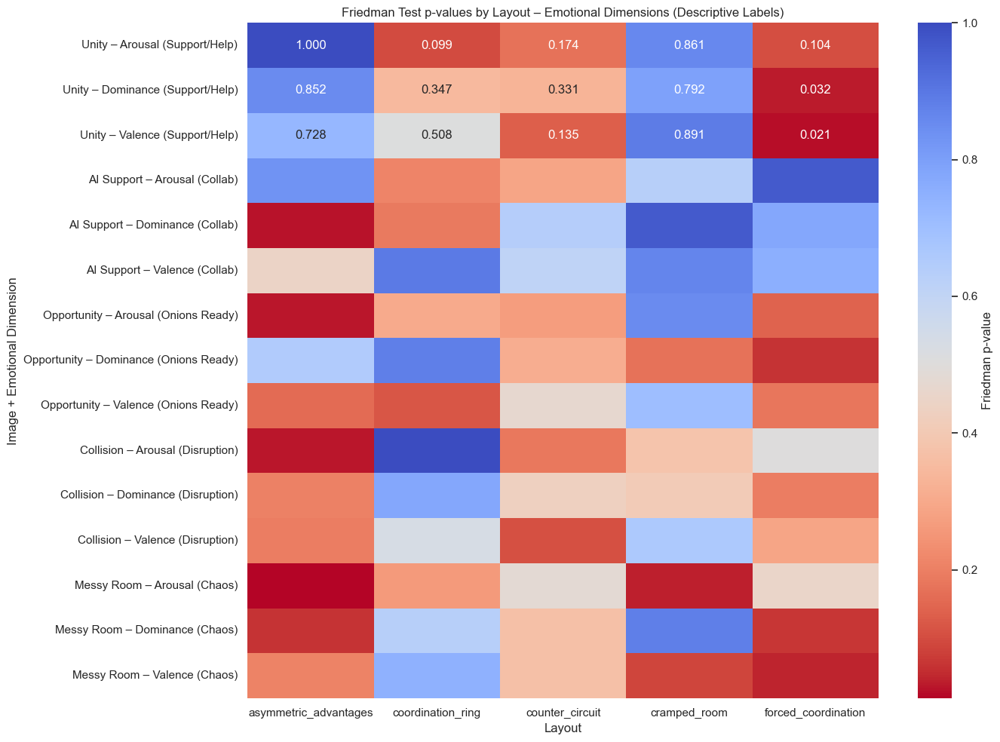

Layout,asymmetric_advantages,coordination_ring,counter_circuit,cramped_room,forced_coordination
Image_Dimension,,,,,
Unity – Arousal (Support/Help),1.0000,0.0988,0.1738,0.8607,0.1040
Unity – Dominance (Support/Help),0.8521,0.3474,0.3305,0.7919,0.0322
Unity – Valence (Support/Help),0.7275,0.5079,0.1353,0.8910,0.0208
AI Support – Arousal (Collab),0.8338,0.2090,0.2894,0.6331,0.9683
AI Support – Dominance (Collab),0.0247,0.1860,0.6376,0.9683,0.7788
AI Support – Valence (Collab),0.4459,0.8920,0.6065,0.8669,0.7558
Opportunity – Arousal (Onions Ready),0.0276,0.3035,0.2668,0.8521,0.1396
Opportunity – Dominance (Onions Ready),0.6514,0.8825,0.3114,0.1738,0.0617
Opportunity – Valence (Onions Ready),0.1561,0.1188,0.4677,0.7047,0.1791


In [6142]:
import seaborn as sns
import matplotlib.pyplot as plt

# Prepare heatmap data
heatmap_df = friedman_all_df.copy()
heatmap_df["Image_Dimension"] = heatmap_df["Image"] + "_" + heatmap_df["Dimension"]
heatmap_pivot = heatmap_df.pivot(index="Image_Dimension", columns="Layout", values="p-value")

# Convert NA and strings to numeric for heatmap
heatmap_pivot = heatmap_pivot.apply(pd.to_numeric, errors='coerce')

# Apply readable labels to heatmap y-axis
label_map = {
    "Image1_Valence": "Unity – Valence (Support/Help)",
    "Image1_Arousal": "Unity – Arousal (Support/Help)",
    "Image1_Dominance": "Unity – Dominance (Support/Help)",
    "Image2_Valence": "AI Support – Valence (Collab)",
    "Image2_Arousal": "AI Support – Arousal (Collab)",
    "Image2_Dominance": "AI Support – Dominance (Collab)",
    "Image3_Valence": "Opportunity – Valence (Onions Ready)",
    "Image3_Arousal": "Opportunity – Arousal (Onions Ready)",
    "Image3_Dominance": "Opportunity – Dominance (Onions Ready)",
    "Image4_Valence": "Collision – Valence (Disruption)",
    "Image4_Arousal": "Collision – Arousal (Disruption)",
    "Image4_Dominance": "Collision – Dominance (Disruption)",
    "Image5_Valence": "Messy Room – Valence (Chaos)",
    "Image5_Arousal": "Messy Room – Arousal (Chaos)",
    "Image5_Dominance": "Messy Room – Dominance (Chaos)",
    "Image6_Valence": "Time Pressure – Valence (1s Left)",
    "Image6_Arousal": "Time Pressure – Arousal (1s Left)",
    "Image6_Dominance": "Time Pressure – Dominance (1s Left)"
}

# Rename index for better readability
heatmap_pivot_renamed = heatmap_pivot.rename(index=label_map)

# Plot heatmap with updated labels
plt.figure(figsize=(14, 10))
sns.heatmap(heatmap_pivot_renamed, annot=True, fmt=".3f", cmap="coolwarm_r", cbar_kws={'label': 'Friedman p-value'})
plt.title("Friedman Test p-values by Layout – Emotional Dimensions (Descriptive Labels)")
plt.xlabel("Layout")
plt.ylabel("Image + Emotional Dimension")
plt.tight_layout()
plt.show()

heatmap_pivot_renamed

<img src="SAM analysis.png">

| Image       | Depicted Scenario                                                                                   | Intended Emotion                     |
| ----------- | --------------------------------------------------------------------------------------------------- | ------------------------------------ |
| **Image 1** | Multiple hands (diverse) holding a heavy log (**Unity**)                               | **High Valence**, Shared Control     |
| **Image 2** | Overcooked snapshot: AI waiting near soup with dish, human nearby (**AI Support/Collaboration**) | **Supportive**, Trust-enhancing      |
| **Image 3** | Overcooked onion station with onions present (**Opportunity**)                                   | **Motivation**, Anticipatory Arousal |
| **Image 4** | AI and human crossing paths in narrow space (**Collision**)                                      | **Stress**, Coordination Difficulty  |
| **Image 5** | Cluttered, messy kitchen room (**Chaos/Disorder**)                                               | **Low Valence**, Frustration         |
| **Image 6** | Soup cooking with time left = 1 (**Time Pressure**)                                               | **High Arousal**, Urgency            |


In [5067]:
import pandas as pd

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define relevant columns
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load and label Sheet2 (NoX)
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"

# Load and label Sheet3 (StaticX and AdaX)
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]

# Combine both sheets
df_all = pd.concat([df2, df3], ignore_index=True)

# Melt into long form for analysis
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[col for col in df_all.columns if col.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)

# Filter and convert score to float
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)

# Compute mean scores
mean_scores = sam_long.groupby(["Image_Dimension", "layout", "xai_type"])["Score"].mean().reset_index()

# Pivot for comparison
mean_comparison = mean_scores.pivot_table(index=["Image_Dimension", "layout"], columns="xai_type", values="Score").reset_index()

# Add score ordering column
def xai_order(row):
    scores = {
        "AdaX": row.get("AdaX", float('-inf')),
        "StaticX": row.get("StaticX", float('-inf')),
        "NoX": row.get("NoX", float('-inf')),
    }
    sorted_xai = sorted(scores.items(), key=lambda x: x[1])
    return " < ".join([x[0] for x in sorted_xai])

mean_comparison["Score Order (Low to High)"] = mean_comparison.apply(xai_order, axis=1)

# Add top performer column
def top_xai(row):
    scores = {
        "AdaX": row.get("AdaX", float('-inf')),
        "StaticX": row.get("StaticX", float('-inf')),
        "NoX": row.get("NoX", float('-inf')),
    }
    max_score = max(scores.values())
    top = [k for k, v in scores.items() if v == max_score]
    return ", ".join(top)

mean_comparison["Top XAI Type"] = mean_comparison.apply(top_xai, axis=1)

# Display the result
mean_comparison

xai_type,Image_Dimension,layout,AdaX,NoX,StaticX,Score Order (Low to High),Top XAI Type
0,Image1_Arousal,asymmetric_advantages,3.416667,3.272727,3.166667,StaticX < NoX < AdaX,AdaX
1,Image1_Arousal,coordination_ring,3.083333,3.666667,2.916667,StaticX < AdaX < NoX,NoX
2,Image1_Arousal,counter_circuit,2.833333,3.090909,2.416667,StaticX < AdaX < NoX,NoX
3,Image1_Arousal,cramped_room,3.083333,3.250000,3.250000,AdaX < StaticX < NoX,"StaticX, NoX"
4,Image1_Arousal,forced_coordination,2.583333,3.250000,2.750000,AdaX < StaticX < NoX,NoX
...,...,...,...,...,...,...,...
85,Image6_Valence,asymmetric_advantages,3.083333,2.272727,2.583333,NoX < StaticX < AdaX,AdaX
86,Image6_Valence,coordination_ring,2.583333,2.416667,2.416667,StaticX < NoX < AdaX,AdaX
87,Image6_Valence,counter_circuit,2.333333,2.272727,2.416667,NoX < AdaX < StaticX,StaticX
88,Image6_Valence,cramped_room,3.000000,2.916667,2.666667,StaticX < NoX < AdaX,AdaX


The effects of different **XAI types (AdaX, StaticX, NoX)** across emotion **dimensions (Valence, Arousal, Dominance)** and **layouts** as follows:

---

### ✅ **1. General Trends Across XAI Types**

| Emotion       | AdaX Tendency                                                      | StaticX Tendency      | NoX Tendency                                   |
| ------------- | ------------------------------------------------------------------ | --------------------- | ---------------------------------------------- |
| **Valence**   | Often middling, sometimes highest                                  | Frequently lowest     | Often **highest**, especially in Unity/support |
| **Arousal**   | Frequently **highest**, especially in pressure/opportunity layouts | Often low or moderate | Variable: sometimes high, but less consistent  |
| **Dominance** | Occasionally highest, especially in open layouts                   | Often lowest          | Generally higher in familiar layouts           |

---

### ✅ **2. Summary by "Top XAI Type"**

* **AdaX** came out as the top-scoring XAI type in:

  * Arousal: Especially in layouts like `asymmetric_advantages` or `cramped_room`, likely due to its dynamic responsiveness
  * Dominance: Occasionally in open/less constrained layouts

* **StaticX** was **rarely top**. It often ranks **lowest**, suggesting static explanations may not resonate in dynamic environments.

* **NoX** frequently topped **Valence** scores in positive/supportive images (like Image1 Unity, Image2 AI Support), possibly because **no explanation avoided distraction**.

---

### ✅ **3. Score Order Patterns**

* Rows with `AdaX < StaticX < NoX` indicate **users felt better without explanations**, suggesting:

  * Over-explanation or poor timing might reduce emotional resonance.
* Conversely, `NoX < StaticX < AdaX` indicates **adaptive explanations worked well**, especially in:

  * Fast-paced or uncertain situations (e.g., time pressure, collisions)

---

### ✅ **4. Layout Effects**

* Layouts like `forced_coordination` and `counter_circuit` (more constrained or intense) often amplified emotional differences between XAI types.
* Layouts like `asymmetric_advantages` or `coordination_ring` were more sensitive to **Dominance** and **Arousal** variations, revealing AdaX's strength in adaptive control.

---

### 📌 **Key Conclusion**

> **No single XAI type is best across all emotional dimensions and layouts**. However:

* **AdaX** excels in **adaptive engagement** (Arousal, sometimes Dominance)
* **NoX** preserves **emotional positivity** in familiar, cooperative settings
* **StaticX** underperforms in most contexts — possibly due to mismatch with user needs or timing.



In [5069]:
# Reload the uploaded Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Redefine the relevant columns and reload data
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load both sheets
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]
df_all = pd.concat([df2, df3], ignore_index=True)

# Melt and prepare data
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[col for col in df_all.columns if col.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)

# Compute mean scores per Image, Layout, XAI type
mean_scores = sam_long.groupby(["Image_Dimension", "layout", "xai_type"])["Score"].mean().reset_index()
mean_comparison = mean_scores.pivot_table(index=["Image_Dimension", "layout"], columns="xai_type", values="Score").reset_index()

# Score order logic
def xai_order(row):
    scores = {
        "AdaX": row.get("AdaX", float('-inf')),
        "StaticX": row.get("StaticX", float('-inf')),
        "NoX": row.get("NoX", float('-inf')),
    }
    sorted_xai = sorted(scores.items(), key=lambda x: x[1])
    return " < ".join([x[0] for x in sorted_xai])

mean_comparison["Score Order (Low to High)"] = mean_comparison.apply(xai_order, axis=1)

# Count domination orders per layout
domination_order_counts = mean_comparison.groupby("layout")["Score Order (Low to High)"].value_counts().unstack(fill_value=0)

# Display result
print(domination_order_counts)

Score Order (Low to High)  AdaX < NoX < StaticX  AdaX < StaticX < NoX  \
layout                                                                  
asymmetric_advantages                         2                     0   
coordination_ring                             2                     6   
counter_circuit                               0                     8   
cramped_room                                  3                     3   
forced_coordination                           0                    11   

Score Order (Low to High)  NoX < AdaX < StaticX  NoX < StaticX < AdaX  \
layout                                                                  
asymmetric_advantages                         3                    10   
coordination_ring                             4                     2   
counter_circuit                               4                     1   
cramped_room                                  1                     5   
forced_coordination                           1   

In [5070]:
# For each layout, count which XAI type most frequently had the highest score regardless of order

# Function to extract the highest scoring XAI type(s)
def top_xai(row):
    scores = {
        "AdaX": row.get("AdaX", float('-inf')),
        "StaticX": row.get("StaticX", float('-inf')),
        "NoX": row.get("NoX", float('-inf')),
    }
    max_score = max(scores.values())
    top = [k for k, v in scores.items() if v == max_score]
    return ", ".join(sorted(top))

mean_comparison["Top XAI Type"] = mean_comparison.apply(top_xai, axis=1)

# Count how often each XAI type is top per layout
top_counts_by_layout = mean_comparison.groupby("layout")["Top XAI Type"].value_counts().unstack(fill_value=0)

# Display table
top_counts_by_layout

Top XAI Type,AdaX,"AdaX, NoX","AdaX, StaticX",NoX,"NoX, StaticX",StaticX
layout,,,,,,
asymmetric_advantages,11,0,2,2,0,3
coordination_ring,5,0,1,6,1,5
counter_circuit,2,0,0,12,0,4
cramped_room,7,2,0,3,2,4
forced_coordination,1,1,1,14,1,0


In [5071]:
import pandas as pd
import numpy as np
from scipy.stats import shapiro, friedmanchisquare, wilcoxon, norm
from itertools import combinations
import matplotlib.pyplot as plt
import seaborn as sns

# Load Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define column mappings
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load data
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]
df_all = pd.concat([df2, df3], ignore_index=True)

# Reshape and clean
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[c for c in df_all.columns if c.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)
sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])
sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])

# Filter for Image1 Valence
df_image1_valence = sam_long[(sam_long["Image"] == "Image1") & (sam_long["Dimension"] == "Valence")]
pivot = df_image1_valence.pivot_table(index="uid", columns="xai_type", values="Score").dropna()

# Shapiro-Wilk normality test on pairwise differences
normality_tests = []
for a, b in combinations(pivot.columns, 2):
    diff = pivot[a] - pivot[b]
    stat, p = shapiro(diff)
    normality_tests.append({
        "Comparison": f"{a} - {b}",
        "W": round(stat, 3),
        "p-value": round(p, 4)
    })
normality_df = pd.DataFrame(normality_tests)

# Friedman test
friedman_stat, friedman_p = friedmanchisquare(pivot["AdaX"], pivot["StaticX"], pivot["NoX"])
friedman_result = {
    "Friedman χ²": round(friedman_stat, 3),
    "p-value": round(friedman_p, 4),
    "N": len(pivot)
}

# Wilcoxon post-hoc with Z-based effect size (r)
posthoc_results = []
for a, b in combinations(pivot.columns, 2):
    stat, p = wilcoxon(pivot[a], pivot[b])
    z = norm.ppf(1 - p / 2) if p > 0 else 0
    r = round(z / np.sqrt(len(pivot)), 3)
    posthoc_results.append({
        "Comparison": f"{a} vs {b}",
        "Wilcoxon Stat": int(stat),
        "p-value": round(p, 4),
        "Effect Size (r)": r
    })
posthoc_df = pd.DataFrame(posthoc_results)

# OUTPUT: print summaries
print("\n✅ Normality Tests (Shapiro-Wilk):")
print(normality_df.to_string(index=False))

print("\n✅ Friedman Test:")
for k, v in friedman_result.items():
    print(f"{k}: {v}")

print("\n✅ Post-hoc Wilcoxon Tests with Effect Sizes:")
print(posthoc_df.to_string(index=False))



✅ Normality Tests (Shapiro-Wilk):
    Comparison     W  p-value
    AdaX - NoX 0.906   0.1904
AdaX - StaticX 0.961   0.8024
 NoX - StaticX 0.952   0.6604

✅ Friedman Test:
Friedman χ²: 7.789
p-value: 0.0203
N: 12

✅ Post-hoc Wilcoxon Tests with Effect Sizes:
     Comparison  Wilcoxon Stat  p-value  Effect Size (r)
    AdaX vs NoX              7   0.1410            0.425
AdaX vs StaticX             26   0.8781            0.044
 NoX vs StaticX              7   0.0412            0.589


/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


In [5072]:
import pandas as pd
import numpy as np
from scipy.stats import shapiro, friedmanchisquare, wilcoxon, norm
from itertools import combinations

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Column definitions
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load data from Sheet2 (NoX) and Sheet3 (AdaX, StaticX)
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]
df_all = pd.concat([df2, df3], ignore_index=True)

# Reshape to long format
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[c for c in df_all.columns if c.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)
sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])
sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])

# Prepare storage for results
friedman_all = []
posthoc_all = []
normality_all = []

# Loop through each image for Valence analysis
for image in sorted(sam_long["Image"].unique()):
    df_valence = sam_long[(sam_long["Image"] == image) & (sam_long["Dimension"] == "Valence")]
    pivot = df_valence.pivot_table(index="uid", columns="xai_type", values="Score").dropna()
    if pivot.shape[0] < 3:
        continue  # Skip if too few participants

    # 1. Normality (Shapiro-Wilk on differences)
    for a, b in combinations(pivot.columns, 2):
        diff = pivot[a] - pivot[b]
        stat, p = shapiro(diff)
        normality_all.append({
            "Image": image,
            "Comparison": f"{a} - {b}",
            "W": round(stat, 3),
            "p-value": round(p, 4)
        })

    # 2. Friedman test
    friedman_stat, friedman_p = friedmanchisquare(*[pivot[c] for c in pivot.columns])
    friedman_all.append({
        "Image": image,
        "Friedman χ²": round(friedman_stat, 3),
        "p-value": round(friedman_p, 4),
        "N": len(pivot)
    })

    # 3. Post-hoc Wilcoxon tests with Z-effect size
    for a, b in combinations(pivot.columns, 2):
        stat, p = wilcoxon(pivot[a], pivot[b])
        z = norm.ppf(1 - p / 2) if p > 0 else 0
        r = round(z / np.sqrt(len(pivot)), 3)
        posthoc_all.append({
            "Image": image,
            "Comparison": f"{a} vs {b}",
            "Wilcoxon Stat": int(stat),
            "p-value": round(p, 4),
            "Effect Size (r)": r
        })

# Convert to DataFrames
friedman_df_all = pd.DataFrame(friedman_all)
posthoc_df_all = pd.DataFrame(posthoc_all)
normality_df_all = pd.DataFrame(normality_all)

# Display results
print("\n✅ Friedman Test Results (Valence):")
print(friedman_df_all.to_string(index=False))

print("\n✅ Post-hoc Wilcoxon Tests (Valence):")
print(posthoc_df_all.to_string(index=False))

print("\n✅ Shapiro-Wilk Normality Tests (Valence):")
print(normality_df_all.to_string(index=False))



✅ Friedman Test Results (Valence):
 Image  Friedman χ²  p-value  N
Image1        7.789   0.0203 12
Image2        0.905   0.6361 12
Image3        0.800   0.6703 12
Image4        1.087   0.5807 12
Image5        1.000   0.6065 12
Image6        1.550   0.4607 12

✅ Post-hoc Wilcoxon Tests (Valence):
 Image      Comparison  Wilcoxon Stat  p-value  Effect Size (r)
Image1     AdaX vs NoX              7   0.1410            0.425
Image1 AdaX vs StaticX             26   0.8781            0.044
Image1  NoX vs StaticX              7   0.0412            0.589
Image2     AdaX vs NoX             25   0.5042            0.193
Image2 AdaX vs StaticX             10   0.2603            0.325
Image2  NoX vs StaticX             28   0.6882            0.116
Image3     AdaX vs NoX             22   0.9527            0.017
Image3 AdaX vs StaticX              3   0.2228            0.352
Image3  NoX vs StaticX             11   0.6115            0.147
Image4     AdaX vs NoX             25   0.4747            0.20

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for norm

In [5073]:
# Full test for Arousal dimension across all images (repeated measures per image)

# Prepare output storage
friedman_arousal = []
posthoc_arousal = []
normality_arousal = []

# Loop through each image for Arousal analysis
for image in sorted(sam_long["Image"].unique()):
    df_arousal = sam_long[(sam_long["Image"] == image) & (sam_long["Dimension"] == "Arousal")]
    pivot = df_arousal.pivot_table(index="uid", columns="xai_type", values="Score").dropna()
    if pivot.shape[0] < 3:
        continue

    # 1. Normality (Shapiro-Wilk)
    for a, b in combinations(pivot.columns, 2):
        diff = pivot[a] - pivot[b]
        stat, p = shapiro(diff)
        normality_arousal.append({
            "Image": image,
            "Comparison": f"{a} - {b}",
            "W": round(stat, 3),
            "p-value": round(p, 4)
        })

    # 2. Friedman test
    friedman_stat, friedman_p = friedmanchisquare(*[pivot[c] for c in pivot.columns])
    friedman_arousal.append({
        "Image": image,
        "Friedman χ²": round(friedman_stat, 3),
        "p-value": round(friedman_p, 4),
        "N": len(pivot)
    })

    # 3. Post-hoc Wilcoxon tests with Z-effect size
    for a, b in combinations(pivot.columns, 2):
        stat, p = wilcoxon(pivot[a], pivot[b])
        z = norm.ppf(1 - p / 2) if p > 0 else 0
        r = round(z / np.sqrt(len(pivot)), 3)
        posthoc_arousal.append({
            "Image": image,
            "Comparison": f"{a} vs {b}",
            "Wilcoxon Stat": int(stat),
            "p-value": round(p, 4),
            "Effect Size (r)": r
        })

# Convert to DataFrames
friedman_df_arousal = pd.DataFrame(friedman_arousal)
posthoc_df_arousal = pd.DataFrame(posthoc_arousal)
normality_df_arousal = pd.DataFrame(normality_arousal)

# Display all results
# import ace_tools as tools
# tools.display_dataframe_to_user(name="Arousal: Friedman Tests by Image", dataframe=friedman_df_arousal)
# tools.display_dataframe_to_user(name="Arousal: Wilcoxon Post-hoc Results", dataframe=posthoc_df_arousal)
# tools.display_dataframe_to_user(name="Arousal: Normality Tests", dataframe=normality_df_arousal)

# Display results
print("\n✅ Friedman Test Results (Arousal):")
print(friedman_df_arousal.to_string(index=False))

print("\n✅ Post-hoc Wilcoxon Tests (Arousal):")
print(posthoc_df_arousal.to_string(index=False))

print("\n✅ Shapiro-Wilk Normality Tests (Arousal):")
print(normality_df_arousal.to_string(index=False))


✅ Friedman Test Results (Arousal):
 Image  Friedman χ²  p-value  N
Image1        4.439   0.1087 12
Image2        0.186   0.9112 12
Image3        2.850   0.2405 12
Image4        1.217   0.5441 12
Image5        8.512   0.0142 12
Image6        1.850   0.3965 12

✅ Post-hoc Wilcoxon Tests (Arousal):
 Image      Comparison  Wilcoxon Stat  p-value  Effect Size (r)
Image1     AdaX vs NoX             21   0.2855            0.308
Image1 AdaX vs StaticX             12   0.3985            0.244
Image1  NoX vs StaticX              9   0.0325            0.617
Image2     AdaX vs NoX             24   0.4224            0.232
Image2 AdaX vs StaticX             18   0.6353            0.137
Image2  NoX vs StaticX             22   0.3273            0.283
Image3     AdaX vs NoX             11   0.3270            0.283
Image3 AdaX vs StaticX             20   0.2662            0.321
Image3  NoX vs StaticX             24   0.7204            0.103
Image4     AdaX vs NoX             35   0.7910            0.07

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for norm

In [5074]:
# Full test for Dominance dimension across all images (repeated measures per image)

# Prepare output storage
friedman_dominance = []
posthoc_dominance = []
normality_dominance = []

# Loop through each image for Dominance analysis
for image in sorted(sam_long["Image"].unique()):
    df_dom = sam_long[(sam_long["Image"] == image) & (sam_long["Dimension"] == "Dominance")]
    pivot = df_dom.pivot_table(index="uid", columns="xai_type", values="Score").dropna()
    if pivot.shape[0] < 3:
        continue

    # 1. Normality (Shapiro-Wilk)
    for a, b in combinations(pivot.columns, 2):
        diff = pivot[a] - pivot[b]
        stat, p = shapiro(diff)
        normality_dominance.append({
            "Image": image,
            "Comparison": f"{a} - {b}",
            "W": round(stat, 3),
            "p-value": round(p, 4)
        })

    # 2. Friedman test
    friedman_stat, friedman_p = friedmanchisquare(*[pivot[c] for c in pivot.columns])
    friedman_dominance.append({
        "Image": image,
        "Friedman χ²": round(friedman_stat, 3),
        "p-value": round(friedman_p, 4),
        "N": len(pivot)
    })

    # 3. Post-hoc Wilcoxon tests with Z-effect size
    for a, b in combinations(pivot.columns, 2):
        stat, p = wilcoxon(pivot[a], pivot[b])
        z = norm.ppf(1 - p / 2) if p > 0 else 0
        r = round(z / np.sqrt(len(pivot)), 3)
        posthoc_dominance.append({
            "Image": image,
            "Comparison": f"{a} vs {b}",
            "Wilcoxon Stat": int(stat),
            "p-value": round(p, 4),
            "Effect Size (r)": r
        })

# Convert to DataFrames
friedman_df_dominance = pd.DataFrame(friedman_dominance)
posthoc_df_dominance = pd.DataFrame(posthoc_dominance)
normality_df_dominance = pd.DataFrame(normality_dominance)

# Display all results
# import ace_tools as tools
# tools.display_dataframe_to_user(name="Dominance: Friedman Tests by Image", dataframe=friedman_df_dominance)
# tools.display_dataframe_to_user(name="Dominance: Wilcoxon Post-hoc Results", dataframe=posthoc_df_dominance)
# tools.display_dataframe_to_user(name="Dominance: Normality Tests", dataframe=normality_df_dominance)

# Display results
print("\n✅ Friedman Test Results (Dominance):")
print(friedman_df_arousal.to_string(index=False))

print("\n✅ Post-hoc Wilcoxon Tests (Dominance):")
print(posthoc_df_arousal.to_string(index=False))

print("\n✅ Shapiro-Wilk Normality Tests (Dominance):")
print(normality_df_arousal.to_string(index=False))


✅ Friedman Test Results (Dominance):
 Image  Friedman χ²  p-value  N
Image1        4.439   0.1087 12
Image2        0.186   0.9112 12
Image3        2.850   0.2405 12
Image4        1.217   0.5441 12
Image5        8.512   0.0142 12
Image6        1.850   0.3965 12

✅ Post-hoc Wilcoxon Tests (Dominance):
 Image      Comparison  Wilcoxon Stat  p-value  Effect Size (r)
Image1     AdaX vs NoX             21   0.2855            0.308
Image1 AdaX vs StaticX             12   0.3985            0.244
Image1  NoX vs StaticX              9   0.0325            0.617
Image2     AdaX vs NoX             24   0.4224            0.232
Image2 AdaX vs StaticX             18   0.6353            0.137
Image2  NoX vs StaticX             22   0.3273            0.283
Image3     AdaX vs NoX             11   0.3270            0.283
Image3 AdaX vs StaticX             20   0.2662            0.321
Image3  NoX vs StaticX             24   0.7204            0.103
Image4     AdaX vs NoX             35   0.7910            

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for norm

In [5075]:
import pandas as pd
import numpy as np
from scipy.stats import shapiro, friedmanchisquare, wilcoxon, norm
from itertools import combinations

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define columns
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load Sheets
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]
df_all = pd.concat([df2, df3], ignore_index=True)

# Reshape
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[col for col in df_all.columns if col.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)
sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])
sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])

# Prepare result containers
friedman_all = []
posthoc_all = []
normality_all = []

# Run stats per image × dimension
for image in sorted(sam_long["Image"].unique()):
    for dimension in ["Valence", "Arousal", "Dominance"]:
        subset = sam_long[(sam_long["Image"] == image) & (sam_long["Dimension"] == dimension)]
        pivot = subset.pivot_table(index="uid", columns="xai_type", values="Score").dropna()
        if pivot.shape[0] < 3:
            continue

        # Normality
        for a, b in combinations(pivot.columns, 2):
            diff = pivot[a] - pivot[b]
            stat, p = shapiro(diff)
            normality_all.append({
                "Image": image,
                "Dimension": dimension,
                "Comparison": f"{a} - {b}",
                "W": round(stat, 3),
                "p-value": round(p, 4)
            })

        # Friedman test
        stat, p = friedmanchisquare(*[pivot[col] for col in pivot.columns])
        friedman_all.append({
            "Image": image,
            "Dimension": dimension,
            "Friedman χ²": round(stat, 3),
            "p-value": round(p, 4),
            "N": len(pivot)
        })

        # Wilcoxon post-hoc
        for a, b in combinations(pivot.columns, 2):
            stat, p = wilcoxon(pivot[a], pivot[b])
            z = norm.ppf(1 - p / 2) if p > 0 else 0
            r = round(z / np.sqrt(len(pivot)), 3)
            posthoc_all.append({
                "Image": image,
                "Dimension": dimension,
                "Comparison": f"{a} vs {b}",
                "Wilcoxon Stat": int(stat),
                "p-value": round(p, 4),
                "Effect Size (r)": r
            })

# Convert to DataFrames (optional use for saving or further analysis)
friedman_df_all = pd.DataFrame(friedman_all)
posthoc_df_all = pd.DataFrame(posthoc_all)
normality_df_all = pd.DataFrame(normality_all)

print("\n✅ Friedman Test Results:")
print(friedman_df_all.to_string(index=False))

print("\n✅ Post-hoc Wilcoxon Tests:")
print(posthoc_df_all.to_string(index=False))

print("\n✅ Shapiro-Wilk Normality Tests:")
print(normality_df_all.to_string(index=False))

/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/nishani/anaconda3/envs/python_310/lib/python3.9/site-packages/scipy/stats/_morestats.py:4102: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for norm


✅ Friedman Test Results:
 Image Dimension  Friedman χ²  p-value  N
Image1   Valence        7.789   0.0203 12
Image1   Arousal        4.439   0.1087 12
Image1 Dominance        1.590   0.4516 12
Image2   Valence        0.905   0.6361 12
Image2   Arousal        0.186   0.9112 12
Image2 Dominance        3.268   0.1951 12
Image3   Valence        0.800   0.6703 12
Image3   Arousal        2.850   0.2405 12
Image3 Dominance        1.226   0.5418 12
Image4   Valence        1.087   0.5807 12
Image4   Arousal        1.217   0.5441 12
Image4 Dominance        0.486   0.7841 12
Image5   Valence        1.000   0.6065 12
Image5   Arousal        8.512   0.0142 12
Image5 Dominance        1.950   0.3772 12
Image6   Valence        1.550   0.4607 12
Image6   Arousal        1.850   0.3965 12
Image6 Dominance        0.722   0.6969 12

✅ Post-hoc Wilcoxon Tests:
 Image Dimension      Comparison  Wilcoxon Stat  p-value  Effect Size (r)
Image1   Valence     AdaX vs NoX              7   0.1410            0.425


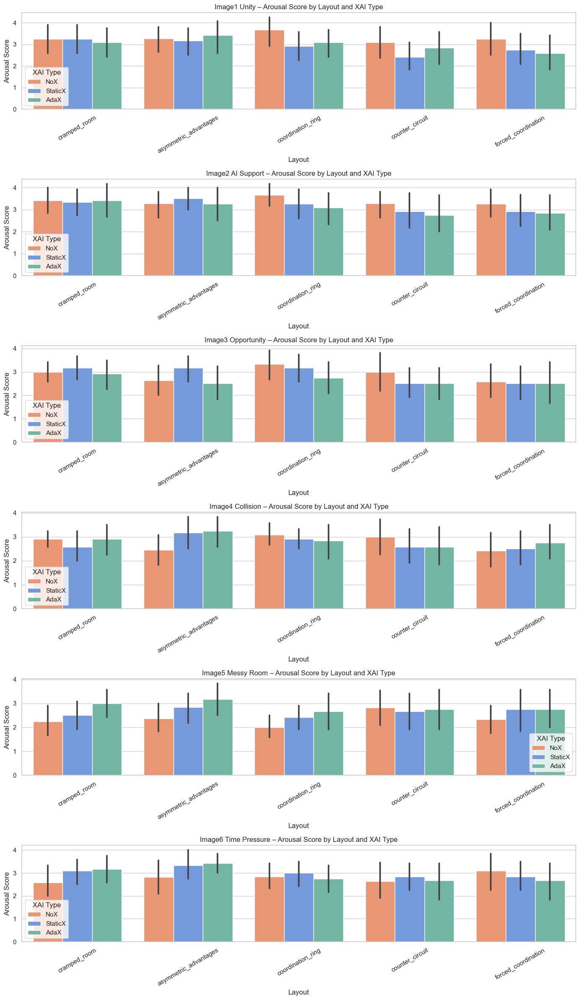

In [5076]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define columns
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load Sheet2 (NoX)
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"

# Load Sheet3 (StaticX and AdaX)
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]

# Combine datasets
df_all = pd.concat([df2, df3], ignore_index=True)

# Melt to long format
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[col for col in df_all.columns if col.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)

# Clean and extract dimension/image info
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)
sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])
sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])

# Add readable image labels
image_labels = {
    "Image1": "Image1 Unity",
    "Image2": "Image2 AI Support",
    "Image3": "Image3 Opportunity",
    "Image4": "Image4 Collision",
    "Image5": "Image5 Messy Room",
    "Image6": "Image6 Time Pressure"
}
sam_long["Image_Label"] = sam_long["Image"].map(image_labels)

# Plot only Arousal
def plot_arousal():
    plot_data = sam_long[sam_long["Dimension"] == "Arousal"]
    unique_images = plot_data["Image_Label"].unique()
    n_images = len(unique_images)
    fig, axes = plt.subplots(n_images, 1, figsize=(14, 4 * n_images), sharey=False)

    for i, image in enumerate(unique_images):
        ax = axes[i]
        subset = plot_data[plot_data["Image_Label"] == image]
        sns.barplot(data=subset, x="layout", y="Score", hue="xai_type", ax=ax, palette=custom_palette)
        ax.set_title(f"{image} – Arousal Score by Layout and XAI Type")
        ax.set_xlabel("Layout")
        ax.set_ylabel("Arousal Score")
        ax.tick_params(axis='x', rotation=30)
        ax.legend(title="XAI Type")

    plt.tight_layout()
    plt.show()

# Run the plot
plot_arousal()


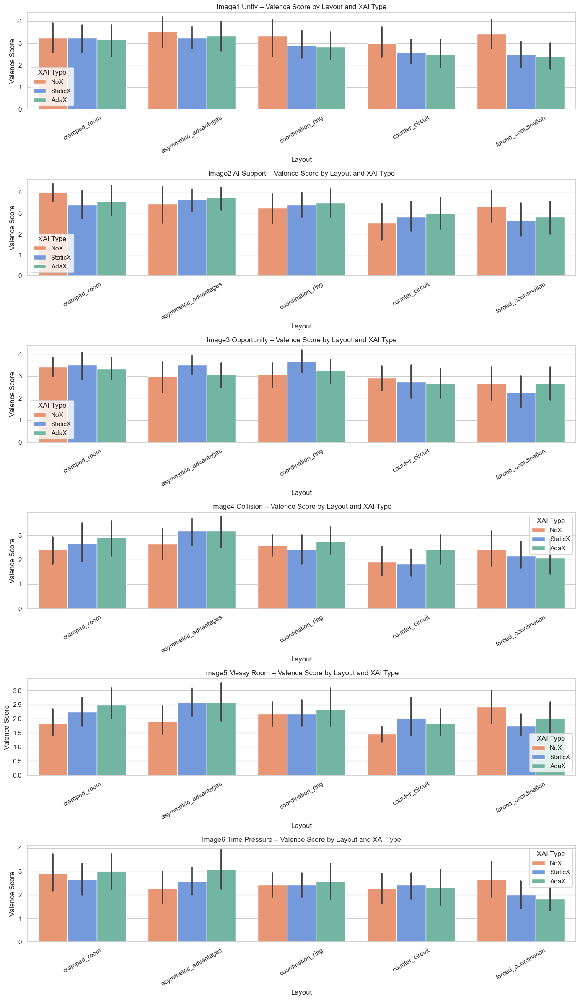

In [5077]:
#### DOMINANCE  ##

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define columns
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load Sheet2 (NoX)
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"

# Load Sheet3 (StaticX and AdaX)
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]

# Combine datasets
df_all = pd.concat([df2, df3], ignore_index=True)

# Melt to long format
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[col for col in df_all.columns if col.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)

# Clean and extract dimension/image info
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)
sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])
sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])

# Add readable image labels
image_labels = {
    "Image1": "Image1 Unity",
    "Image2": "Image2 AI Support",
    "Image3": "Image3 Opportunity",
    "Image4": "Image4 Collision",
    "Image5": "Image5 Messy Room",
    "Image6": "Image6 Time Pressure"
}
sam_long["Image_Label"] = sam_long["Image"].map(image_labels)

# Plot only Valence
def plot_valence():
    plot_data = sam_long[sam_long["Dimension"] == "Valence"]
    unique_images = plot_data["Image_Label"].unique()
    n_images = len(unique_images)
    fig, axes = plt.subplots(n_images, 1, figsize=(14, 4 * n_images), sharey=False)

    for i, image in enumerate(unique_images):
        ax = axes[i]
        subset = plot_data[plot_data["Image_Label"] == image]
        sns.barplot(data=subset, x="layout", y="Score", hue="xai_type", ax=ax, palette=custom_palette)
        ax.set_title(f"{image} – Valence Score by Layout and XAI Type")
        ax.set_xlabel("Layout")
        ax.set_ylabel("Valence Score")
        ax.tick_params(axis='x', rotation=30)
        ax.legend(title="XAI Type")

    plt.tight_layout()
    plt.show()

# Run the plot
plot_valence()


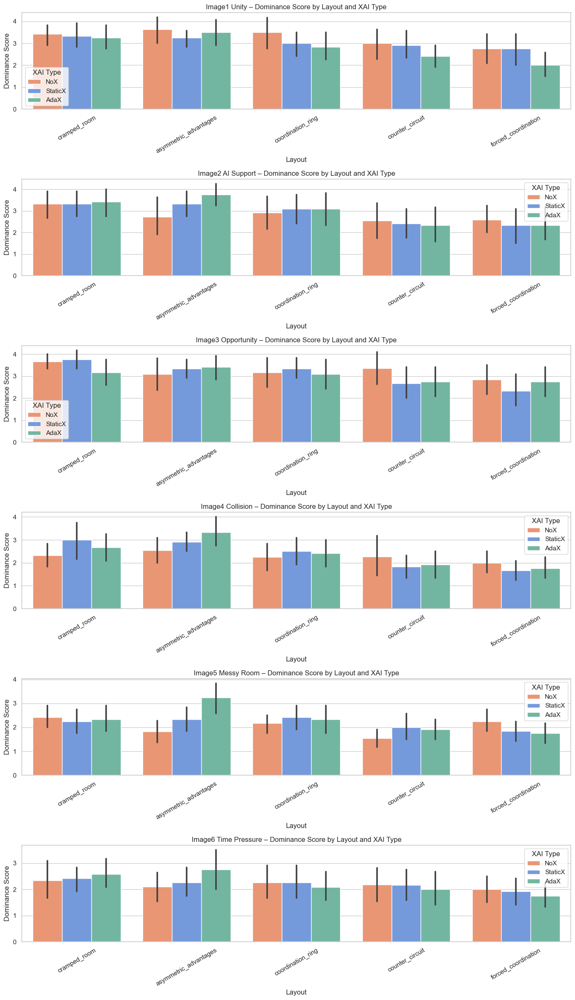

In [5078]:
#### DOMINANCE 

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")

# Define columns
column_renames = {
    "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
    "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
    "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
    "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
    "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
    "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
}
columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# Load Sheet2 (NoX)
df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
df2["xai_type"] = "NoX"

# Load Sheet3 (StaticX and AdaX)
df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
df3["xai_type"] = df3["xai_agent"]

# Combine datasets
df_all = pd.concat([df2, df3], ignore_index=True)

# Melt to long format
sam_long = pd.melt(
    df_all,
    id_vars=["uid", "xai_type", "layout"],
    value_vars=[col for col in df_all.columns if col.startswith("Image")],
    var_name="Image_Dimension",
    value_name="Score"
)

# Clean and extract dimension/image info
sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
sam_long["Score"] = sam_long["Score"].astype(float)
sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])
sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])

# Add readable image labels
image_labels = {
    "Image1": "Image1 Unity",
    "Image2": "Image2 AI Support",
    "Image3": "Image3 Opportunity",
    "Image4": "Image4 Collision",
    "Image5": "Image5 Messy Room",
    "Image6": "Image6 Time Pressure"
}
sam_long["Image_Label"] = sam_long["Image"].map(image_labels)

# Plot only Dominance
def plot_dominance():
    plot_data = sam_long[sam_long["Dimension"] == "Dominance"]
    unique_images = plot_data["Image_Label"].unique()
    n_images = len(unique_images)
    fig, axes = plt.subplots(n_images, 1, figsize=(14, 4 * n_images), sharey=False)

    for i, image in enumerate(unique_images):
        ax = axes[i]
        subset = plot_data[plot_data["Image_Label"] == image]
        sns.barplot(data=subset, x="layout", y="Score", hue="xai_type", ax=ax, palette=custom_palette)
        ax.set_title(f"{image} – Dominance Score by Layout and XAI Type")
        ax.set_xlabel("Layout")
        ax.set_ylabel("Dominance Score")
        ax.tick_params(axis='x', rotation=30)
        ax.legend(title="XAI Type")

    plt.tight_layout()
    plt.show()

# Run the plot
plot_dominance()


In [6262]:
pivot_corr

Target,stress_binary,trust_binary
Feature,,
Explanation Timing,0.005,-0.009


'AdaX_Explanation_Correlation_Heatmap.png'

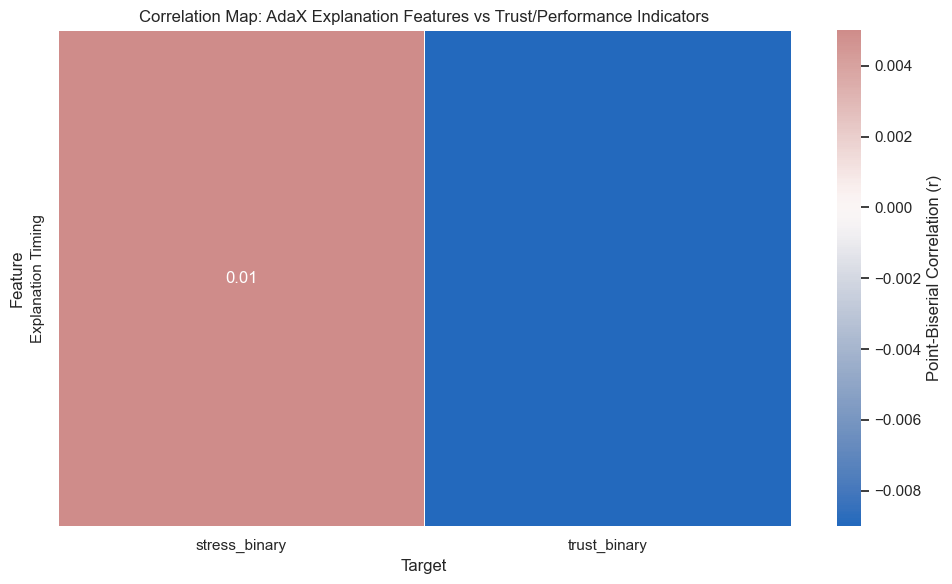

In [6260]:
import seaborn as sns
import matplotlib.pyplot as plt

# Combine both correlation results
corr_all = pd.concat([corr_feature_df, df_json_corr], ignore_index=True)

# Filter only trust/performance related targets
relevant_targets = ['trust_score', 'trust_binary', 'ess_score', 'stress_binary']
filtered_corr = corr_all[corr_all['Target'].isin(relevant_targets)]

# Pivot for heatmap
pivot_corr = filtered_corr.pivot(index='Feature', columns='Target', values='Correlation (r)')

# Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(pivot_corr, annot=True, cmap="vlag", center=0, fmt=".2f", linewidths=0.5, cbar_kws={'label': "Point-Biserial Correlation (r)"})
plt.title("Correlation Map: AdaX Explanation Features vs Trust/Performance Indicators")
plt.tight_layout()
corr_map_path = "AdaX_Explanation_Correlation_Heatmap.png"
plt.savefig(corr_map_path)
corr_map_path


### XAI feature correlations

In [6275]:
df_adax

,id,metadata,contents,uid,xai_type,timestep,layout,explanation_timing,explanation_granularity,timing_bin,granularity_bin,score_rate,collision_rate,trust_score
0,fb78f144-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0,counter_circuit,proactive,highlevel,1,0,0.00,0.00,0.000000
1,fb78f144-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,0,counter_circuit,proactive,highlevel,1,0,0.00,0.00,0.000000
2,fb78e9e2-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1,forced_coordination,proactive,highlevel,1,0,0.00,0.00,0.000000
3,fb78e9e2-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,1,forced_coordination,proactive,highlevel,1,0,0.00,0.00,0.000000
4,fb78e7f8-35d8-11f0-996d-b6a5c808d142,"{'score': 0, 'trust': 'high', 'stress': 'low',...",Player ID: 80d85041fdab4066a21018504e26264a\nK...,10,AdaX,2,coordination_ring,proactive,highlevel,1,0,0.00,0.00,3.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1303,fb8e9f94-35d8-11f0-996d-b6a5c808d142,"{'score': 100, 'trust': 'high', 'stress': 'low...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,AdaX,362,cramped_room,proactive,highlevel,1,0,1.27,0.10,4.111111
1304,fb8ea124-35d8-11f0-996d-b6a5c808d142,"{'score': 40, 'trust': 'high', 'stress': 'low'...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,AdaX,363,coordination_ring,proactive,highlevel,1,0,0.50,0.29,2.666667
1305,fb8ea124-35d8-11f0-996d-b6a5c808d142,"{'score': 40, 'trust': 'high', 'stress': 'low'...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,AdaX,363,coordination_ring,proactive,highlevel,1,0,0.50,0.29,2.111111
1306,fb8e9c38-35d8-11f0-996d-b6a5c808d142,"{'score': 120, 'trust': 'high', 'stress': 'low...",Player ID: 04eea26bba9d4c2da5c1ed75b4de870f\nK...,21,AdaX,364,asymmetric_advantages,proactive,highlevel,1,0,1.50,0.00,3.444444


              Feature          Target  Correlation (r)  p-value Significant
0  Explanation Timing     trust_score           -0.081   0.0035           ✅
1  Explanation Timing      score_rate           -0.031   0.2633           ❌
2  Explanation Timing  collision_rate           -0.014   0.6199           ❌

             Feature          Target  Correlation (r)  p-value Magnitude  \
0  Timing: Proactive     trust_score           -0.081   0.0035  Negative   
1  Timing: Proactive      score_rate           -0.031   0.2633  Negative   
2  Timing: Proactive  collision_rate           -0.014   0.6199  Negative   
3   Timing: Reactive     trust_score            0.081   0.0035  Positive   
4   Timing: Reactive      score_rate            0.031   0.2633  Positive   
5   Timing: Reactive  collision_rate            0.014   0.6199  Positive   

  Significant  
0           ✅  
1           ❌  
2           ❌  
3           ✅  
4           ❌  
5           ❌  


'Explanation_Feature_Correlation_Heatmap.png'

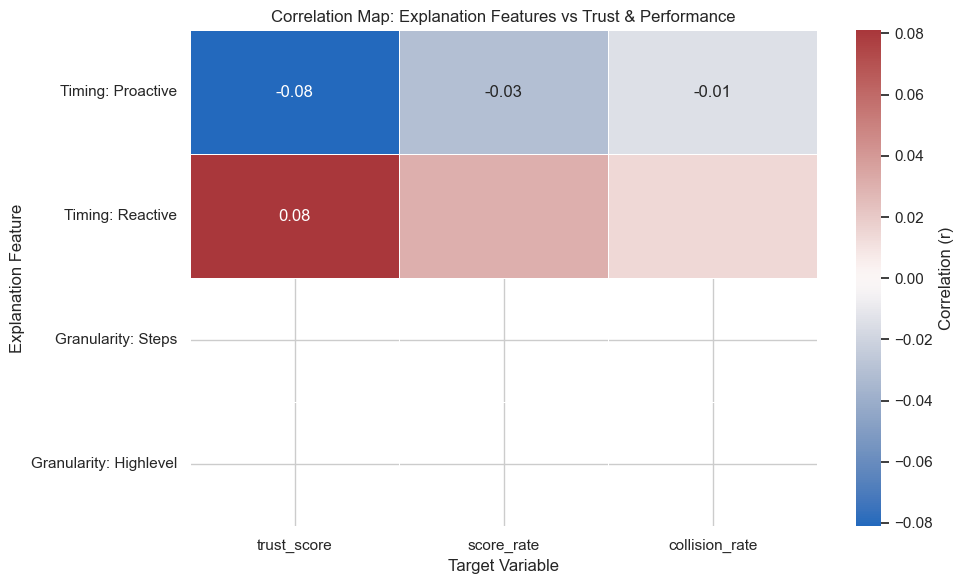

In [6285]:
import pandas as pd
import json
from scipy.stats import pointbiserialr

# === Load Data ===

# Load Excel (Sheet3)
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sdata = xls.parse("Sheet3")[1:]
df_sdata['uid'] = df_sdata['uid'].astype(str).str.strip()
df_sdata['layout'] = df_sdata['layout'].astype(str).str.strip().str.lower()

# Recalculate trust score from Q107_1 to Q107_9
trust_cols = [f"Q107_{i}" for i in range(1, 10)]
df_sdata[trust_cols] = df_sdata[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_sdata['trust_score'] = df_sdata[trust_cols].mean(axis=1)

# === Load JSON metadata ===
with open("processed_with_uid_filtered.json") as f:
    json_data = json.load(f)

df_json = pd.DataFrame(json_data)
df_json['uid'] = df_json['uid'].astype(str).str.strip()
df_json['metadata'] = df_json['metadata'].apply(lambda m: json.loads(m) if isinstance(m, str) else m)
df_json['layout'] = df_json['metadata'].apply(lambda m: m.get('layout_name', '')).str.strip().str.lower()

# Identify AdaX entries
df_json['xai_type'] = df_json['metadata'].apply(
    lambda m: 'StaticX' if m.get('final_explanation', '') == '' and m.get('explanation_features', {}).get('explanation_timing', 'unknown') == 'unknown' else 'AdaX'
)
df_adax = df_json[df_json['xai_type'] == 'AdaX'].copy()

# Extract feature labels
df_adax['explanation_timing'] = df_adax['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown'))
df_adax['explanation_granularity'] = df_adax['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_granularity', 'unknown'))

# Binary encode features
df_adax['timing_bin'] = df_adax['explanation_timing'].map({'proactive': 1, 'reactive': 0})
df_adax['granularity_bin'] = df_adax['explanation_granularity'].map({'steps': 1, 'highlevel': 0})

# Extract performance values
df_adax['score_rate'] = pd.to_numeric(df_adax['metadata'].apply(lambda m: m.get('score_rate', None)), errors='coerce')
df_adax['collision_rate'] = pd.to_numeric(df_adax['metadata'].apply(lambda m: m.get('collision_rate', None)), errors='coerce')

# Merge with trust_score from Excel
df_adax = pd.merge(
    df_adax,
    df_sdata[['uid', 'layout', 'trust_score']],
    on=['uid', 'layout'],
    how='left'
)

# === Correlation Analysis ===
correlation_results = []
targets = ['trust_score', 'score_rate', 'collision_rate']

for bin_feature, label in {
    'timing_bin': 'Explanation Timing',
    'granularity_bin': 'Explanation Granularity'
}.items():
    for target in targets:
        if df_adax[bin_feature].nunique() > 1 and df_adax[target].nunique() > 1:
            r, p = pointbiserialr(df_adax[bin_feature], df_adax[target])
            correlation_results.append({
                'Feature': label,
                'Target': target,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Significant': '✅' if p < 0.05 else '❌'
            })

df_corr_results = pd.DataFrame(correlation_results)
print(df_corr_results)


import seaborn as sns
import matplotlib.pyplot as plt

# Prepare one-hot binary feature indicators for timing and granularity categories
df_adax['timing_proactive'] = (df_adax['explanation_timing'] == 'proactive').astype(int)
df_adax['timing_reactive'] = (df_adax['explanation_timing'] == 'reactive').astype(int)
df_adax['granularity_steps'] = (df_adax['explanation_granularity'] == 'steps').astype(int)
df_adax['granularity_highlevel'] = (df_adax['explanation_granularity'] == 'highlevel').astype(int)

# Run correlation analysis for all feature indicators vs trust_score, score_rate, collision_rate
features = [
    ('timing_proactive', 'Timing: Proactive'),
    ('timing_reactive', 'Timing: Reactive'),
    ('granularity_steps', 'Granularity: Steps'),
    ('granularity_highlevel', 'Granularity: Highlevel')
]
targets = ['trust_score', 'score_rate', 'collision_rate']

summary_stats = []
heatmap_data = {}

for feature_key, feature_label in features:
    row = {}
    for target in targets:
        if df_adax[feature_key].nunique() > 1 and df_adax[target].nunique() > 1:
            r, p = pointbiserialr(df_adax[feature_key], df_adax[target])
            row[target] = round(r, 3)
            summary_stats.append({
                'Feature': feature_label,
                'Target': target,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Magnitude': 'Positive' if r > 0 else 'Negative',
                'Significant': '✅' if p < 0.05 else '❌'
            })
    heatmap_data[feature_label] = row

# Convert summary to DataFrame
df_summary = pd.DataFrame(summary_stats)

# Prepare DataFrame for heatmap
df_heatmap = pd.DataFrame(heatmap_data).T[targets]

# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(df_heatmap, annot=True, cmap="vlag", center=0, fmt=".2f", linewidths=0.5, cbar_kws={'label': "Correlation (r)"})
plt.title("Correlation Map: Explanation Features vs Trust & Performance")
plt.ylabel("Explanation Feature")
plt.xlabel("Target Variable")
plt.tight_layout()

heatmap_path = "Explanation_Feature_Correlation_Heatmap.png"
plt.savefig(heatmap_path)
print()
print(df_summary)
heatmap_path


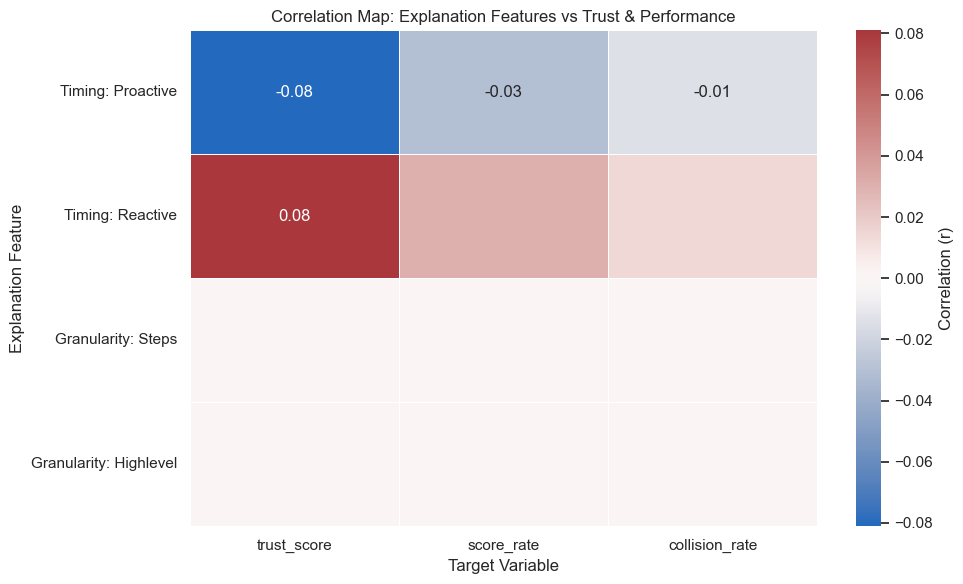

In [6287]:
import pandas as pd
import json
from scipy.stats import pointbiserialr
import matplotlib.pyplot as plt
import seaborn as sns

# === 1. Load Excel data ===
xls = pd.ExcelFile("sdata_latest.xlsx")
df_sdata = xls.parse("Sheet3")[1:]
df_sdata['uid'] = df_sdata['uid'].astype(str).str.strip()
df_sdata['layout'] = df_sdata['layout'].astype(str).str.strip().str.lower()

# Recalculate trust score from Q107_1–Q107_9
trust_cols = [f"Q107_{i}" for i in range(1, 10)]
df_sdata[trust_cols] = df_sdata[trust_cols].apply(pd.to_numeric, errors='coerce') - 1
df_sdata['trust_score'] = df_sdata[trust_cols].mean(axis=1)

# === 2. Load JSON metadata and extract AdaX only ===
with open("processed_with_uid_filtered.json") as f:
    json_data = json.load(f)

df_json = pd.DataFrame(json_data)
df_json['uid'] = df_json['uid'].astype(str).str.strip()
df_json['metadata'] = df_json['metadata'].apply(lambda m: json.loads(m) if isinstance(m, str) else m)
df_json['layout'] = df_json['metadata'].apply(lambda m: m.get('layout_name', '')).str.strip().str.lower()

# Identify AdaX
df_json['xai_type'] = df_json['metadata'].apply(
    lambda m: 'StaticX' if m.get('final_explanation', '') == '' and m.get('explanation_features', {}).get('explanation_timing', 'unknown') == 'unknown' else 'AdaX'
)
df_adax = df_json[df_json['xai_type'] == 'AdaX'].copy()

# === 3. Extract features from metadata ===
df_adax['explanation_timing'] = df_adax['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_timing', 'unknown'))
df_adax['explanation_granularity'] = df_adax['metadata'].apply(lambda m: m.get('explanation_features', {}).get('explanation_granularity', 'unknown'))

# Binary encode into indicators
df_adax['timing_proactive'] = (df_adax['explanation_timing'] == 'proactive').astype(int)
df_adax['timing_reactive'] = (df_adax['explanation_timing'] == 'reactive').astype(int)
df_adax['granularity_steps'] = (df_adax['explanation_granularity'] == 'steps').astype(int)
df_adax['granularity_highlevel'] = (df_adax['explanation_granularity'] == 'highlevel').astype(int)

# Extract performance metrics
df_adax['score_rate'] = pd.to_numeric(df_adax['metadata'].apply(lambda m: m.get('score_rate', None)), errors='coerce')
df_adax['collision_rate'] = pd.to_numeric(df_adax['metadata'].apply(lambda m: m.get('collision_rate', None)), errors='coerce')

# Merge trust score
df_adax = pd.merge(df_adax, df_sdata[['uid', 'layout', 'trust_score']], on=['uid', 'layout'], how='left')

# === 4. Compute correlations ===
features = [
    ('timing_proactive', 'Timing: Proactive'),
    ('timing_reactive', 'Timing: Reactive'),
    ('granularity_steps', 'Granularity: Steps'),
    ('granularity_highlevel', 'Granularity: Highlevel')
]
targets = ['trust_score', 'score_rate', 'collision_rate']

summary_stats = []
heatmap_data = {}

for feature_key, feature_label in features:
    row = {}
    for target in targets:
        if df_adax[feature_key].nunique() > 1 and df_adax[target].nunique() > 1:
            r, p = pointbiserialr(df_adax[feature_key], df_adax[target])
            row[target] = round(r, 3)
            summary_stats.append({
                'Feature': feature_label,
                'Target': target,
                'Correlation (r)': round(r, 3),
                'p-value': round(p, 4),
                'Magnitude': 'Positive' if r > 0 else 'Negative',
                'Significant': '✅' if p < 0.05 else '❌'
            })
        else:
            # Manually set constant features to neutral if no variation
            row[target] = 0.0
            summary_stats.append({
                'Feature': feature_label,
                'Target': target,
                'Correlation (r)': 0.0,
                'p-value': 1.0,
                'Magnitude': 'None',
                'Significant': '❌'
            })
    heatmap_data[feature_label] = row

df_summary = pd.DataFrame(summary_stats)

# === 5. Plot heatmap ===
df_heatmap = pd.DataFrame(heatmap_data).T[targets]

plt.figure(figsize=(10, 6))
sns.heatmap(df_heatmap, annot=True, cmap="vlag", center=0, fmt=".2f",
            linewidths=0.5, cbar_kws={'label': "Correlation (r)"})
plt.title("Correlation Map: Explanation Features vs Trust & Performance")
plt.ylabel("Explanation Feature")
plt.xlabel("Target Variable")
plt.tight_layout()
plt.savefig("Explanation_Feature_Correlation_Heatmap_With_Granularity.png")
plt.show()

# Optionally export
df_summary.to_csv("Explanation_Feature_Correlation_Summary.csv", index=False)


In [5079]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Load Excel
# xls = pd.ExcelFile("sdata_latest.xlsx")
# column_renames = {
#     "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
#     "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
#     "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
#     "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
#     "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
#     "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
# }
# columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]
# df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
# df2["xai_type"] = "NoX"
# df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
# df3["xai_type"] = df3["xai_agent"]
# df_all = pd.concat([df2, df3], ignore_index=True)

# # Reshape
# sam_long = pd.melt(
#     df_all,
#     id_vars=["uid", "xai_type", "layout"],
#     value_vars=[col for col in df_all.columns if col.startswith("Image")],
#     var_name="Image_Dimension",
#     value_name="Score"
# )
# sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
# sam_long["Score"] = sam_long["Score"].astype(float)
# sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])
# sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])
# sam_long["Image_Dimension"] = sam_long["Image"] + "_" + sam_long["Dimension"]

# # Image labels
# image_labels = {
#     "Image1": "Image1 Unity",
#     "Image2": "Image2 AI Support",
#     "Image3": "Image3 Opportunity",
#     "Image4": "Image4 Collision",
#     "Image5": "Image5 Messy Room",
#     "Image6": "Image6 Time Pressure"
# }
# sam_long["Image_Label"] = sam_long["Image"].map(image_labels)

# # Load Friedman test results
# friedman_df = friedman_all_df[friedman_all_df["Dimension"] == "Arousal"].copy()
# friedman_df["Image_Dimension"] = friedman_df["Image"] + "_" + friedman_df["Dimension"]
# friedman_df.rename(columns={"Layout": "layout"}, inplace=True)

# # Include this before your function if not already loaded
# friedman_df = pd.read_excel("sdata_latest.xlsx", sheet_name=None)
# friedman_all = pd.concat([
#     pd.read_excel("sdata_latest.xlsx", sheet_name="Friedman Arousal"),
#     # If you have valence or dominance sheets, add them here
# ])
# friedman_all["Image_Dimension"] = friedman_all["Image"] + "_" + friedman_all["Dimension"]
# friedman_all.rename(columns={"Layout": "layout"}, inplace=True)

# # Modify plot_arousal with markers
# def plot_arousal():
#     plot_data = sam_long[sam_long["Dimension"] == "Arousal"].copy()
#     plot_data["Image_Dimension"] = plot_data["Image"] + "_Arousal"

#     # Merge for significance markers
#     merged = pd.merge(
#         plot_data,
#         friedman_all[["Image_Dimension", "layout", "p-value"]],
#         on=["Image_Dimension", "layout"],
#         how="left"
#     )

#     unique_images = merged["Image_Label"].unique()
#     n_images = len(unique_images)
#     fig, axes = plt.subplots(n_images, 1, figsize=(14, 4 * n_images), sharey=False)

#     for i, image in enumerate(unique_images):
#         ax = axes[i]
#         subset = merged[merged["Image_Label"] == image]
#         sns.barplot(data=subset, x="layout", y="Score", hue="xai_type", ax=ax)
#         ax.set_title(f"{image} – Arousal Score by Layout and XAI Type")
#         ax.set_xlabel("Layout")
#         ax.set_ylabel("Arousal Score")
#         ax.tick_params(axis='x', rotation=30)
#         ax.legend(title="XAI Type")

#         # Add significance markers
#         for layout in subset["layout"].unique():
#             layout_data = subset[subset["layout"] == layout]
#             p_val = layout_data["p-value"].values[0]
#             if pd.notnull(p_val) and p_val < 0.1:
#                 x_pos = list(subset["layout"].unique()).index(layout)
#                 y_max = layout_data["Score"].max()
#                 ax.text(x_pos, y_max + 0.1, "*" if p_val < 0.05 else "†", ha="center", fontsize=14)

#     plt.tight_layout()
#     plt.show()


In [5080]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Load the Excel file
# xls = pd.ExcelFile("sdata_latest.xlsx")

# # Define SAM columns
# column_renames = {
#     "Q27": "Image1_Arousal", "Q28": "Image1_Valence", "Q29": "Image1_Dominance",
#     "Q130": "Image2_Arousal", "Q135": "Image2_Valence", "Q136": "Image2_Dominance",
#     "Q140": "Image3_Arousal", "Q144": "Image3_Valence", "Q145": "Image3_Dominance",
#     "Q149": "Image4_Arousal", "Q152": "Image4_Valence", "Q153": "Image4_Dominance",
#     "Q158": "Image5_Arousal", "Q160": "Image5_Valence", "Q161": "Image5_Dominance",
#     "Q167": "Image6_Arousal", "Q168": "Image6_Valence", "Q169": "Image6_Dominance"
# }
# columns_to_extract = ["uid"] + list(column_renames.keys()) + ["layout", "xai_agent"]

# # Load NoX and XAI data
# df2 = xls.parse("Sheet2")[columns_to_extract].rename(columns=column_renames)
# df2["xai_type"] = "NoX"
# df3 = xls.parse("Sheet3")[columns_to_extract].rename(columns=column_renames)
# df3["xai_type"] = df3["xai_agent"]
# df_all = pd.concat([df2, df3], ignore_index=True)

# # Melt to long format
# sam_long = pd.melt(
#     df_all,
#     id_vars=["uid", "xai_type", "layout"],
#     value_vars=[col for col in df_all.columns if col.startswith("Image")],
#     var_name="Image_Dimension",
#     value_name="Score"
# )
# sam_long = sam_long[pd.to_numeric(sam_long["Score"], errors='coerce').notnull()]
# sam_long["Score"] = sam_long["Score"].astype(float)
# sam_long["Dimension"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[1])
# sam_long["Image"] = sam_long["Image_Dimension"].apply(lambda x: x.split("_")[0])
# sam_long["Image_Dimension"] = sam_long["Image"] + "_" + sam_long["Dimension"]

# # Add readable labels
# image_labels = {
#     "Image1": "Image1 Unity",
#     "Image2": "Image2 AI Support",
#     "Image3": "Image3 Opportunity",
#     "Image4": "Image4 Collision",
#     "Image5": "Image5 Messy Room",
#     "Image6": "Image6 Time Pressure"
# }
# sam_long["Image_Label"] = sam_long["Image"].map(image_labels)

# # Load Friedman test results for Valence
# friedman_df = pd.read_excel("sdata_latest.xlsx", sheet_name="Friedman Valence")
# friedman_df["Image_Dimension"] = friedman_df["Image"] + "_Valence"
# friedman_df.rename(columns={"Layout": "layout"}, inplace=True)

# # Merge p-values with SAM data
# valence_data = sam_long[sam_long["Dimension"] == "Valence"].copy()
# valence_data = pd.merge(
#     valence_data,
#     friedman_df[["Image_Dimension", "layout", "p-value"]],
#     on=["Image_Dimension", "layout"],
#     how="left"
# )

# # Plot per image with significance markers
# def plot_valence():
#     unique_images = valence_data["Image_Label"].unique()
#     n_images = len(unique_images)
#     fig, axes = plt.subplots(n_images, 1, figsize=(14, 4 * n_images), sharey=False)

#     for i, image in enumerate(unique_images):
#         ax = axes[i]
#         subset = valence_data[valence_data["Image_Label"] == image]
#         sns.barplot(data=subset, x="layout", y="Score", hue="xai_type", ax=ax)
#         ax.set_title(f"{image} – Valence Score by Layout and XAI Type")
#         ax.set_xlabel("Layout")
#         ax.set_ylabel("Valence Score")
#         ax.tick_params(axis='x', rotation=30)
#         ax.legend(title="XAI Type")

#         # Add significance markers
#         for layout in subset["layout"].unique():
#             layout_data = subset[subset["layout"] == layout]
#             p_val = layout_data["p-value"].values[0]
#             if pd.notnull(p_val) and p_val < 0.1:
#                 x_pos = list(subset["layout"].unique()).index(layout)
#                 y_max = layout_data["Score"].max()
#                 ax.text(x_pos, y_max + 0.1, "*" if p_val < 0.05 else "†", ha="center", fontsize=14)

#     plt.tight_layout()
#     plt.show()

# # Run the Valence plot
# plot_valence()


# Demographic Data

In [5082]:
# pip install scikit-posthocs


In [5083]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from scipy.stats import shapiro
import seaborn as sns
import matplotlib.pyplot as plt

# Load Excel file
file_path = "sdata_latest.xlsx"
sheet3_df = pd.read_excel(file_path, sheet_name="Sheet3")[1:]
demographics_df = pd.read_excel(file_path, sheet_name="Sheet5")[1:]

# Clean and prepare UID
sheet3_df['uid'] = sheet3_df['uid'].astype(str).str.strip()
demographics_df['uid'] = demographics_df['uid'].astype(str)
demographics_df['Q3'] = pd.to_numeric(demographics_df['Q3'], errors='coerce')  # Gaming experience
demographics_df['Q4'] = pd.to_numeric(demographics_df['Q4'], errors='coerce')  # Years of gaming

# Convert ESS and Trust items to numeric
ess_items = [f'Q99_{i}' for i in range(1, 10)]
trust_items = [f'Q107_{i}' for i in range(1, 10)]
for item in ess_items + trust_items:
    sheet3_df[item] = pd.to_numeric(sheet3_df.get(item), errors='coerce')

# Compute scores
sheet3_df['ess_score'] = sheet3_df[ess_items].mean(axis=1)
sheet3_df['trust_score'] = sheet3_df[trust_items].apply(lambda row: row - 1).mean(axis=1)

# Merge with demographic data
merged_df = pd.merge(sheet3_df, demographics_df[['uid', 'Q3', 'Q4']], on='uid', how='left')

# Apply KMeans clustering on Q3 (gaming expertise) and Q4 (years)
exp_features = merged_df[['Q3', 'Q4']].dropna()
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
merged_df.loc[exp_features.index, 'expertise_kmeans'] = kmeans.fit_predict(exp_features)

# Relabel clusters by years of experience
cluster_centers = kmeans.cluster_centers_
cluster_labels = ['Low', 'Medium', 'High']
cluster_order = np.argsort(cluster_centers[:, 1])  # based on Q4
label_map = {cluster_order[i]: cluster_labels[i] for i in range(3)}
merged_df['expertise_cluster_kmeans'] = merged_df['expertise_kmeans'].map(label_map)

# Run Shapiro-Wilk test for each cluster
results = {}
for cluster in merged_df['expertise_cluster_kmeans'].dropna().unique():
    group = merged_df[merged_df['expertise_cluster_kmeans'] == cluster]
    trust_stat, trust_p = shapiro(group['trust_score'].dropna())
    ess_stat, ess_p = shapiro(group['ess_score'].dropna())
    results[cluster] = {
        'Trust Shapiro-Wilk p': round(trust_p, 4),
        'Trust Normal?': trust_p > 0.05,
        'ESS Shapiro-Wilk p': round(ess_p, 4),
        'ESS Normal?': ess_p > 0.05
    }

# Display results
normality_df = pd.DataFrame(results).T.sort_index()
print(normality_df)


       Trust Shapiro-Wilk p Trust Normal? ESS Shapiro-Wilk p ESS Normal?
High                 0.0029         False                0.0       False
Low                  0.0037         False              0.002       False
Medium               0.0538          True              0.106        True


In [5084]:
import pandas as pd
import scikit_posthocs as sp

# Load your file
file_path = "sdata_latest.xlsx"
sheet3_df = pd.read_excel(file_path, sheet_name="Sheet3")[1:]
demographics_df = pd.read_excel(file_path, sheet_name="Sheet5")[1:]

# Clean and prepare
sheet3_df['uid'] = sheet3_df['uid'].astype(str).str.strip()
demographics_df['uid'] = demographics_df['uid'].astype(str)
demographics_df['Q3'] = pd.to_numeric(demographics_df['Q3'], errors='coerce')
demographics_df['Q4'] = pd.to_numeric(demographics_df['Q4'], errors='coerce')

# Convert columns
ess_items = [f'Q99_{i}' for i in range(1, 10)]
trust_items = [f'Q107_{i}' for i in range(1, 10)]
for item in ess_items + trust_items:
    sheet3_df[item] = pd.to_numeric(sheet3_df.get(item), errors='coerce')

# Compute scores
sheet3_df['ess_score'] = sheet3_df[ess_items].mean(axis=1)
sheet3_df['trust_score'] = sheet3_df[trust_items].apply(lambda row: row - 1).mean(axis=1)

# Merge and cluster
merged_df = pd.merge(sheet3_df, demographics_df[['uid', 'Q3', 'Q4']], on='uid', how='left')

from sklearn.cluster import KMeans
import numpy as np

exp_features = merged_df[['Q3', 'Q4']].dropna()
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
merged_df.loc[exp_features.index, 'expertise_kmeans'] = kmeans.fit_predict(exp_features)

# Relabel clusters by experience level
cluster_centers = kmeans.cluster_centers_
cluster_labels = ['Low', 'Medium', 'High']
cluster_order = np.argsort(cluster_centers[:, 1])
label_map = {cluster_order[i]: cluster_labels[i] for i in range(3)}
merged_df['expertise_cluster_kmeans'] = merged_df['expertise_kmeans'].map(label_map)

# Filter required columns
ess_data = merged_df[['ess_score', 'expertise_cluster_kmeans', 'xai_agent']].dropna()

# Run Dunn's test (overall)
dunn_results_all = sp.posthoc_dunn(
    ess_data, val_col='ess_score', group_col='expertise_cluster_kmeans', p_adjust='bonferroni'
)

# Dunn's test for AdaX only
adax_data = ess_data[ess_data['xai_agent'] == 'AdaX']
dunn_results_adax = sp.posthoc_dunn(
    adax_data, val_col='ess_score', group_col='expertise_cluster_kmeans', p_adjust='bonferroni'
)

# Dunn's test for StaticX only
staticx_data = ess_data[ess_data['xai_agent'] == 'StaticX']
dunn_results_staticx = sp.posthoc_dunn(
    staticx_data, val_col='ess_score', group_col='expertise_cluster_kmeans', p_adjust='bonferroni'
)

# Display
print("Dunn's Test - All XAI Types:\n", dunn_results_all)
print("\nDunn's Test - AdaX Only:\n", dunn_results_adax)
print("\nDunn's Test - StaticX Only:\n", dunn_results_staticx)


Dunn's Test - All XAI Types:
             High       Low    Medium
High    1.000000  0.001712  0.421632
Low     0.001712  1.000000  1.000000
Medium  0.421632  1.000000  1.000000

Dunn's Test - AdaX Only:
             High       Low    Medium
High    1.000000  0.042841  0.692367
Low     0.042841  1.000000  1.000000
Medium  0.692367  1.000000  1.000000

Dunn's Test - StaticX Only:
             High       Low  Medium
High    1.000000  0.056039     1.0
Low     0.056039  1.000000     1.0
Medium  1.000000  1.000000     1.0


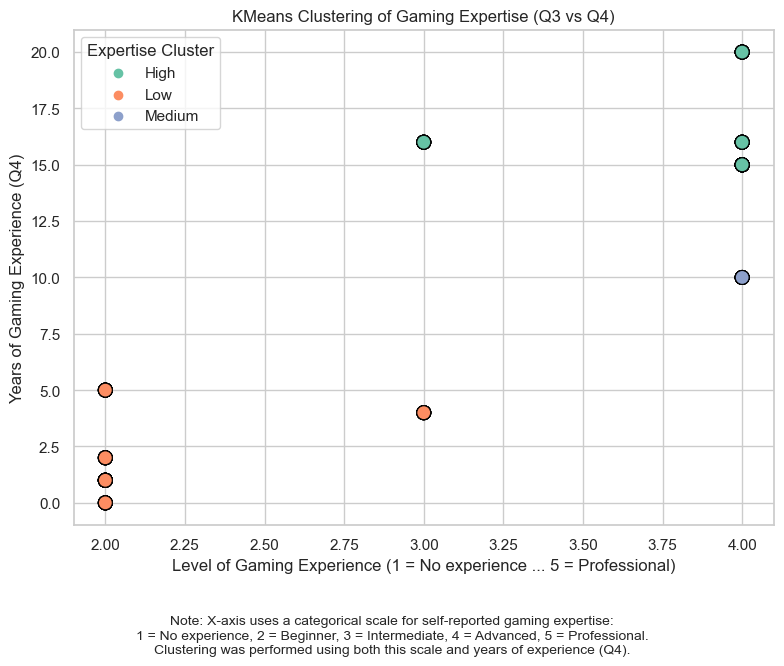

In [5085]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

# Load Excel data
file_path = "sdata_latest.xlsx"
sheet3_df = pd.read_excel(file_path, sheet_name="Sheet3")[1:]
demographics_df = pd.read_excel(file_path, sheet_name="Sheet5")[1:]

# Clean and prepare UIDs
sheet3_df['uid'] = sheet3_df['uid'].astype(str).str.strip()
demographics_df['uid'] = demographics_df['uid'].astype(str)

# Convert relevant columns to numeric
demographics_df['Q3'] = pd.to_numeric(demographics_df['Q3'], errors='coerce')  # Self-reported experience level
demographics_df['Q4'] = pd.to_numeric(demographics_df['Q4'], errors='coerce')  # Years of experience

# Merge demographics into Sheet3 responses
merged_df = pd.merge(sheet3_df, demographics_df[['uid', 'Q3', 'Q4']], on='uid', how='left')

# Run KMeans clustering
exp_features = merged_df[['Q3', 'Q4']].dropna()
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
merged_df.loc[exp_features.index, 'expertise_kmeans'] = kmeans.fit_predict(exp_features)

# Label clusters based on sorted years of experience (Q4)
cluster_centers = kmeans.cluster_centers_
cluster_labels = ['Low', 'Medium', 'High']
cluster_order = np.argsort(cluster_centers[:, 1])  # Sort by years of experience
label_map = {cluster_order[i]: cluster_labels[i] for i in range(3)}
merged_df['expertise_cluster_kmeans'] = merged_df['expertise_kmeans'].map(label_map)

# Plot the clusters
plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=merged_df.dropna(subset=['Q3', 'Q4', 'expertise_cluster_kmeans']),
    x='Q3', y='Q4',
    hue='expertise_cluster_kmeans',
    palette='Set2',
    s=100,
    edgecolor='black'
)

plt.title("KMeans Clustering of Gaming Expertise (Q3 vs Q4)")
plt.xlabel("Level of Gaming Experience (1 = No experience ... 5 = Professional)")
plt.ylabel("Years of Gaming Experience (Q4)")
plt.legend(title="Expertise Cluster")
plt.grid(True)

# Add caption
plt.figtext(
    0.5, -0.1,
    "Note: X-axis uses a categorical scale for self-reported gaming expertise:\n"
    "1 = No experience, 2 = Beginner, 3 = Intermediate, 4 = Advanced, 5 = Professional.\n"
    "Clustering was performed using both this scale and years of experience (Q4).",
    wrap=True, horizontalalignment='center', fontsize=10
)

plt.tight_layout()
plt.show()


'Demographic_Distribution_Plots_Final.png'

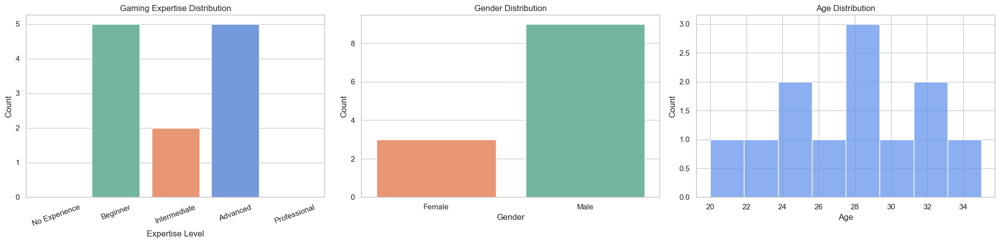

In [6347]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load Excel file and parse demographics sheet (Sheet5)
xls = pd.ExcelFile("sdata_latest.xlsx")
df_demo = xls.parse("Sheet5")

# Rename based on user's description
df_demo = df_demo.rename(columns={
    'Q1': 'age',
    'Q2': 'gender',
    'Q3': 'expertise',
    'Q4': 'years_experience'
})

# Normalize values
df_demo['player_Id'] = df_demo['player_Id'].astype(str).str.strip()
df_demo['gender'] = df_demo['gender'].map({1: 'Male', 2: 'Female'})
df_demo['expertise'] = pd.to_numeric(df_demo['expertise'], errors='coerce')
df_demo['age'] = pd.to_numeric(df_demo['age'], errors='coerce')
df_demo['years_experience'] = pd.to_numeric(df_demo['years_experience'], errors='coerce')

# Prepare labels for expertise level
expertise_labels = {
    1: "No Experience",
    2: "Beginner",
    3: "Intermediate",
    4: "Advanced",
    5: "Professional"
}
df_demo['expertise_label'] = df_demo['expertise'].map(expertise_labels)

# Plot demographic distributions
fig, axes = plt.subplots(1, 3, figsize=(20, 5))


new_palette = {
    "No Experience": "#66c2a5",     # Teal green
    "Beginner": "#66c2a5",     # Teal green
    "Intermediate": "#fc8d62",      # Coral orange
    "Advanced": "#6495ED",  # Muted violet / purple (new)    "NoX": "#8da0cb"
    "Professional": "#66c2a5",  # Muted violet / purple (new)    "NoX": "#8da0cb"
    "Male": "#66c2a5",       # Light magenta
    "Female": "#fc8d62",      # Light magenta
    "Age": "#e78ac3"       # Light magenta
}

# Expertise distribution
sns.countplot(x='expertise_label', data=df_demo, ax=axes[0], palette=new_palette, order=list(expertise_labels.values()))
axes[0].set_title("Gaming Expertise Distribution")
axes[0].set_xlabel("Expertise Level")
axes[0].set_ylabel("Count")
axes[0].tick_params(axis='x', rotation=20)

# Gender distribution
sns.countplot(x='gender', data=df_demo, ax=axes[1], palette=new_palette)
axes[1].set_title("Gender Distribution")
axes[1].set_xlabel("Gender")
axes[1].set_ylabel("Count")

# Age distribution
sns.histplot(df_demo['age'].dropna(), bins=8, kde=False, ax=axes[2], color=new_palette["Advanced"])
axes[2].set_title("Age Distribution")
axes[2].set_xlabel("Age")
axes[2].set_ylabel("Count")

plt.tight_layout()
demo_plot_final = "Demographic_Distribution_Plots_Final.png"
plt.savefig(demo_plot_final)
demo_plot_final


In [6236]:
from scipy.stats import shapiro

# Prepare a dictionary to store Shapiro-Wilk test results
normality_results = {}

# Variables to test
vars_to_test = ['age', 'years_experience', 'expertise']

# Perform Shapiro-Wilk normality test for each variable
for var in vars_to_test:
    data = df_demo[var].dropna()
    stat, p_val = shapiro(data)
    normality_results[var] = {
        'W-statistic': round(stat, 4),
        'p-value': round(p_val, 4),
        'Normal?': '✅ Yes' if p_val > 0.05 else '❌ No'
    }

# Convert to DataFrame for display
df_normality = pd.DataFrame.from_dict(normality_results, orient='index')
df_normality.reset_index(inplace=True)
df_normality.rename(columns={'index': 'Variable'}, inplace=True)

df_normality


,Variable,W-statistic,p-value,Normal?
0,age,0.9763,0.9647,✅ Yes
1,years_experience,0.8722,0.0696,✅ Yes
2,expertise,0.7462,0.0024,❌ No


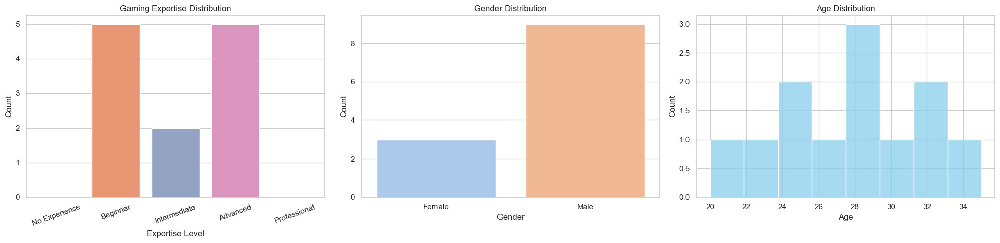

           Variable  W-statistic  p-value Normal?
0               age       0.9763   0.9647   ✅ Yes
1  years_experience       0.8722   0.0696   ✅ Yes
2         expertise       0.7462   0.0024    ❌ No


In [6248]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import shapiro

# Load Excel file
xls = pd.ExcelFile("sdata_latest.xlsx")
df_demo = xls.parse("Sheet5")

# Rename columns based on user mapping
df_demo = df_demo.rename(columns={
    'Q1': 'age',
    'Q2': 'gender',
    'Q3': 'expertise',
    'Q4': 'years_experience'
})

# Normalize and convert types
df_demo['player_Id'] = df_demo['player_Id'].astype(str).str.strip()
df_demo['gender'] = df_demo['gender'].map({1: 'Male', 2: 'Female'})
df_demo['expertise'] = pd.to_numeric(df_demo['expertise'], errors='coerce')
df_demo['age'] = pd.to_numeric(df_demo['age'], errors='coerce')
df_demo['years_experience'] = pd.to_numeric(df_demo['years_experience'], errors='coerce')

# Label expertise
expertise_labels = {
    1: "No Experience",
    2: "Beginner",
    3: "Intermediate",
    4: "Advanced",
    5: "Professional"
}
df_demo['expertise_label'] = df_demo['expertise'].map(expertise_labels)

# Plot distributions
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

# Expertise distribution
sns.countplot(x='expertise_label', data=df_demo, ax=axes[0], palette="Set2", order=list(expertise_labels.values()))
axes[0].set_title("Gaming Expertise Distribution")
axes[0].set_xlabel("Expertise Level")
axes[0].set_ylabel("Count")
axes[0].tick_params(axis='x', rotation=20)

# Gender distribution
sns.countplot(x='gender', data=df_demo, ax=axes[1], palette="pastel")
axes[1].set_title("Gender Distribution")
axes[1].set_xlabel("Gender")
axes[1].set_ylabel("Count")

# Age distribution
sns.histplot(df_demo['age'].dropna(), bins=8, kde=False, ax=axes[2], color="skyblue")
axes[2].set_title("Age Distribution")
axes[2].set_xlabel("Age")
axes[2].set_ylabel("Count")

plt.tight_layout()
plt.savefig("Demographic_Distribution_Plots_Final.png")
plt.show()

# Shapiro-Wilk normality tests
normality_results = {}
vars_to_test = ['age', 'years_experience', 'expertise']

for var in vars_to_test:
    data = df_demo[var].dropna()
    stat, p_val = shapiro(data)
    normality_results[var] = {
        'W-statistic': round(stat, 4),
        'p-value': round(p_val, 4),
        'Normal?': '✅ Yes' if p_val > 0.05 else '❌ No'
    }

df_normality = pd.DataFrame.from_dict(normality_results, orient='index')
df_normality.reset_index(inplace=True)
df_normality.rename(columns={'index': 'Variable'}, inplace=True)
print(df_normality)


In [6351]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Load data
# file_path = "sdata_latest.xlsx"
# sheet3_df = pd.read_excel(file_path, sheet_name="Sheet3")[1:]
# demographics_df = pd.read_excel(file_path, sheet_name="Sheet5")[1:]

# # Convert UID and relevant columns to proper types
# sheet3_df['uid'] = sheet3_df['uid'].astype(str).str.strip()
# demographics_df['uid'] = demographics_df['uid'].astype(str)

# # Convert trust and ESS items to numeric
# ess_items = [f'Q99_{i}' for i in range(1, 10)]
# trust_items = [f'Q107_{i}' for i in range(1, 10)]
# for item in ess_items + trust_items:
#     sheet3_df[item] = pd.to_numeric(sheet3_df.get(item), errors='coerce')

# # Compute scores
# sheet3_df['ess_score'] = sheet3_df[ess_items].mean(axis=1)
# sheet3_df['trust_score'] = sheet3_df[trust_items].apply(lambda row: row - 1).mean(axis=1)

# # Extract and clean demographic columns
# demographics_df['Q3'] = pd.to_numeric(demographics_df['Q3'], errors='coerce')  # Gaming experience level
# demographics_df['Q4'] = pd.to_numeric(demographics_df['Q4'], errors='coerce')  # Years of gaming

# # Merge on UID
# merged_df = pd.merge(sheet3_df, demographics_df[['uid', 'Q3', 'Q4']], on='uid', how='left')

# # Cluster gaming expertise
# def cluster_expertise(val):
#     if pd.isna(val):
#         return 'Unknown'
#     if val <= 2:
#         return 'Low'
#     elif val == 3:
#         return 'Medium'
#     else:
#         return 'High'

# merged_df['expertise_cluster'] = merged_df['Q3'].apply(cluster_expertise)

# # Set seaborn style
# sns.set(style="whitegrid")

# # Plot Trust Score by Expertise Cluster
# plt.figure(figsize=(10, 6))
# sns.barplot(data=merged_df, x='expertise_cluster', y='trust_score', errorbar=('ci', 95))
# plt.title("Trust Score by Gaming Expertise Cluster (StaticX & AdaX)")
# plt.ylabel("Mean Trust Score")
# plt.xlabel("Gaming Expertise Cluster")
# plt.tight_layout()
# plt.show()

# # Plot ESS Score by Expertise Cluster
# plt.figure(figsize=(10, 6))
# sns.barplot(data=merged_df, x='expertise_cluster', y='ess_score', errorbar=('ci', 95))
# plt.title("Explanation Satisfaction Score by Gaming Expertise Cluster (StaticX & AdaX)")
# plt.ylabel("Mean ESS Score")
# plt.xlabel("Gaming Expertise Cluster")
# plt.tight_layout()
# plt.show()


# Emotion Analysis (Subjective Stress/frustraion vs model)

In [5088]:
# Re-import necessary libraries after environment reset
import pandas as pd

# Reload files
pred_df = pd.read_csv("model_predictions_with_layouts.csv")
pred_df['uid'] = pred_df['uid'].astype(str).str.strip()
pred_df['xai_type'] = pred_df['xai_type'].astype(str)

# Count number of prediction rows per XAI type
xai_counts = pred_df['xai_type'].value_counts().reset_index()
xai_counts.columns = ['xai_type', 'prediction_count']

xai_counts

,xai_type,prediction_count
0,StaticX,1013
1,NoX,909
2,AdaX,623


In [5089]:
## merging two data 
# Re-load the Excel file after environment reset
xls = pd.ExcelFile("sdata_latest.xlsx")
sheet3 = xls.parse(sheet_name=2)

# Show columns to confirm structure
sheet3.columns.tolist()

# Prepare sheet2 (NoX)
sheet2 = xls.parse(sheet_name=1)
sheet2['uid'] = sheet2['uid'].astype(str).str.strip()
sheet2 = sheet2[['uid', 'layout', 'Q104_6']].copy()
sheet2['xai_type'] = 'NoX'

# Prepare sheet3 (StaticX and AdaX)
sheet3 = xls.parse(sheet_name=2)
sheet3['uid'] = sheet3['uid'].astype(str).str.strip()
sheet3 = sheet3[['uid', 'layout', 'xai_agent', 'Q104_6']].copy()
sheet3 = sheet3.rename(columns={'xai_agent': 'xai_type'})

# Combine both subjective sources
subjective_df = pd.concat([sheet2, sheet3], ignore_index=True)
subjective_df['Q104_6'] = pd.to_numeric(subjective_df['Q104_6'], errors='coerce')

# Prepare model predictions
pred_df = pd.read_csv("model_predictions_with_layouts.csv")
pred_df['uid'] = pred_df['uid'].astype(str).str.strip()
pred_df['neg_emotion'] = pred_df[['stress', 'depression']].sum(axis=1)

# Compute median negative emotion per uid-layout-xai_type
median_neg_emotion = pred_df.groupby(['uid', 'layout', 'xai_type'])['neg_emotion'].median().reset_index(name='median_negative_emotion')

# Merge subjective with model-derived values
merged_df = pd.merge(subjective_df, median_neg_emotion, on=['uid', 'layout', 'xai_type'])

merged_df

,uid,layout,Q104_6,xai_type,median_negative_emotion
0,10,cramped_room,5.0,NoX,0.500000
1,10,asymmetric_advantages,4.0,NoX,0.500000
2,10,coordination_ring,3.0,NoX,0.500000
3,10,counter_circuit,5.0,NoX,0.272552
4,10,forced_coordination,5.0,NoX,0.270438
...,...,...,...,...,...
170,21,asymmetric_advantages,4.0,AdaX,0.438845
171,21,forced_coordination,5.0,AdaX,0.450055
172,21,cramped_room,3.0,AdaX,0.465557
173,21,coordination_ring,4.0,AdaX,0.454091


In [5090]:
# normalize subjective score

# Normalize the 6-point Likert scale to 0–1
merged_df['frustration_normalized'] = (merged_df['Q104_6'] - 1) / 5

merged_df

,uid,layout,Q104_6,xai_type,median_negative_emotion,frustration_normalized
0,10,cramped_room,5.0,NoX,0.500000,0.8
1,10,asymmetric_advantages,4.0,NoX,0.500000,0.6
2,10,coordination_ring,3.0,NoX,0.500000,0.4
3,10,counter_circuit,5.0,NoX,0.272552,0.8
4,10,forced_coordination,5.0,NoX,0.270438,0.8
...,...,...,...,...,...,...
170,21,asymmetric_advantages,4.0,AdaX,0.438845,0.6
171,21,forced_coordination,5.0,AdaX,0.450055,0.8
172,21,cramped_room,3.0,AdaX,0.465557,0.4
173,21,coordination_ring,4.0,AdaX,0.454091,0.6


In [5091]:
# correlations

from scipy.stats import shapiro

# Perform Shapiro-Wilk normality test for both variables
shapiro_frustration = shapiro(merged_df['frustration_normalized'])
shapiro_model_neg = shapiro(merged_df['median_negative_emotion'])

# Summarize results
normality_results = pd.DataFrame({
    'Variable': ['Frustration (normalized)', 'Model Negative Emotion (median)'],
    'W Statistic': [shapiro_frustration.statistic, shapiro_model_neg.statistic],
    'p-value': [shapiro_frustration.pvalue, shapiro_model_neg.pvalue],
    'Normally Distributed?': ['✅' if p > 0.05 else '❌' for p in [shapiro_frustration.pvalue, shapiro_model_neg.pvalue]]
})

normality_results

,Variable,W Statistic,p-value,Normally Distributed?
0,Frustration (normalized),0.917777,2.326701e-08,❌
1,Model Negative Emotion (median),0.792620,1.751995e-14,❌


In [5092]:
# Compute Spearman correlation per layout and xai_type
from scipy.stats import spearmanr

correlation_results = []

for (layout, xai), group in merged_df.groupby(['layout', 'xai_type']):
    if len(group) >= 3:
        r, p = spearmanr(group['frustration_normalized'], group['median_negative_emotion'])
        correlation_results.append({
            'layout': layout,
            'xai_type': xai,
            'spearman_r': round(r, 3),
            'p_value': round(p, 4),
            'significant': '✅' if p < 0.05 else '❌'
        })

# Show the results
correlation_df = pd.DataFrame(correlation_results)
correlation_df

,layout,xai_type,spearman_r,p_value,significant
0,asymmetric_advantages,AdaX,0.064,0.8423,❌
1,asymmetric_advantages,NoX,-0.237,0.4828,❌
2,asymmetric_advantages,StaticX,0.560,0.0584,❌
3,coordination_ring,AdaX,0.639,0.0252,✅
4,coordination_ring,NoX,0.127,0.7101,❌
5,coordination_ring,StaticX,0.425,0.1680,❌
6,counter_circuit,AdaX,-0.093,0.7748,❌
7,counter_circuit,NoX,-0.491,0.1254,❌
8,counter_circuit,StaticX,0.048,0.8830,❌
9,cramped_room,AdaX,-0.007,0.9818,❌


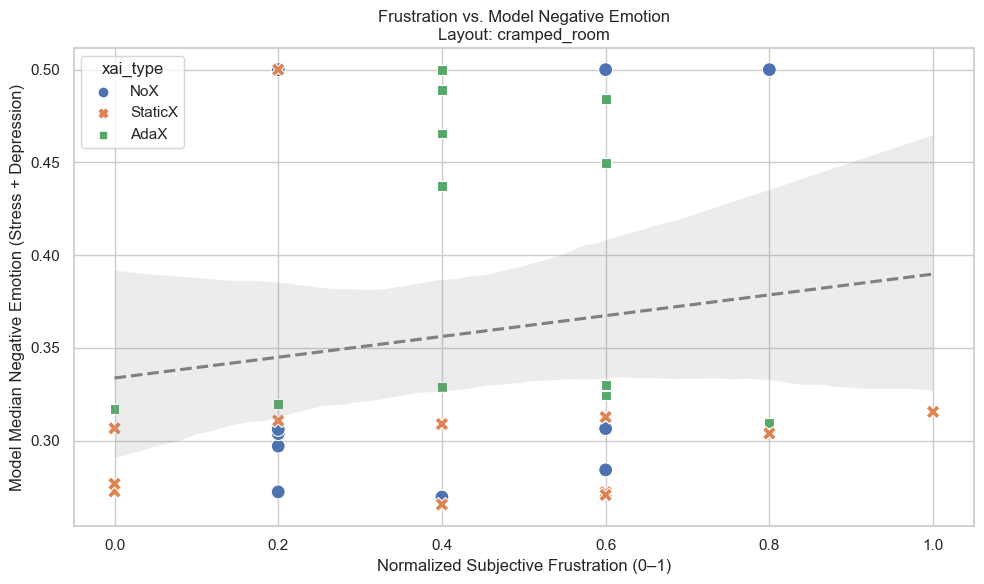

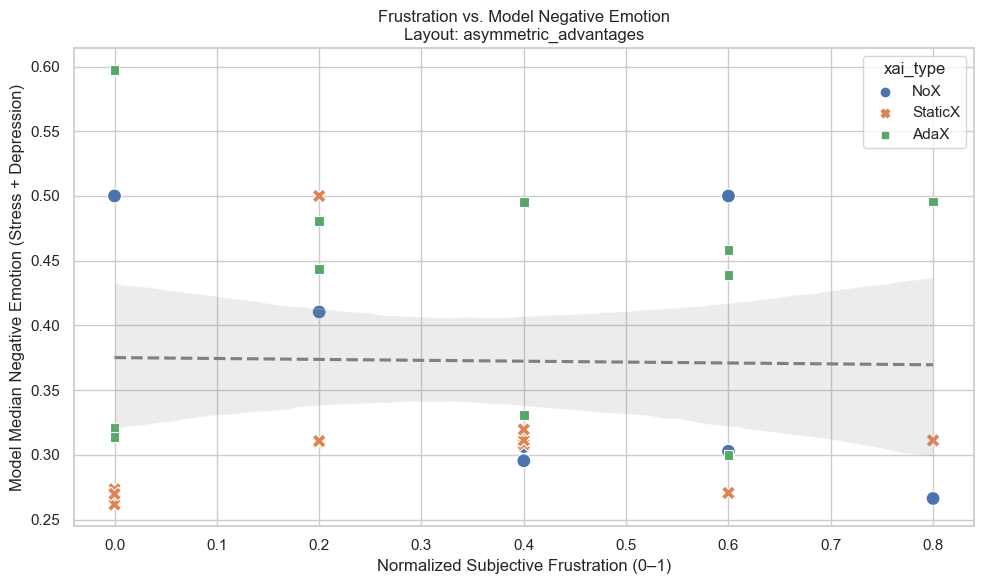

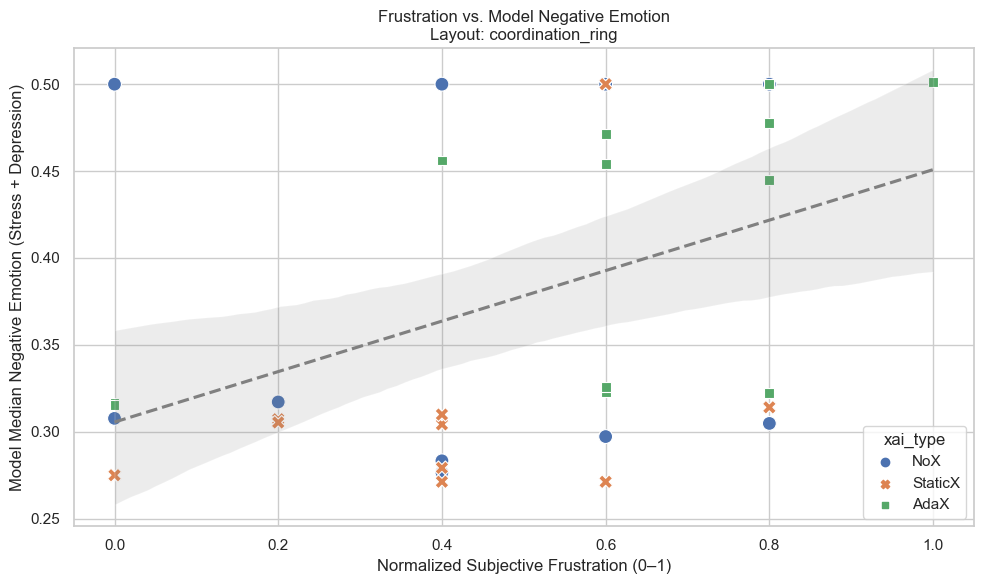

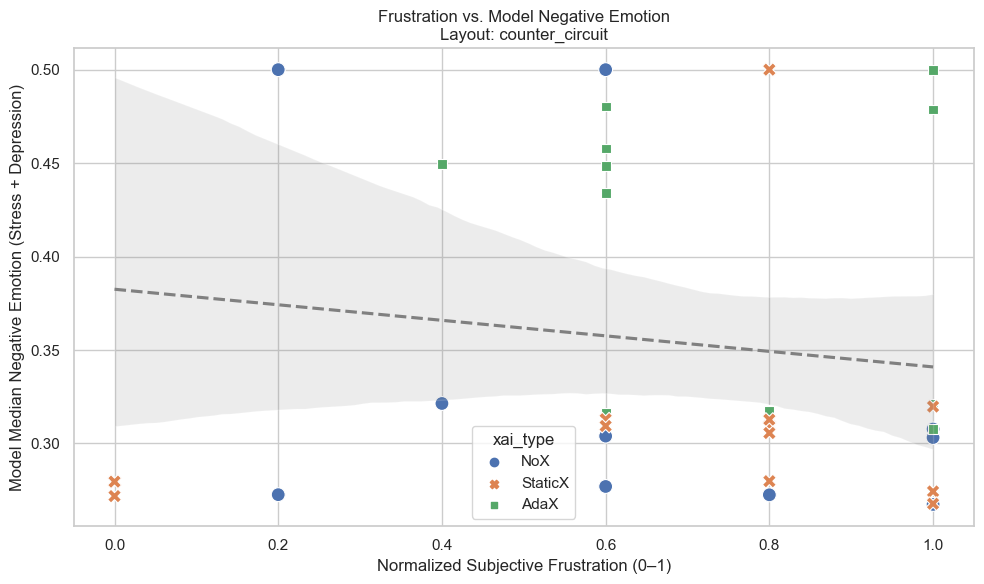

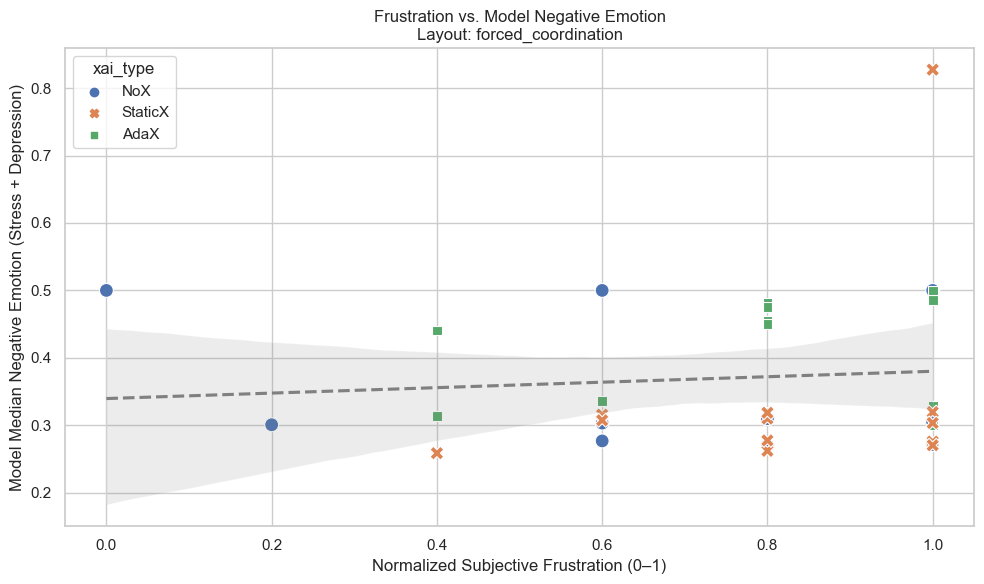

In [5093]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot scatterplots of model emotion vs. frustration per layout and XAI type
layouts = merged_df['layout'].unique()
for layout in layouts:
    plt.figure(figsize=(10, 6))
    data = merged_df[merged_df['layout'] == layout]
    sns.scatterplot(
        data=data,
        x='frustration_normalized',
        y='median_negative_emotion',
        hue='xai_type',
        style='xai_type',
        s=100
    )
    sns.regplot(
        data=data,
        x='frustration_normalized',
        y='median_negative_emotion',
        scatter=False,
        color='gray',
        line_kws={"linestyle": "dashed"}
    )
    plt.title(f"Frustration vs. Model Negative Emotion\nLayout: {layout}")
    plt.xlabel("Normalized Subjective Frustration (0–1)")
    plt.ylabel("Model Median Negative Emotion (Stress + Depression)")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


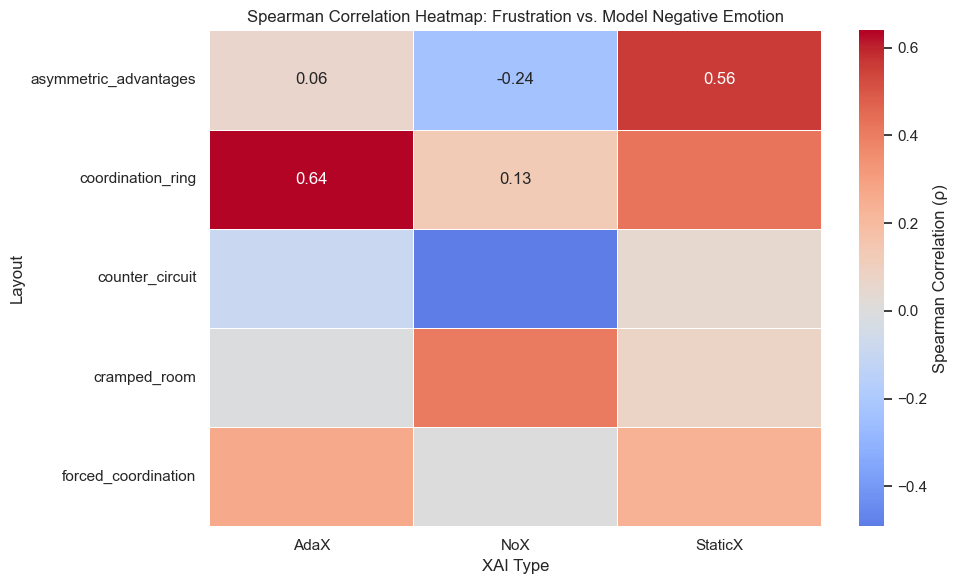

xai_type,AdaX,NoX,StaticX
layout,,,
asymmetric_advantages,0.064,-0.237,0.560
coordination_ring,0.639,0.127,0.425
counter_circuit,-0.093,-0.491,0.048
cramped_room,-0.007,0.406,0.078
forced_coordination,0.267,0.000,0.233


In [5094]:
# Create pivot table for correlation heatmap
heatmap_data = correlation_df.pivot(index='layout', columns='xai_type', values='spearman_r')

# Plot heatmap of Spearman correlations
plt.figure(figsize=(10, 6))
sns.heatmap(
    data=heatmap_data,
    annot=True,
    cmap='coolwarm',
    center=0,
    fmt='.2f',
    linewidths=0.5,
    cbar_kws={'label': "Spearman Correlation (ρ)"}
)
plt.title("Spearman Correlation Heatmap: Frustration vs. Model Negative Emotion")
plt.xlabel("XAI Type")
plt.ylabel("Layout")
plt.tight_layout()
plt.show()

heatmap_data

# Detect subjective data outliers with IQR

In [5096]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the Excel file
file_path = "sdata_latest.xlsx"  # adjust path as needed
xls = pd.ExcelFile(file_path)

# Step 2: Parse the target sheet (assumes "Sheet3" is relevant)
df_raw = xls.parse("Sheet3")

# Step 3: Remove the first row (which repeats headers)
df_cleaned = df_raw[1:].copy()

# Step 4: Define the subjective rating columns
target_columns = [
    'Q107_1', 'Q107_2', 'Q107_3', 'Q107_4', 'Q107_5', 'Q107_6', 'Q107_7', 'Q107_8', 'Q107_9',
    'Q99_1', 'Q99_2', 'Q99_3', 'Q99_4', 'Q99_5', 'Q99_6', 'Q99_7', 'Q99_8', 'Q99_9',
    'Q104_1', 'Q104_2', 'Q104_3', 'Q104_4', 'Q104_5', 'Q104_6'
]

# Step 5: Convert target columns to numeric
df_selected = df_cleaned[target_columns].apply(pd.to_numeric, errors='coerce')

# Step 6: Compute IQR outliers per column
outlier_flags = pd.DataFrame()

for col in target_columns:
    Q1 = df_selected[col].quantile(0.25)
    Q3 = df_selected[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outlier_flags[col] = (df_selected[col] < lower_bound) | (df_selected[col] > upper_bound)

# Step 7: Flag row-wise outliers (rows with any column marked)
iqr_row_outlier_flags = outlier_flags.any(axis=1)

# Step 8: Retrieve and report outlier rows
iqr_outlier_rows = df_cleaned.loc[iqr_row_outlier_flags, ['uid', 'xai_agent', 'layout'] + target_columns].copy()
iqr_outlier_rows["Outlier_Count"] = outlier_flags[iqr_row_outlier_flags].sum(axis=1)

# Step 9: Optional: sort and print/display
iqr_outlier_rows = iqr_outlier_rows.sort_values(by="Outlier_Count", ascending=False).reset_index(drop=True)

print("Row-wise outliers detected using IQR method:")
print(iqr_outlier_rows)


Row-wise outliers detected using IQR method:
Empty DataFrame
Columns: [uid, xai_agent, layout, Q107_1, Q107_2, Q107_3, Q107_4, Q107_5, Q107_6, Q107_7, Q107_8, Q107_9, Q99_1, Q99_2, Q99_3, Q99_4, Q99_5, Q99_6, Q99_7, Q99_8, Q99_9, Q104_1, Q104_2, Q104_3, Q104_4, Q104_5, Q104_6, Outlier_Count]
Index: []

[0 rows x 28 columns]


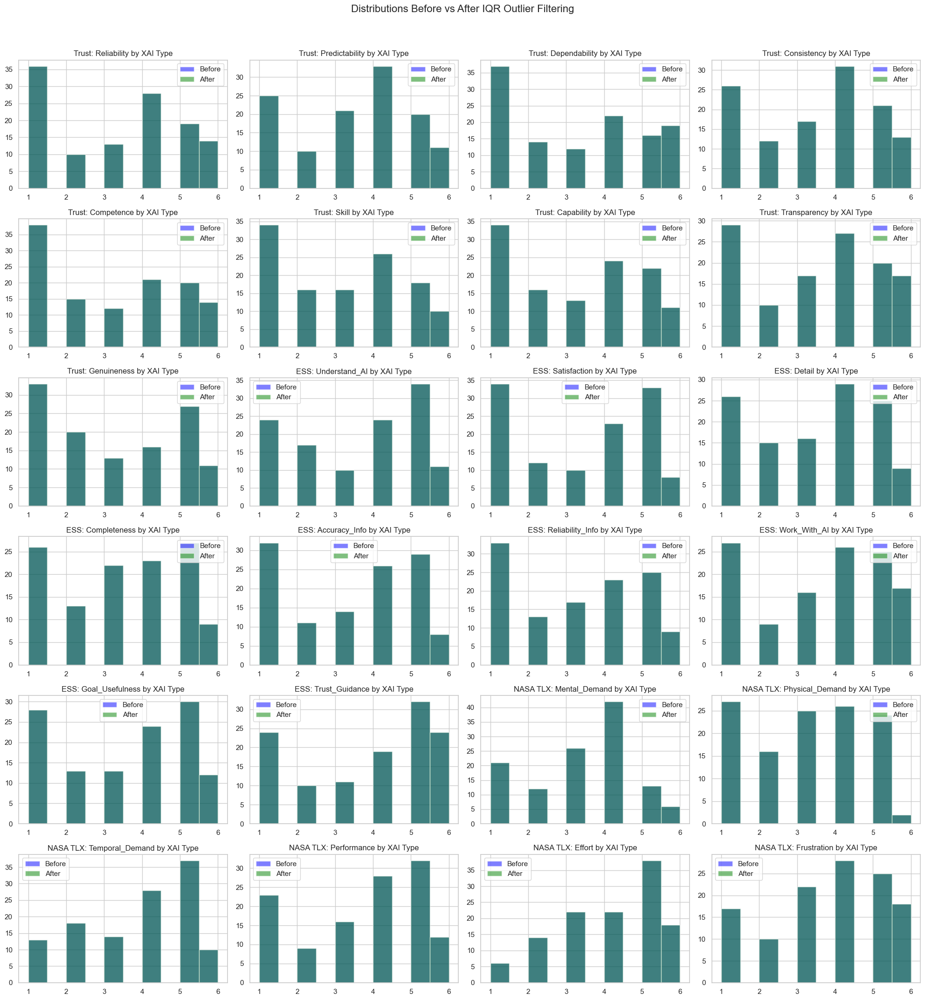

In [5097]:
# Define concise labels for renaming
concise_labels = {
    # Trust
    'Q107_1': 'Trust: Reliability',
    'Q107_2': 'Trust: Predictability',
    'Q107_3': 'Trust: Dependability',
    'Q107_4': 'Trust: Consistency',
    'Q107_5': 'Trust: Competence',
    'Q107_6': 'Trust: Skill',
    'Q107_7': 'Trust: Capability',
    'Q107_8': 'Trust: Transparency',
    'Q107_9': 'Trust: Genuineness',
    
    # Explanation Satisfaction
    'Q99_1': 'ESS: Understand_AI',
    'Q99_2': 'ESS: Satisfaction',
    'Q99_3': 'ESS: Detail',
    'Q99_4': 'ESS: Completeness',
    'Q99_5': 'ESS: Accuracy_Info',
    'Q99_6': 'ESS: Reliability_Info',
    'Q99_7': 'ESS: Work_With_AI',
    'Q99_8': 'ESS: Goal_Usefulness',
    'Q99_9': 'ESS: Trust_Guidance',
    
    # NASA TLX
    'Q104_1': 'NASA TLX: Mental_Demand',
    'Q104_2': 'NASA TLX: Physical_Demand',
    'Q104_3': 'NASA TLX: Temporal_Demand',
    'Q104_4': 'NASA TLX: Performance',
    'Q104_5': 'NASA TLX: Effort',
    'Q104_6': 'NASA TLX: Frustration'
}


# Step 1: Prepare pre-filter (original) and post-filter (non-outlier) data
pre_filter_data = df_selected.copy()
post_filter_data = df_selected[~iqr_row_outlier_flags].copy()

# Step 2: Plot histograms before and after filtering
num_cols = len(target_columns)
cols_per_row = 4
rows = (num_cols + cols_per_row - 1) // cols_per_row

# Set up figure
fig, axes = plt.subplots(rows, cols_per_row, figsize=(20, rows * 3.5))
axes = axes.flatten()

for idx, col in enumerate(target_columns):
    ax = axes[idx]
    ax.hist(pre_filter_data[col].dropna(), bins=10, alpha=0.5, label='Before', color='blue')
    ax.hist(post_filter_data[col].dropna(), bins=10, alpha=0.5, label='After', color='green')
    ax.set_title(col)
    ax.set_title(f"{concise_labels.get(col, col)} by XAI Type")
    ax.legend()

# Hide unused subplots
for ax in axes[num_cols:]:
    ax.axis('off')

plt.suptitle("Distributions Before vs After IQR Outlier Filtering", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()


Here are the distribution plots for each subjective rating item:

* **Blue**: Original data (before outlier removal)
* **Green**: Filtered data (after removing IQR outliers)

Since no rows were flagged as outliers, the distributions before and after are identical. This confirms the IQR method found **no distortions or extreme values** in the data.
